**Stock Price Prediction and Sentiment Analysis Setup**

 The first part of the script we explore the dynamic relationship between stock prices and various sentiment indicators, such as happiness, sadness, anger, and more along with the emoji detection, using a synthetic dataset. We begin by generating random stock prices linked to sentiment scores for major companies over several months. Utilizing a RandomForestRegressor, we predict stock prices based on these sentiments and then employ SHAP (SHapley Additive exPlanations) to interpret the model's predictions. This approach not only aids in forecasting stock movements but also unravels the intricate ways in which different sentiments can influence market behavior. The insights derived from this script are invaluable for understanding market dynamics and can guide investors and analysts in making informed decisions.

Installing Necessary Packages and Importing Libraries

In [ ]:
#Install Necessary Packages
!pip install tensorflow -qqq
!pip install keras -qqq
!pip install yfinance -qqq
!pip install mplfinance -qqq
!pip install seaborn -qqq
!pip install vaderSentiment -qqq
!pip install shap
!pip install lime

from google.colab import drive
drive.mount('/content/drive')
!mkdir -p /content/drive/MyDrive/colab_packages
!pip freeze > /content/drive/MyDrive/colab_packages/requirements.txt

# Import Required Libraries
import tensorflow as tf
import keras
import yfinance as yf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import mplfinance as mpf
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import LinearRegression
from keras.models import Sequential, Model
from keras.layers import LSTM, Dense, Dropout, AdditiveAttention, Permute, Reshape, Multiply, BatchNormalization, Conv1D, MaxPooling1D, Flatten, Input, concatenate
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, TensorBoard, CSVLogger
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from keras.optimizers import Adam
import pandas as pd
import nltk
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
from sklearn.model_selection import train_test_split
nltk.download('vader_lexicon')
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import pandas as pd
import numpy as np
import time
import matplotlib.dates as mdates
import matplotlib.ticker as tkr
import seaborn as sns
import shap
import lime
from lime import lime_tabular
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
from multiprocessing import Pool, cpu_count


# Download NLTK VADER lexicon for sentiment analysis
nltk.download('vader_lexicon')
sia = SentimentIntensityAnalyzer()

# Download NLTK VADER lexicon for sentiment analysis
print("TensorFlow Version: ", tf.__version__)

Mounted at /content/drive


[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


TensorFlow Version:  2.17.0


[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


In [ ]:
from scipy.stats import ttest_ind

Load and Inspect Tweet Data

In [ ]:
df = pd.read_csv('stock_tweets.csv')

# Check for missing values in each column
missing_values = df.isnull().sum()
print(missing_values)

Date            0
Tweet           0
Stock Name      0
Company Name    0
dtype: int64


Feature Selection and Technical analysis

In [ ]:
# Ensure features list
features = ['Open', 'High', 'Low', 'Close', 'Volume', 'Mkt Cap', 'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low', 'Price Movement']

# Function to check columns
def check_columns(data, features):
    missing_columns = [col for col in features if col not in data.columns]
    if missing_columns:
        raise KeyError(f"Missing columns in data: {missing_columns}")

companies = ['GOOG', 'AMZN', 'AAPL', 'TSLA', 'VZ', 'KO']

# Dictionary to store data for each company
company_data = {}

# Function to print historical data for each company
def print_historical_data(company):
    data = company_data[company]
    print(f"Historical data for {company}:")
    print(data.head())
    print("\n")

# Load data for each company
for company in companies:
    data = yf.download(company, period='5y', interval='1d')
    company_data[company] = data
    print(f"{company}: {len(data)} records")  # Debug: print the length of the data
    print_historical_data(company)


# Extended feature engineering function
def feature_engineering(data):
    data['Mkt Cap'] = data['Close'] * data['Volume']
    data['P/E Ratio'] = 20  # Placeholder for P/E ratio
    data['Div Yield'] = 0  # Placeholder for Dividend Yield
    data['CDP Score'] = 5  # Placeholder for CDP score
    data['52-wk High'] = data['Close'].rolling(window=252, min_periods=1).max()
    data['52-wk Low'] = data['Close'].rolling(window=252, min_periods=1).min()
    data['Price Movement'] = data['Close'].diff()
    data.fillna(method='ffill', inplace=True)
    data.fillna(method='bfill', inplace=True)
    return data


# Apply feature engineering to each company's data and check for missing columns
for company in companies:
    data = company_data[company]
    company_data[company] = feature_engineering(data)
    missing_columns = [col for col in features if col not in company_data[company].columns]
    if missing_columns:
        print(f"Missing columns for {company}: {missing_columns}")
    print(f"Columns for {company}: {list(company_data[company].columns)}")
    print(f"{company} data length: {len(company_data[company])}")

for company in companies:
    data = yf.download(company, period='5y', interval='1d')  # Load 3 years of data for robustness
    data = feature_engineering(data)
    print(f"Columns after feature engineering for {company}: {data.columns}")  # Debug print
    check_columns(data, features)  # Ensure all necessary columns are present
    company_data[company] = data

# Scaling function
scaler = MinMaxScaler(feature_range=(0, 1))

# Scaling function
def scale_data(data, features):
    scaler = MinMaxScaler()
    scaled_data = scaler.fit_transform(data[features])
    return scaled_data, scaler

def train_lstm_model(X_train, y_train):
    model = Sequential()
    model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
    model.add(Dropout(0.2))
    model.add(LSTM(units=50, return_sequences=False))
    model.add(Dropout(0.2))
    model.add(Dense(units=25))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')
    model.fit(X_train, y_train, epochs=100, batch_size=25, validation_split=0.2, callbacks=[EarlyStopping(monitor='val_loss', patience=10)])
    return model

def train_cnn_model(X_train, y_train):
    input_layer = Input(shape=(X_train.shape[1], X_train.shape[2]))
    conv1 = Conv1D(filters=64, kernel_size=3, activation='relu')(input_layer)
    pool1 = MaxPooling1D(pool_size=2)(conv1)
    flat = Flatten()(pool1)
    cnn_output = Dense(1)(flat)
    cnn_model = Model(inputs=input_layer, outputs=cnn_output)
    cnn_model.compile(optimizer=Adam(learning_rate=0.001), loss='mean_squared_error')
    cnn_history = cnn_model.fit(X_train, y_train, epochs=100, batch_size=25, validation_split=0.2, callbacks=[EarlyStopping(monitor='val_loss', patience=10)])
    return cnn_model

def train_gbm_model(X_train, y_train):
    X_flat_train = X_train.reshape(X_train.shape[0], -1)
    gbm_model = GradientBoostingRegressor(n_estimators=100)
    gbm_model.fit(X_flat_train, y_train)
    return gbm_model

# Meta-model training function
def train_meta_model(lstm_predictions, cnn_predictions, gbm_predictions, y_test):
    train_meta_features = np.vstack((lstm_predictions, cnn_predictions, gbm_predictions)).T
    meta_model = LinearRegression()
    meta_model.fit(train_meta_features, y_test)
    return meta_model


[*********************100%***********************]  1 of 1 completed


GOOG: 1258 records
Historical data for GOOG:
                 Open       High        Low      Close  Adj Close    Volume
Date                                                                       
2019-09-03  58.851501  59.344501  58.160000  58.419498  58.353096  29598000
2019-09-04  58.835499  59.174000  58.549999  59.070499  59.003357  21378000
2019-09-05  59.576500  60.652000  59.576500  60.569000  60.500153  28162000
2019-09-06  60.406502  60.600750  60.126099  60.246498  60.178017  21442000
2019-09-09  60.200001  61.000000  59.631001  60.220501  60.152050  29438000




[*********************100%***********************]  1 of 1 completed


AMZN: 1258 records
Historical data for AMZN:
                 Open       High        Low      Close  Adj Close    Volume
Date                                                                       
2019-09-03  88.500000  90.040001  88.400002  89.491997  89.491997  70860000
2019-09-04  90.250000  90.381500  89.811501  90.030998  90.030998  46482000
2019-09-05  91.097504  92.099998  90.778999  92.036003  92.036003  66216000
2019-09-06  91.911003  92.032501  91.320000  91.675499  91.675499  49938000
2019-09-09  92.050003  92.500000  91.230499  91.567497  91.567497  59990000




[*********************100%***********************]  1 of 1 completed


AAPL: 1258 records
Historical data for AAPL:
                 Open       High        Low      Close  Adj Close     Volume
Date                                                                        
2019-09-03  51.607498  51.744999  51.055000  51.424999  49.761089   80092000
2019-09-04  52.097500  52.369999  51.830002  52.297501  50.605370   76752400
2019-09-05  53.000000  53.492500  52.877499  53.320000  51.594776   95654800
2019-09-06  53.512501  53.605000  53.127499  53.314999  51.589947   77449200
2019-09-09  53.709999  54.110001  52.767502  53.542500  51.810085  109237600




[*********************100%***********************]  1 of 1 completed


TSLA: 1258 records
Historical data for TSLA:
                 Open       High        Low      Close  Adj Close     Volume
Date                                                                        
2019-09-03  14.938667  15.263333  14.877333  15.000667  15.000667   80311500
2019-09-04  15.126000  15.230667  14.614000  14.712000  14.712000   86415000
2019-09-05  14.833333  15.320000  14.723333  15.305333  15.305333  110929500
2019-09-06  15.146667  15.309333  15.011333  15.163333  15.163333   62841000
2019-09-09  15.333333  15.584000  15.282000  15.452667  15.452667   72040500




[*********************100%***********************]  1 of 1 completed


VZ: 1258 records
Historical data for VZ:
                 Open       High        Low      Close  Adj Close    Volume
Date                                                                       
2019-09-03  57.900002  58.189999  57.590000  58.040001  44.276546  10470100
2019-09-04  58.240002  58.549999  57.959999  58.180000  44.383350   9232200
2019-09-05  58.580002  58.630001  58.189999  58.590000  44.696121   9232300
2019-09-06  58.689999  59.099998  58.470001  59.060001  45.054672   8920200
2019-09-09  59.490002  59.520000  58.639999  58.660000  44.749523  12848700




[*********************100%***********************]  1 of 1 completed
<ipython-input-7-99b0a277005e>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-7-99b0a277005e>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)
<ipython-input-7-99b0a277005e>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-7-99b0a277005e>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)
<ipython-input-7-99b0a277005e>:39: FutureWarning: DataFrame.fillna with

KO: 1258 records
Historical data for KO:
                 Open       High        Low      Close  Adj Close    Volume
Date                                                                       
2019-09-03  54.980000  55.330002  54.869999  55.299999  47.344208  12991400
2019-09-04  55.349998  55.919998  55.299999  55.770000  47.746586  10718100
2019-09-05  55.750000  55.770000  55.029999  55.119999  47.190102  13677000
2019-09-06  55.439999  55.439999  54.759998  55.230000  47.284267   9093500
2019-09-09  55.029999  55.080002  54.360001  54.520000  46.676414  10814900


Columns for GOOG: ['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap', 'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low', 'Price Movement']
GOOG data length: 1258
Columns for AMZN: ['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap', 'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low', 'Price Movement']
AMZN data length: 1258
Columns for AAPL: ['Open', 'High', 'Low',

[*********************100%***********************]  1 of 1 completed
<ipython-input-7-99b0a277005e>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-7-99b0a277005e>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)
[*********************100%***********************]  1 of 1 completed


Columns after feature engineering for GOOG: Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap',
       'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low',
       'Price Movement'],
      dtype='object')
Columns after feature engineering for AMZN: Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap',
       'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low',
       'Price Movement'],
      dtype='object')

<ipython-input-7-99b0a277005e>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-7-99b0a277005e>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)


[*********************100%***********************]  1 of 1 completed
<ipython-input-7-99b0a277005e>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-7-99b0a277005e>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)


Columns after feature engineering for AAPL: Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap',
       'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low',
       'Price Movement'],
      dtype='object')


[*********************100%***********************]  1 of 1 completed
<ipython-input-7-99b0a277005e>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-7-99b0a277005e>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)
[*********************100%***********************]  1 of 1 completed
<ipython-input-7-99b0a277005e>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-7-99b0a277005e>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)


Columns after feature engineering for TSLA: Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap',
       'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low',
       'Price Movement'],
      dtype='object')
Columns after feature engineering for VZ: Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap',
       'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low',
       'Price Movement'],
      dtype='object')


[*********************100%***********************]  1 of 1 completed
<ipython-input-7-99b0a277005e>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)


Columns after feature engineering for KO: Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap',
       'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low',
       'Price Movement'],
      dtype='object')


<ipython-input-7-99b0a277005e>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)


Data Scaling, Model Training, and Evaluation for Stock Price Prediction


In [ ]:
for company in companies:
    data = yf.download(company, period='5y', interval='1d')  # Load 3 years of data for robustness
    data = feature_engineering(data)
    print(f"Columns after feature engineering for {company}: {data.columns}")  # Debug print
    check_columns(data, features)  # Ensure all necessary columns are present
    company_data[company] = data

# Scaling function
scaler = MinMaxScaler(feature_range=(0, 1))

# Scaling function
def scale_data(data, features):
    scaler = MinMaxScaler()
    scaled_data = scaler.fit_transform(data[features])
    return scaled_data, scaler

# Define functions to scale data
def scale_data(data, features):
    # Ensure we only scale existing features
    available_features = [feature for feature in features if feature in data.columns]
    data[available_features] = data[available_features].fillna(method='ffill').fillna(method='bfill').fillna(data[available_features].mean())
    scaler = MinMaxScaler()
    scaled_data = scaler.fit_transform(data[available_features])
    return scaled_data, scaler, available_features

# Prepare data for modeling
def prepare_data(data, features):
    available_features = [feature for feature in features if feature in data.columns]
    data[available_features] = data[available_features].fillna(method='ffill').fillna(method='bfill').fillna(data[available_features].mean())
    scaled_data, scaler, available_features = scale_data(data, available_features)
    X, y = [], []
    for i in range(60, len(scaled_data)):
        X.append(scaled_data[i-60:i])
        y.append(scaled_data[i, available_features.index('Close')])
    X, y = np.array(X), np.array(y)
    train_size = int(len(X) * 0.8)
    X_train, X_test = X[:train_size], X[train_size:]
    y_train, y_test = y[:train_size], y[train_size:]
    X_train = np.nan_to_num(X_train)
    X_test = np.nan_to_num(X_test)
    y_train = np.nan_to_num(y_train)
    y_test = np.nan_to_num(y_test)

    return X_train, X_test, y_train, y_test, scaler, available_features

# Define features to be used for training
features = ['Open', 'High', 'Low', 'Close', 'Volume', 'Mkt Cap', 'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low', 'Price Movement', 'Compound']

def train_lstm_model(X_train, y_train):
    model = Sequential()
    model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
    model.add(Dropout(0.2))
    model.add(LSTM(units=50, return_sequences=False))
    model.add(Dropout(0.2))
    model.add(Dense(units=25))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')
    model.fit(X_train, y_train, epochs=100, batch_size=25, validation_split=0.2, callbacks=[EarlyStopping(monitor='val_loss', patience=10)])
    return model

def train_cnn_model(X_train, y_train):
    input_layer = Input(shape=(X_train.shape[1], X_train.shape[2]))
    conv1 = Conv1D(filters=64, kernel_size=3, activation='relu')(input_layer)
    pool1 = MaxPooling1D(pool_size=2)(conv1)
    flat = Flatten()(pool1)
    cnn_output = Dense(1)(flat)
    cnn_model = Model(inputs=input_layer, outputs=cnn_output)
    cnn_model.compile(optimizer='adam', loss='mean_squared_error')
    cnn_model.fit(X_train, y_train, epochs=100, batch_size=25, validation_split=0.2, callbacks=[EarlyStopping(monitor='val_loss', patience=10)])
    return cnn_model

def train_gbm_model(X_train, y_train):
    X_flat_train = X_train.reshape(X_train.shape[0], -1)
    gbm_model = GradientBoostingRegressor(n_estimators=100)
    gbm_model.fit(X_flat_train, y_train)
    return gbm_model

def train_meta_model(lstm_predictions, cnn_predictions, gbm_predictions, y_test):
    train_meta_features = np.vstack((lstm_predictions, cnn_predictions, gbm_predictions)).T
    meta_model = LinearRegression()
    meta_model.fit(train_meta_features, y_test)
    return meta_model

# Evaluate models
def evaluate_model(model, X_test, y_test, model_name):
    predictions_test = model.predict(X_test).flatten()
    mse = mean_squared_error(y_test, predictions_test)
    print(f"{model_name} Model Mean Squared Error: {mse}")
    return predictions_test, mse

# Train and evaluate models for each company
model_results = {}

for company in companies:
    data = company_data[company]
    X_train, X_test, y_train, y_test, scaler, available_features = prepare_data(data, features)
    lstm_model = train_lstm_model(X_train, y_train)
    cnn_model = train_cnn_model(X_train, y_train)
    gbm_model = train_gbm_model(X_train, y_train)
    lstm_predictions, lstm_mse = evaluate_model(lstm_model, X_test, y_test, "LSTM")
    cnn_predictions, cnn_mse = evaluate_model(cnn_model, X_test, y_test, "CNN")
    gbm_predictions, gbm_mse = evaluate_model(gbm_model, X_test.reshape(X_test.shape[0], -1), y_test, "GBM")
    meta_model = train_meta_model(lstm_predictions, cnn_predictions, gbm_predictions, y_test)
    test_meta_features = np.vstack((lstm_predictions, cnn_predictions, gbm_predictions)).T
    y_pred = meta_model.predict(test_meta_features)

    model_results[company] = {
        "lstm_model": lstm_model,
        "cnn_model": cnn_model,
        "gbm_model": gbm_model,
        "meta_model": meta_model,
        "lstm_model_mse": lstm_mse,
        "cnn_model_mse": cnn_mse,
        "gbm_model_mse": gbm_mse,
        "mae": mean_absolute_error(y_test, y_pred),
        "rmse": mean_squared_error(y_test, y_pred, squared=False),
        "r2": r2_score(y_test, y_pred)
    }


[*********************100%***********************]  1 of 1 completed
<ipython-input-7-99b0a277005e>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-7-99b0a277005e>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)
[*********************100%***********************]  1 of 1 completed
<ipython-input-7-99b0a277005e>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-7-99b0a277005e>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)


Columns after feature engineering for GOOG: Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap',
       'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low',
       'Price Movement'],
      dtype='object')
Columns after feature engineering for AMZN: Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap',
       'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low',
       'Price Movement'],
      dtype='object')


[*********************100%***********************]  1 of 1 completed
<ipython-input-7-99b0a277005e>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-7-99b0a277005e>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)
[*********************100%***********************]  1 of 1 completed
<ipython-input-7-99b0a277005e>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-7-99b0a277005e>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)


Columns after feature engineering for AAPL: Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap',
       'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low',
       'Price Movement'],
      dtype='object')
Columns after feature engineering for TSLA: Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap',
       'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low',
       'Price Movement'],
      dtype='object')


[*********************100%***********************]  1 of 1 completed
<ipython-input-7-99b0a277005e>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-7-99b0a277005e>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)
[*********************100%***********************]  1 of 1 completed
<ipython-input-7-99b0a277005e>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-7-99b0a277005e>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)
<i

Columns after feature engineering for VZ: Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap',
       'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low',
       'Price Movement'],
      dtype='object')
Columns after feature engineering for KO: Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap',
       'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low',
       'Price Movement'],
      dtype='object')


<ipython-input-8-afca78691720>:21: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data[available_features] = data[available_features].fillna(method='ffill').fillna(method='bfill').fillna(data[available_features].mean())
/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 14s 169ms/step - loss: 0.0519 - val_loss: 0.0038
Epoch 2/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 7s 71ms/step - loss: 0.0042 - val_loss: 0.0029
Epoch 3/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - loss: 0.0037 - val_loss: 0.0037
Epoch 4/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - loss: 0.0035 - val_loss: 0.0019
Epoch 5/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 107ms/step - loss: 0.0024 - val_loss: 0.0020
Epoch 6/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 99ms/step - loss: 0.0027 - val_loss: 0.0017
Epoch 7/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 72ms/step - loss: 0.0026 - val_loss: 0.0020
Epoch 8/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - loss: 0.0028 - val_loss: 0.0023
Epoch 9/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - loss: 0.0028 - val_loss: 0.0016
Epoch 10/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 96ms/step - loss: 0.0020 - val_loss: 0.0015
Epoch 11/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 74ms/step - loss: 0.0018 - val_loss: 0.0014
Epoch 12/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/s

<ipython-input-8-afca78691720>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data[available_features] = data[available_features].fillna(method='ffill').fillna(method='bfill').fillna(data[available_features].mean())
<ipython-input-8-afca78691720>:21: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data[available_features] = data[available_features].fillna(method='ffill').fillna(method='bfill').fillna(data[available_features].mean())
/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 8s 85ms/step - loss: 0.0282 - val_loss: 0.0019
Epoch 2/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - loss: 0.0090 - val_loss: 0.0024
Epoch 3/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - loss: 0.0070 - val_loss: 0.0012
Epoch 4/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - loss: 0.0059 - val_loss: 0.0018
Epoch 5/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 75ms/step - loss: 0.0078 - val_loss: 0.0013
Epoch 6/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 108ms/step - loss: 0.0062 - val_loss: 0.0012
Epoch 7/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 64ms/step - loss: 0.0057 - val_loss: 0.0012
Epoch 8/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 67ms/step - loss: 0.0046 - val_loss: 9.6044e-04
Epoch 9/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 70ms/step - loss: 0.0046 - val_loss: 0.0012
Epoch 10/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 78ms/step - loss: 0.0046 - val_loss: 0.0013
Epoch 11/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 93ms/step - loss: 0.0045 - val_loss: 0.0011
Epoch 12/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 87ms/step


LSTM Model Mean Squared Error: 0.0010155807922089552
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
CNN Model Mean Squared Error: 0.001811152657903343
GBM Model Mean Squared Error: 0.0021906401098062173


<ipython-input-8-afca78691720>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data[available_features] = data[available_features].fillna(method='ffill').fillna(method='bfill').fillna(data[available_features].mean())
<ipython-input-8-afca78691720>:21: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data[available_features] = data[available_features].fillna(method='ffill').fillna(method='bfill').fillna(data[available_features].mean())
/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 7s 82ms/step - loss: 0.0234 - val_loss: 0.0019
Epoch 2/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - loss: 0.0039 - val_loss: 0.0021
Epoch 3/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - loss: 0.0030 - val_loss: 0.0023
Epoch 4/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 64ms/step - loss: 0.0029 - val_loss: 0.0018
Epoch 5/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 74ms/step - loss: 0.0025 - val_loss: 0.0012
Epoch 6/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 71ms/step - loss: 0.0019 - val_loss: 0.0021
Epoch 7/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - loss: 0.0019 - val_loss: 0.0011
Epoch 8/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 92ms/step - loss: 0.0020 - val_loss: 0.0011
Epoch 9/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 72ms/step - loss: 0.0021 - val_loss: 0.0011
Epoch 10/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - loss: 0.0019 - val_loss: 0.0025
Epoch 11/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 73ms/step - loss: 0.0020 - val_loss: 0.0023
Epoch 12/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 79ms/step

<ipython-input-8-afca78691720>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data[available_features] = data[available_features].fillna(method='ffill').fillna(method='bfill').fillna(data[available_features].mean())
<ipython-input-8-afca78691720>:21: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data[available_features] = data[available_features].fillna(method='ffill').fillna(method='bfill').fillna(data[available_features].mean())
/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 7s 83ms/step - loss: 0.0837 - val_loss: 0.0047
Epoch 2/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - loss: 0.0109 - val_loss: 0.0035
Epoch 3/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 74ms/step - loss: 0.0062 - val_loss: 0.0032
Epoch 4/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - loss: 0.0060 - val_loss: 0.0028
Epoch 5/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 94ms/step - loss: 0.0057 - val_loss: 0.0027
Epoch 6/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - loss: 0.0047 - val_loss: 0.0029
Epoch 7/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - loss: 0.0059 - val_loss: 0.0032
Epoch 8/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 65ms/step - loss: 0.0044 - val_loss: 0.0023
Epoch 9/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - loss: 0.0041 - val_loss: 0.0023
Epoch 10/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 74ms/step - loss: 0.0042 - val_loss: 0.0019
Epoch 11/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step - loss: 0.0033 - val_loss: 0.0022
Epoch 12/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 69ms/step

<ipython-input-8-afca78691720>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data[available_features] = data[available_features].fillna(method='ffill').fillna(method='bfill').fillna(data[available_features].mean())
<ipython-input-8-afca78691720>:21: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data[available_features] = data[available_features].fillna(method='ffill').fillna(method='bfill').fillna(data[available_features].mean())
/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 8s 131ms/step - loss: 0.1251 - val_loss: 0.0214
Epoch 2/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 83ms/step - loss: 0.0150 - val_loss: 0.0064
Epoch 3/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step - loss: 0.0094 - val_loss: 0.0028
Epoch 4/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - loss: 0.0065 - val_loss: 0.0024
Epoch 5/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 71ms/step - loss: 0.0067 - val_loss: 0.0027
Epoch 6/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 81ms/step - loss: 0.0075 - val_loss: 0.0021
Epoch 7/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 105ms/step - loss: 0.0056 - val_loss: 0.0024
Epoch 8/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 69ms/step - loss: 0.0060 - val_loss: 0.0017
Epoch 9/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - loss: 0.0056 - val_loss: 0.0016
Epoch 10/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - loss: 0.0049 - val_loss: 0.0018
Epoch 11/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 66ms/step - loss: 0.0049 - val_loss: 0.0015
Epoch 12/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 104ms/s

<ipython-input-8-afca78691720>:29: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data[available_features] = data[available_features].fillna(method='ffill').fillna(method='bfill').fillna(data[available_features].mean())
<ipython-input-8-afca78691720>:21: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data[available_features] = data[available_features].fillna(method='ffill').fillna(method='bfill').fillna(data[available_features].mean())
/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 9s 111ms/step - loss: 0.0753 - val_loss: 0.0029
Epoch 2/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 68ms/step - loss: 0.0080 - val_loss: 0.0011
Epoch 3/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - loss: 0.0062 - val_loss: 8.4965e-04
Epoch 4/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 75ms/step - loss: 0.0055 - val_loss: 8.1209e-04
Epoch 5/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 85ms/step - loss: 0.0055 - val_loss: 6.7834e-04
Epoch 6/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 5s 69ms/step - loss: 0.0043 - val_loss: 7.4209e-04
Epoch 7/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - loss: 0.0041 - val_loss: 6.4709e-04
Epoch 8/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 66ms/step - loss: 0.0051 - val_loss: 6.5402e-04
Epoch 9/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - loss: 0.0036 - val_loss: 0.0013
Epoch 10/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 95ms/step - loss: 0.0047 - val_loss: 0.0011
Epoch 11/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 71ms/step - loss: 0.0032 - val_loss: 6.2473e-04
Epoch 12/100
31/31 ━━━━

Predicting Future Stock Prices Using Trained Models

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


GOOG: 1258 records
Historical data for GOOG:
                 Open       High        Low      Close  Adj Close    Volume
Date                                                                       
2019-09-03  58.851501  59.344501  58.160000  58.419498  58.353096  29598000
2019-09-04  58.835499  59.174000  58.549999  59.070499  59.003357  21378000
2019-09-05  59.576500  60.652000  59.576500  60.569000  60.500153  28162000
2019-09-06  60.406502  60.600750  60.126099  60.246498  60.178017  21442000
2019-09-09  60.200001  61.000000  59.631001  60.220501  60.152050  29438000


AMZN: 1258 records
Historical data for AMZN:
                 Open       High        Low      Close  Adj Close    Volume
Date                                                                       
2019-09-03  88.500000  90.040001  88.400002  89.491997  89.491997  70860000
2019-09-04  90.250000  90.381500  89.811501  90.030998  90.030998  46482000
2019-09-05  91.097504  92.099998  90.778999  92.036003  92.036003  66216

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


AAPL: 1258 records
Historical data for AAPL:
                 Open       High        Low      Close  Adj Close     Volume
Date                                                                        
2019-09-03  51.607498  51.744999  51.055000  51.424999  49.761089   80092000
2019-09-04  52.097500  52.369999  51.830002  52.297501  50.605370   76752400
2019-09-05  53.000000  53.492500  52.877499  53.320000  51.594776   95654800
2019-09-06  53.512501  53.605000  53.127499  53.314999  51.589939   77449200
2019-09-09  53.709999  54.110001  52.767502  53.542500  51.810089  109237600


TSLA: 1258 records
Historical data for TSLA:
                 Open       High        Low      Close  Adj Close     Volume
Date                                                                        
2019-09-03  14.938667  15.263333  14.877333  15.000667  15.000667   80311500
2019-09-04  15.126000  15.230667  14.614000  14.712000  14.712000   86415000
2019-09-05  14.833333  15.320000  14.723333  15.305333  15.30

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
<ipython-input-9-f2cf07ed6e11>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-9-f2cf07ed6e11>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)
<ipython-input-9-f2cf07ed6e11>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)


VZ: 1258 records
Historical data for VZ:
                 Open       High        Low      Close  Adj Close    Volume
Date                                                                       
2019-09-03  57.900002  58.189999  57.590000  58.040001  44.276543  10470100
2019-09-04  58.240002  58.549999  57.959999  58.180000  44.383343   9232200
2019-09-05  58.580002  58.630001  58.189999  58.590000  44.696125   9232300
2019-09-06  58.689999  59.099998  58.470001  59.060001  45.054672   8920200
2019-09-09  59.490002  59.520000  58.639999  58.660000  44.749519  12848700


KO: 1258 records
Historical data for KO:
                 Open       High        Low      Close  Adj Close    Volume
Date                                                                       
2019-09-03  54.980000  55.330002  54.869999  55.299999  47.344200  12991400
2019-09-04  55.349998  55.919998  55.299999  55.770000  47.746590  10718100
2019-09-05  55.750000  55.770000  55.029999  55.119999  47.190094  13677000
2019

<ipython-input-9-f2cf07ed6e11>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)
<ipython-input-9-f2cf07ed6e11>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-9-f2cf07ed6e11>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)
<ipython-input-9-f2cf07ed6e11>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-9-f2cf07ed6e11>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.f

Columns for AMZN: ['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap', 'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low', 'Price Movement']
AMZN data length: 1258
Columns for AAPL: ['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap', 'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low', 'Price Movement']
AAPL data length: 1258
Columns for TSLA: ['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap', 'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low', 'Price Movement']
TSLA data length: 1258
Columns for VZ: ['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap', 'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low', 'Price Movement']
VZ data length: 1258
Columns for KO: ['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap', 'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low', 'Price Movement']
KO data length: 1258
Columns after feature engineering for GOOG: Inde

[*********************100%***********************]  1 of 1 completed
<ipython-input-9-f2cf07ed6e11>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-9-f2cf07ed6e11>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)
[*********************100%***********************]  1 of 1 completed
<ipython-input-9-f2cf07ed6e11>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-9-f2cf07ed6e11>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)


Columns after feature engineering for AMZN: Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap',
       'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low',
       'Price Movement'],
      dtype='object')
Columns after feature engineering for AAPL: Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap',
       'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low',
       'Price Movement'],
      dtype='object')


[*********************100%***********************]  1 of 1 completed
<ipython-input-9-f2cf07ed6e11>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-9-f2cf07ed6e11>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)
[*********************100%***********************]  1 of 1 completed
<ipython-input-9-f2cf07ed6e11>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-9-f2cf07ed6e11>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)
[*

Columns after feature engineering for TSLA: Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap',
       'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low',
       'Price Movement'],
      dtype='object')
Columns after feature engineering for VZ: Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap',
       'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low',
       'Price Movement'],
      dtype='object')



<ipython-input-9-f2cf07ed6e11>:39: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)
<ipython-input-9-f2cf07ed6e11>:40: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)
/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Columns after feature engineering for KO: Index(['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume', 'Mkt Cap',
       'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low',
       'Price Movement'],
      dtype='object')
Epoch 1/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 6s 80ms/step - loss: 0.0623 - val_loss: 0.0032
Epoch 2/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - loss: 0.0038 - val_loss: 0.0012
Epoch 3/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - loss: 0.0024 - val_loss: 0.0011
Epoch 4/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 94ms/step - loss: 0.0023 - val_loss: 0.0010
Epoch 5/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - loss: 0.0020 - val_loss: 0.0015
Epoch 6/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 5s 72ms/step - loss: 0.0021 - val_loss: 0.0013
Epoch 7/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - loss: 0.0020 - val_loss: 0.0011
Epoch 8/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 73ms/step - loss: 0.0017 - val_loss: 0.0011
Epoch 9/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 96ms/step - loss: 0.0019 - val_los

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 7s 82ms/step - loss: 0.0618 - val_loss: 0.0025
Epoch 2/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - loss: 0.0102 - val_loss: 0.0016
Epoch 3/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - loss: 0.0074 - val_loss: 0.0013
Epoch 4/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - loss: 0.0067 - val_loss: 0.0011
Epoch 5/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 91ms/step - loss: 0.0060 - val_loss: 0.0010
Epoch 6/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 5s 73ms/step - loss: 0.0061 - val_loss: 9.8095e-04
Epoch 7/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - loss: 0.0057 - val_loss: 9.6883e-04
Epoch 8/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 65ms/step - loss: 0.0051 - val_loss: 0.0013
Epoch 9/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - loss: 0.0047 - val_loss: 0.0010
Epoch 10/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - loss: 0.0051 - val_loss: 0.0033
Epoch 11/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 69ms/step - loss: 0.0056 - val_loss: 0.0011
Epoch 12/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 8

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


31/31 ━━━━━━━━━━━━━━━━━━━━ 6s 85ms/step - loss: 0.0301 - val_loss: 0.0028
Epoch 2/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 78ms/step - loss: 0.0051 - val_loss: 0.0026
Epoch 3/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 95ms/step - loss: 0.0035 - val_loss: 0.0029
Epoch 4/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - loss: 0.0029 - val_loss: 0.0018
Epoch 5/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 72ms/step - loss: 0.0025 - val_loss: 0.0022
Epoch 6/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 73ms/step - loss: 0.0024 - val_loss: 0.0031
Epoch 7/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - loss: 0.0024 - val_loss: 0.0012
Epoch 8/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 75ms/step - loss: 0.0019 - val_loss: 0.0013
Epoch 9/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 94ms/step - loss: 0.0021 - val_loss: 0.0020
Epoch 10/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 72ms/step - loss: 0.0020 - val_loss: 9.2026e-04
Epoch 11/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 73ms/step - loss: 0.0018 - val_loss: 7.9356e-04
Epoch 12/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - l

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


31/31 ━━━━━━━━━━━━━━━━━━━━ 8s 94ms/step - loss: 0.0223 - val_loss: 0.0037
Epoch 2/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - loss: 0.0069 - val_loss: 0.0027
Epoch 3/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step - loss: 0.0059 - val_loss: 0.0030
Epoch 4/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - loss: 0.0053 - val_loss: 0.0020
Epoch 5/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 89ms/step - loss: 0.0042 - val_loss: 0.0021
Epoch 6/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 69ms/step - loss: 0.0040 - val_loss: 0.0022
Epoch 7/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - loss: 0.0038 - val_loss: 0.0018
Epoch 8/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 71ms/step - loss: 0.0039 - val_loss: 0.0018
Epoch 9/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - loss: 0.0036 - val_loss: 0.0014
Epoch 10/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 104ms/step - loss: 0.0031 - val_loss: 0.0027
Epoch 11/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 70ms/step - loss: 0.0035 - val_loss: 0.0024
Epoch 12/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - loss: 0.

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


31/31 ━━━━━━━━━━━━━━━━━━━━ 6s 82ms/step - loss: 0.1414 - val_loss: 0.0296
Epoch 2/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - loss: 0.0142 - val_loss: 0.0018
Epoch 3/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 97ms/step - loss: 0.0094 - val_loss: 0.0024
Epoch 4/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 67ms/step - loss: 0.0089 - val_loss: 0.0017
Epoch 5/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step - loss: 0.0063 - val_loss: 0.0019
Epoch 6/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 81ms/step - loss: 0.0068 - val_loss: 0.0017
Epoch 7/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - loss: 0.0064 - val_loss: 0.0017
Epoch 8/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 108ms/step - loss: 0.0051 - val_loss: 0.0017
Epoch 9/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 4s 74ms/step - loss: 0.0066 - val_loss: 0.0017
Epoch 10/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - loss: 0.0056 - val_loss: 0.0022
Epoch 11/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 73ms/step - loss: 0.0059 - val_loss: 0.0015
Epoch 12/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 79ms/step - loss: 0.

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 8s 88ms/step - loss: 0.1016 - val_loss: 0.0047
Epoch 2/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 5s 73ms/step - loss: 0.0095 - val_loss: 0.0011
Epoch 3/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step - loss: 0.0076 - val_loss: 9.4744e-04
Epoch 4/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 5s 74ms/step - loss: 0.0053 - val_loss: 0.0010
Epoch 5/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - loss: 0.0046 - val_loss: 0.0014
Epoch 6/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 73ms/step - loss: 0.0055 - val_loss: 9.0875e-04
Epoch 7/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 74ms/step - loss: 0.0045 - val_loss: 7.7641e-04
Epoch 8/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 101ms/step - loss: 0.0046 - val_loss: 7.3440e-04
Epoch 9/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 3s 106ms/step - loss: 0.0039 - val_loss: 9.1845e-04
Epoch 10/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - loss: 0.0039 - val_loss: 7.1435e-04
Epoch 11/100
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 74ms/step - loss: 0.0037 - val_loss: 7.4111e-04
Epoch 12/100
31/31 ━━━

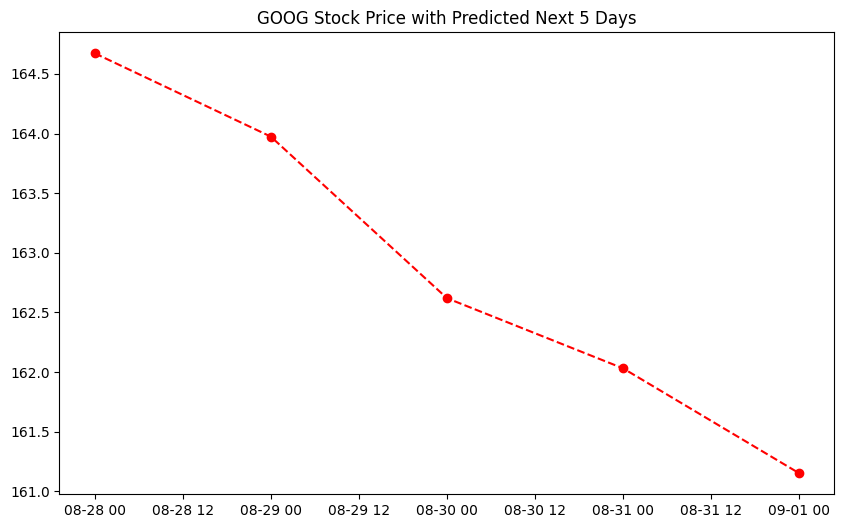

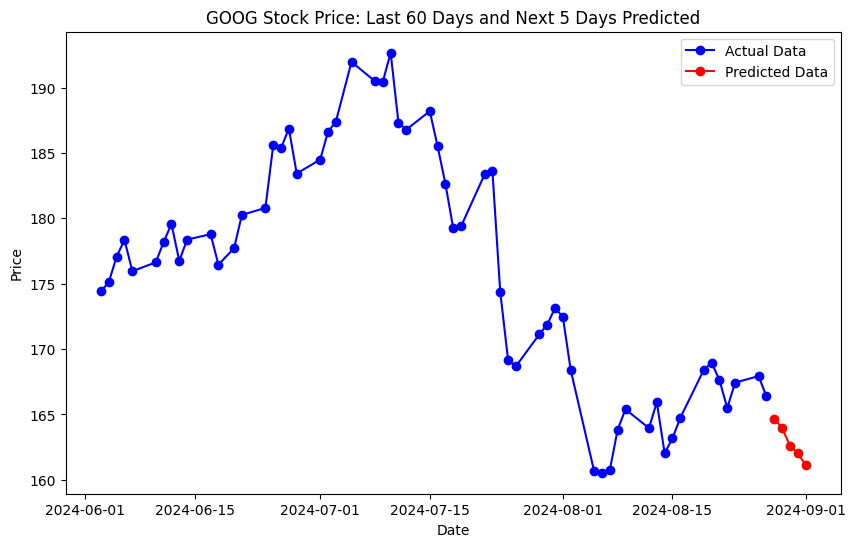

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Day 1 LSTM prediction: 0.5642783045768738
Day 1 CNN prediction: 0.5122672915458679
Day 1 GBM prediction: 0.5681855650084545
Day 1 Combined prediction: 0.5398857685084877
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Day 2 LSTM prediction: 0.5593672394752502
Day 2 CNN prediction: 0.5347827672958374
Day 2 GBM prediction: 0.564622199334705
Day 2 Combined prediction: 0.531597437262998
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Day 3 LSTM prediction: 0.5557828545570374
Day 3 CNN prediction: 0.5598978996276855
Day 3 GBM prediction: 0.5616034669167055
Day 3 Combined prediction: 0.5246863600462494
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
Day 4 LSTM prediction: 0.5531180500984192
Day 4 CNN prediction: 0.5462011098861694
Day 4 GBM prediction: 0.5386188836658797
Day 4 Combined prediction: 0.5237779209519087
1/1 ━━━━━━━━━━━━━━

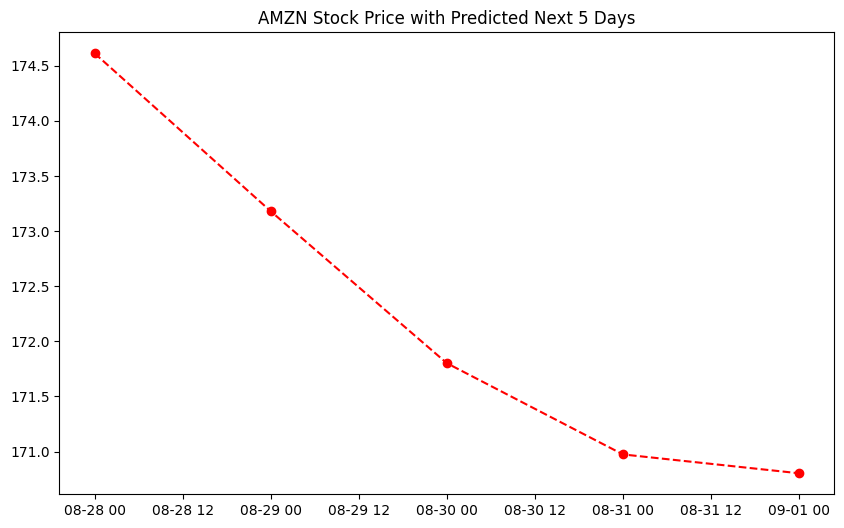

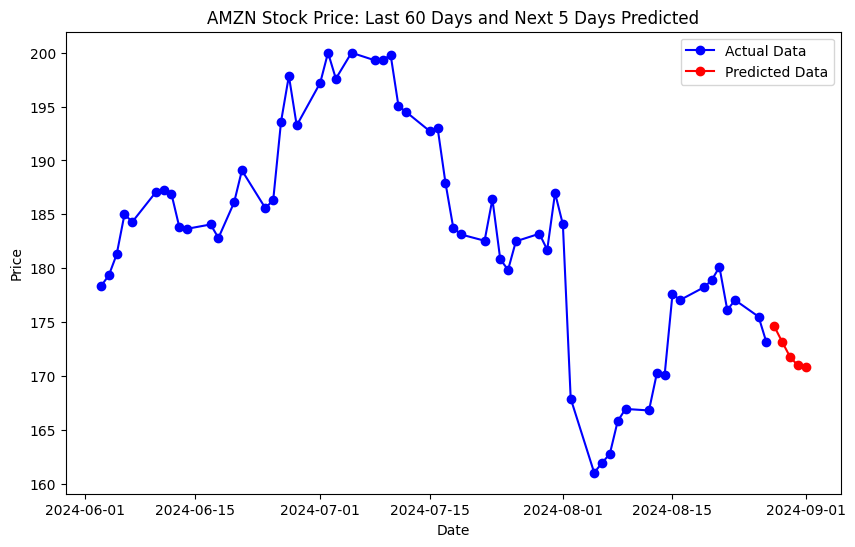

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Day 1 LSTM prediction: 0.6383358240127563
Day 1 CNN prediction: 0.7175054550170898
Day 1 GBM prediction: 0.6420860300738352
Day 1 Combined prediction: 0.6390138663867411
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Day 2 LSTM prediction: 0.6397886872291565
Day 2 CNN prediction: 0.6617661118507385
Day 2 GBM prediction: 0.6510121769516535
Day 2 Combined prediction: 0.6358354964802829
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Day 3 LSTM prediction: 0.6421235799789429
Day 3 CNN prediction: 0.6224245429039001
Day 3 GBM prediction: 0.6337391656299192
Day 3 Combined prediction: 0.6315382554610116
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
Day 4 LSTM prediction: 0.6443721055984497
Day 4 CNN prediction: 0.6676988005638123
Day 4 GBM prediction: 0.6347236976926687
Day 4 Combined prediction: 0.638320823935921
1/1 ━━━━━━━━━━━━━

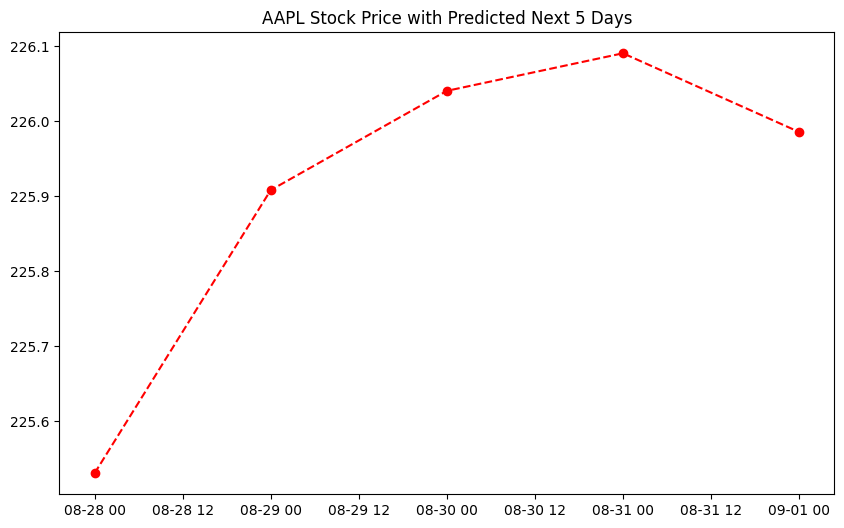

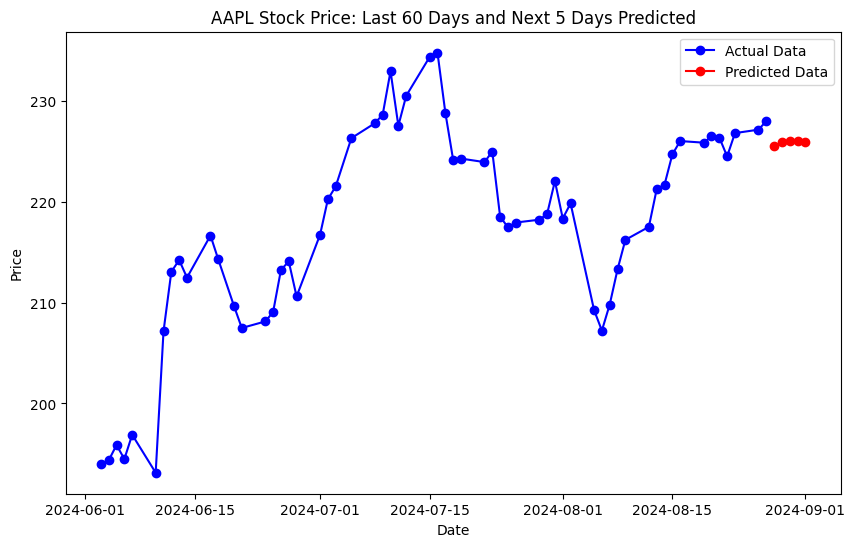

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Day 1 LSTM prediction: 0.8415754437446594
Day 1 CNN prediction: 0.7526375651359558
Day 1 GBM prediction: 0.7547985200263666
Day 1 Combined prediction: 0.8720864873663662
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Day 2 LSTM prediction: 0.8397557139396667
Day 2 CNN prediction: 0.766652524471283
Day 2 GBM prediction: 0.763438980574295
Day 2 Combined prediction: 0.869987947636253
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Day 3 LSTM prediction: 0.83765709400177
Day 3 CNN prediction: 0.7714943885803223
Day 3 GBM prediction: 0.7648097030969647
Day 3 Combined prediction: 0.8676956815236045
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Day 4 LSTM prediction: 0.8354207277297974
Day 4 CNN prediction: 0.7541539669036865
Day 4 GBM prediction: 0.757290531870475
Day 4 Combined prediction: 0.8650443725118033
1/1 ━━━━━━━━━━━━━━━━━━

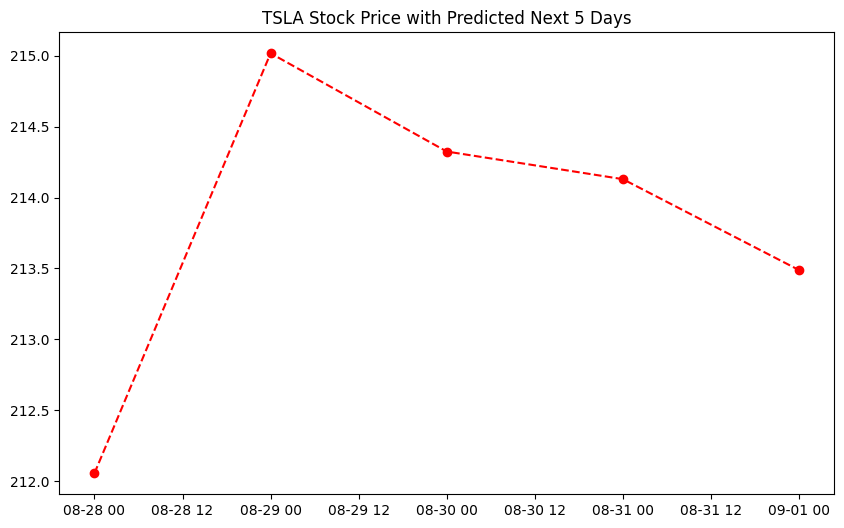

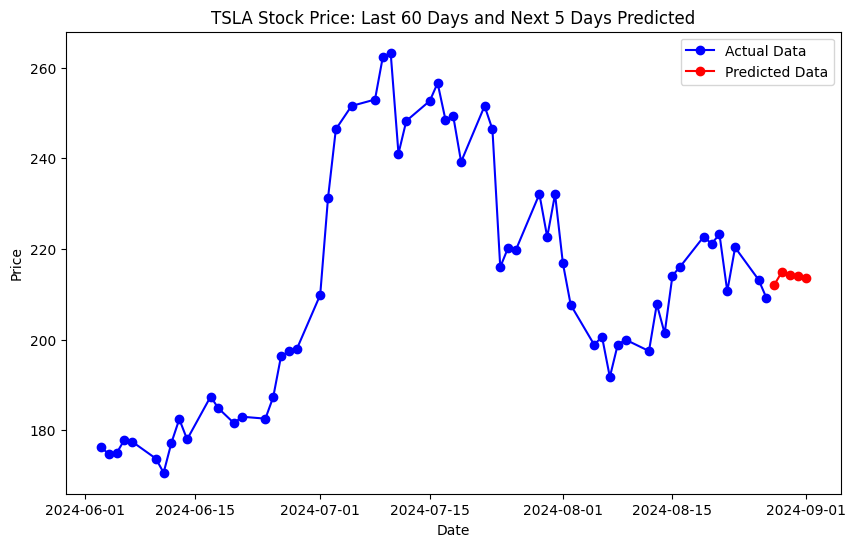

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
Day 1 LSTM prediction: 0.63158118724823
Day 1 CNN prediction: 0.46351292729377747
Day 1 GBM prediction: 0.5297893586207403
Day 1 Combined prediction: 0.5339827717336834
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
Day 2 LSTM prediction: 0.6316344738006592
Day 2 CNN prediction: 0.4585721492767334
Day 2 GBM prediction: 0.5229851683514686
Day 2 Combined prediction: 0.5283900155609044
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
Day 3 LSTM prediction: 0.632824182510376
Day 3 CNN prediction: 0.4658873379230499
Day 3 GBM prediction: 0.5302710286606267
Day 3 Combined prediction: 0.5345479136833605
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
Day 4 LSTM prediction: 0.6348504424095154
Day 4 CNN prediction: 0.41672688722610474
Day 4 GBM prediction: 0.5242270596545934
Day 4 Combined prediction: 0.5296058008113786
1/1 ━━━━━━━━━━━━━

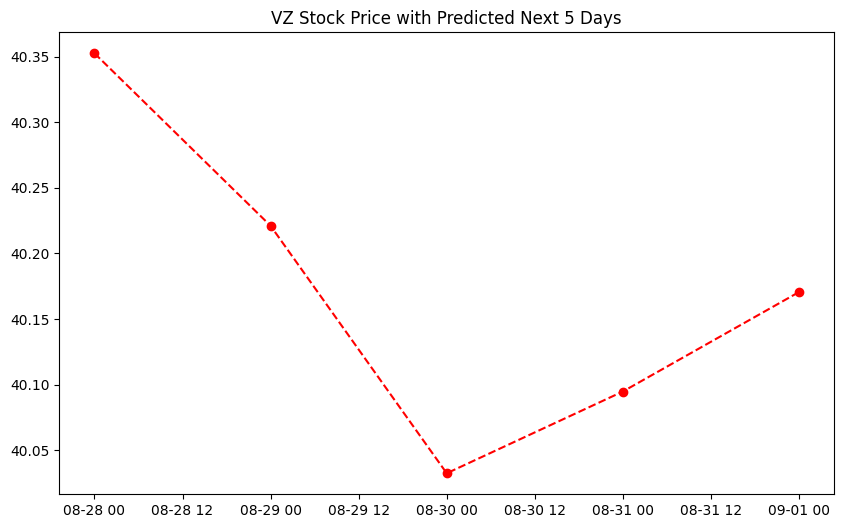

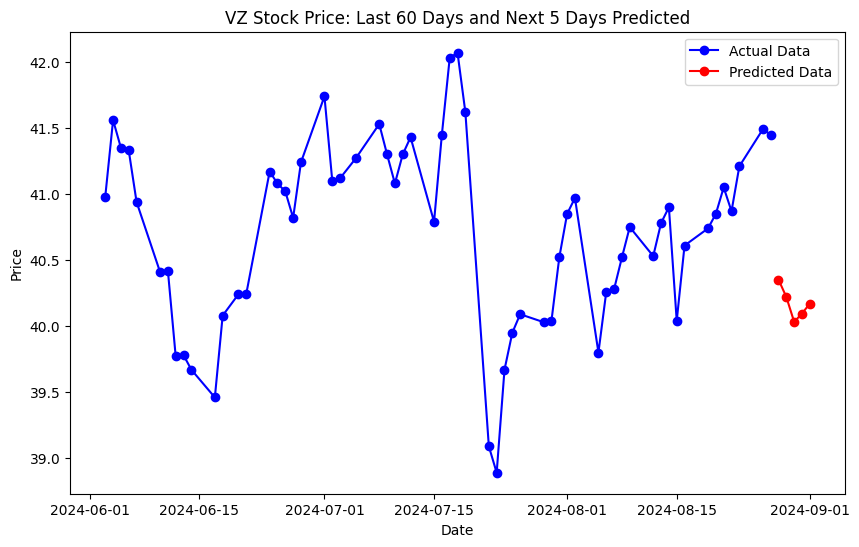

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Day 1 LSTM prediction: 0.8550084829330444
Day 1 CNN prediction: 0.7669289708137512
Day 1 GBM prediction: 0.6727874709727536
Day 1 Combined prediction: 0.774500412241095
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Day 2 LSTM prediction: 0.8514106273651123
Day 2 CNN prediction: 0.8018636107444763
Day 2 GBM prediction: 0.6852238116403434
Day 2 Combined prediction: 0.7916943290508518
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Day 3 LSTM prediction: 0.8482582569122314
Day 3 CNN prediction: 0.8221362829208374
Day 3 GBM prediction: 0.6828108366194724
Day 3 Combined prediction: 0.7943788248653082
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Day 4 LSTM prediction: 0.8456739187240601
Day 4 CNN prediction: 0.7770963907241821
Day 4 GBM prediction: 0.6915797791288075
Day 4 Combined prediction: 0.7899441941192809
1/1 ━━━━━━━━━━━━━

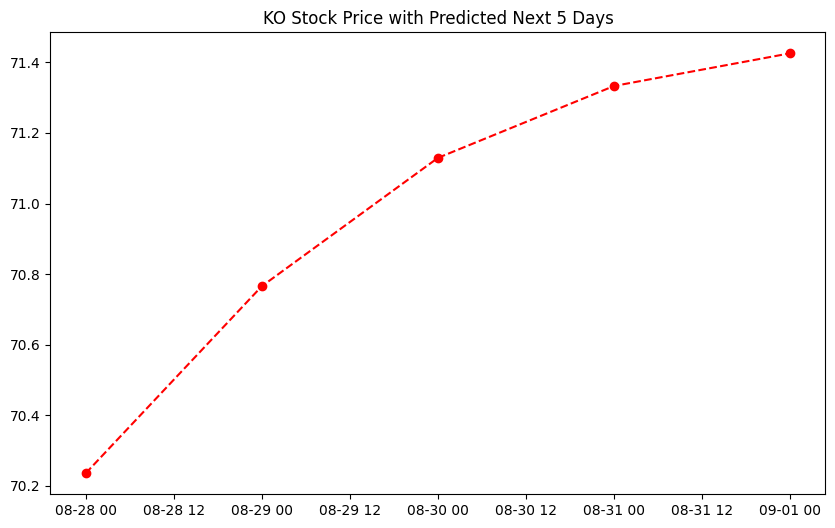

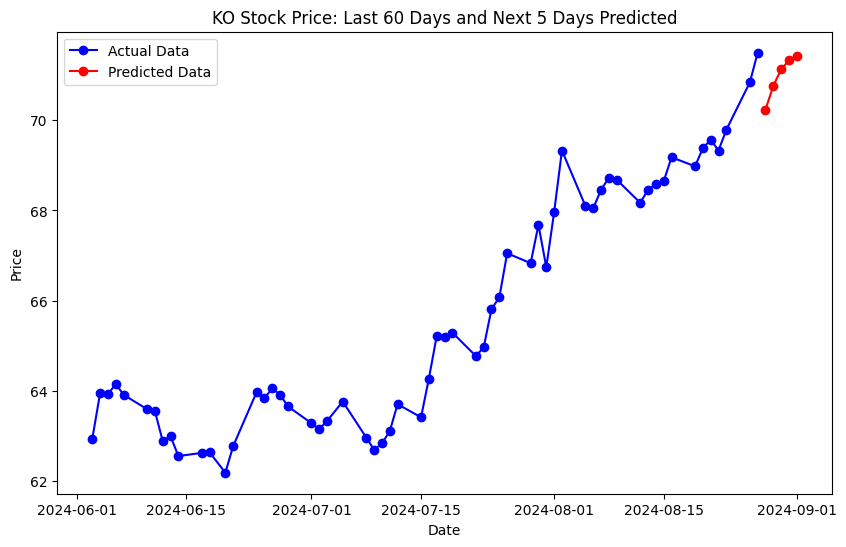

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
Day 1 LSTM prediction: 0.95087730884552
Day 1 CNN prediction: 0.7302089929580688
Day 1 GBM prediction: 0.7542209044667182
Day 1 Combined prediction: 0.9970209257887099
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Day 2 LSTM prediction: 0.9498992562294006
Day 2 CNN prediction: 0.74713534116745
Day 2 GBM prediction: 0.748964085871025
Day 2 Combined prediction: 0.9962554657747724
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Day 3 LSTM prediction: 0.9479861855506897
Day 3 CNN prediction: 0.7304685711860657
Day 3 GBM prediction: 0.7501584717639592
Day 3 Combined prediction: 0.9940071875055154
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
Day 4 LSTM prediction: 0.945775032043457
Day 4 CNN prediction: 0.7138338685035706
Day 4 GBM prediction: 0.7514654650986781
Day 4 Combined prediction: 0.9914339042020912
1/1 ━━━━━━━━━━━━━━━━━━

In [ ]:
# Ensure features list
features = ['Open', 'High', 'Low', 'Close', 'Volume', 'Mkt Cap', 'P/E Ratio', 'Div Yield', 'CDP Score', '52-wk High', '52-wk Low', 'Price Movement']

# Function to check columns
def check_columns(data, features):
    missing_columns = [col for col in features if col not in data.columns]
    if missing_columns:
        raise KeyError(f"Missing columns in data: {missing_columns}")

companies = ['GOOG', 'AMZN', 'AAPL', 'TSLA', 'VZ', 'KO']

# Dictionary to store data for each company
company_data = {}

# Function to print historical data for each company
def print_historical_data(company):
    data = company_data[company]
    print(f"Historical data for {company}:")
    print(data.head())  # Print the first few lines of historical data
    print("\n")

# Load data for each company
for company in companies:
    data = yf.download(company, period='5y', interval='1d')  # Load 10 years of data
    company_data[company] = data
    print(f"{company}: {len(data)} records")  # Debug: print the length of the data
    print_historical_data(company)


# Extended feature engineering function
def feature_engineering(data):
    data['Mkt Cap'] = data['Close'] * data['Volume']
    data['P/E Ratio'] = 20  # Placeholder for P/E ratio
    data['Div Yield'] = 0  # Placeholder for Dividend Yield
    data['CDP Score'] = 5  # Placeholder for CDP score
    data['52-wk High'] = data['Close'].rolling(window=252, min_periods=1).max()
    data['52-wk Low'] = data['Close'].rolling(window=252, min_periods=1).min()
    data['Price Movement'] = data['Close'].diff()
    data.fillna(method='ffill', inplace=True)
    data.fillna(method='bfill', inplace=True)
    return data


# Apply feature engineering to each company's data and check for missing columns
for company in companies:
    data = company_data[company]
    company_data[company] = feature_engineering(data)
    missing_columns = [col for col in features if col not in company_data[company].columns]
    if missing_columns:
        print(f"Missing columns for {company}: {missing_columns}")
    print(f"Columns for {company}: {list(company_data[company].columns)}")  # Debug: print columns to check presence
    print(f"{company} data length: {len(company_data[company])}")  # Debug: print data length to check sufficiency
for company in companies:
    data = yf.download(company, period='5y', interval='1d')  # Load 3 years of data for robustness
    data = feature_engineering(data)
    print(f"Columns after feature engineering for {company}: {data.columns}")  # Debug print
    check_columns(data, features)  # Ensure all necessary columns are present
    company_data[company] = data

# Scaling function
scaler = MinMaxScaler(feature_range=(0, 1))

# Scaling function
def scale_data(data, features):
    scaler = MinMaxScaler()
    scaled_data = scaler.fit_transform(data[features])
    return scaled_data, scaler
# Function to prepare data for modeling
def prepare_data(data, features):
    scaled_data, scaler = scale_data(data, features)
    X, y = [], []
    for i in range(60, len(scaled_data)):
        X.append(scaled_data[i-60:i])
        y.append(scaled_data[i, features.index('Close')])
    X, y = np.array(X), np.array(y)
    train_size = int(len(X) * 0.8)
    X_train, X_test = X[:train_size], X[train_size:]
    y_train, y_test = y[:train_size], y[train_size:]
    X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], X_train.shape[2]))
    return X_train, X_test, y_train, y_test, scaler
def train_lstm_model(X_train, y_train):
    model = Sequential()
    model.add(LSTM(units=50, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
    model.add(Dropout(0.2))
    model.add(LSTM(units=50, return_sequences=False))
    model.add(Dropout(0.2))
    model.add(Dense(units=25))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')
    model.fit(X_train, y_train, epochs=100, batch_size=25, validation_split=0.2, callbacks=[EarlyStopping(monitor='val_loss', patience=10)])
    return model
def train_cnn_model(X_train, y_train):
    input_layer = Input(shape=(X_train.shape[1], X_train.shape[2]))
    conv1 = Conv1D(filters=64, kernel_size=3, activation='relu')(input_layer)
    pool1 = MaxPooling1D(pool_size=2)(conv1)
    flat = Flatten()(pool1)
    cnn_output = Dense(1)(flat)
    cnn_model = Model(inputs=input_layer, outputs=cnn_output)
    cnn_model.compile(optimizer=Adam(learning_rate=0.001), loss='mean_squared_error')
    cnn_history = cnn_model.fit(X_train, y_train, epochs=100, batch_size=25, validation_split=0.2, callbacks=[EarlyStopping(monitor='val_loss', patience=10)])
    return cnn_model
def train_gbm_model(X_train, y_train):
    X_flat_train = X_train.reshape(X_train.shape[0], -1)
    gbm_model = GradientBoostingRegressor(n_estimators=100)
    gbm_model.fit(X_flat_train, y_train)
    return gbm_model

# Meta-model training function
def train_meta_model(lstm_predictions, cnn_predictions, gbm_predictions, y_test):
    train_meta_features = np.vstack((lstm_predictions, cnn_predictions, gbm_predictions)).T
    meta_model = LinearRegression()
    meta_model.fit(train_meta_features, y_test)
    return meta_model
# Evaluate model function
def evaluate_model(model, X_test, y_test, model_name):
    predictions_test = model.predict(X_test).flatten()
    mse = mean_squared_error(y_test, predictions_test)
    print(f"{model_name} Model Mean Squared Error: {mse}")
    return predictions_test, mse

## Train and evaluate models for each company
model_results = {}

for company in companies:
    data = company_data[company]
    X_train, X_test, y_train, y_test, scaler = prepare_data(data, features)

    # Train models
    lstm_model = train_lstm_model(X_train, y_train)
    cnn_model = train_cnn_model(X_train, y_train)
    gbm_model = train_gbm_model(X_train, y_train)

    # Evaluate models
    lstm_predictions, lstm_mse = evaluate_model(lstm_model, X_test, y_test, "LSTM")
    cnn_predictions, cnn_mse = evaluate_model(cnn_model, X_test, y_test, "CNN")
    gbm_predictions, gbm_mse = evaluate_model(gbm_model, X_test.reshape(X_test.shape[0], -1), y_test, "GBM")

    # Train meta-model
    meta_model = train_meta_model(lstm_predictions, cnn_predictions, gbm_predictions, y_test)

    # Making predictions with the meta-model
    test_meta_features = np.vstack((lstm_predictions, cnn_predictions, gbm_predictions)).T
    y_pred = meta_model.predict(test_meta_features)

    # Reshape y_pred and y_test to be 2D arrays
    y_pred = y_pred.reshape(-1, 1)
    y_test = y_test.reshape(-1, 1)

    # Calculating MAE and RMSE
    mae = mean_absolute_error(y_test, y_pred)
    rmse = mean_squared_error(y_test, y_pred, squared=False)

    # Calculating R^2 Score
    r2 = r2_score(y_test, y_pred)

    model_results[company] = {
        "lstm_model": lstm_model,
        "cnn_model": cnn_model,
        "gbm_model": gbm_model,
        "meta_model": meta_model,
        "lstm_model_mse": lstm_mse,
        "cnn_model_mse": cnn_mse,
        "gbm_model_mse": gbm_mse,
        "mae": mae,
        "rmse": rmse,
        "r2": r2
    }
def scale_data(data, features):
    from sklearn.preprocessing import MinMaxScaler

    scaler = MinMaxScaler()
    scaled_data = scaler.fit_transform(data[features])

    return scaled_data, scaler

from sklearn.preprocessing import MinMaxScaler

def scale_data(data, features):
    scaler = MinMaxScaler()
    scaled_data = scaler.fit_transform(data[features])
    return scaled_data, scaler
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def predict_future_prices(company, model_results, days=5, start_date=None, end_date=None):
    lstm_model = model_results[company]['lstm_model']
    cnn_model = model_results[company]['cnn_model']
    gbm_model = model_results[company]['gbm_model']
    meta_model = model_results[company]['meta_model']

    data = company_data[company]

    if start_date:
        data = data[data.index >= start_date]
    if end_date:
        data = data[data.index <= end_date]

    scaled_data, scaler = scale_data(data, features)
    current_batch = scaled_data[-60:].reshape(1, 60, len(features))  # Most recent 60 days

    predicted_prices = []

    for i in range(days):
        lstm_pred = lstm_model.predict(current_batch).flatten()
        cnn_pred = cnn_model.predict(current_batch).flatten()
        gbm_pred = gbm_model.predict(current_batch.reshape((1, -1))).flatten()

        combined_pred = np.hstack((lstm_pred, cnn_pred, gbm_pred))
        next_prediction = meta_model.predict(combined_pred.reshape(1, -1))

        next_prediction_full = np.zeros((1, len(features)))
        next_prediction_full[0, features.index('Close')] = next_prediction.item()  # Convert to scalar
        predicted_prices.append(scaler.inverse_transform(next_prediction_full)[0])

        # Update current_batch with the new prediction
        next_prediction_reshaped = current_batch[:, -1, :].copy()
        next_prediction_reshaped[0, features.index('Close')] = next_prediction.item()  # Convert to scalar
        current_batch = np.append(current_batch[:, 1:, :], next_prediction_reshaped.reshape(1, 1, len(features)), axis=1)

    predicted_prices = np.array(predicted_prices)

    if predicted_prices.size == 0:
        raise ValueError("Predicted prices array is empty.")

    predicted_close_prices = predicted_prices[:, features.index('Close')].reshape(-1, 1)

    print(f"Predicted Stock Prices for the next {days} days for {company}: ", predicted_close_prices)

    last_date = data.index[-1]
    next_day = last_date + pd.Timedelta(days=1)
    prediction_dates = pd.date_range(start=next_day, periods=days)

    predicted_data = pd.DataFrame(index=prediction_dates, data=predicted_close_prices, columns=['Close'])

    # Plotting the predicted data
    plt.figure(figsize=(10, 6))
    plt.plot(predicted_data.index, predicted_data['Close'], linestyle='dashed', marker='o', color='red')
    plt.title(f"{company} Stock Price with Predicted Next {days} Days")
    plt.show()

    # Plotting the actual data and predicted data for the last 60 days and next days
    plt.figure(figsize=(10, 6))
    plt.plot(data.index[-60:], data['Close'][-60:], linestyle='-', marker='o', color='blue', label='Actual Data')
    plt.plot(prediction_dates, predicted_data['Close'], linestyle='-', marker='o', color='red', label='Predicted Data')
    plt.title(f"{company} Stock Price: Last 60 Days and Next {days} Days Predicted")
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.legend()
    plt.show()

    # Print detailed predictions for each model
    for day in range(days):
        lstm_pred = lstm_model.predict(current_batch).flatten()
        cnn_pred = cnn_model.predict(current_batch).flatten()
        gbm_pred = gbm_model.predict(current_batch.reshape((1, -1))).flatten()

        combined_pred = np.hstack((lstm_pred, cnn_pred, gbm_pred))
        combined_pred_final = meta_model.predict(combined_pred.reshape(1, -1))

        print(f"Day {day+1} LSTM prediction: {lstm_pred[0]}")
        print(f"Day {day+1} CNN prediction: {cnn_pred[0]}")
        print(f"Day {day+1} GBM prediction: {gbm_pred[0]}")
        print(f"Day {day+1} Combined prediction: {combined_pred_final[0]}")

        next_prediction_full = np.zeros((1, len(features)))
        next_prediction_full[0, features.index('Close')] = combined_pred_final.item()  # Convert to scalar
        next_prediction_reshaped = current_batch[:, -1, :].copy()
        next_prediction_reshaped[0, features.index('Close')] = combined_pred_final.item()  # Convert to scalar
        current_batch = np.append(current_batch[:, 1:, :], next_prediction_reshaped.reshape(1, 1, len(features)), axis=1)

    # Print evaluation metrics
    print(f"LSTM Model Mean Squared Error: {model_results[company]['lstm_model_mse']}")
    print(f"CNN Model Mean Squared Error: {model_results[company]['cnn_model_mse']}")
    print(f"GBM Model Mean Squared Error: {model_results[company]['gbm_model_mse']}")
    print(f"Mean Absolute Error: {model_results[company]['mae']}")
    print(f"Root Mean Square Error: {model_results[company]['rmse']}")
    print(f"R^2 Score: {model_results[company]['r2']}")
    accuracy = (1 - model_results[company]['rmse']) * 100
    print(f"Accuracy: {accuracy:.2f}%")

# Call the prediction function for all companies
for company in companies:
    predict_future_prices(company, model_results, days=5, start_date='2023-08-27', end_date='2024-08-27')


Predictions for GOOG for the next 4 days:
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
Predicted Stock Prices for the next 4 days for GOOG:  [[163.46497952]
 [164.29654667]
 [165.5838142 ]
 [165.92157471]]


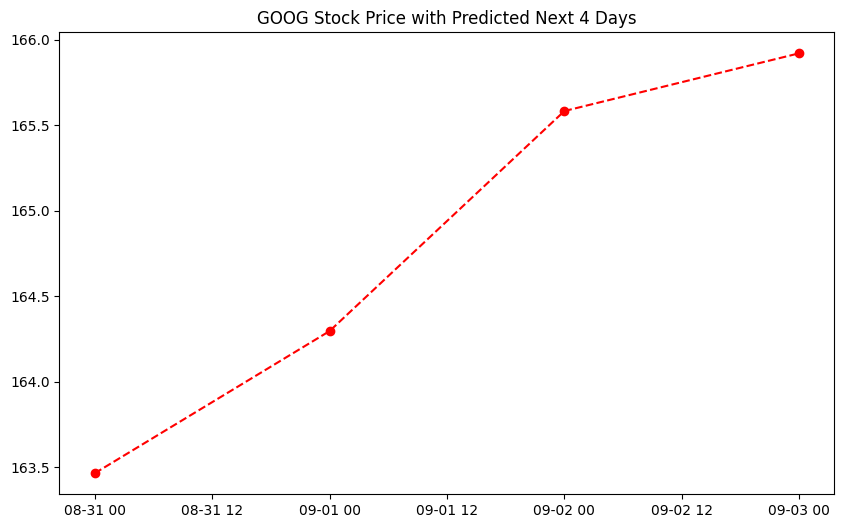

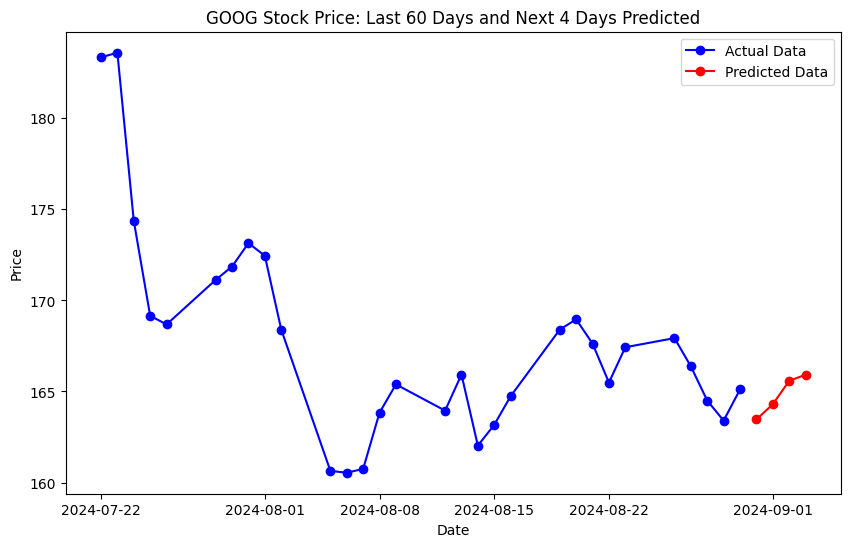

LSTM Model Mean Squared Error: 0.0008061904690427788
CNN Model Mean Squared Error: 0.009540665794479986
GBM Model Mean Squared Error: 0.01687224324592444
Mean Absolute Error: 0.014898880719729073
Root Mean Square Error: 0.02086482931349318
R^2 Score: 0.9737823808356434
Accuracy: 97.91%

Predictions for GOOG for the next 30 days:
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━

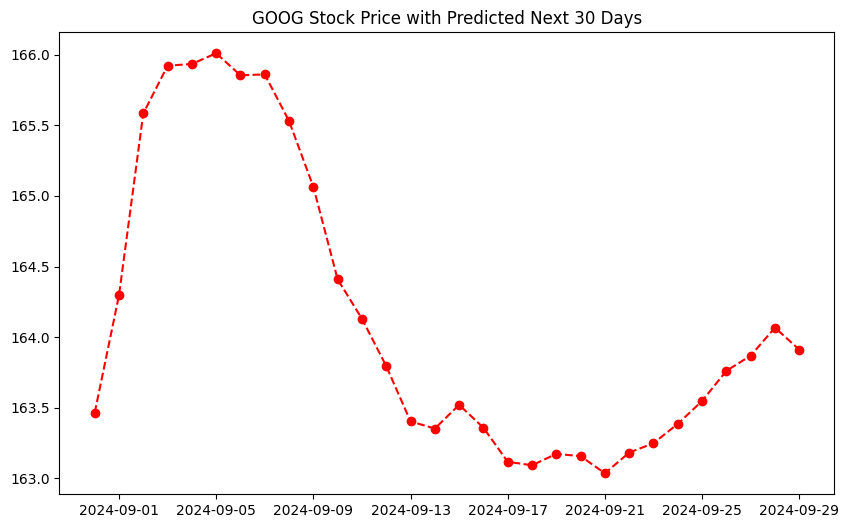

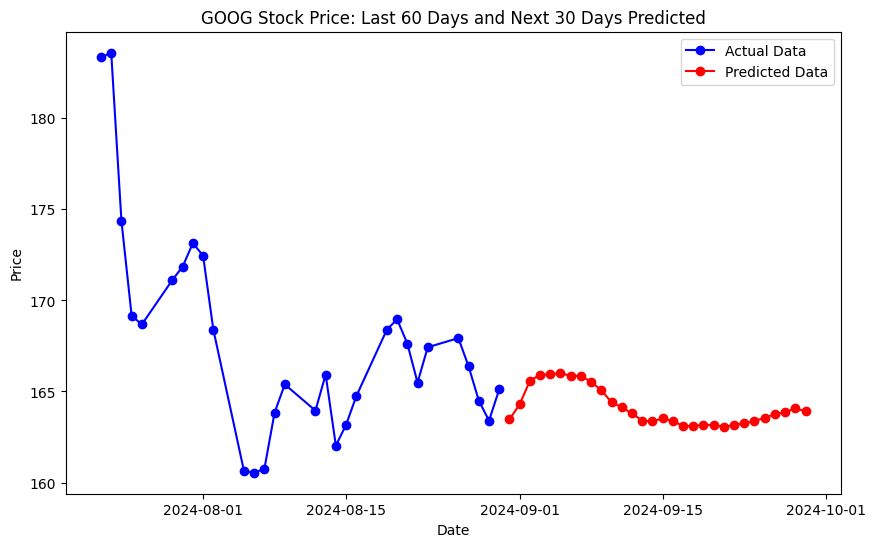

LSTM Model Mean Squared Error: 0.0008061904690427788
CNN Model Mean Squared Error: 0.009540665794479986
GBM Model Mean Squared Error: 0.01687224324592444
Mean Absolute Error: 0.014898880719729073
Root Mean Square Error: 0.02086482931349318
R^2 Score: 0.9737823808356434
Accuracy: 97.91%

Predictions for GOOG for the next 60 days:
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━

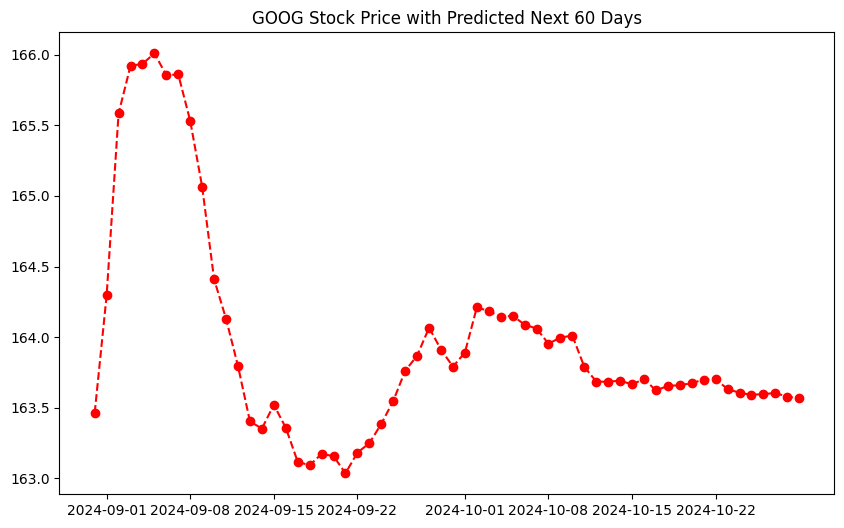

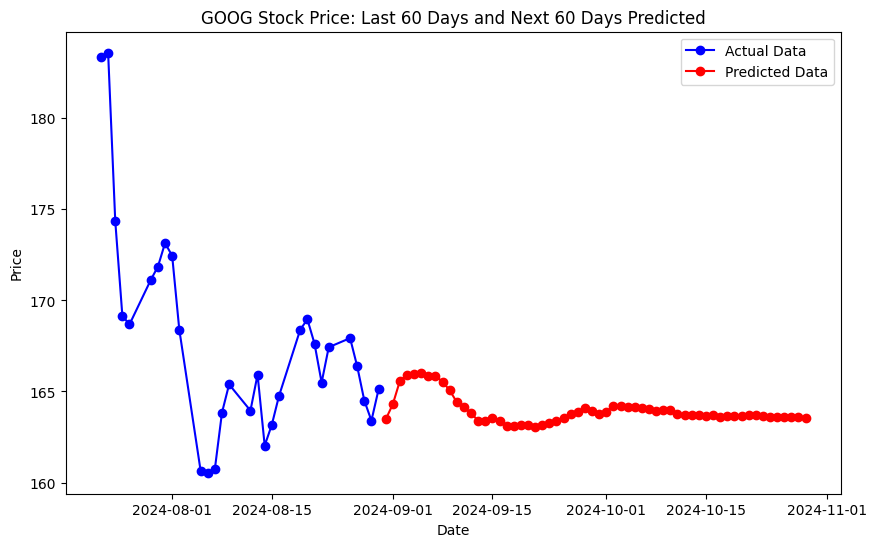

LSTM Model Mean Squared Error: 0.0008061904690427788
CNN Model Mean Squared Error: 0.009540665794479986
GBM Model Mean Squared Error: 0.01687224324592444
Mean Absolute Error: 0.014898880719729073
Root Mean Square Error: 0.02086482931349318
R^2 Score: 0.9737823808356434
Accuracy: 97.91%

Predictions for AMZN for the next 4 days:
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Predicted Stock Prices for the next 4 days for AMZN:  [[175.6315827 ]
 [179.12182588]
 [181.41883176]
 [182.27712783]]


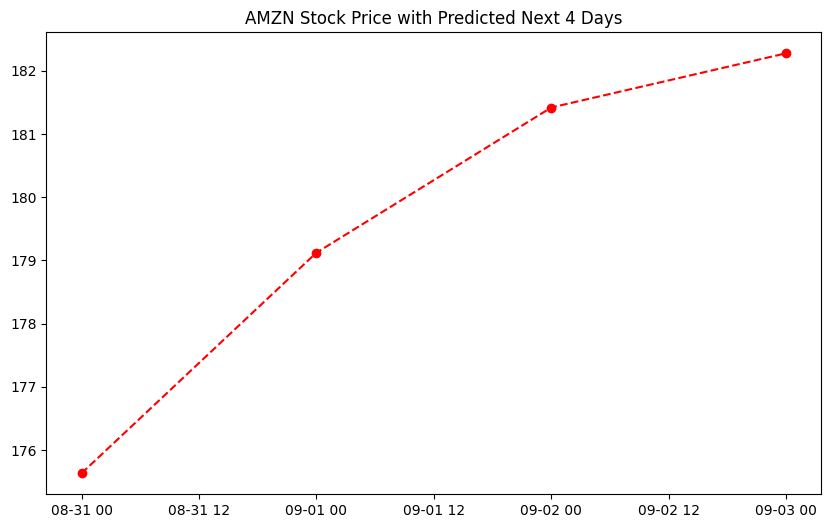

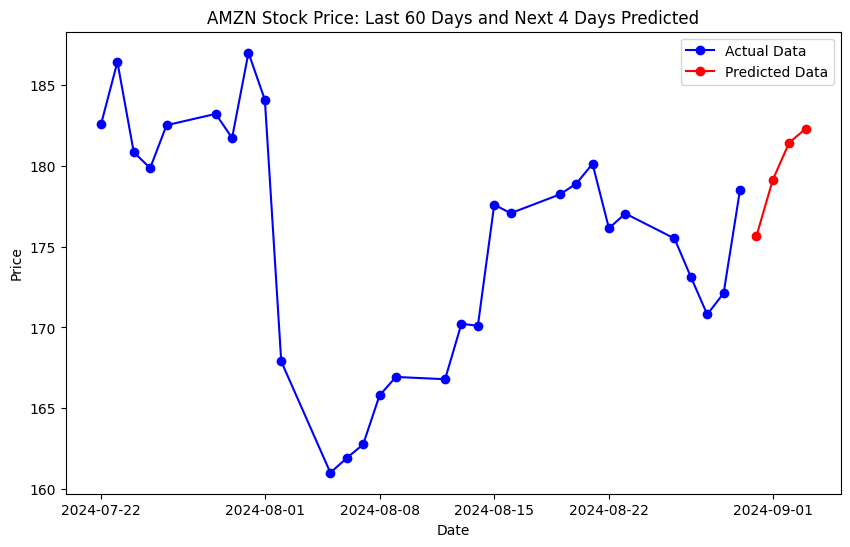

LSTM Model Mean Squared Error: 0.0010646817269858255
CNN Model Mean Squared Error: 0.0033516733224565293
GBM Model Mean Squared Error: 0.002169874557440561
Mean Absolute Error: 0.019504693452350362
Root Mean Square Error: 0.026383193458496802
R^2 Score: 0.9774886773285675
Accuracy: 97.36%

Predictions for AMZN for the next 30 days:
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━

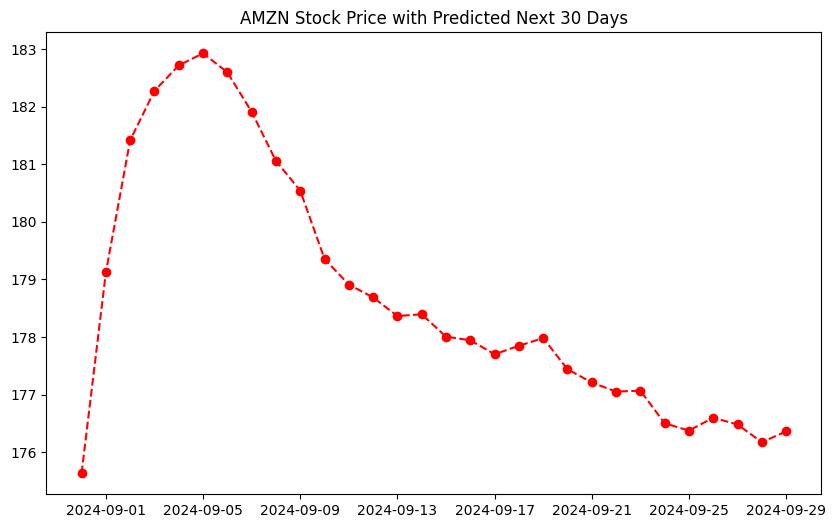

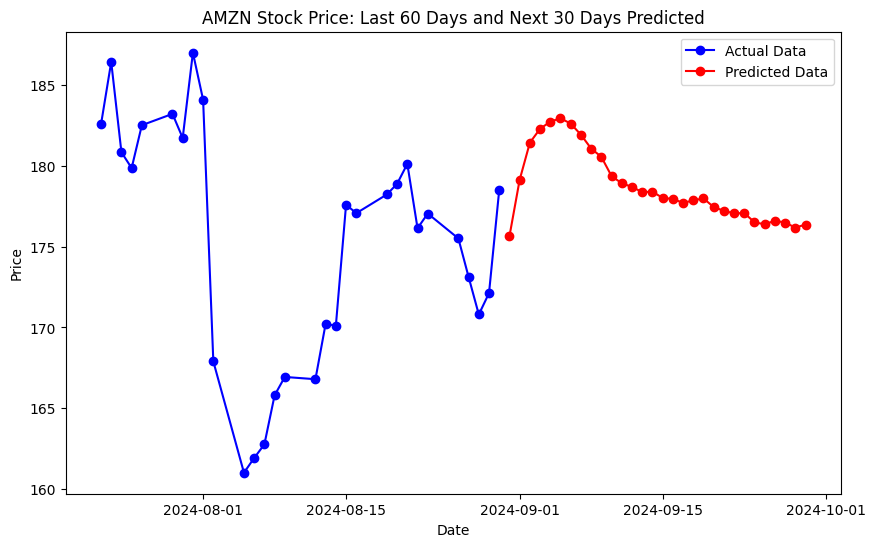

LSTM Model Mean Squared Error: 0.0010646817269858255
CNN Model Mean Squared Error: 0.0033516733224565293
GBM Model Mean Squared Error: 0.002169874557440561
Mean Absolute Error: 0.019504693452350362
Root Mean Square Error: 0.026383193458496802
R^2 Score: 0.9774886773285675
Accuracy: 97.36%

Predictions for AMZN for the next 60 days:
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━

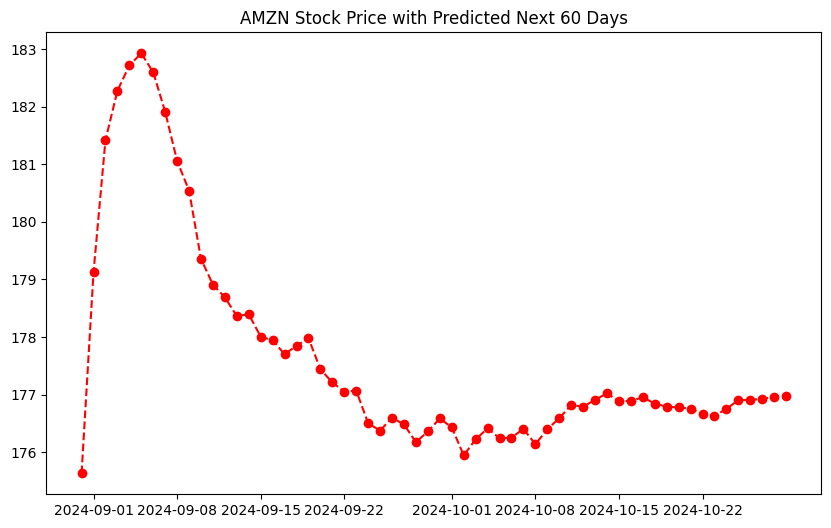

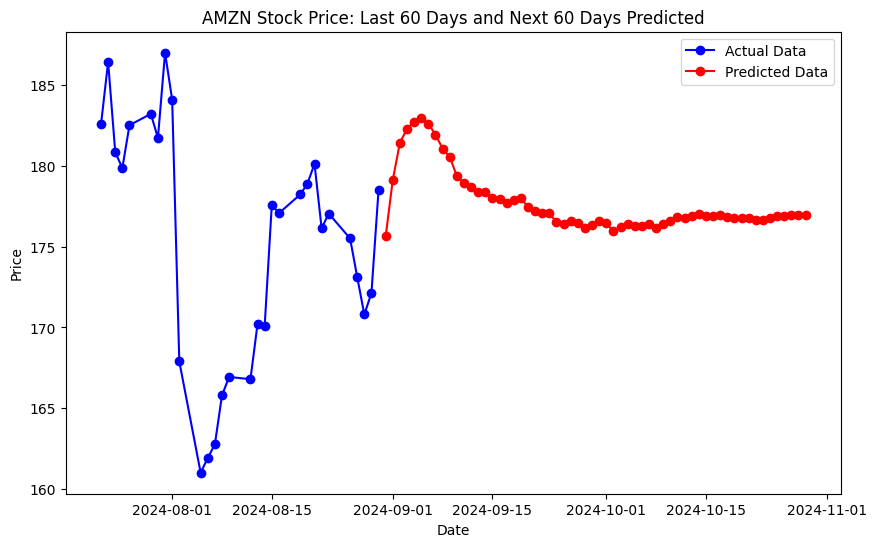

LSTM Model Mean Squared Error: 0.0010646817269858255
CNN Model Mean Squared Error: 0.0033516733224565293
GBM Model Mean Squared Error: 0.002169874557440561
Mean Absolute Error: 0.019504693452350362
Root Mean Square Error: 0.026383193458496802
R^2 Score: 0.9774886773285675
Accuracy: 97.36%

Predictions for AAPL for the next 4 days:
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Predicted Stock Prices for the next 4 days for AAPL:  [[228.03111232]
 [227.59475266]
 [227.24040718]
 [226.93263004]]


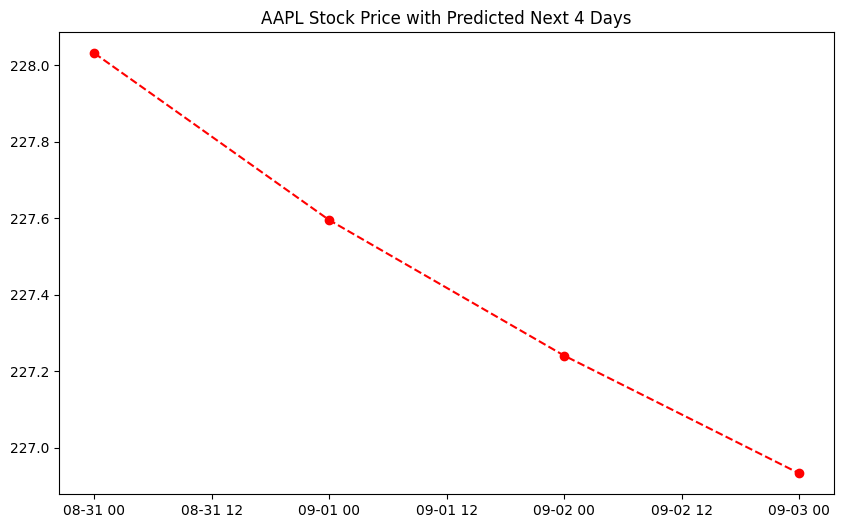

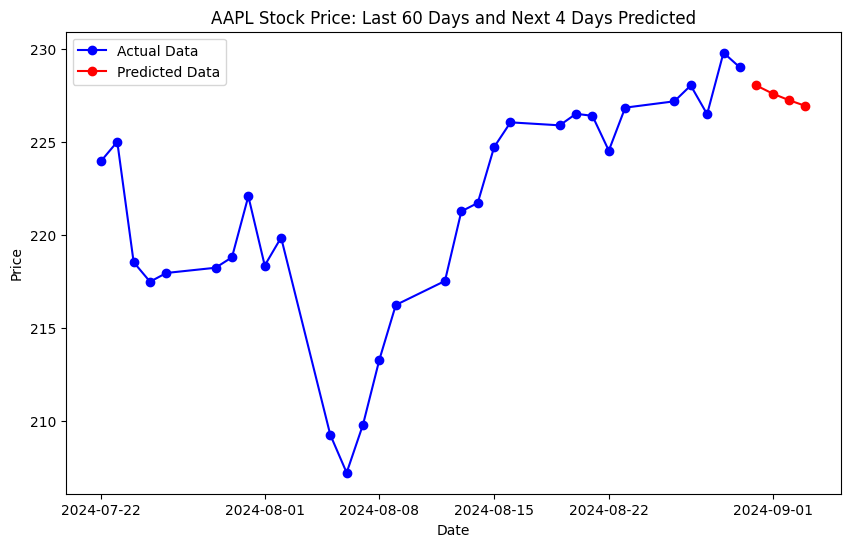

LSTM Model Mean Squared Error: 0.0007340832038496473
CNN Model Mean Squared Error: 0.005659139437645986
GBM Model Mean Squared Error: 0.006326662868713602
Mean Absolute Error: 0.012348391132442979
Root Mean Square Error: 0.016621848827102926
R^2 Score: 0.9731640218605033
Accuracy: 98.34%

Predictions for AAPL for the next 30 days:
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━

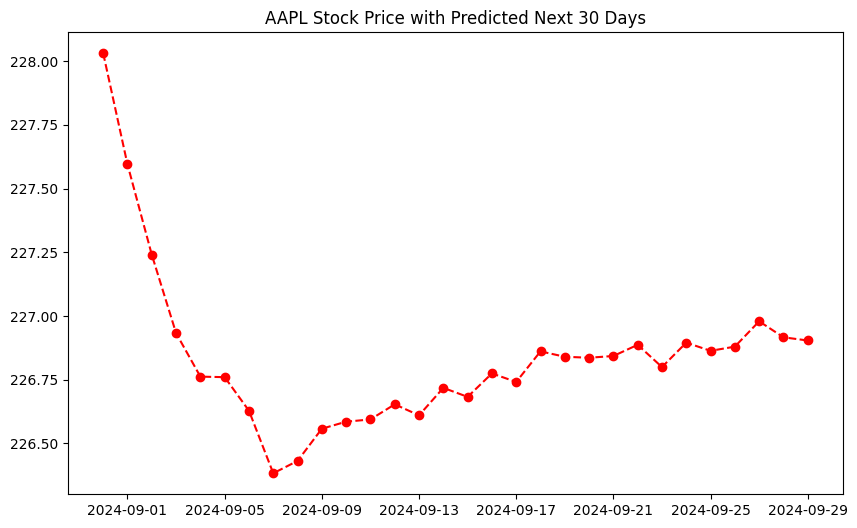

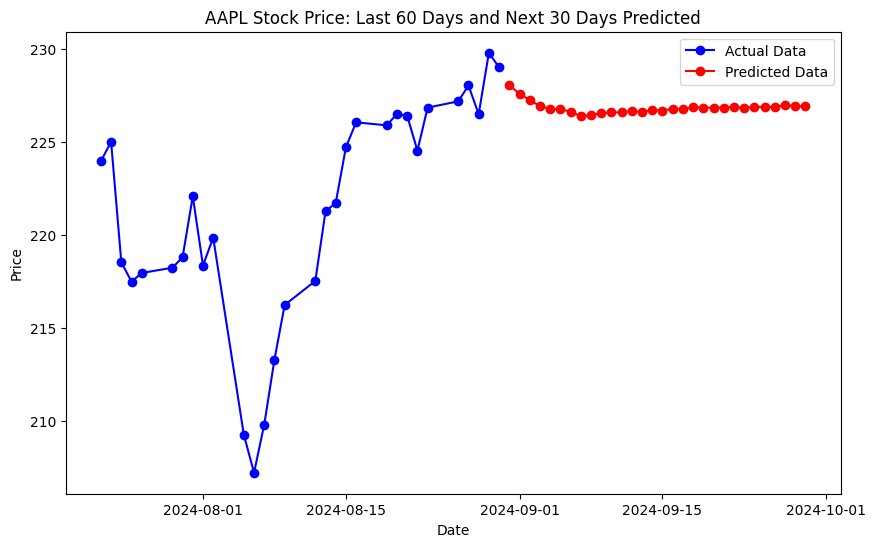

LSTM Model Mean Squared Error: 0.0007340832038496473
CNN Model Mean Squared Error: 0.005659139437645986
GBM Model Mean Squared Error: 0.006326662868713602
Mean Absolute Error: 0.012348391132442979
Root Mean Square Error: 0.016621848827102926
R^2 Score: 0.9731640218605033
Accuracy: 98.34%

Predictions for AAPL for the next 60 days:
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━

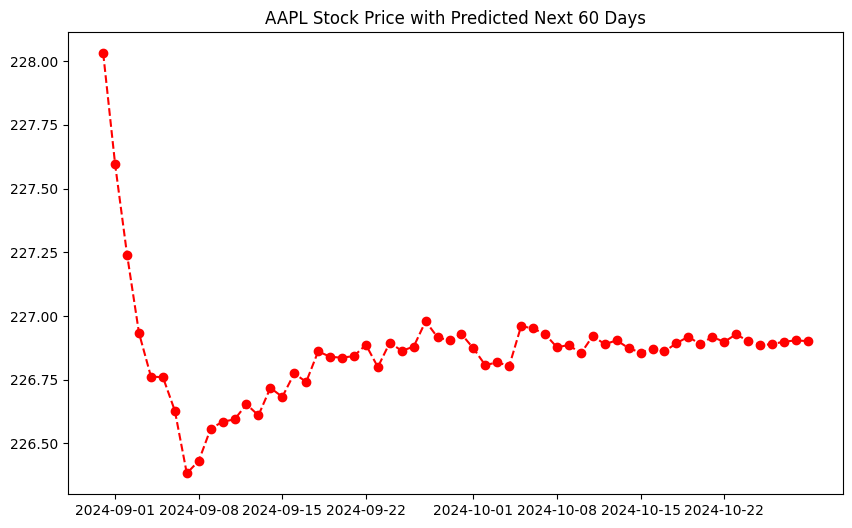

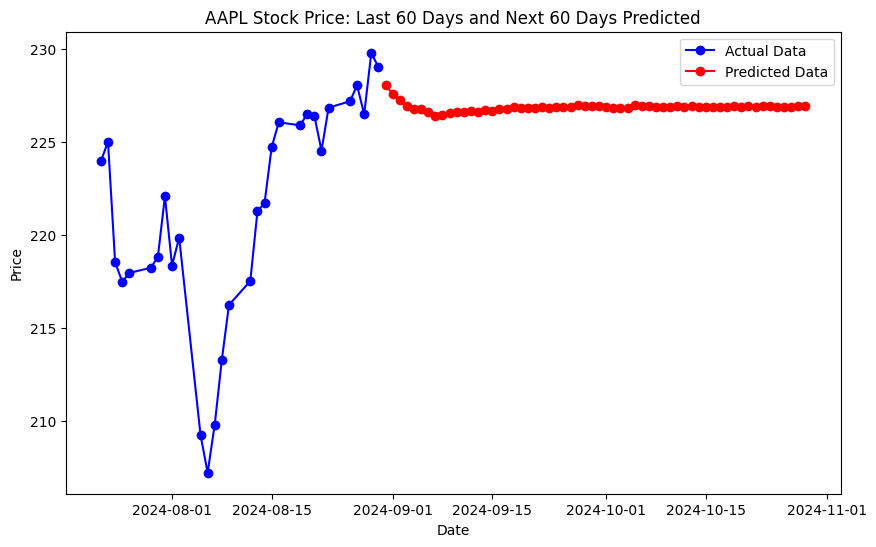

LSTM Model Mean Squared Error: 0.0007340832038496473
CNN Model Mean Squared Error: 0.005659139437645986
GBM Model Mean Squared Error: 0.006326662868713602
Mean Absolute Error: 0.012348391132442979
Root Mean Square Error: 0.016621848827102926
R^2 Score: 0.9731640218605033
Accuracy: 98.34%

Predictions for TSLA for the next 4 days:
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
Predicted Stock Prices for the next 4 days for TSLA:  [[212.92061894]
 [215.34752852]
 [216.52429258]
 [219.10311253]]


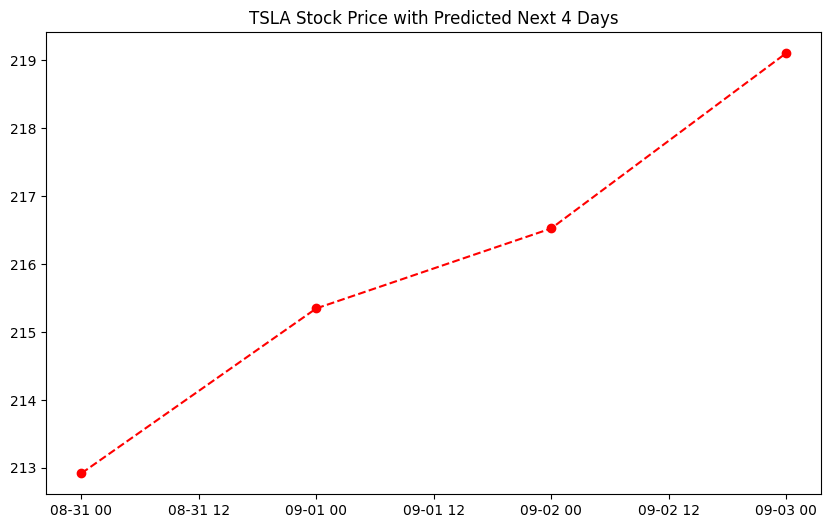

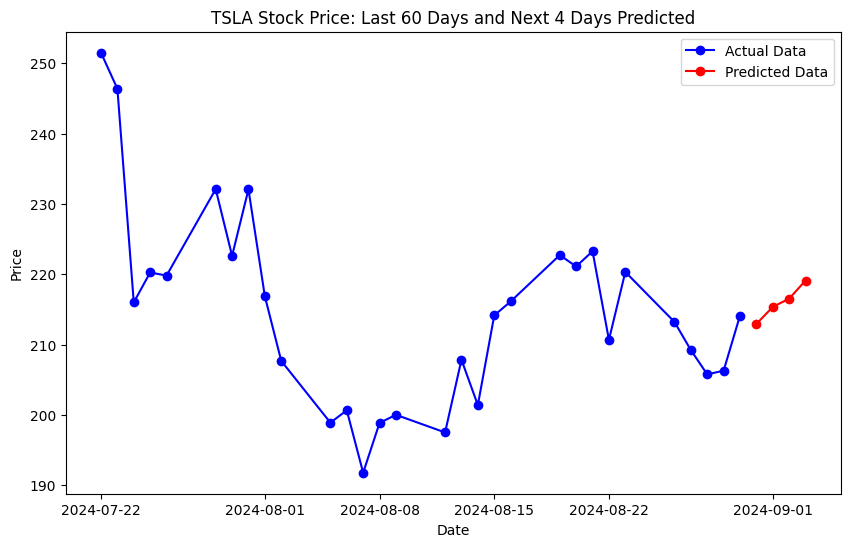

LSTM Model Mean Squared Error: 0.0016387154716679662
CNN Model Mean Squared Error: 0.003287996041599621
GBM Model Mean Squared Error: 0.00037753450284257867
Mean Absolute Error: 0.013950064763221692
Root Mean Square Error: 0.018914874231059874
R^2 Score: 0.9432987462551479
Accuracy: 98.11%

Predictions for TSLA for the next 30 days:
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━

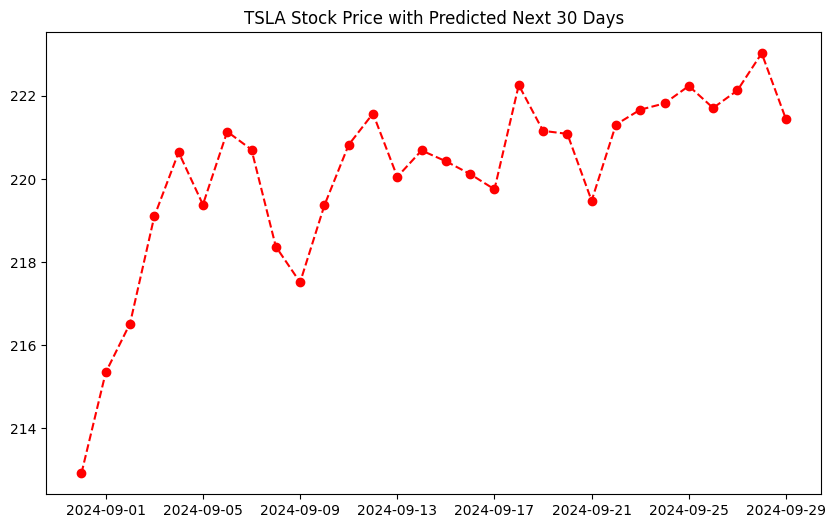

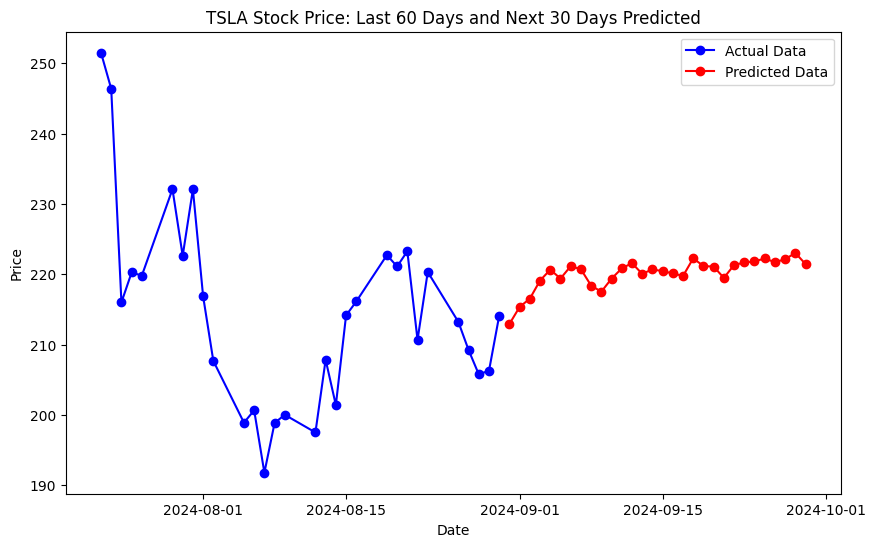

LSTM Model Mean Squared Error: 0.0016387154716679662
CNN Model Mean Squared Error: 0.003287996041599621
GBM Model Mean Squared Error: 0.00037753450284257867
Mean Absolute Error: 0.013950064763221692
Root Mean Square Error: 0.018914874231059874
R^2 Score: 0.9432987462551479
Accuracy: 98.11%

Predictions for TSLA for the next 60 days:
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━

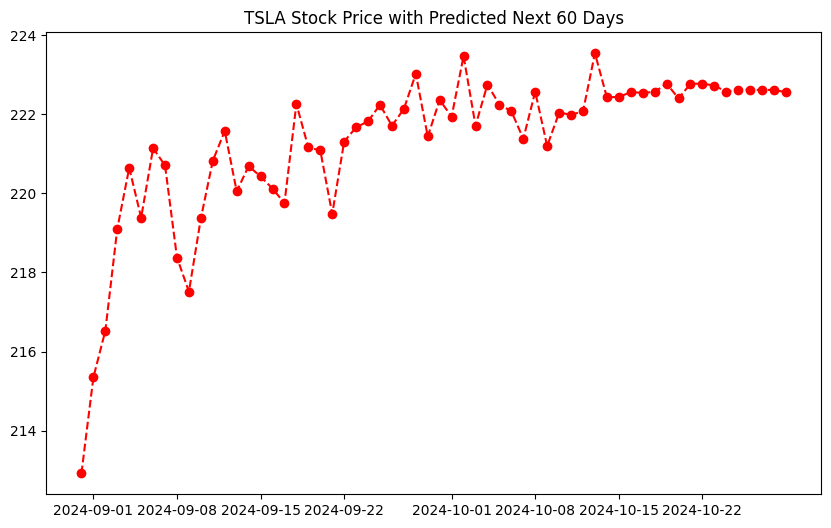

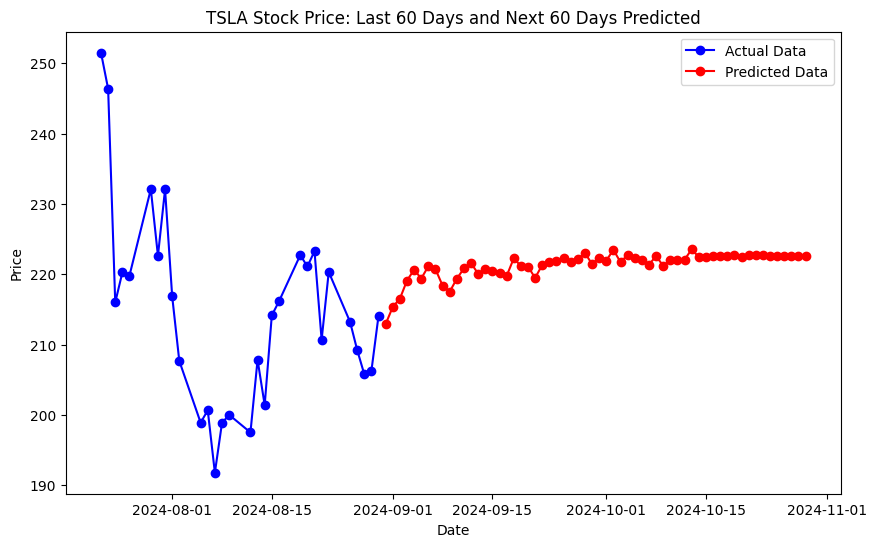

LSTM Model Mean Squared Error: 0.0016387154716679662
CNN Model Mean Squared Error: 0.003287996041599621
GBM Model Mean Squared Error: 0.00037753450284257867
Mean Absolute Error: 0.013950064763221692
Root Mean Square Error: 0.018914874231059874
R^2 Score: 0.9432987462551479
Accuracy: 98.11%

Predictions for VZ for the next 4 days:
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
Predicted Stock Prices for the next 4 days for VZ:  [[41.58128873]
 [41.88655566]
 [41.72993096]
 [41.90289339]]


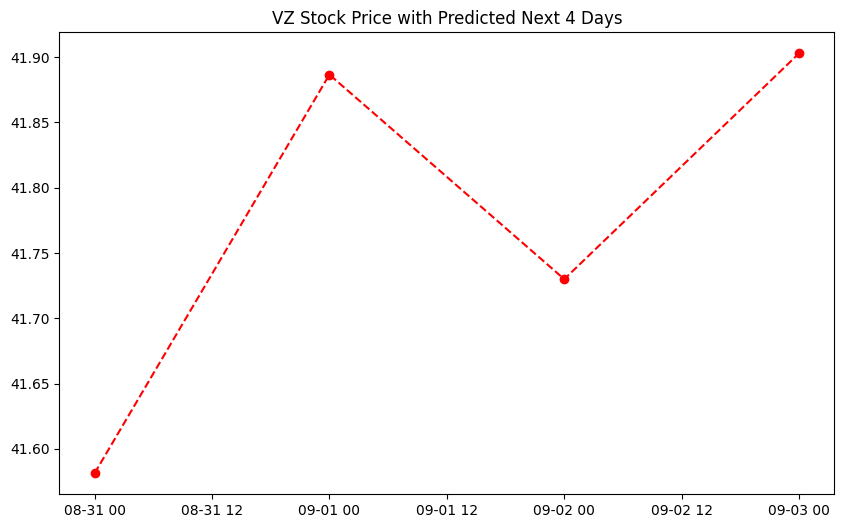

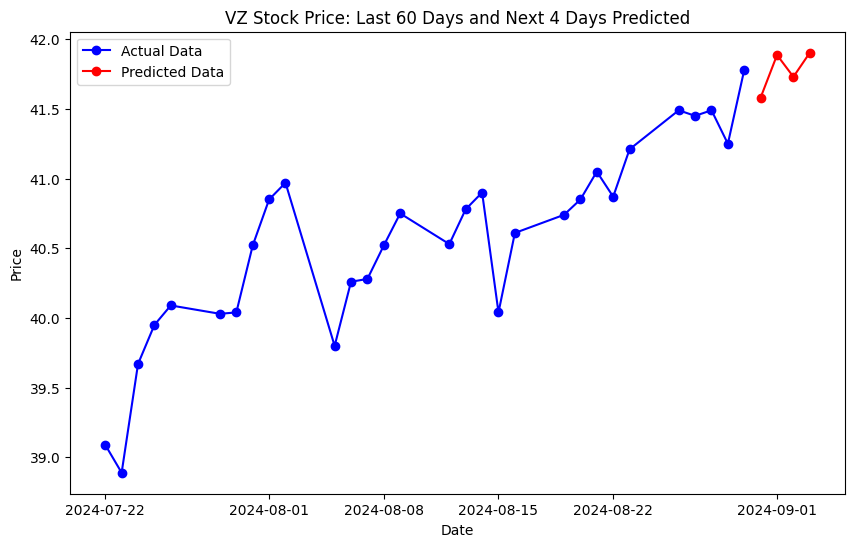

LSTM Model Mean Squared Error: 0.0035451790849159188
CNN Model Mean Squared Error: 0.0035977914607519625
GBM Model Mean Squared Error: 0.0008295526196015026
Mean Absolute Error: 0.018839228378955224
Root Mean Square Error: 0.024207044693906797
R^2 Score: 0.93309174500163
Accuracy: 97.58%

Predictions for VZ for the next 30 days:
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━

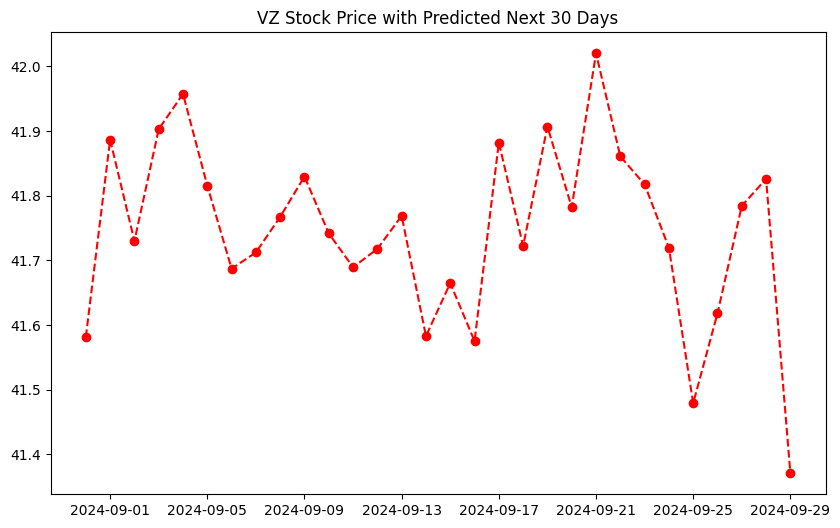

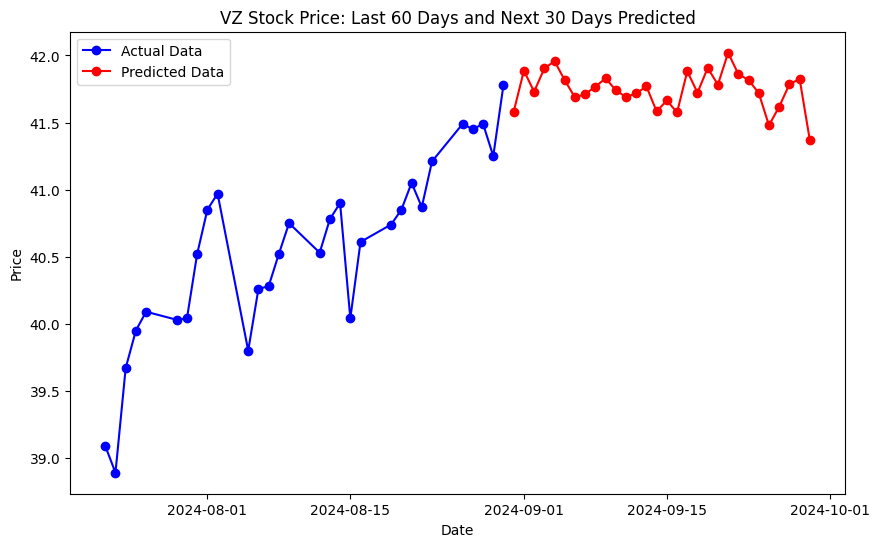

LSTM Model Mean Squared Error: 0.0035451790849159188
CNN Model Mean Squared Error: 0.0035977914607519625
GBM Model Mean Squared Error: 0.0008295526196015026
Mean Absolute Error: 0.018839228378955224
Root Mean Square Error: 0.024207044693906797
R^2 Score: 0.93309174500163
Accuracy: 97.58%

Predictions for VZ for the next 60 days:
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━

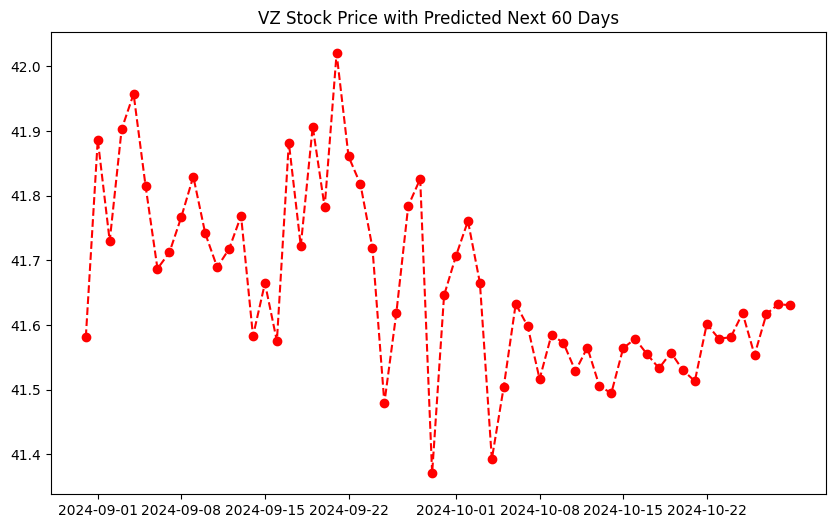

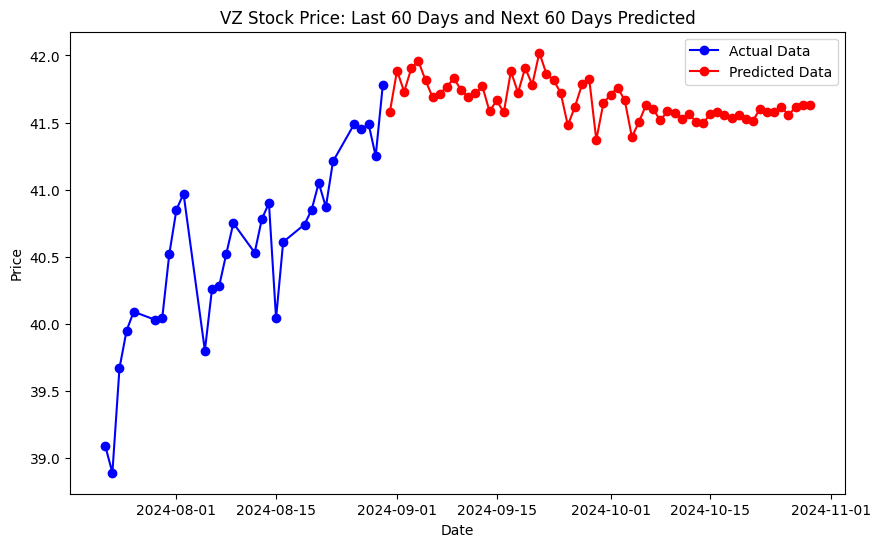

LSTM Model Mean Squared Error: 0.0035451790849159188
CNN Model Mean Squared Error: 0.0035977914607519625
GBM Model Mean Squared Error: 0.0008295526196015026
Mean Absolute Error: 0.018839228378955224
Root Mean Square Error: 0.024207044693906797
R^2 Score: 0.93309174500163
Accuracy: 97.58%

Predictions for KO for the next 4 days:
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Predicted Stock Prices for the next 4 days for KO:  [[72.69564152]
 [73.06550854]
 [73.32236054]
 [73.47179451]]


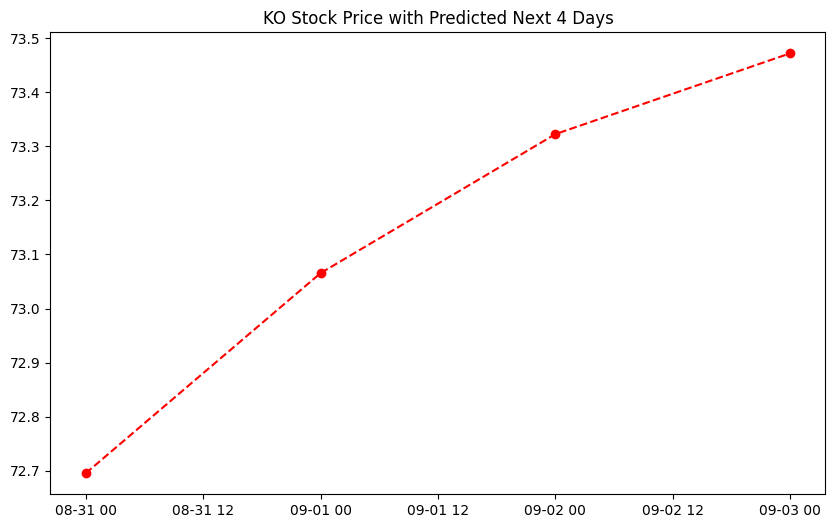

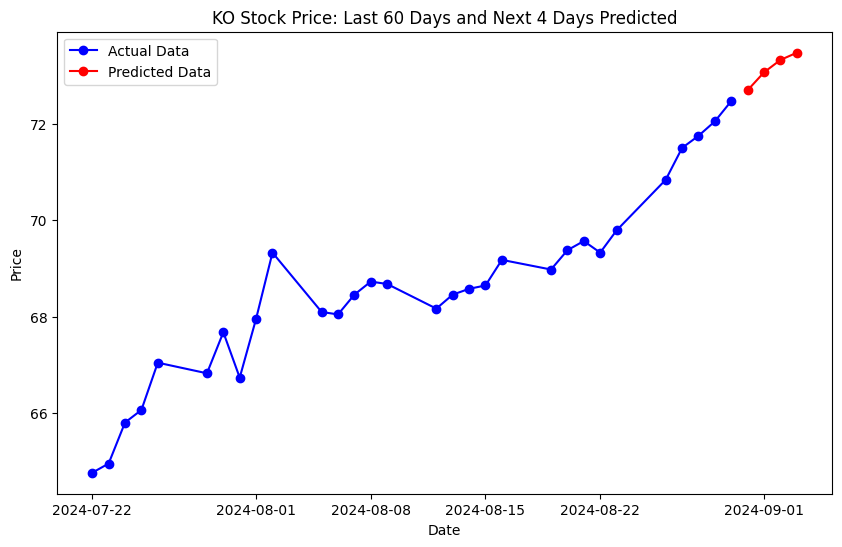

LSTM Model Mean Squared Error: 0.0008415422300303933
CNN Model Mean Squared Error: 0.0022308708921493395
GBM Model Mean Squared Error: 0.0023691609118278445
Mean Absolute Error: 0.011911926149714817
Root Mean Square Error: 0.015776232412241572
R^2 Score: 0.98070695859861
Accuracy: 98.42%

Predictions for KO for the next 30 days:
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━

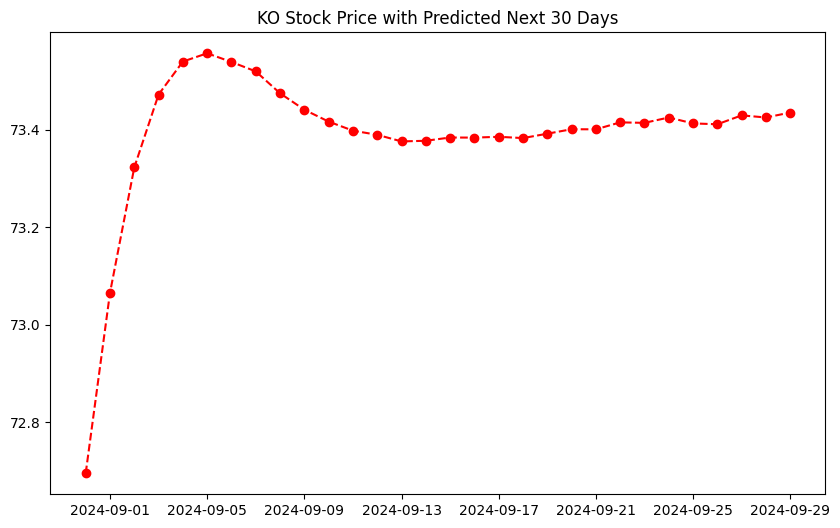

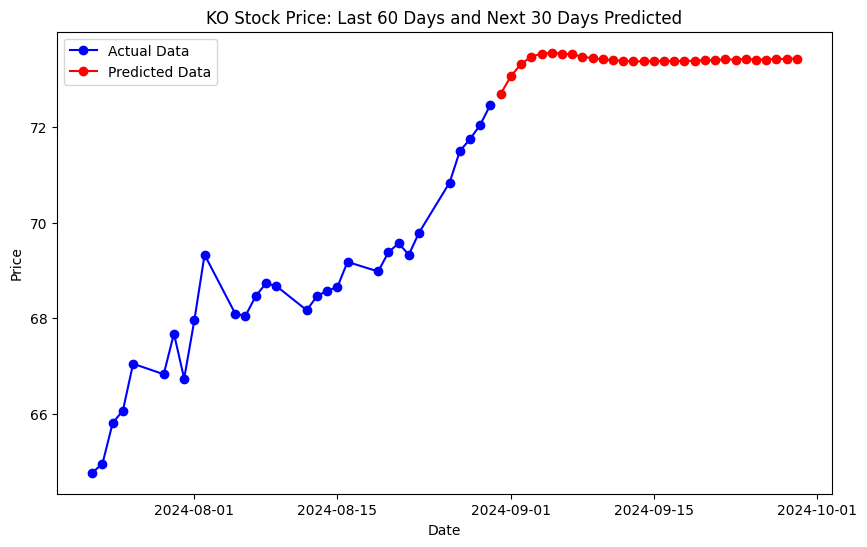

LSTM Model Mean Squared Error: 0.0008415422300303933
CNN Model Mean Squared Error: 0.0022308708921493395
GBM Model Mean Squared Error: 0.0023691609118278445
Mean Absolute Error: 0.011911926149714817
Root Mean Square Error: 0.015776232412241572
R^2 Score: 0.98070695859861
Accuracy: 98.42%

Predictions for KO for the next 60 days:
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━

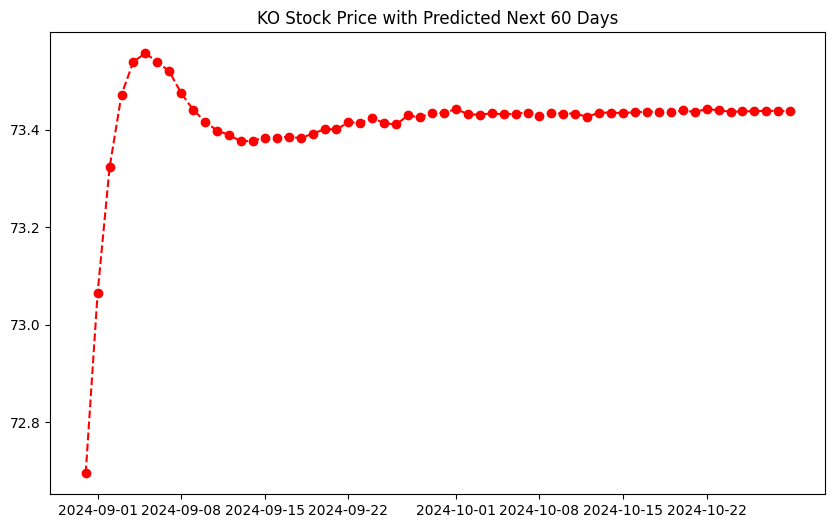

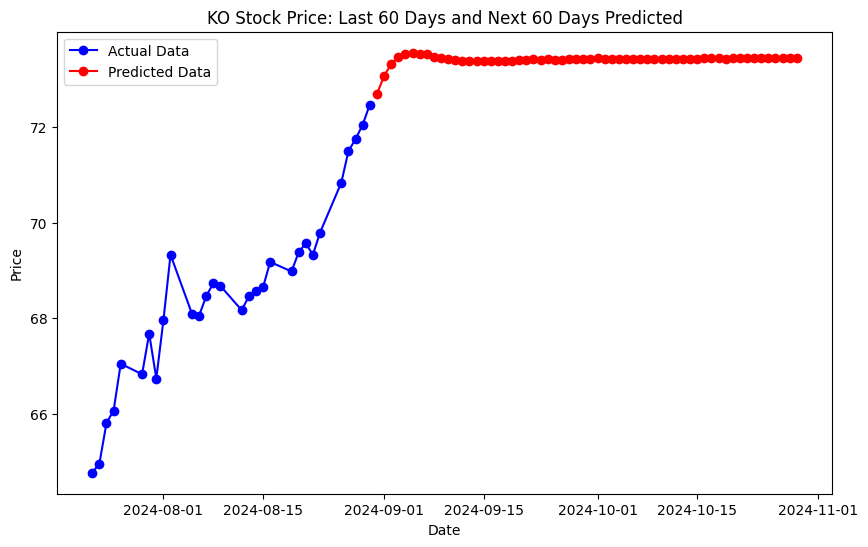

LSTM Model Mean Squared Error: 0.0008415422300303933
CNN Model Mean Squared Error: 0.0022308708921493395
GBM Model Mean Squared Error: 0.0023691609118278445
Mean Absolute Error: 0.011911926149714817
Root Mean Square Error: 0.015776232412241572
R^2 Score: 0.98070695859861
Accuracy: 98.42%


In [ ]:
def scale_data(data, features):
    from sklearn.preprocessing import MinMaxScaler

    scaler = MinMaxScaler()
    scaled_data = scaler.fit_transform(data[features])

    return scaled_data, scaler

from sklearn.preprocessing import MinMaxScaler

def scale_data(data, features):
    scaler = MinMaxScaler()
    scaled_data = scaler.fit_transform(data[features])
    return scaled_data, scaler
# Modify prediction function to handle different horizons
def predict_future_prices(company, model_results, days=5):
    lstm_model = model_results[company]['lstm_model']
    cnn_model = model_results[company]['cnn_model']
    gbm_model = model_results[company]['gbm_model']
    meta_model = model_results[company]['meta_model']

    data = company_data[company]
    scaled_data, scaler = scale_data(data, features)
    current_batch = scaled_data[-60:].reshape(1, 60, len(features))  # Most recent 60 days

    predicted_prices = []

    for i in range(days):
        lstm_pred = lstm_model.predict(current_batch).flatten()
        cnn_pred = cnn_model.predict(current_batch).flatten()
        gbm_pred = gbm_model.predict(current_batch.reshape((1, -1))).flatten()

        combined_pred = np.hstack((lstm_pred, cnn_pred, gbm_pred))
        next_prediction = meta_model.predict(combined_pred.reshape(1, -1))

        next_prediction_full = np.zeros((1, len(features)))
        next_prediction_full[0, features.index('Close')] = next_prediction.item()  # Convert to scalar
        predicted_prices.append(scaler.inverse_transform(next_prediction_full)[0])

        # Update current_batch with the new prediction
        next_prediction_reshaped = current_batch[:, -1, :].copy()
        next_prediction_reshaped[0, features.index('Close')] = next_prediction.item()  # Convert to scalar
        current_batch = np.append(current_batch[:, 1:, :], next_prediction_reshaped.reshape(1, 1, len(features)), axis=1)

    predicted_prices = np.array(predicted_prices)

    if predicted_prices.size == 0:
        raise ValueError("Predicted prices array is empty.")

    predicted_close_prices = predicted_prices[:, features.index('Close')].reshape(-1, 1)

    print(f"Predicted Stock Prices for the next {days} days for {company}: ", predicted_close_prices)

    last_date = data.index[-1]
    next_day = last_date + pd.Timedelta(days=1)
    prediction_dates = pd.date_range(start=next_day, periods=days)

    predicted_data = pd.DataFrame(index=prediction_dates, data=predicted_close_prices, columns=['Close'])

    # Plotting the predicted data
    plt.figure(figsize=(10, 6))
    plt.plot(predicted_data.index, predicted_data['Close'], linestyle='dashed', marker='o', color='red')
    plt.title(f"{company} Stock Price with Predicted Next {days} Days")
    plt.show()

    # Plotting the actual data and predicted data for the last 60 days and next days
    plt.figure(figsize=(10, 6))
    plt.plot(data.index[-30:], data['Close'][-30:], linestyle='-', marker='o', color='blue', label='Actual Data')
    plt.plot(prediction_dates, predicted_data['Close'], linestyle='-', marker='o', color='red', label='Predicted Data')
    plt.title(f"{company} Stock Price: Last 60 Days and Next {days} Days Predicted")
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.legend()
    plt.show()

    # Print evaluation metrics
    print(f"LSTM Model Mean Squared Error: {model_results[company]['lstm_model_mse']}")
    print(f"CNN Model Mean Squared Error: {model_results[company]['cnn_model_mse']}")
    print(f"GBM Model Mean Squared Error: {model_results[company]['gbm_model_mse']}")
    print(f"Mean Absolute Error: {model_results[company]['mae']}")
    print(f"Root Mean Square Error: {model_results[company]['rmse']}")
    print(f"R^2 Score: {model_results[company]['r2']}")
    accuracy = (1 - model_results[company]['rmse']) * 100
    print(f"Accuracy: {accuracy:.2f}%")

# Function to call predictions for different horizons
def run_predictions_for_all_horizons(companies, model_results):
    horizons = [4, 30, 60]
    for company in companies:
        for days in horizons:
            print(f"\nPredictions for {company} for the next {days} days:")
            predict_future_prices(company, model_results, days)

# Call the function for all horizons
run_predictions_for_all_horizons(companies, model_results)

Load and Process Stock Data for Multiple Companies

In [ ]:
#Load and Process Stock Data for Multiple Companies
start_date = '2021-09-30'
end_date = '2022-09-28'

companies = ['GOOG', 'AMZN', 'AAPL', 'TSLA', 'VZ', 'KO']
company_data = {}

for company in companies:
    data = yf.download(company, start=start_date, end=end_date, interval='1d')
    company_data[company] = data
    print(f"{company}: {len(data)} records")

for company in companies:
    data = company_data[company]
    data.index = pd.to_datetime(data.index).tz_localize(None)
    data = data[(data.index >= start_date) & (data.index <= end_date)]
    company_data[company] = data
    print(f"{company} data date range: {data.index.min()} to {data.index.max()}")

#Feature Engineering
def feature_engineering(data):
    data['Mkt Cap'] = data['Close'] * data['Volume']
    data['P/E Ratio'] = 20  # Placeholder for P/E ratio
    data['Div Yield'] = 0  # Placeholder for Dividend Yield
    data['CDP Score'] = 5  # Placeholder for CDP score
    data['52-wk High'] = data['Close'].rolling(window=252, min_periods=1).max()
    data['52-wk Low'] = data['Close'].rolling(window=252, min_periods=1).min()
    data['Price Movement'] = data['Close'].diff()
    data.fillna(method='ffill', inplace=True)
    data.fillna(method='bfill', inplace=True)
    return data

for company in companies:
    data = company_data[company]
    company_data[company] = feature_engineering(data)

#Creates Financial Indicators
def create_indicators(data):
    prices = data.sort_values(by=['Date']).reset_index()
    n = [10, 20, 50, 100]
    for i in n:
        prices[f"MA{i}"] = prices['Close'].rolling(i).mean()

    day26 = prices['Close'].ewm(span=26, adjust=False).mean()
    day12 = prices['Close'].ewm(span=12, adjust=False).mean()
    prices['macd'] = day12 - day26
    prices['signal'] = prices['macd'].ewm(span=9, adjust=False).mean()

    up = np.log(prices.Close).diff(1)
    down = np.log(prices.Close).diff(1)
    up[up < 0] = 0
    down[down > 0] = 0
    roll_up = up.ewm(span=14).mean()
    roll_down = down.abs().ewm(span=14).mean()
    RS1 = roll_up / roll_down
    RSI1 = 100.0 - (100.0 / (1.0 + RS1))
    prices['rsi'] = RSI1
    return prices

# Apply financial indicators
for company in companies:
    data = company_data[company]
    company_data[company] = create_indicators(data)

Sentiment and Emotion Analysis of Tweets within a Specific Date Range

In [ ]:
df['Date'] = pd.to_datetime(df['Date'], errors='coerce')
df['Tweet'] = df['Tweet'].astype(str).fillna("")

# Filter tweet data to the specified date range
df = df[(df['Date'] >= start_date) & (df['Date'] <= end_date)]

# Define Preprocessing Function for Tweets
def preprocess_tweet(tweet):
    tweet = re.sub(r'http\S+|www\S+|https\S+', '', tweet, flags=re.MULTILINE)
    tweet = re.sub(r'\@\w+|\#', '', tweet)
    tweet = re.sub(r'[^\w\s]', '', tweet)
    tweet = tweet.lower()
    return tweet

# Define Function to Detect Emotions in Tweets
def detect_emotion(tweet):
    emotions = {
        'anger': ['angry', 'sell', 'mad', 'furious', 'hate', 'sell', 'bear', 'bubble', 'bearish', 'overvalued', 'overbought', 'overpriced', 'expensive', 'downward', 'falling', 'sold', 'low', 'miss', 'resistance', 'squeeze', 'cover', 'seller', 'rage', 'hate', 'annoyed', 'crash', '!!!', '😠', '😡', '🤬', '👿', '💢', 'sold', 'fake', 'decline', 'drop', 'crash', 'bear', 'sell', '📉' ],
        'happiness': ['happy', 'buy', 'bull', 'long', 'support', 'undervalued', 'underpriced', 'cheap', 'upward', 'rising', 'trend', 'moon', 'rocket', 'hold', 'breakout', 'call', 'beat', 'buying', 'holding', 'high', 'profit', 'joy', 'glad', 'delighted', 'love', 'great', '😊', '😁', '😃', '😄', '😆', '😂', '🤗', '😍', '😇', '🥰', 'risen', 'better', 'gain', 'profit', 'bull', 'rise', 'buy', '✅', '📈', '❤️', '🚀', '🍎', '💰'],
        'sadness': ['sad', 'unhappy', 'short', 'sold', 'miss', 'depressed', 'down', '😢', '😭', '😞', '😔', '😟', '😿', '💔', 'undervalued', 'misunderstood', 'loss', 'fall', 'decrease', 'dip', 'short', 'neutral', 'neutral', 'steady', 'stable', 'even', 'calm', 'balanced', 'level', 'flat', '😐'],
        'surprise': ['surprised', 'shocked', 'breakout', 'moon', 'rocket', 'beat', 'amazed', 'astonished', '!', '😲', '😯', '😮', '😱', '🙀', '😳', 'unveiled', 'earnings', 'surge', 'spike', 'unexpected', 'shock',  '🎯', '➡️'],
        'neutral': ['neutral', 'steady', 'stable', 'even', 'calm', 'balanced', 'level', 'flat', '😐'],
        'confusion': ['confused', 'lost', 'squeeze', 'cover', 'bear', 'bubble', 'bearish', 'overvalued', 'overbought', 'overpriced', 'expensive', 'downward', 'falling', 'low', 'miss', 'resistance', 'uncertain', '?', '??', 'what...?', '😕', '😵', '🤔', '😐', '🤯', 'trendless', 'volatile', 'uncertain', 'swing', 'fluctuate', 'confuse',  '🛒']
    }
    detected_emotions = []
    for emotion, keywords in emotions.items():
        if any(keyword in tweet for keyword in keywords):
            detected_emotions.append(emotion)
    return detected_emotions if detected_emotions else ['neutral']

# Define Function to Analyze Sentiment and Extremity
def analyze_sentiment(text):
    analyzer = SentimentIntensityAnalyzer()
    scores = analyzer.polarity_scores(text)
    extremity = abs(scores['compound'])
    return scores, extremity

# Combine Sentiment Analysis and Emotion Detection
def analyze_sentiment_and_emotion(tweet):
    tweet_processed = preprocess_tweet(tweet)
    sentiment, extremity = analyze_sentiment(tweet_processed)
    emotions = detect_emotion(tweet_processed)
    return {
        'Positive': sentiment['pos'],
        'Negative': sentiment['neg'],
        'Neutral': sentiment['neu'],
        'Compound': sentiment['compound'],
        'Extremity': extremity,
        'Emotions': emotions
    }

# Perform Sentiment and Emotion Analysis on Tweets
start_time = time.time()
with Pool(cpu_count()) as pool:
    results = pool.map(analyze_sentiment_and_emotion, df['Tweet'])
sentiment_emotion_data = pd.DataFrame(results)
df = pd.concat([df.reset_index(drop=True), sentiment_emotion_data.reset_index(drop=True)], axis=1)
end_time = time.time()
print(f"Time taken for sentiment and emotion analysis: {end_time - start_time} seconds")



Validate and Display Sentiment and Stock Data for Each Company

In [ ]:
# Check the Sentiment Data for Each Company
for company in companies:
    sentiment_data = df[df['Stock Name'] == company]
    if sentiment_data.empty:
        print(f"No sentiment data available for {company}")
    else:
        print(f"First few rows of sentiment data for {company}:")
        print(sentiment_data.head())

# Display the First Few Rows of Merged Data for Each Company
print("Data after merging:")
for company, data in company_data.items():
    print(f"\n{company}:\n", data.head())

# Check the Date Range of the Merged Data for Each Company
for company in companies:
    data = company_data[company]
    date_range = (data.index.min(), data.index.max())
    print(f"{company} data date range after merging: {date_range}")

Filter and Merge Technical and Sentiment Data for Each Company

In [ ]:
# Define the date range for filtering data
start_date = pd.to_datetime('2021-09-30')
end_date = pd.to_datetime('2022-09-27')

# Load technical data from Yahoo Finance for each company
company_data = {}
for company in companies:
    data = yf.download(company, period='5y', interval='1d')
    company_data[company] = data
    print(f"{company}: {len(data)} records")

# Filter and align technical and sentiment data within the specified date range
for company in companies:
    data = company_data[company]
    data.index = pd.to_datetime(data.index).tz_localize(None)
    data = data[(data.index >= start_date) & (data.index <= end_date)]
    # Filter the sentiment data to match the specified date range
    sentiment_data = df[df['Stock Name'] == company].copy()
    sentiment_data['Date'] = pd.to_datetime(sentiment_data['Date']).dt.tz_localize(None)  # Ensure datetime is timezone-naive
    sentiment_data = sentiment_data[(sentiment_data['Date'] >= start_date) & (sentiment_data['Date'] <= end_date)]
    print(f"Technical data for {company} from {start_date} to {end_date}:")
    print(data.head())
    print(f"Sentiment data for {company} from {start_date} to {end_date}:")
    print(sentiment_data.head())

    # Prepare sentiment data for merging by selecting relevant columns
    sentiment_data = sentiment_data[['Date', 'Compound', 'Positive', 'Negative', 'Neutral']]
    data = data.drop(columns=[col for col in ['Compound', 'Positive', 'Negative', 'Neutral'] if col in data.columns])
    data = data.reset_index().rename(columns={'index': 'Date'})
    merged_data = pd.merge(data, sentiment_data, on='Date', how='left')

    # Fill any missing sentiment scores with 0 after merging
    merged_data[['Compound', 'Positive', 'Negative', 'Neutral']] = merged_data[['Compound', 'Positive', 'Negative', 'Neutral']].fillna(0)
    merged_data = merged_data[(merged_data['Date'] >= start_date) & (merged_data['Date'] <= end_date)]
    company_data[company] = merged_data
    print(f"First few rows of merged data for {company}:")
    print(merged_data.head())

# Verify and print the date range of the merged data for each company
for company in companies:
    data = company_data[company]
    date_range = (data['Date'].min(), data['Date'].max())
    print(f"{company} data date range after merging: {date_range}")


Data Scaling, Model Training, and Evaluation for Stock Price Prediction


Predicting Future Stock Prices Using Trained Models

Model Evaluation with Precision, Recall, and F1 Score for Stock Price Prediction

In [ ]:
# Function to calculate Precision, Recall, and F1 score
def calculate_classification_metrics(y_true, y_pred):
    # Convert true and predicted values to binary classification (1 for price increase, 0 for decrease)
    y_true_binary = (y_true[1:] > y_true[:-1]).astype(int)  # True: 1 if the price increased
    y_pred_binary = (y_pred[1:] > y_pred[:-1]).astype(int)  # Predicted: 1 if the price is predicted to increase
    precision = precision_score(y_true_binary, y_pred_binary, average='binary')
    recall = recall_score(y_true_binary, y_pred_binary, average='binary')
    f1 = f1_score(y_true_binary, y_pred_binary, average='binary')
    return precision, recall, f1

# Updated function to evaluate models, including Precision, Recall, and F1 score
def evaluate_model(model, X_test, y_test, model_name):
    predictions_test = model.predict(X_test).flatten()
    mse = mean_squared_error(y_test, predictions_test)
    precision, recall, f1 = calculate_classification_metrics(y_test, predictions_test)
    print(f"{model_name} Model Mean Squared Error: {mse}")
    print(f"{model_name} Precision: {precision}")
    print(f"{model_name} Recall: {recall}")
    print(f"{model_name} F1 Score: {f1}")

    return predictions_test, mse, precision, recall, f1

# Train and evaluate models for each company
model_results = {}

for company in companies:
    data = company_data[company]
    X_train, X_test, y_train, y_test, scaler, available_features = prepare_data(data, features)
    lstm_model = train_lstm_model(X_train, y_train)
    cnn_model = train_cnn_model(X_train, y_train)
    gbm_model = train_gbm_model(X_train, y_train)
    lstm_predictions, lstm_mse, lstm_precision, lstm_recall, lstm_f1 = evaluate_model(lstm_model, X_test, y_test, "LSTM")
    cnn_predictions, cnn_mse, cnn_precision, cnn_recall, cnn_f1 = evaluate_model(cnn_model, X_test, y_test, "CNN")
    gbm_predictions, gbm_mse, gbm_precision, gbm_recall, gbm_f1 = evaluate_model(gbm_model, X_test.reshape(X_test.shape[0], -1), y_test, "GBM")

    # Train meta-model using predictions from individual models
    meta_model = train_meta_model(lstm_predictions, cnn_predictions, gbm_predictions, y_test)

    # Make predictions with the meta-model
    test_meta_features = np.vstack((lstm_predictions, cnn_predictions, gbm_predictions)).T
    y_pred = meta_model.predict(test_meta_features)

    # Store model results for each company
    model_results[company] = {
        "lstm_model": lstm_model,
        "cnn_model": cnn_model,
        "gbm_model": gbm_model,
        "meta_model": meta_model,
        "lstm_model_mse": lstm_mse,
        "cnn_model_mse": cnn_mse,
        "gbm_model_mse": gbm_mse,
        "lstm_precision": lstm_precision,
        "cnn_precision": cnn_precision,
        "gbm_precision": gbm_precision,
        "lstm_recall": lstm_recall,
        "cnn_recall": cnn_recall,
        "gbm_recall": gbm_recall,
        "lstm_f1": lstm_f1,
        "cnn_f1": cnn_f1,
        "gbm_f1": gbm_f1,
        "mae": mean_absolute_error(y_test, y_pred),
        "rmse": mean_squared_error(y_test, y_pred, squared=False),
        "r2": r2_score(y_test, y_pred)
    }

# Display Precision, Recall, and F1 scores for each company and model
for company, results in model_results.items():
    print(f"\n{company} Model Results:")
    print(f"LSTM Precision: {results['lstm_precision']:.4f}, Recall: {results['lstm_recall']:.4f}, F1 Score: {results['lstm_f1']:.4f}")
    print(f"CNN Precision: {results['cnn_precision']:.4f}, Recall: {results['cnn_recall']:.4f}, F1 Score: {results['cnn_f1']:.4f}")
    print(f"GBM Precision: {results['gbm_precision']:.4f}, Recall: {results['gbm_recall']:.4f}, F1 Score: {results['gbm_f1']:.4f}")


Epoch 1/100


<ipython-input-23-e256310f2d52>:4: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data[available_features] = data[available_features].fillna(method='ffill').fillna(method='bfill').fillna(data[available_features].mean())
/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


5/5 ━━━━━━━━━━━━━━━━━━━━ 4s 151ms/step - loss: 0.1762 - val_loss: 0.0189
Epoch 2/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - loss: 0.0476 - val_loss: 0.0130
Epoch 3/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - loss: 0.0372 - val_loss: 0.0086
Epoch 4/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 60ms/step - loss: 0.0187 - val_loss: 0.0054
Epoch 5/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - loss: 0.0247 - val_loss: 0.0051
Epoch 6/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - loss: 0.0173 - val_loss: 0.0127
Epoch 7/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - loss: 0.0196 - val_loss: 0.0111
Epoch 8/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - loss: 0.0155 - val_loss: 0.0061
Epoch 9/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - loss: 0.0157 - val_loss: 0.0092
Epoch 10/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 90ms/step - loss: 0.0171 - val_loss: 0.0156
Epoch 11/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 102ms/step - loss: 0.0163 - val_loss: 0.0116
Epoch 12/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - loss: 0.0158 - val_loss: 0.0065

<ipython-input-23-e256310f2d52>:4: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data[available_features] = data[available_features].fillna(method='ffill').fillna(method='bfill').fillna(data[available_features].mean())
/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


5/5 ━━━━━━━━━━━━━━━━━━━━ 4s 168ms/step - loss: 0.1580 - val_loss: 0.0591
Epoch 2/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 70ms/step - loss: 0.0639 - val_loss: 0.0075
Epoch 3/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - loss: 0.0442 - val_loss: 0.0123
Epoch 4/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 73ms/step - loss: 0.0268 - val_loss: 0.0139
Epoch 5/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 104ms/step - loss: 0.0252 - val_loss: 0.0270
Epoch 6/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 106ms/step - loss: 0.0188 - val_loss: 0.0225
Epoch 7/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 116ms/step - loss: 0.0178 - val_loss: 0.0196
Epoch 8/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 106ms/step - loss: 0.0163 - val_loss: 0.0178
Epoch 9/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 105ms/step - loss: 0.0205 - val_loss: 0.0142
Epoch 10/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 105ms/step - loss: 0.0165 - val_loss: 0.0127
Epoch 11/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 106ms/step - loss: 0.0161 - val_loss: 0.0087
Epoch 12/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 118ms/step - loss: 0.0171 - val_loss:

<ipython-input-23-e256310f2d52>:4: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data[available_features] = data[available_features].fillna(method='ffill').fillna(method='bfill').fillna(data[available_features].mean())
/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


5/5 ━━━━━━━━━━━━━━━━━━━━ 4s 165ms/step - loss: 0.2460 - val_loss: 0.0732
Epoch 2/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - loss: 0.0878 - val_loss: 0.0158
Epoch 3/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step - loss: 0.0479 - val_loss: 0.0189
Epoch 4/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 73ms/step - loss: 0.0412 - val_loss: 0.0114
Epoch 5/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 71ms/step - loss: 0.0352 - val_loss: 0.0190
Epoch 6/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - loss: 0.0288 - val_loss: 0.0282
Epoch 7/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 69ms/step - loss: 0.0292 - val_loss: 0.0250
Epoch 8/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 69ms/step - loss: 0.0268 - val_loss: 0.0317
Epoch 9/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 74ms/step - loss: 0.0208 - val_loss: 0.0292
Epoch 10/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.0194 - val_loss: 0.0286
Epoch 11/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 76ms/step - loss: 0.0234 - val_loss: 0.0276
Epoch 12/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 101ms/step - loss: 0.0218 - val_loss: 0.0275

<ipython-input-23-e256310f2d52>:4: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data[available_features] = data[available_features].fillna(method='ffill').fillna(method='bfill').fillna(data[available_features].mean())
/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 4s 155ms/step - loss: 0.5491 - val_loss: 0.0169
Epoch 2/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - loss: 0.0815 - val_loss: 0.0154
Epoch 3/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - loss: 0.0431 - val_loss: 0.0136
Epoch 4/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - loss: 0.0351 - val_loss: 0.0275
Epoch 5/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - loss: 0.0443 - val_loss: 0.0167
Epoch 6/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - loss: 0.0226 - val_loss: 0.0103
Epoch 7/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - loss: 0.0324 - val_loss: 0.0159
Epoch 8/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - loss: 0.0222 - val_loss: 0.0284
Epoch 9/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - loss: 0.0212 - val_loss: 0.0324
Epoch 10/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - loss: 0.0198 - val_loss: 0.0219
Epoch 11/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - loss: 0.0208 - val_loss: 0.0164
Epoch 12/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step - loss: 0.0195 - val_l

<ipython-input-23-e256310f2d52>:4: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data[available_features] = data[available_features].fillna(method='ffill').fillna(method='bfill').fillna(data[available_features].mean())
/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 6s 245ms/step - loss: 0.4339 - val_loss: 0.0995
Epoch 2/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step - loss: 0.0878 - val_loss: 0.0567
Epoch 3/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 56ms/step - loss: 0.0414 - val_loss: 0.0233
Epoch 4/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - loss: 0.0488 - val_loss: 0.0203
Epoch 5/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - loss: 0.0268 - val_loss: 0.0487
Epoch 6/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - loss: 0.0224 - val_loss: 0.0409
Epoch 7/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - loss: 0.0231 - val_loss: 0.0214
Epoch 8/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 56ms/step - loss: 0.0189 - val_loss: 0.0191
Epoch 9/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - loss: 0.0193 - val_loss: 0.0245
Epoch 10/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - loss: 0.0167 - val_loss: 0.0265
Epoch 11/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - loss: 0.0154 - val_loss: 0.0193
Epoch 12/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - loss: 0.0154 - val_l

<ipython-input-23-e256310f2d52>:4: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data[available_features] = data[available_features].fillna(method='ffill').fillna(method='bfill').fillna(data[available_features].mean())
/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 5s 154ms/step - loss: 0.2478 - val_loss: 0.0632
Epoch 2/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 54ms/step - loss: 0.0736 - val_loss: 0.0155
Epoch 3/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - loss: 0.0345 - val_loss: 0.0355
Epoch 4/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - loss: 0.0310 - val_loss: 0.0049
Epoch 5/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 60ms/step - loss: 0.0210 - val_loss: 0.0097
Epoch 6/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - loss: 0.0187 - val_loss: 0.0051
Epoch 7/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - loss: 0.0218 - val_loss: 0.0081
Epoch 8/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - loss: 0.0229 - val_loss: 0.0052
Epoch 9/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step - loss: 0.0151 - val_loss: 0.0049
Epoch 10/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step - loss: 0.0209 - val_loss: 0.0049
Epoch 11/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - loss: 0.0170 - val_loss: 0.0048
Epoch 12/100
5/5 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - loss: 0.0144 - val_l

Technical data analysis

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Technical data dates for GOOG before filtering:
2021-09-29 00:00:00 2022-09-27 00:00:00
Sentiment data dates for GOOG before filtering:
2021-09-30 00:00:00 2022-09-26 00:00:00
Technical data for GOOG after filtering from 2021-09-30 to 2022-09-28:
        Date        Open        High         Low       Close   Adj Close  \
1 2021-09-30  134.324997  135.589996  133.000000  133.265503  133.114029   
2 2021-10-01  133.554504  137.070999  133.377502  136.462494  136.307388   
3 2021-10-04  135.699493  135.699997  131.166504  133.764999  133.612961   
4 2021-10-05  134.000000  137.362000  134.000000  136.177002  136.022217   
5 2021-10-06  134.625504  137.852005  134.486496  137.354004  137.197876   

     Volume  
1  35294000  
2  28388000  
3  31530000  
4  24126000  
5  19764000  
Sentiment data for GOOG after filtering from 2021-09-30 to 2022-09-28:
         Date Stock Name                 Company Name  Positive  Negative  \
0  2021-09-30       GOOG             Amazon.com, Inc.  0.188439 

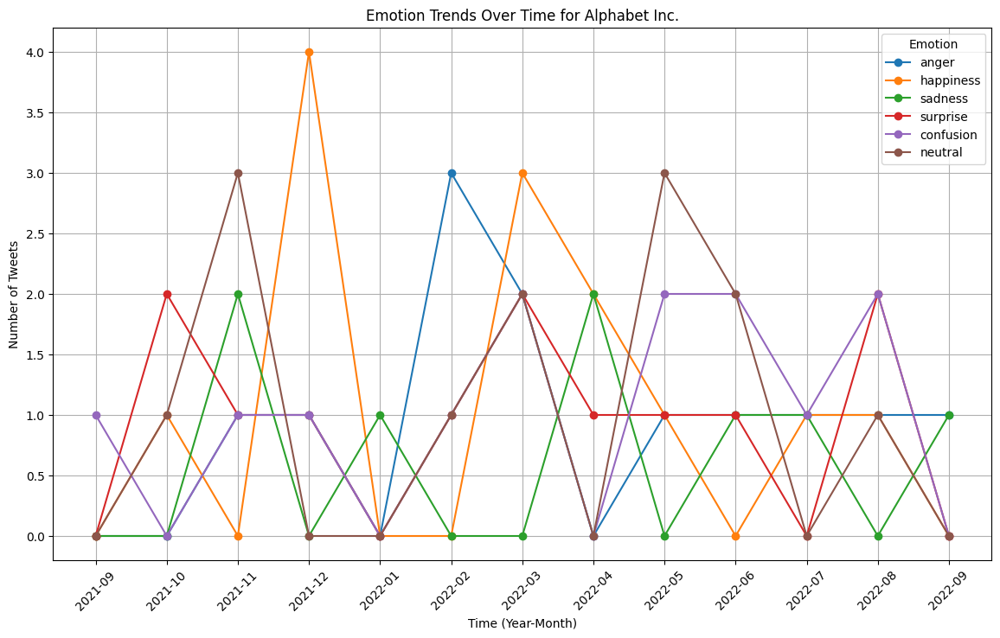

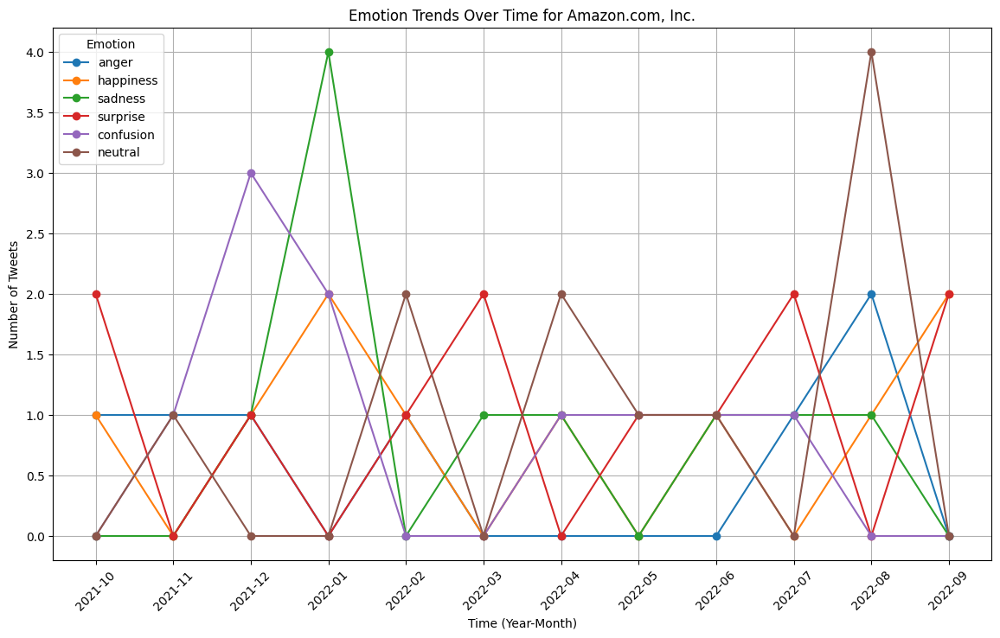

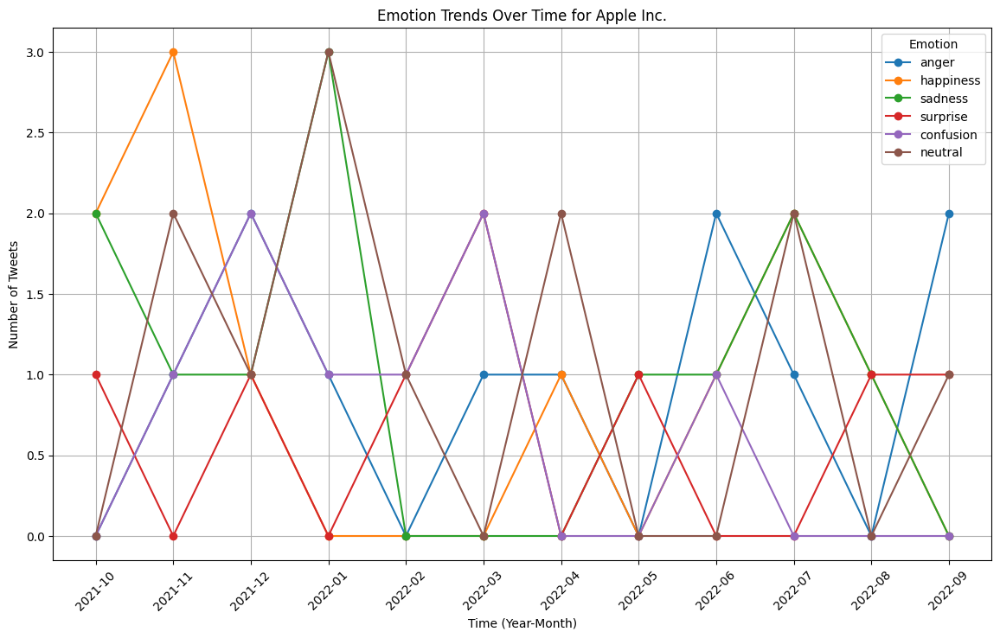

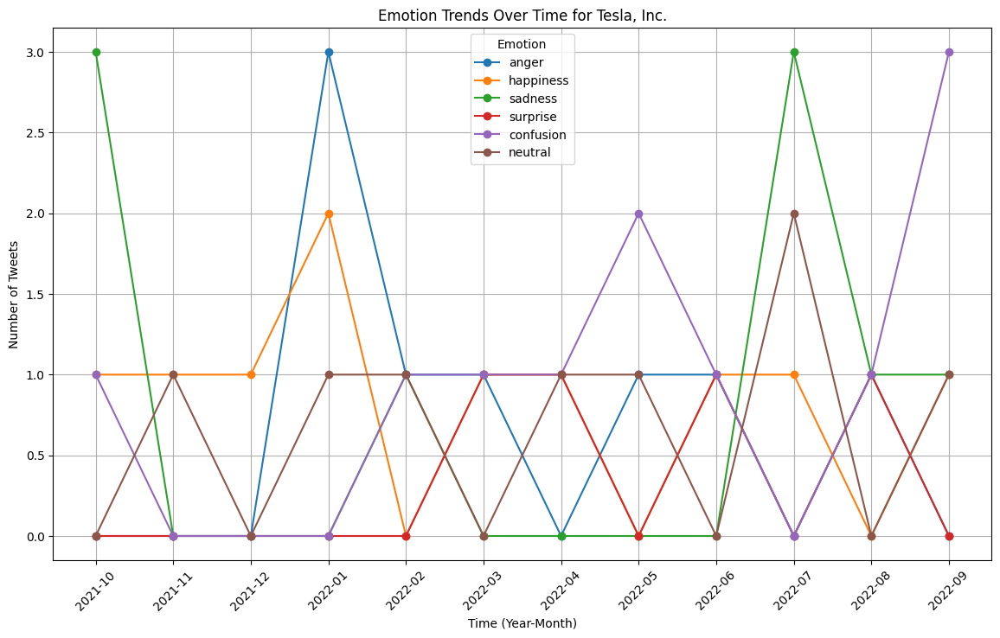

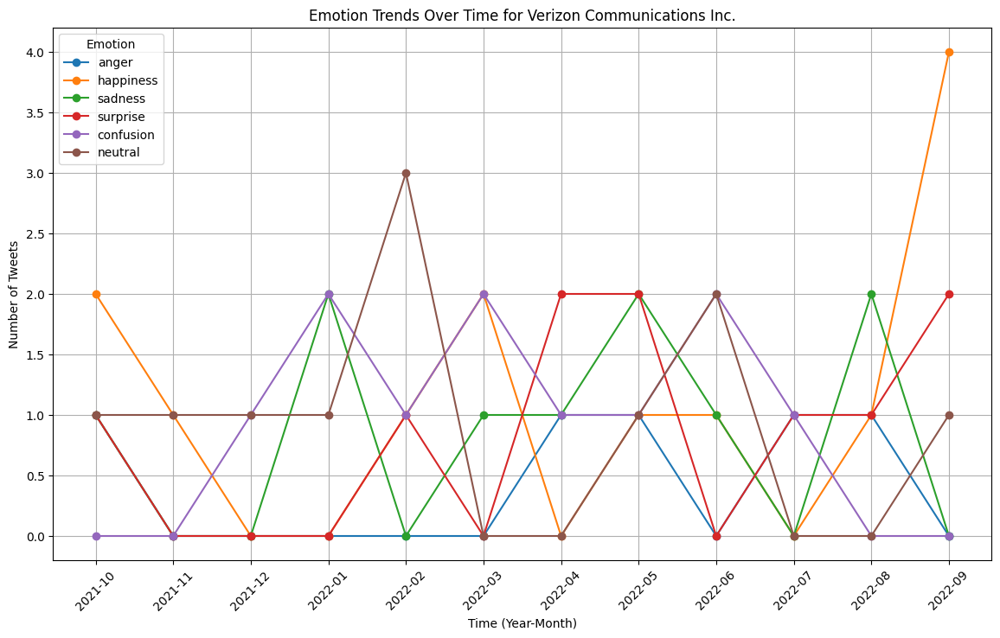

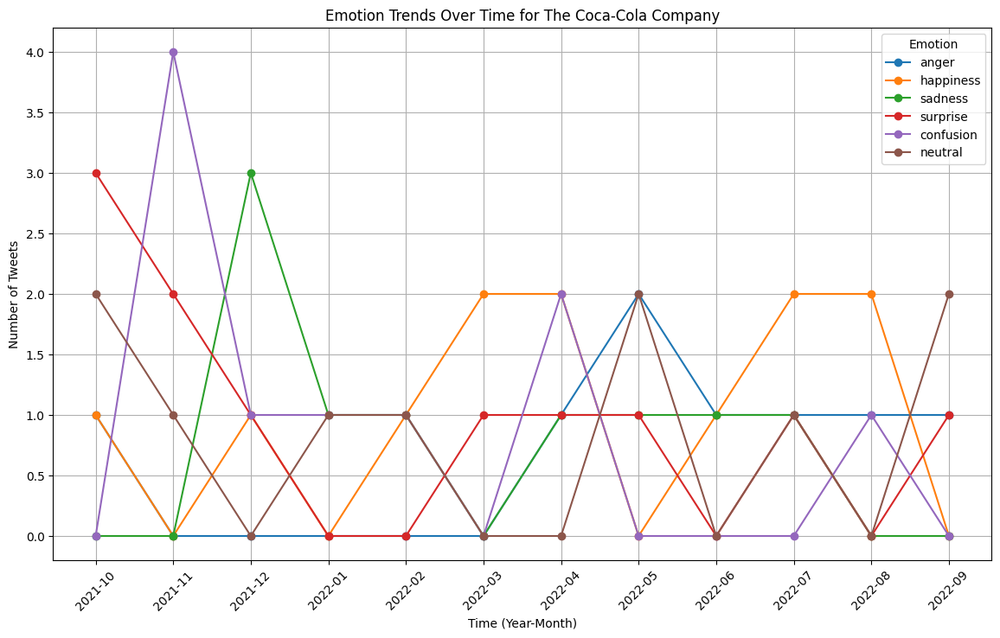

In [ ]:

# Function to load data from Yahoo Finance
def load_data():
    tickers = ['GOOG', 'AMZN', 'AAPL', 'TSLA', 'VZ', 'KO']
    start_date = '2021-09-29'
    end_date = '2022-09-28'
    data = {}

    for ticker in tickers:
        df = yf.download(ticker, start=start_date, end=end_date)
        df.reset_index(inplace=True)
        data[ticker] = df

    return data

# Load technical data
technical_data = load_data()

# Load sentiment data (example placeholder)
date_range = pd.date_range(start='2021-09-30', end='2022-09-27', freq='D')
num_entries = len(date_range)
sentiment_data = pd.DataFrame({
    'Date': date_range,
    'Stock Name': np.random.choice(['GOOG', 'AMZN', 'AAPL', 'TSLA', 'VZ', 'KO'], size=num_entries),
    'Company Name': np.random.choice(['Alphabet Inc.', 'Amazon.com, Inc.', 'Apple Inc.', 'Tesla, Inc.', 'Verizon Communications Inc.', 'The Coca-Cola Company'], size=num_entries),
    'Positive': np.random.rand(num_entries),
    'Negative': np.random.rand(num_entries),
    'Neutral': np.random.rand(num_entries),
    'Compound': np.random.rand(num_entries),
    'Tweet': ['Sample tweet'] * num_entries,
    'Emotions': [np.random.choice(['happiness', 'sadness', 'anger', 'surprise', 'neutral', 'confusion']) for _ in range(num_entries)]
})

start_date = '2021-09-30'
end_date = '2022-09-28'

for company in technical_data.keys():
    data = technical_data[company]
    data['Date'] = pd.to_datetime(data['Date']).dt.tz_localize(None)  # Ensure the index is datetime and timezone-naive
    print(f"Technical data dates for {company} before filtering:")
    print(data['Date'].min(), data['Date'].max())

    # Filter sentiment data
    sentiment_data_company = sentiment_data[sentiment_data['Stock Name'] == company].copy()  # Avoid SettingWithCopyWarning
    sentiment_data_company['Date'] = pd.to_datetime(sentiment_data_company['Date']).dt.tz_localize(None)

    # Debug: Print dates in sentiment data before filtering
    print(f"Sentiment data dates for {company} before filtering:")
    print(sentiment_data_company['Date'].min(), sentiment_data_company['Date'].max())

    # Filter the data to the specified date range
    data = data[(data['Date'] >= start_date) & (data['Date'] <= end_date)]
    sentiment_data_company = sentiment_data_company[(sentiment_data_company['Date'] >= start_date) & (sentiment_data_company['Date'] <= end_date)]

    # Debug: Print the date ranges after filtering
    print(f"Technical data for {company} after filtering from {start_date} to {end_date}:")
    print(data.head())
    print(f"Sentiment data for {company} after filtering from {start_date} to {end_date}:")
    print(sentiment_data_company.head())

    # Rename sentiment columns to avoid conflicts
    sentiment_data_company.rename(columns={
        'Compound': 'Sentiment_Compound',
        'Positive': 'Sentiment_Positive',
        'Negative': 'Sentiment_Negative',
        'Neutral': 'Sentiment_Neutral'
    }, inplace=True)

    # Drop any existing sentiment columns in the technical data to avoid conflicts
    sentiment_columns = ['Sentiment_Compound', 'Sentiment_Positive', 'Sentiment_Negative', 'Sentiment_Neutral']
    data = data.drop(columns=[col for col in sentiment_columns if col in data.columns], errors='ignore')

    # Merge datasets on date
    sentiment_data_company = sentiment_data_company[['Date', 'Sentiment_Compound', 'Sentiment_Positive', 'Sentiment_Negative', 'Sentiment_Neutral']]
    merged_data = pd.merge(data, sentiment_data_company, on='Date', how='left')

    # Fill missing sentiment scores with 0
    for column in sentiment_columns:
        if column in merged_data.columns:
            merged_data[column].fillna(0, inplace=True)

    # Save merged data
    technical_data[company] = merged_data

    print(f"First few rows of merged data for {company}:")
    print(merged_data.head())

# Function to prepare data for prediction
def prepare_data(data, target_col='Close'):
    data = data.dropna()
    X = data[['Open', 'High', 'Low', 'Volume', 'Sentiment_Compound', 'Sentiment_Positive', 'Sentiment_Negative', 'Sentiment_Neutral']]
    y = data[target_col]
    return train_test_split(X, y, test_size=0.2, random_state=42)

# Function to call predictions for different horizons
def predict_future_prices(company, data, days):
    X_train, X_test, y_train, y_test = prepare_data(data)
    model = LinearRegression()
    model.fit(X_train, y_train)
    prediction = model.predict(X_test)
    print(f"Predicted prices for {company} for the next {days} days: {prediction[:days]}")

def run_predictions_for_all_horizons(companies, data):
    horizons = [5, 30, 60]
    for company in companies:
        for days in horizons:
            print(f"\nPredictions for {company} for the next {days} days:")
            predict_future_prices(company, data[company], days)

# Run predictions for all horizons
run_predictions_for_all_horizons(technical_data.keys(), technical_data)

# Group sentiment by year-month, company, and emotion type
sentiment_data['YearMonth'] = sentiment_data['Date'].dt.to_period('M')
sentiment_over_time_by_company = sentiment_data.explode('Emotions').groupby(['YearMonth', 'Stock Name', 'Emotions']).size().unstack(fill_value=0)

# Plot emotion trends over time for each company
emotions = ['anger', 'happiness', 'sadness', 'surprise', 'confusion', 'neutral']
stock_to_company = {
    'GOOG': 'Alphabet Inc.',
    'AMZN': 'Amazon.com, Inc.',
    'AAPL': 'Apple Inc.',
    'TSLA': 'Tesla, Inc.',
    'VZ': 'Verizon Communications Inc.',
    'KO': 'The Coca-Cola Company'
}

for company in technical_data.keys():
    company_name = stock_to_company[company]
    company_sentiment = sentiment_over_time_by_company.xs(company, level='Stock Name')

    plt.figure(figsize=(14, 8))
    for emotion in emotions:
        if emotion in company_sentiment.columns:
            plt.plot(company_sentiment.index.astype(str), company_sentiment[emotion], marker='o', label=emotion)

    plt.title(f'Emotion Trends Over Time for {company_name}')
    plt.xlabel('Time (Year-Month)')
    plt.ylabel('Number of Tweets')
    plt.xticks(rotation=45)
    plt.legend(title='Emotion')
    plt.grid(True)
    plt.show()


Actual vs Predicted Stock Prices


Predictions for GOOG for the next 5 days:
Predicted prices for GOOG for the next 5 days: [122.17247957 139.82680145 133.46359151 148.0663317  131.04335663]


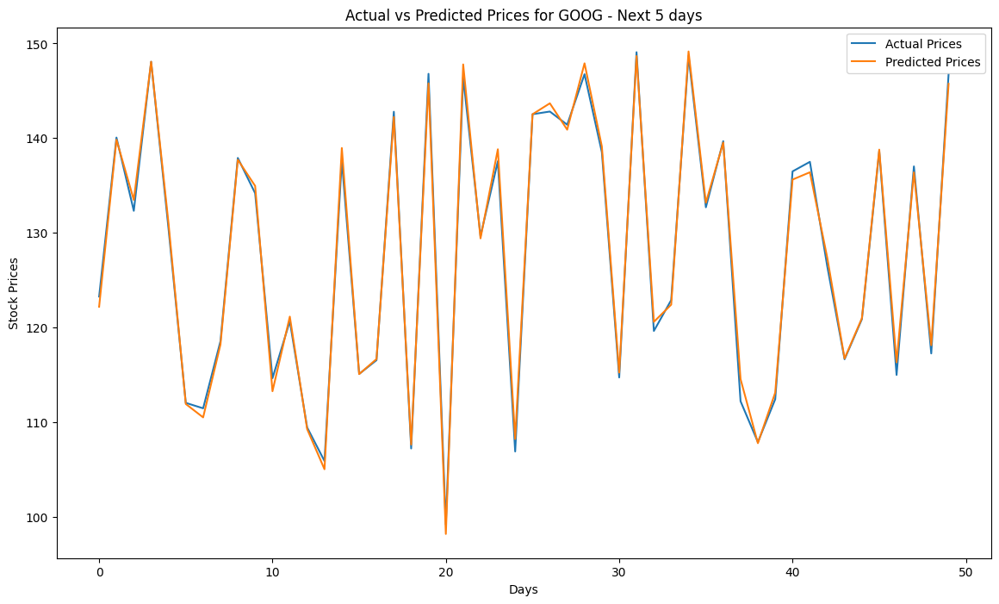


Predictions for GOOG for the next 30 days:
Predicted prices for GOOG for the next 30 days: [122.17247957 139.82680145 133.46359151 148.0663317  131.04335663
 111.89625402 110.48124221 118.18743706 137.7105958  134.94004922
 113.24632986 121.13221264 109.2382195  105.00020204 138.95110226
 115.0576966  116.64636111 142.2276976  107.61259579 145.78309952
  98.15965534 147.78299141 129.3986317  138.81227204 108.19557784
 142.51832693 143.67234752 140.88548994 147.8995994  139.10804518]


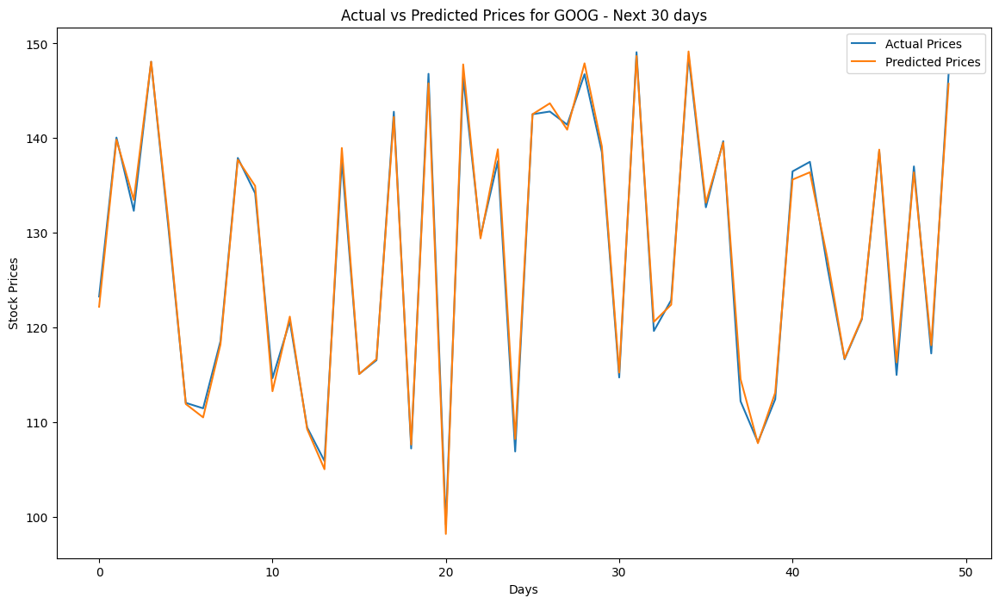


Predictions for GOOG for the next 60 days:
Predicted prices for GOOG for the next 60 days: [122.17247957 139.82680145 133.46359151 148.0663317  131.04335663
 111.89625402 110.48124221 118.18743706 137.7105958  134.94004922
 113.24632986 121.13221264 109.2382195  105.00020204 138.95110226
 115.0576966  116.64636111 142.2276976  107.61259579 145.78309952
  98.15965534 147.78299141 129.3986317  138.81227204 108.19557784
 142.51832693 143.67234752 140.88548994 147.8995994  139.10804518
 115.21884173 148.6715301  120.5813854  122.39233624 149.15223837
 133.16424925 139.52367776 114.52657862 107.75271417 113.09983441
 135.61318162 136.38473599 127.37530776 116.70325665 120.96145444
 138.77745825 116.30188962 136.37285266 118.10690679 145.7306108 ]


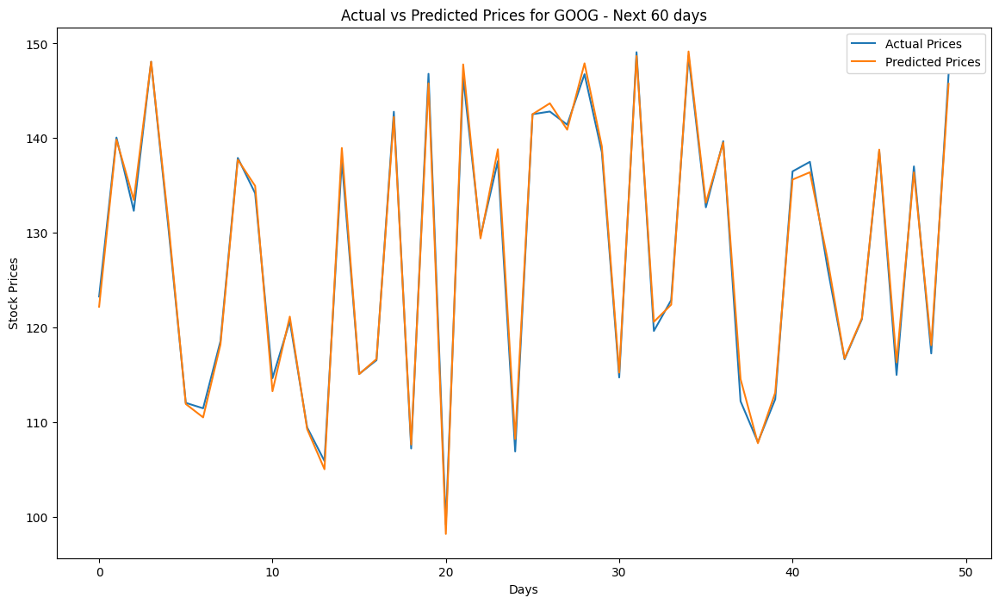


Predictions for AMZN for the next 5 days:
Predicted prices for AMZN for the next 5 days: [144.3645038  164.65077993 156.82430752 170.99507071 145.98378732]


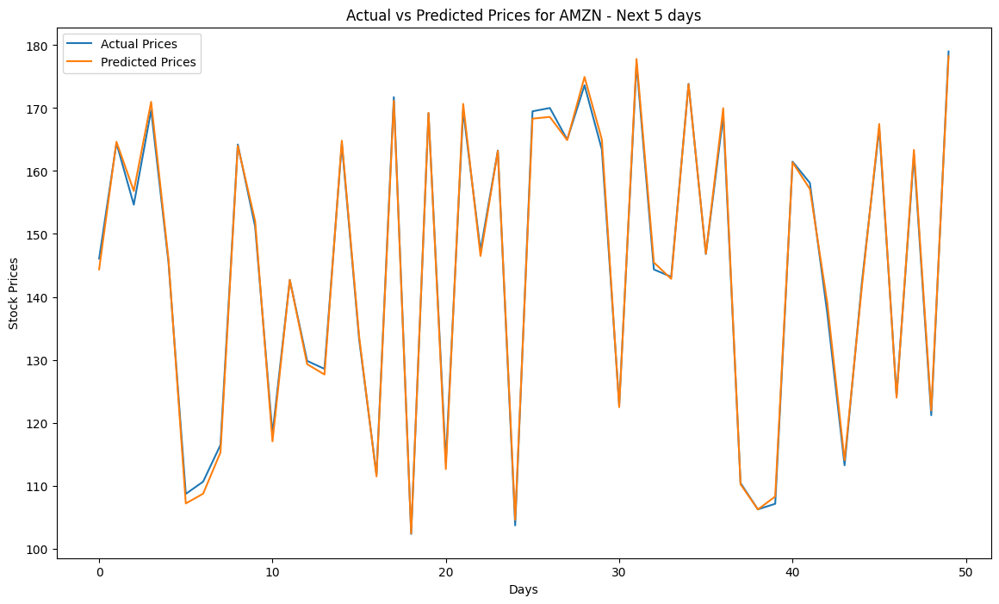


Predictions for AMZN for the next 30 days:
Predicted prices for AMZN for the next 30 days: [144.3645038  164.65077993 156.82430752 170.99507071 145.98378732
 107.16213961 108.70947419 115.27201793 164.01489742 152.04593304
 117.02152939 142.70113568 129.29529214 127.65699118 164.82268876
 133.68243905 111.45800825 171.18428948 102.40585138 169.25630601
 112.62837235 170.67067103 146.49415601 163.18856781 104.55999619
 168.32497379 168.59832448 164.9093172  174.95267159 165.00867958]


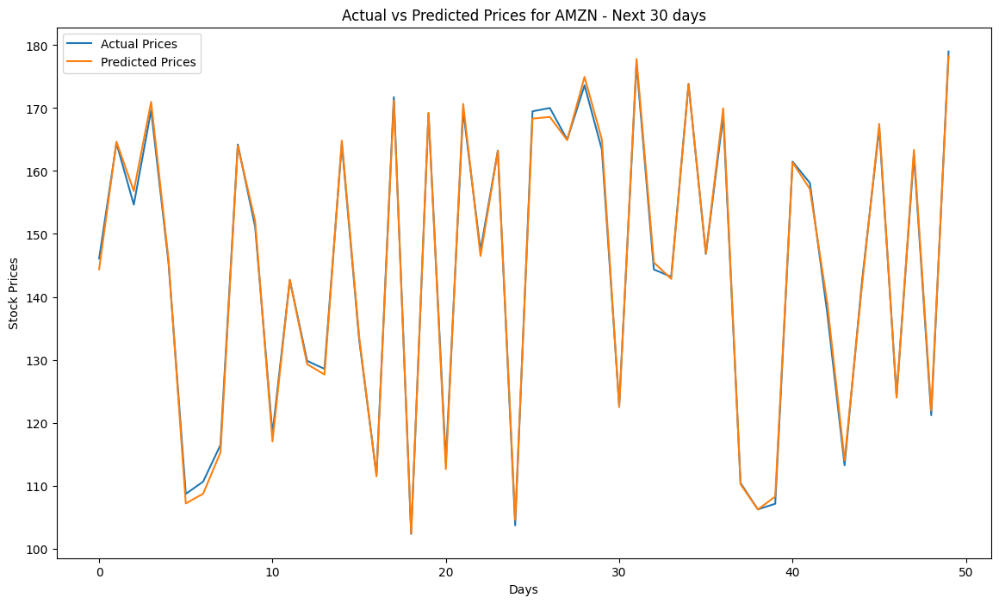


Predictions for AMZN for the next 60 days:
Predicted prices for AMZN for the next 60 days: [144.3645038  164.65077993 156.82430752 170.99507071 145.98378732
 107.16213961 108.70947419 115.27201793 164.01489742 152.04593304
 117.02152939 142.70113568 129.29529214 127.65699118 164.82268876
 133.68243905 111.45800825 171.18428948 102.40585138 169.25630601
 112.62837235 170.67067103 146.49415601 163.18856781 104.55999619
 168.32497379 168.59832448 164.9093172  174.95267159 165.00867958
 122.46327906 177.8106829  145.46168425 142.85478249 173.80933825
 146.87010576 169.97907849 110.21248054 106.20458703 108.26886694
 161.37490994 157.1387922  139.09581703 114.04846201 141.63357403
 167.47325396 123.97393095 163.36013567 121.95082283 178.24539693]


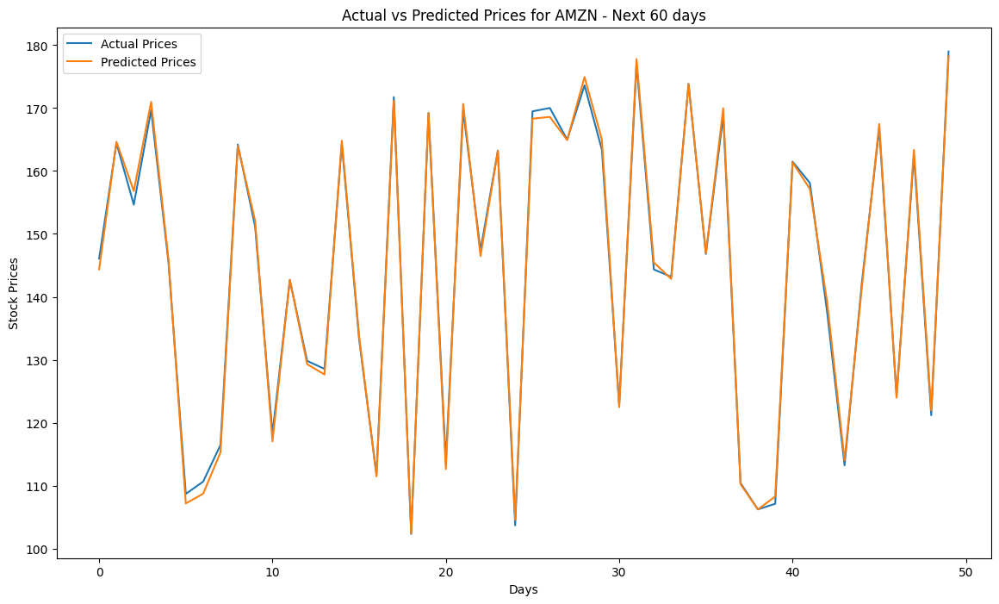


Predictions for AAPL for the next 5 days:
Predicted prices for AAPL for the next 5 days: [160.56852853 142.84809531 170.27512956 179.88845137 155.67377453]


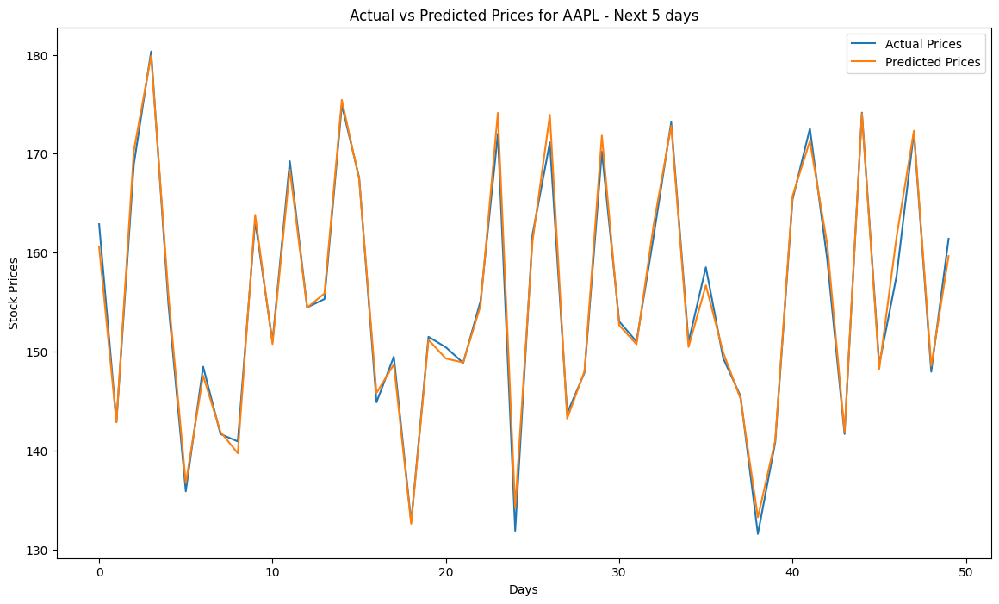


Predictions for AAPL for the next 30 days:
Predicted prices for AAPL for the next 30 days: [160.56852853 142.84809531 170.27512956 179.88845137 155.67377453
 136.70977211 147.55065289 141.88194621 139.71709204 163.81073924
 150.75617892 168.37976034 154.44266625 155.87388625 175.43542577
 167.4035451  145.80518818 148.70290459 132.58829592 151.17922048
 149.29272101 148.89313224 154.62378004 174.12108117 134.19410107
 161.14487854 173.92687513 143.2262827  148.01904591 171.82576533]


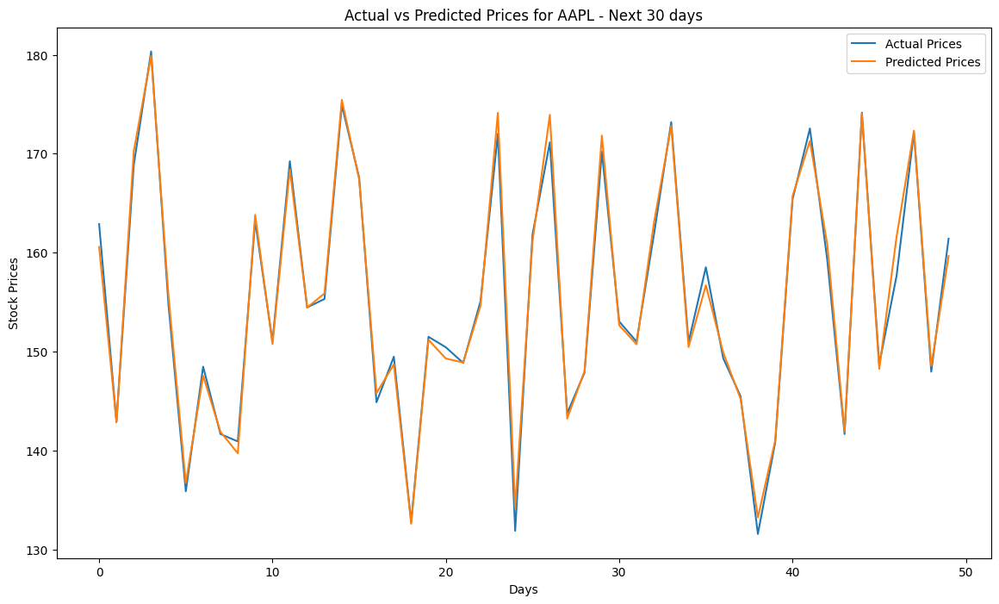


Predictions for AAPL for the next 60 days:
Predicted prices for AAPL for the next 60 days: [160.56852853 142.84809531 170.27512956 179.88845137 155.67377453
 136.70977211 147.55065289 141.88194621 139.71709204 163.81073924
 150.75617892 168.37976034 154.44266625 155.87388625 175.43542577
 167.4035451  145.80518818 148.70290459 132.58829592 151.17922048
 149.29272101 148.89313224 154.62378004 174.12108117 134.19410107
 161.14487854 173.92687513 143.2262827  148.01904591 171.82576533
 152.65588016 150.72521713 162.96552778 172.81155229 150.45690398
 156.69243618 149.90724749 145.21543011 133.24514464 141.0170753
 165.72450841 171.28578254 160.83650657 141.90094408 174.07058514
 148.24408888 161.59847761 172.32073174 148.54636672 159.65140088]


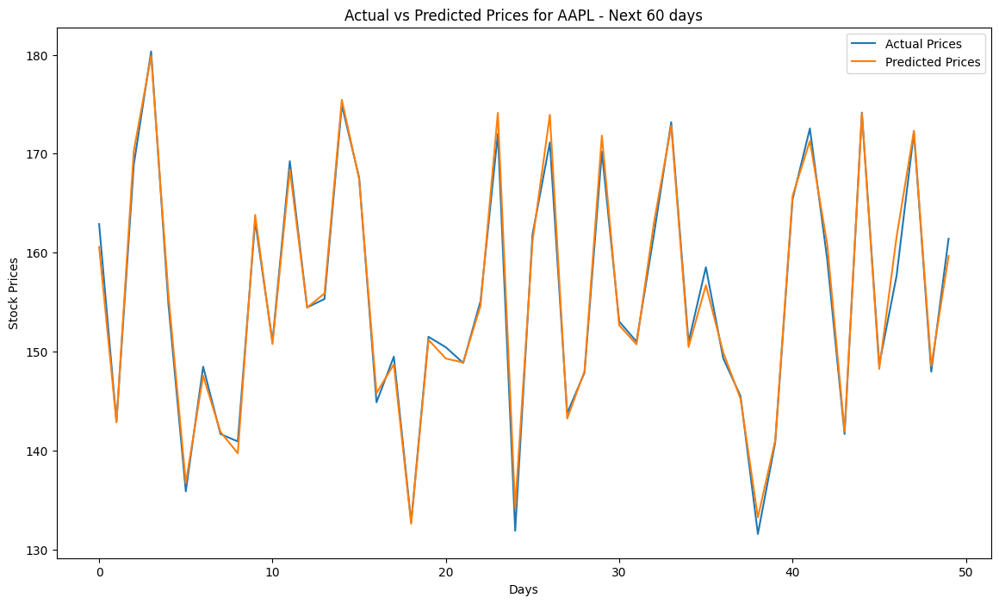


Predictions for TSLA for the next 5 days:
Predicted prices for TSLA for the next 5 days: [334.11406271 260.88338609 294.08525099 369.77214382 267.34304825]


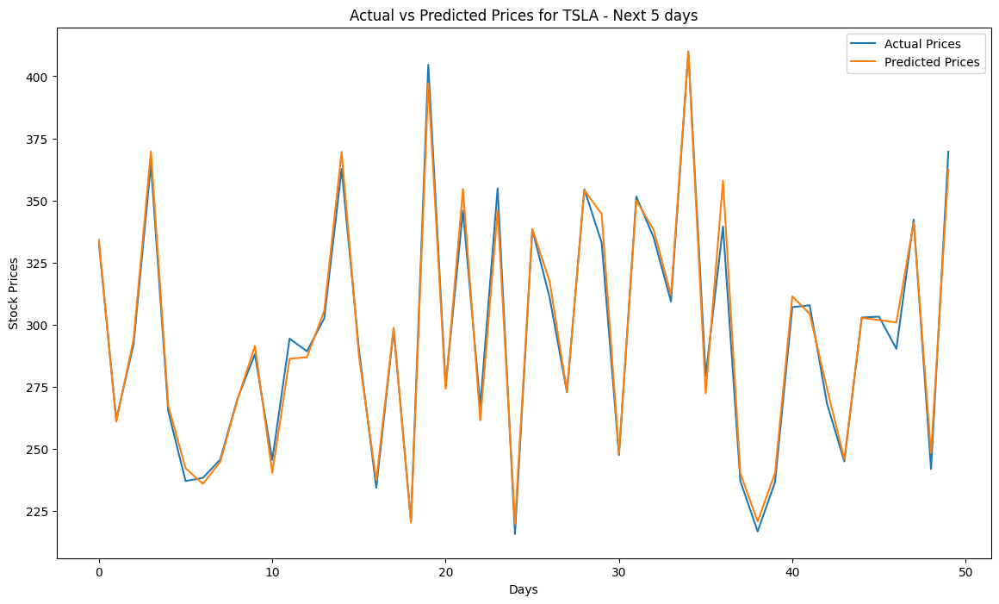


Predictions for TSLA for the next 30 days:
Predicted prices for TSLA for the next 30 days: [334.11406271 260.88338609 294.08525099 369.77214382 267.34304825
 242.18093567 235.91440438 244.7355506  270.00110101 291.43771458
 240.35785457 286.27957907 286.88377776 305.63133034 369.58160351
 287.48686066 237.32327132 298.73765591 220.31057981 397.20021078
 274.17311101 354.6461294  261.53775921 346.02749659 219.80979763
 338.53905469 317.43746705 272.98775995 354.14357364 344.55159922]


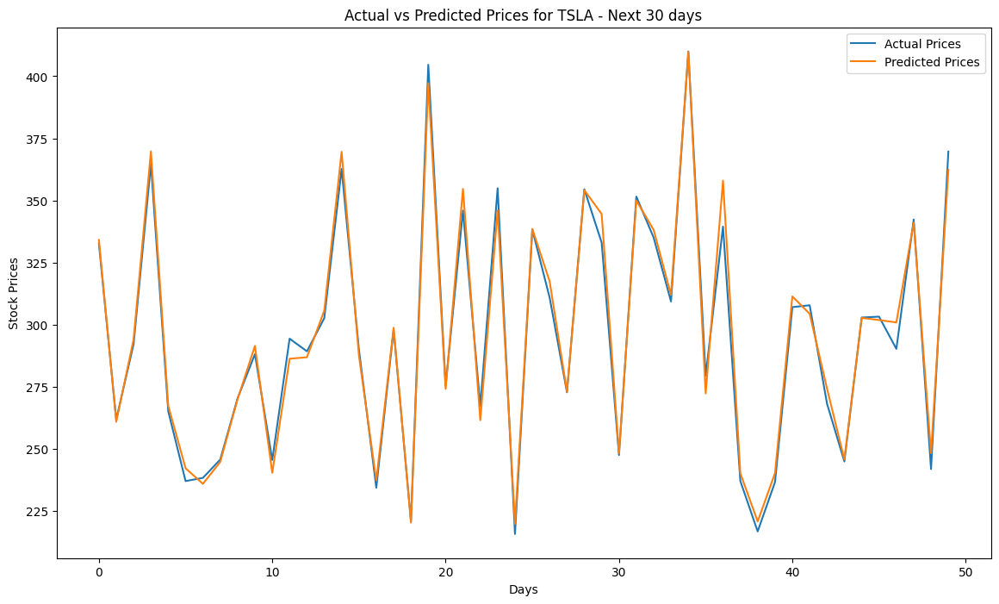


Predictions for TSLA for the next 60 days:
Predicted prices for TSLA for the next 60 days: [334.11406271 260.88338609 294.08525099 369.77214382 267.34304825
 242.18093567 235.91440438 244.7355506  270.00110101 291.43771458
 240.35785457 286.27957907 286.88377776 305.63133034 369.58160351
 287.48686066 237.32327132 298.73765591 220.31057981 397.20021078
 274.17311101 354.6461294  261.53775921 346.02749659 219.80979763
 338.53905469 317.43746705 272.98775995 354.14357364 344.55159922
 248.21770416 349.97247256 338.15601462 311.99382349 409.80038176
 272.33958389 357.99930902 240.16122396 220.76121061 240.24099105
 311.36665449 304.3580238  274.28460906 245.76467002 302.72622855
 301.85596662 300.8910937  341.07922984 248.23998713 362.33011393]


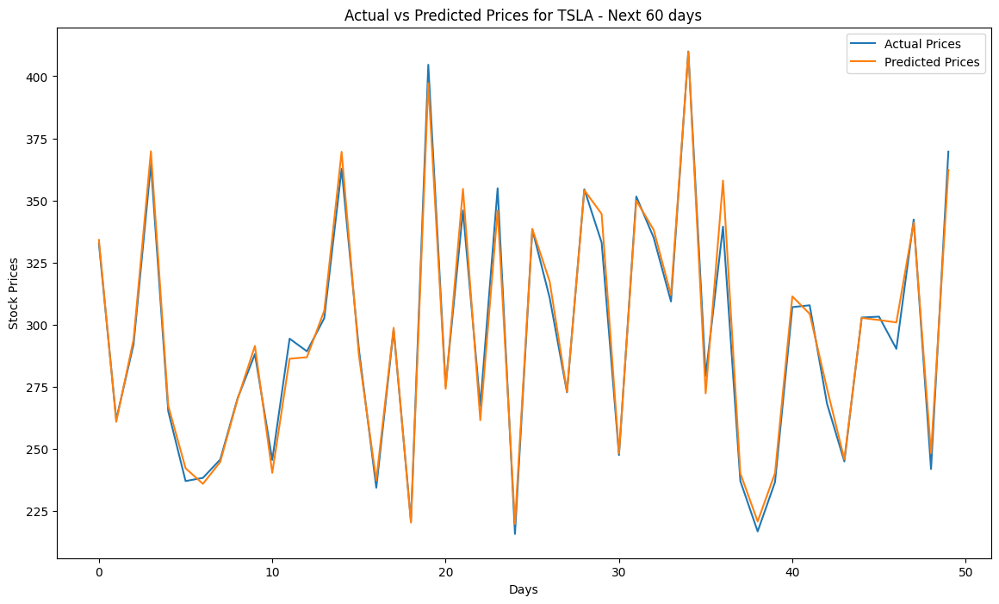


Predictions for VZ for the next 5 days:
Predicted prices for VZ for the next 5 days: [49.97361554 53.43544151 53.27181331 52.38197154 53.2474022 ]


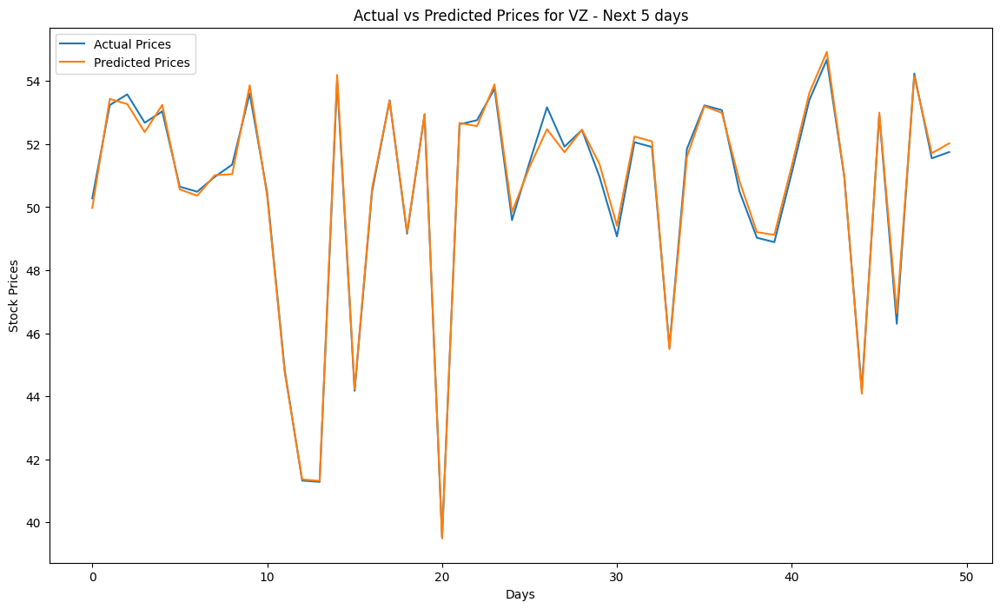


Predictions for VZ for the next 30 days:
Predicted prices for VZ for the next 30 days: [49.97361554 53.43544151 53.27181331 52.38197154 53.2474022  50.56430832
 50.36200288 51.01254783 51.04789553 53.86954726 50.35480763 44.7723252
 41.35827638 41.31244148 54.19800485 44.22364527 50.61158195 53.37456366
 49.20866092 52.95613683 39.48694513 52.67240914 52.57120914 53.89769294
 49.84296961 51.27286735 52.47386978 51.74423452 52.46088375 51.3688793 ]


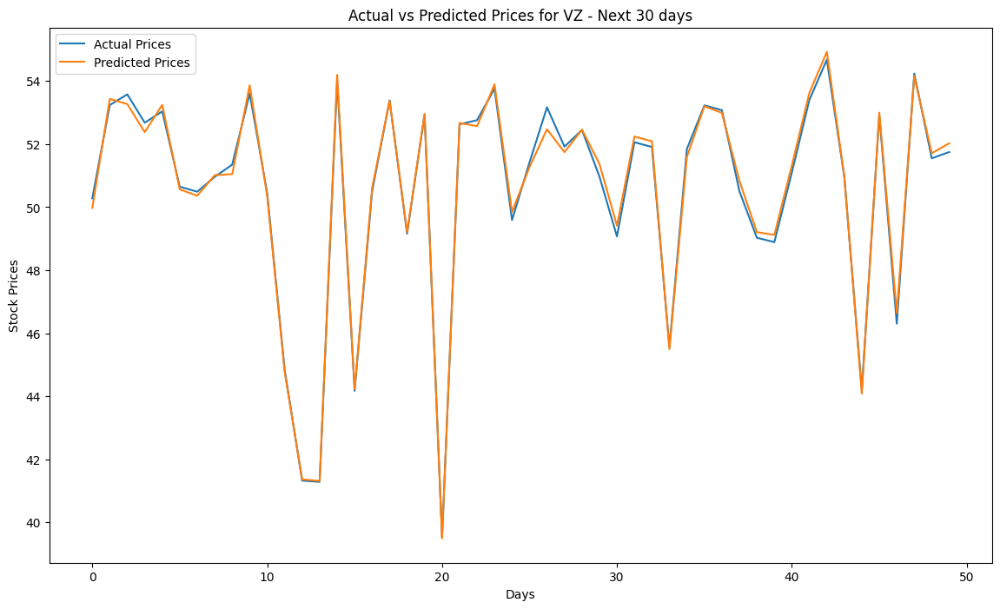


Predictions for VZ for the next 60 days:
Predicted prices for VZ for the next 60 days: [49.97361554 53.43544151 53.27181331 52.38197154 53.2474022  50.56430832
 50.36200288 51.01254783 51.04789553 53.86954726 50.35480763 44.7723252
 41.35827638 41.31244148 54.19800485 44.22364527 50.61158195 53.37456366
 49.20866092 52.95613683 39.48694513 52.67240914 52.57120914 53.89769294
 49.84296961 51.27286735 52.47386978 51.74423452 52.46088375 51.3688793
 49.41250732 52.24182145 52.08948499 45.49244427 51.59541111 53.20474622
 52.99217681 50.83876282 49.20732094 49.11962224 51.32235236 53.62510556
 54.92787673 50.98064945 44.08143964 53.00078046 46.63820797 54.1595422
 51.71160886 52.02641249]


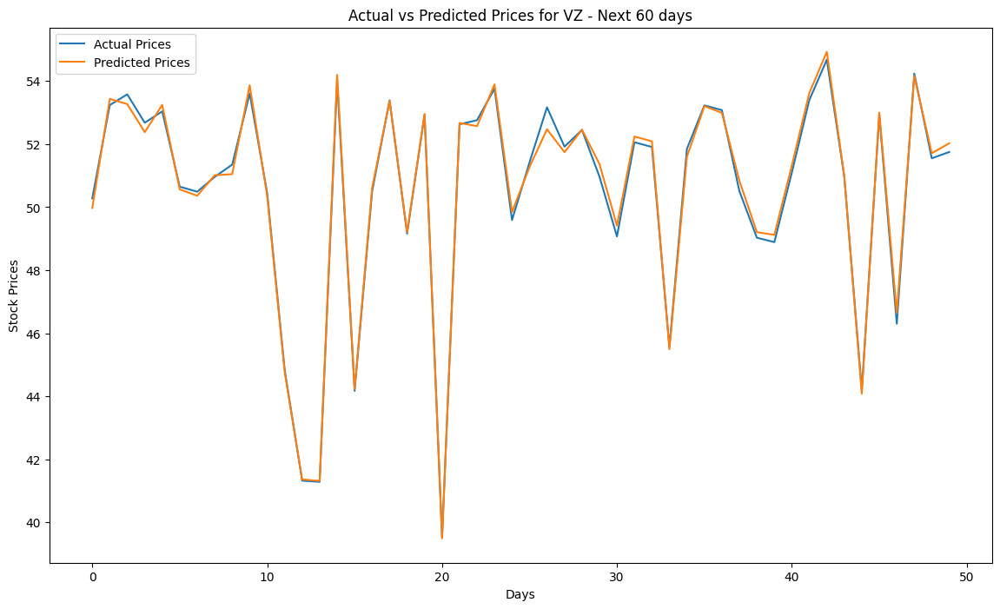


Predictions for KO for the next 5 days:
Predicted prices for KO for the next 5 days: [65.57564609 54.22147867 61.82018248 58.54710915 58.60848067]


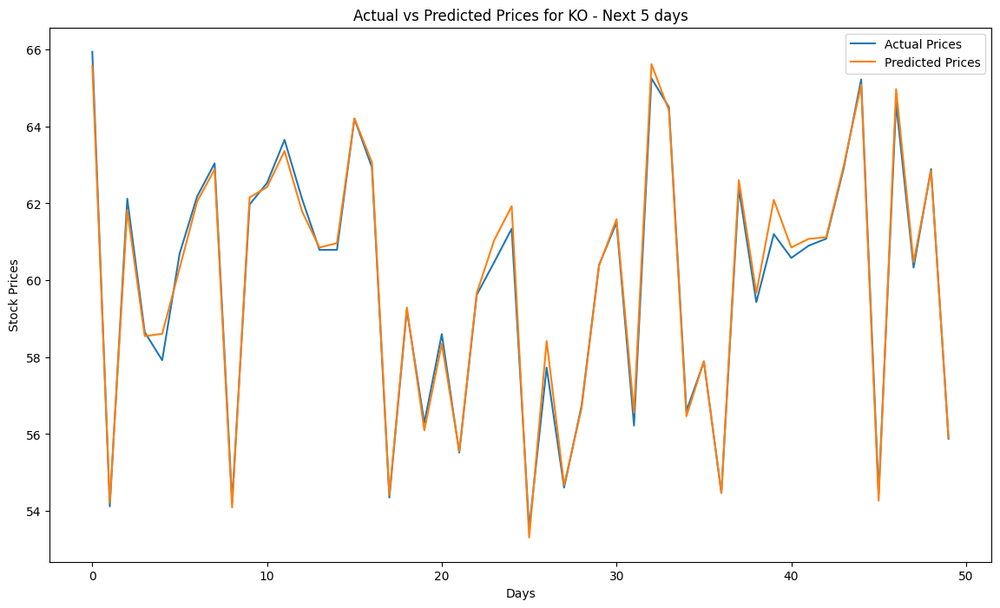


Predictions for KO for the next 30 days:
Predicted prices for KO for the next 30 days: [65.57564609 54.22147867 61.82018248 58.54710915 58.60848067 60.31803826
 62.04706805 62.88442861 54.08992739 62.15446797 62.42106028 63.36105218
 61.7946011  60.8504107  60.96440952 64.20681062 63.06991725 54.41067983
 59.29289326 56.09802296 58.34794885 55.55800866 59.66543278 61.04282954
 61.92570448 53.31083051 58.41875193 54.67193977 56.67371846 60.37585266]


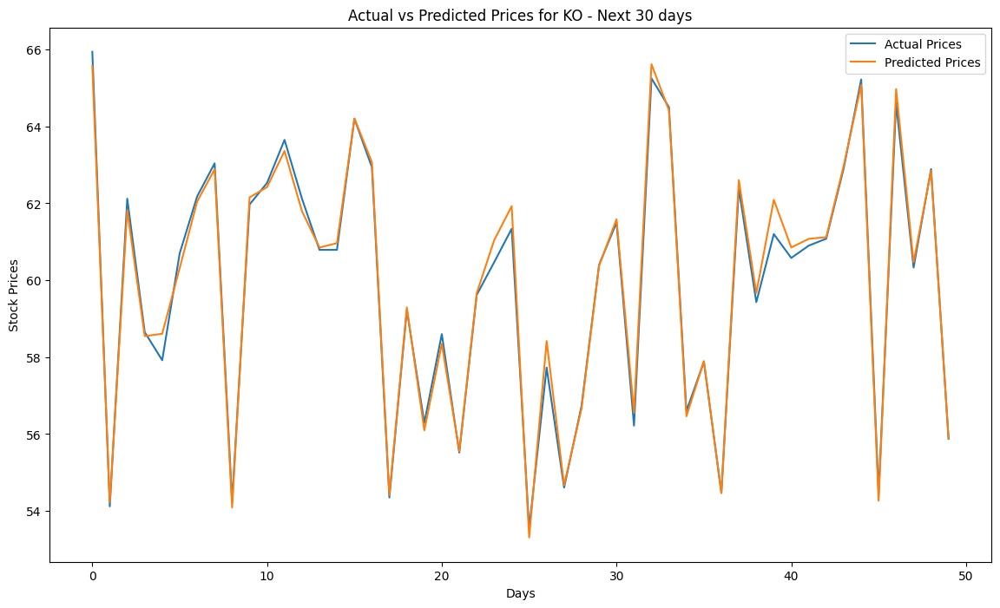


Predictions for KO for the next 60 days:
Predicted prices for KO for the next 60 days: [65.57564609 54.22147867 61.82018248 58.54710915 58.60848067 60.31803826
 62.04706805 62.88442861 54.08992739 62.15446797 62.42106028 63.36105218
 61.7946011  60.8504107  60.96440952 64.20681062 63.06991725 54.41067983
 59.29289326 56.09802296 58.34794885 55.55800866 59.66543278 61.04282954
 61.92570448 53.31083051 58.41875193 54.67193977 56.67371846 60.37585266
 61.58681672 56.55467626 65.61768603 64.4170409  56.46371052 57.89814873
 54.4669303  62.60280243 59.66903299 62.09128026 60.85228675 61.07606726
 61.12019337 62.97471376 65.08263878 54.26684741 64.97119108 60.47273552
 62.8479747  55.90457873]


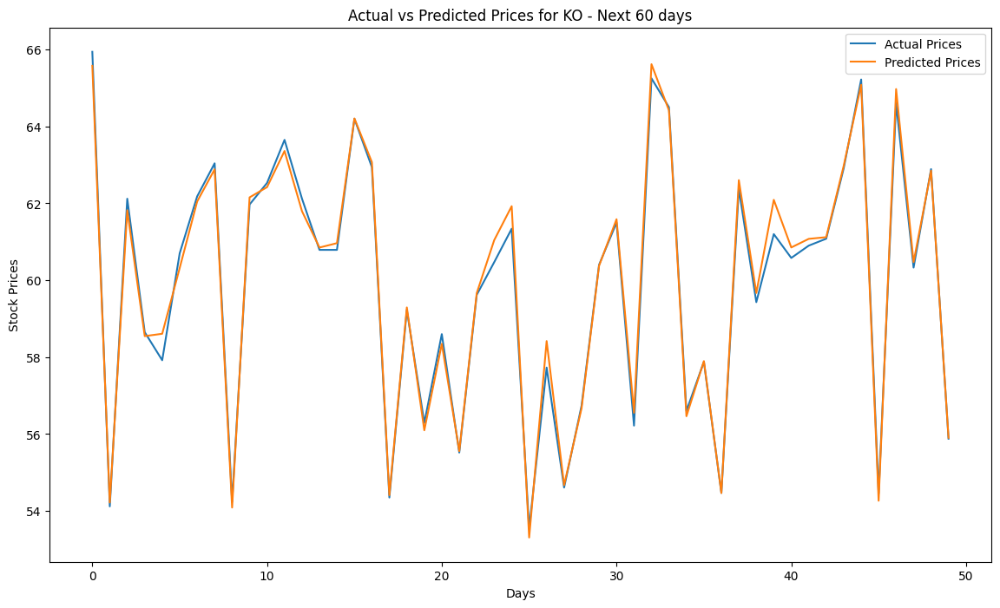

In [ ]:
# Function to predict future prices for a company over a specified number of days
def predict_future_prices(company, data, days):
    X_train, X_test, y_train, y_test = prepare_data(data)
    model = LinearRegression()
    model.fit(X_train, y_train)
    prediction = model.predict(X_test)
    print(f"Predicted prices for {company} for the next {days} days: {prediction[:days]}")

    # Visualization of the actual vs. predicted prices
    plt.figure(figsize=(14, 8))
    plt.plot(y_test.values, label='Actual Prices')  # Plot actual prices
    plt.plot(prediction, label='Predicted Prices')  # Plot predicted prices
    plt.title(f'Actual vs Predicted Prices for {company} - Next {days} days')
    plt.xlabel('Days')
    plt.ylabel('Stock Prices')
    plt.legend()
    plt.show()

def run_predictions_for_all_horizons(companies, data):
    horizons = [5, 30, 60]  # Define the time horizons for predictions
    for company in companies:
        for days in horizons:
            print(f"\nPredictions for {company} for the next {days} days:")
            predict_future_prices(company, data[company], days)
run_predictions_for_all_horizons(technical_data.keys(), technical_data)


Plotting Functions for Technical Indicators and Sentiment Analysis

In [ ]:
# Function to plot stock prices with moving averages
def price_plot_ma(df, ax=None, **plt_kwargs):
    n = df.shape[0]  # Number of data points

    # If no axis is provided, create one
    if ax is None:
        ax = plt.gca()

    # Prepare the data by melting it for easier plotting
    df = df.melt(id_vars='Date', var_name='var', value_name='vals')
    df = df[df['var'].isin(['Close', 'MA10', 'MA20', 'MA50', 'MA100'])]
    df['vals'] = df['vals'].astype(float)
    df.index = df.Date.dt.date
    df.Date = df.Date.dt.date

    # Set the major and minor ticks for the x-axis
    major_locator = mdates.MonthLocator()
    major_fmt = mdates.DateFormatter('%b')
    minor_locator = mdates.DayLocator(interval=1)
    minor_fmt = mdates.DateFormatter('%d')
    ax.xaxis.set_major_locator(major_locator)
    ax.xaxis.set_major_formatter(major_fmt)
    ax.xaxis.set_minor_locator(minor_locator)
    ax.grid(True, which='major', axis='both')

    # Adjust the tick format based on the number of data points
    if n > 750:
        major_locator = mdates.YearLocator()
        major_fmt = mdates.DateFormatter('%Y')
        ax.xaxis.set_major_locator(major_locator)
        ax.xaxis.set_major_formatter(major_fmt)

    elif 250 < n < 750:
        major_locator = mdates.MonthLocator()
        major_fmt = mdates.DateFormatter('%b-%Y')
        ax.xaxis.set_major_locator(major_locator)
        ax.xaxis.set_major_formatter(major_fmt)

    elif 90 < n < 250:
        major_locator = mdates.MonthLocator()
        major_fmt = mdates.DateFormatter('%b-%y')
        minor_locator = tkr.AutoMinorLocator(4)
        ax.xaxis.set_major_locator(major_locator)
        ax.xaxis.set_major_formatter(major_fmt)
        ax.xaxis.set_minor_locator(minor_locator)

    # Configure axis labels and grid
    ax.set_ylabel('Close Price')
    ax.set_xlabel('Date')
    ax.tick_params(axis='x', labelrotation=45)
    ax.yaxis.set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x), ',')))

    # Plot the data
    sns.lineplot(data=df, x='Date', y='vals', hue='var', palette='cool_r', ax=ax)
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5), fancybox=True, shadow=True)
    return ax

# Function to plot trading volume
def price_plot_vol(df, ax=None, **plt_kwargs):
    n = df.shape[0]  # Number of data points
    df.index = df.Date.dt.date

    # If no axis is provided, create one
    if ax is None:
        ax = plt.gca()

    # Set the major and minor ticks for the x-axis
    major_locator = mdates.MonthLocator()
    major_fmt = mdates.DateFormatter('%b')
    minor_locator = mdates.DayLocator(interval=1)
    minor_fmt = mdates.DateFormatter('%d')
    ax.xaxis.set_major_locator(major_locator)
    ax.xaxis.set_major_formatter(major_fmt)
    ax.xaxis.set_minor_locator(minor_locator)
    ax.grid(True, which='major', axis='both')

    # Adjust the tick format based on the number of data points
    if n > 750:
        major_locator = mdates.YearLocator()
        major_fmt = mdates.DateFormatter('%Y')
        ax.xaxis.set_major_locator(major_locator)
        ax.xaxis.set_major_formatter(major_fmt)

    elif 250 < n < 750:
        major_locator = mdates.MonthLocator()
        major_fmt = mdates.DateFormatter('%b-%Y')
        ax.xaxis.set_major_locator(major_locator)
        ax.xaxis.set_major_formatter(major_fmt)

    elif 90 < n < 250:
        major_locator = mdates.MonthLocator()
        major_fmt = mdates.DateFormatter('%b-%y')
        minor_locator = tkr.AutoMinorLocator(4)
        ax.xaxis.set_major_locator(major_locator)
        ax.xaxis.set_major_formatter(major_fmt)
        ax.xaxis.set_minor_locator(minor_locator)

    # Configure axis labels and grid
    ax.set_ylabel('Traded Volume (million)')
    ax.set_xlabel('Date')
    ax.tick_params(axis='x', labelrotation=45)
    ax.yaxis.set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x / 1000000), ',')))

    # Plot the data
    sns.lineplot(data=df, x='Date', y='Volume', palette='cool_r', ax=ax)
    return ax

# Function to plot sentiment analysis as a bar plot
def sentiment_barplot(df, ax=None, **plt_kwargs):
    # Group and pivot the data for plotting
    df = df.groupby(['Date', 'Emotions'])['Tweet'].agg('count').reset_index(name="count")
    df = df.pivot(index='Date', columns='Emotions', values='count')
    df = pd.DataFrame(df.to_records()).reset_index()
    df["total"] = df[['anger', 'happiness', 'sadness', 'surprise', 'confusion', 'neutral']].sum(axis=1)
    df[['anger', 'happiness', 'sadness', 'surprise', 'confusion', 'neutral']] = df[['anger', 'happiness', 'sadness', 'surprise', 'confusion', 'neutral']].div(df.total, axis=0)
    df = df.drop(['total'], axis=1)

    df.index = df.Date.dt.date

    # If no axis is provided, create one
    if ax is None:
        ax = plt.gca()

    # Define colors for the bar plot
    colors = ['crimson', 'lightgrey', 'mediumseagreen']

    # Plot the bar plot
    df[['anger', 'happiness', 'sadness', 'surprise', 'confusion', 'neutral']].plot.bar(stacked=True, color=colors, width=1.0, alpha=0.5, ax=ax)

    # Set the major and minor ticks for the x-axis
    major_locator = mdates.MonthLocator()
    major_fmt = mdates.DateFormatter('%b')
    minor_locator = mdates.DayLocator(interval=1)
    minor_fmt = mdates.DateFormatter('%d')
    ax.xaxis.set_major_locator(major_locator)
    ax.xaxis.set_major_formatter(major_fmt)
    ax.xaxis.set_minor_locator(minor_locator)
    ax.grid(True, which='major', axis='both')

    # Adjust the tick format based on the number of data points
    if len(df.Date.unique()) > 750:
        major_locator = mdates.YearLocator()
        major_fmt = mdates.DateFormatter('%Y')
        ax.xaxis.set_major_locator(major_locator)
        ax.xaxis.set_major_formatter(major_fmt)

    elif 250 < len(df.Date.unique()) < 750:
        major_locator = mdates.MonthLocator()
        major_fmt = mdates.DateFormatter('%b-%Y')
        ax.xaxis.set_major_locator(major_locator)
        ax.xaxis.set_major_formatter(major_fmt)

    elif 90 < len(df.Date.unique()) < 250:
        major_locator = mdates.MonthLocator()
        major_fmt = mdates.DateFormatter('%b-%y')
        minor_locator = tkr.AutoMinorLocator(4)
        ax.xaxis.set_major_locator(major_locator)
        ax.xaxis.set_major_formatter(major_fmt)
        ax.xaxis.set_minor_locator(minor_locator)

    # Configure axis labels and grid
    ax.set_ylabel('Sentiment')
    ax.set_xlabel('Date')
    ax.tick_params(axis='x', labelrotation=45)
    ax.grid(True, which='major', axis='both')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5), fancybox=True, shadow=True)

    return ax

# Function to plot tweet volume over time
def sentiment_tweet_vol(df, ax=None, **kwargs):
    # Group the data by date and count the number of tweets
    df = df.groupby(['Date'])['Tweet'].agg('count').reset_index(name="count")
    df.index = df.Date.dt.date

    # If no axis is provided, create one
    if ax is None:
        ax = plt.gca()

    # Set the major and minor ticks for the x-axis
    major_locator = mdates.MonthLocator()
    major_fmt = mdates.DateFormatter('%b')
    minor_locator = mdates.DayLocator(interval=1)
    minor_fmt = mdates.DateFormatter('%d')
    ax.xaxis.set_major_locator(major_locator)
    ax.xaxis.set_major_formatter(major_fmt)
    ax.xaxis.set_minor_locator(minor_locator)
    ax.grid(True, which='major', axis='both')

    # Adjust the tick format based on the number of data points
    if len(df.Date.unique()) > 750:
        major_locator = mdates.YearLocator()
        major_fmt = mdates.DateFormatter('%Y')
        ax.xaxis.set_major_locator(major_locator)
        ax.xaxis.set_major_formatter(major_fmt)

    elif 250 < len(df.Date.unique()) < 750:
        major_locator = mdates.MonthLocator()
        major_fmt = mdates.DateFormatter('%b-%Y')
        ax.xaxis.set_major_locator(major_locator)
        ax.xaxis.set_major_formatter(major_fmt)

    elif 90 < len(df.Date.unique()) < 250:
        major_locator = mdates.MonthLocator()
        major_fmt = mdates.DateFormatter('%b-%y')
        minor_locator = tkr.AutoMinorLocator(4)
        ax.xaxis.set_major_locator(major_locator)
        ax.xaxis.set_major_formatter(major_fmt)
        ax.xaxis.set_minor_locator(minor_locator)

    # Configure axis labels and grid
    ax.set_ylabel('Tweet Volume')
    ax.set_xlabel('Date')
    ax.tick_params(axis='x', labelrotation=45)
    ax.yaxis.set_major_formatter(tkr.FuncFormatter(lambda x, p: format(int(x), ',')))

    # Plot the tweet volume
    sns.lineplot(data=df, x='Date', y='count', palette='cool_r', ax=ax)

    return ax


Distribution of 'Close' feature for all companies

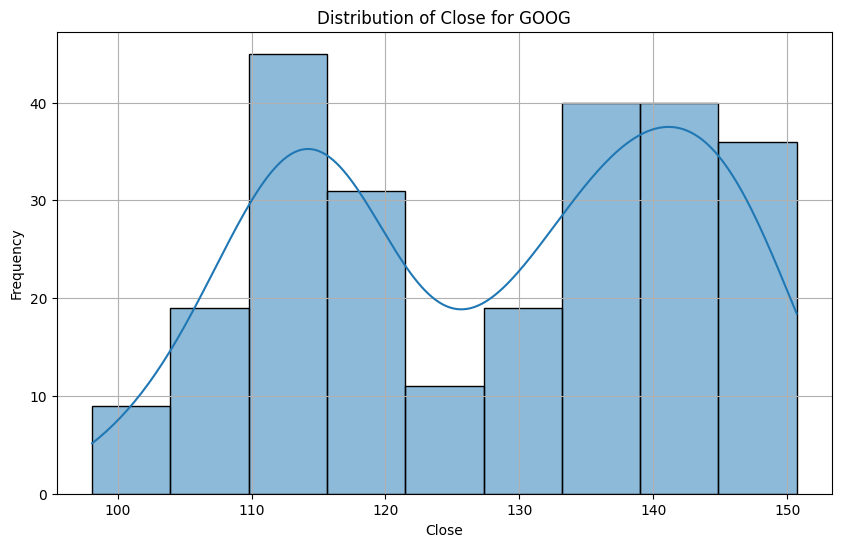

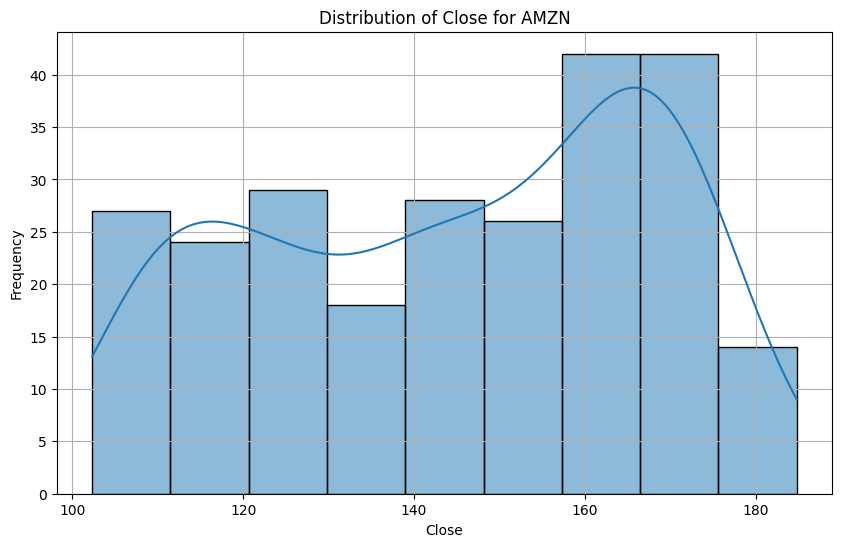

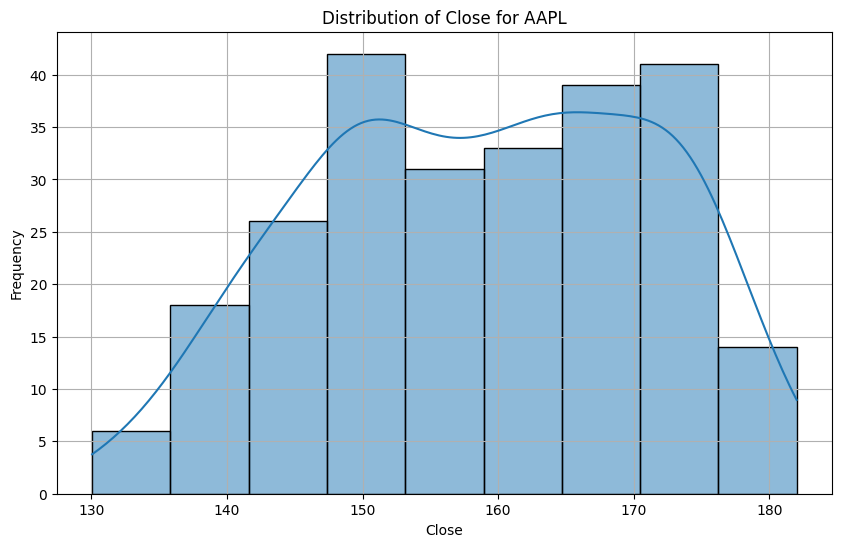

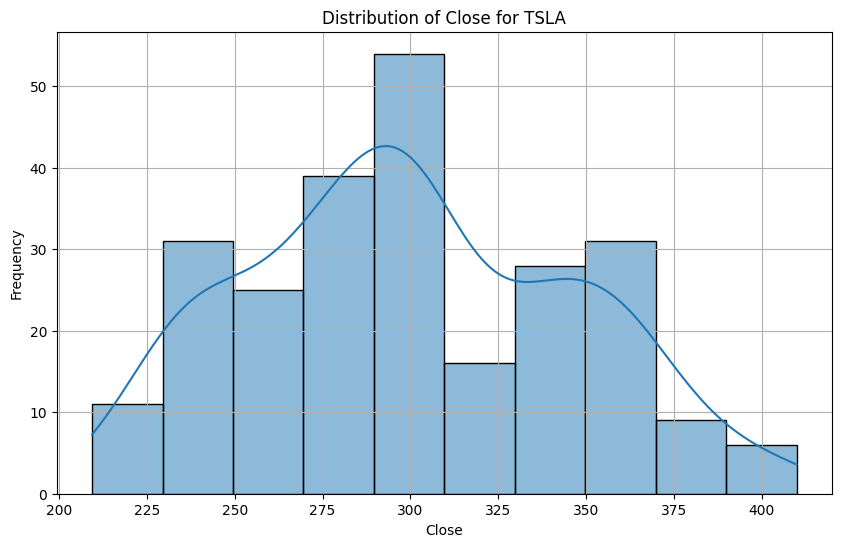

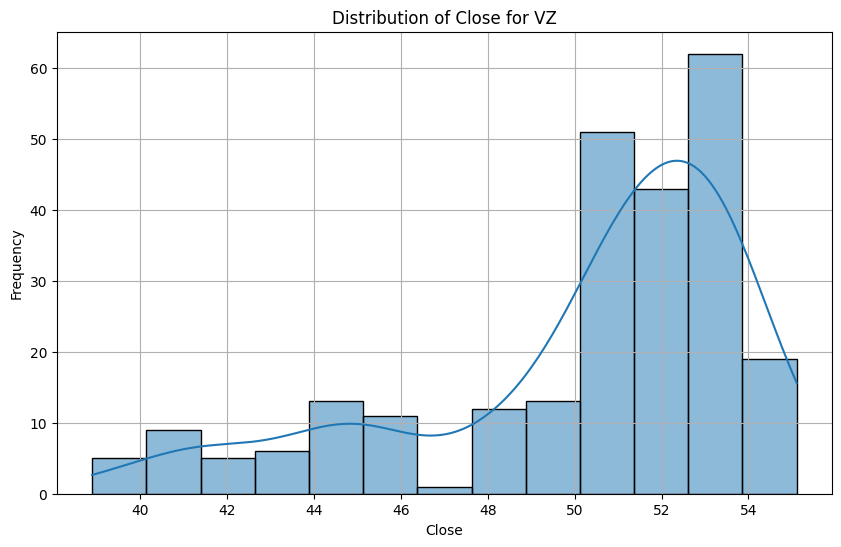

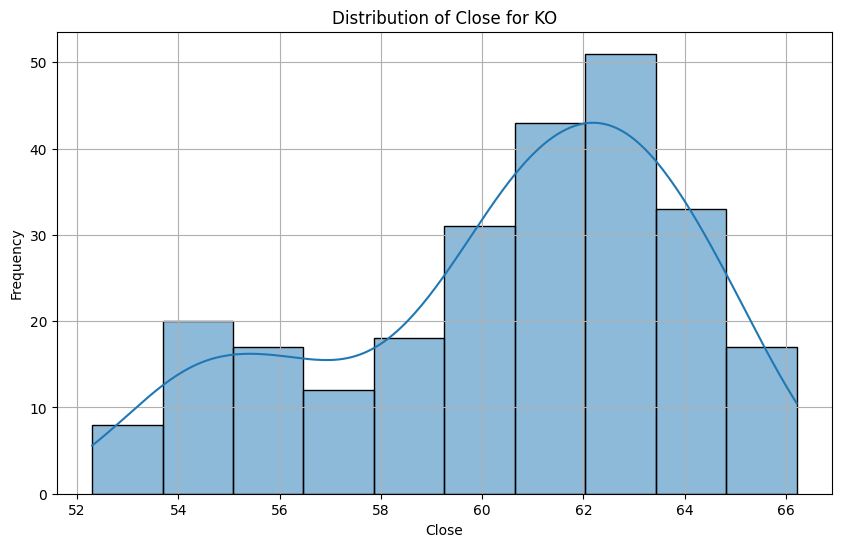

In [ ]:
# Function to visualize feature distributions
def visualize_feature_distribution(data, feature, company):
    plt.figure(figsize=(10, 6))
    sns.histplot(data[feature].dropna(), kde=True)
    plt.title(f'Distribution of {feature} for {company}')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

# Visualize the distribution of 'Close' feature for all companies
def visualize_feature_distributions_all_companies(company_data, feature):
    for company, data in company_data.items():
        if feature in data.columns:
            visualize_feature_distribution(data, feature, company)
        else:
            print(f"Skipping {company}: '{feature}' column is missing.")

# Call the function to visualize the 'Close' feature for all companies
visualize_feature_distributions_all_companies(company_data, 'Close')

Emotions Distribution in Tweets

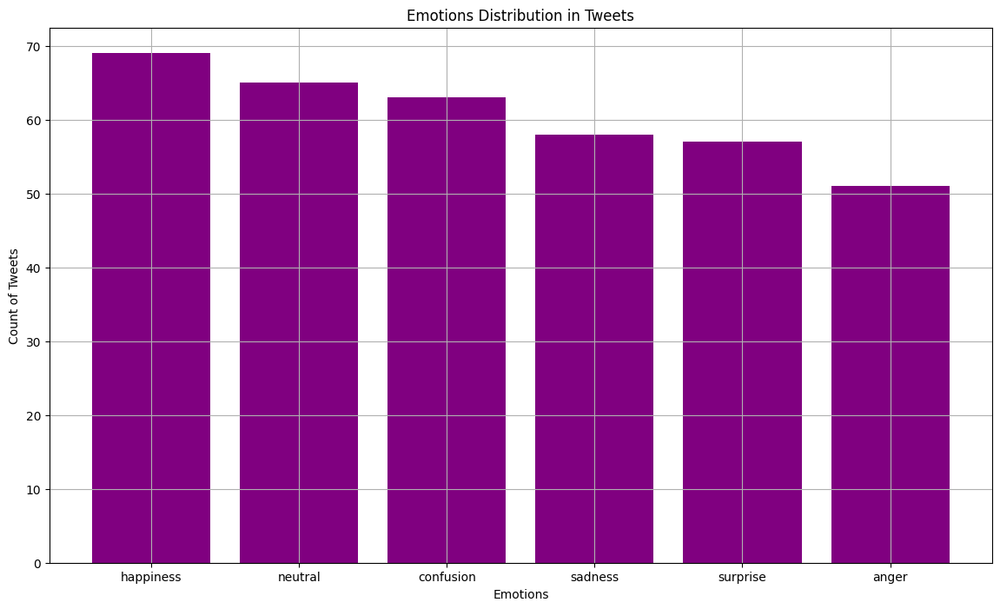

In [ ]:
def visualize_emotions_distribution(sentiment_data):
    emotions = ['happiness', 'sadness', 'anger', 'surprise', 'neutral', 'confusion']
    emotion_counts = sentiment_data['Emotions'].value_counts()
    plt.figure(figsize=(14, 8))
    plt.bar(emotion_counts.index, emotion_counts.values, color='purple')
    plt.title('Emotions Distribution in Tweets')
    plt.xlabel('Emotions')
    plt.ylabel('Count of Tweets')
    plt.grid(True)
    plt.show()

visualize_emotions_distribution(sentiment_data)

Sentiment Analysis on Stock Prices: T-Test Comparison Across Multiple Companies

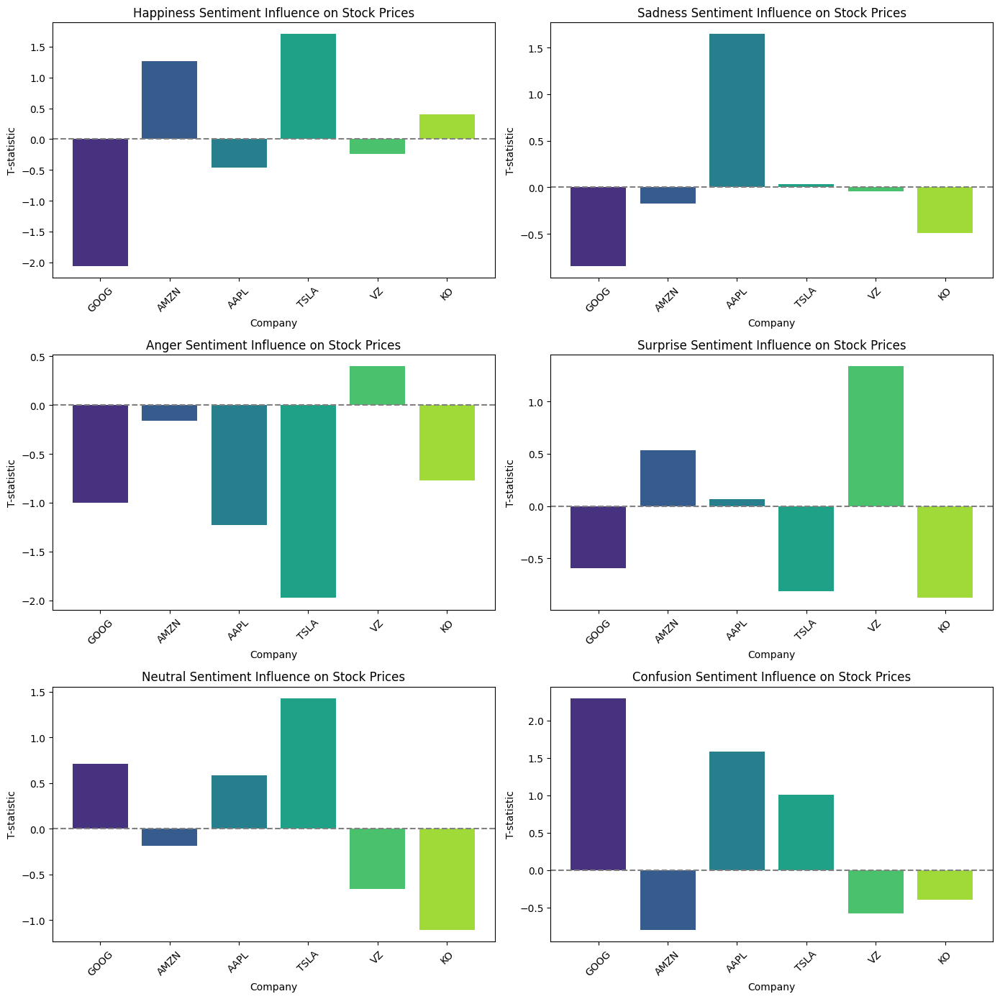

In [ ]:
# Generate the dataset with stock prices and sentiment data
np.random.seed(0)
dates = pd.date_range(start='2021-01-01', periods=300)

# Create a DataFrame for stock prices
stock_df = pd.DataFrame({
    'Date': np.tile(dates, 24),
    'Symbol': np.repeat(['AAPL', 'AMD', 'AMZN', 'BA', 'BX', 'COST', 'CRM', 'DIS', 'ENPH', 'F', 'GOOG', 'INTC',
                         'KO', 'META', 'MSFT', 'NFLX', 'NIO', 'NOC', 'PG', 'PYPL', 'TSLA', 'TSM', 'VZ', 'XPEV'], 300),
    'Close': np.random.rand(7200) * 1000
})
sentiment_df = pd.DataFrame({
    'Date': np.tile(dates, 24),
    'Symbol': np.repeat(['AAPL', 'AMD', 'AMZN', 'BA', 'BX', 'COST', 'CRM', 'DIS', 'ENPH', 'F', 'GOOG', 'INTC',
                         'KO', 'META', 'MSFT', 'NFLX', 'NIO', 'NOC', 'PG', 'PYPL', 'TSLA', 'TSM', 'VZ', 'XPEV'], 300),
    'happiness': np.random.rand(7200),
    'sadness': np.random.rand(7200),
    'anger': np.random.rand(7200),
    'surprise': np.random.rand(7200),
    'neutral': np.random.rand(7200),
    'confusion': np.random.rand(7200)
})

# Merge stock prices with sentiment data on 'Date' and 'Symbol'
merged_df = pd.merge(stock_df, sentiment_df, on=['Date', 'Symbol'])
sentiments = ['happiness', 'sadness', 'anger', 'surprise', 'neutral', 'confusion']
companies = ['GOOG', 'AMZN', 'AAPL', 'TSLA', 'VZ', 'KO']

# Function to analyze the influence of sentiments on stock prices using t-tests
def analyze_sentiments(df, sentiments, companies):
    results = {}
    for sentiment in sentiments:
        results[sentiment] = {}
        for company in companies:
            df_company = df[df['Symbol'] == company]
            df_sentiment = df_company.dropna(subset=[sentiment, 'Close'])
            high_sentiment = df_sentiment[df_sentiment[sentiment] > df_sentiment[sentiment].mean()]['Close']
            low_sentiment = df_sentiment[df_sentiment[sentiment] <= df_sentiment[sentiment].mean()]['Close']
            if len(high_sentiment) > 1 and len(low_sentiment) > 1:
                t_stat, p_val = ttest_ind(high_sentiment, low_sentiment, nan_policy='omit')
            else:
                t_stat, p_val = np.nan, np.nan
            results[sentiment][company] = {'t_stat': t_stat, 'p_val': p_val}
    return results

# Perform the sentiment analysis
results = analyze_sentiments(merged_df, sentiments, companies)
fig, axes = plt.subplots(3, 2, figsize=(14, 14))
axes = axes.flatten()
for i, sentiment in enumerate(sentiments):
    t_stats = [results[sentiment][company]['t_stat'] for company in companies]

    axes[i].bar(companies, t_stats, color=sns.color_palette('viridis', len(companies)))
    axes[i].axhline(0, color='gray', linestyle='--')
    axes[i].set_title(f'{sentiment.capitalize()} Sentiment Influence on Stock Prices')
    axes[i].set_xlabel('Company')
    axes[i].set_ylabel('T-statistic')
    axes[i].tick_params(axis='x', rotation=45)
plt.tight_layout()
plt.show()


Sentiment Analysis and T-Test Results for Stock Prices

 Analysis of Sadness Sentiment Impact on Stock Prices with T-Tests


Analyzing sadness sentiment for GOOG
T-test for sadness sentiment in GOOG:
t-statistic: -0.8450969783563193, p-value: 0.3987346861980392


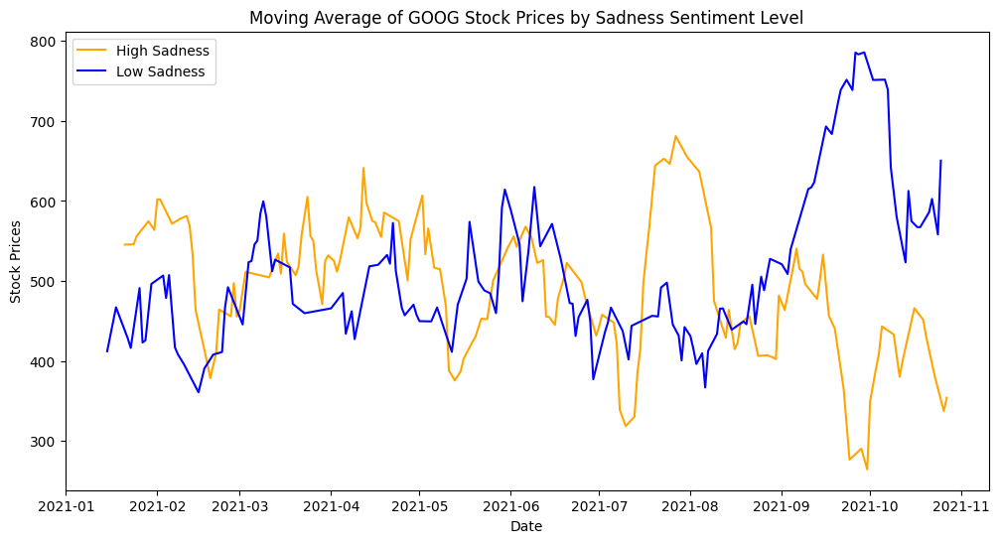

<ipython-input-52-b3b963e78303>:42: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=mean_prices, x=f'{sentiment_column}_level', y=price_column, palette='viridis')


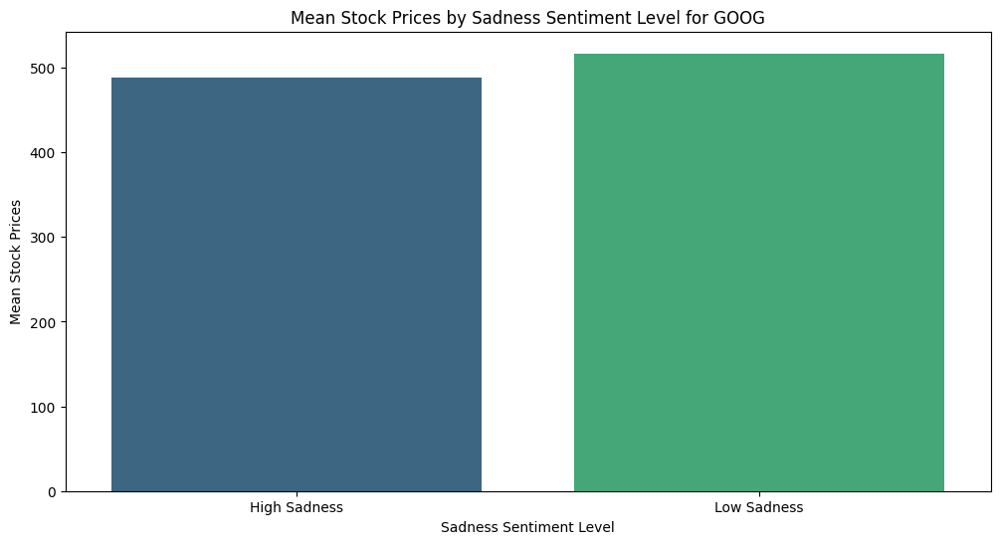


Analyzing sadness sentiment for AMZN
T-test for sadness sentiment in AMZN:
t-statistic: -0.17677925839382436, p-value: 0.8598018661892466


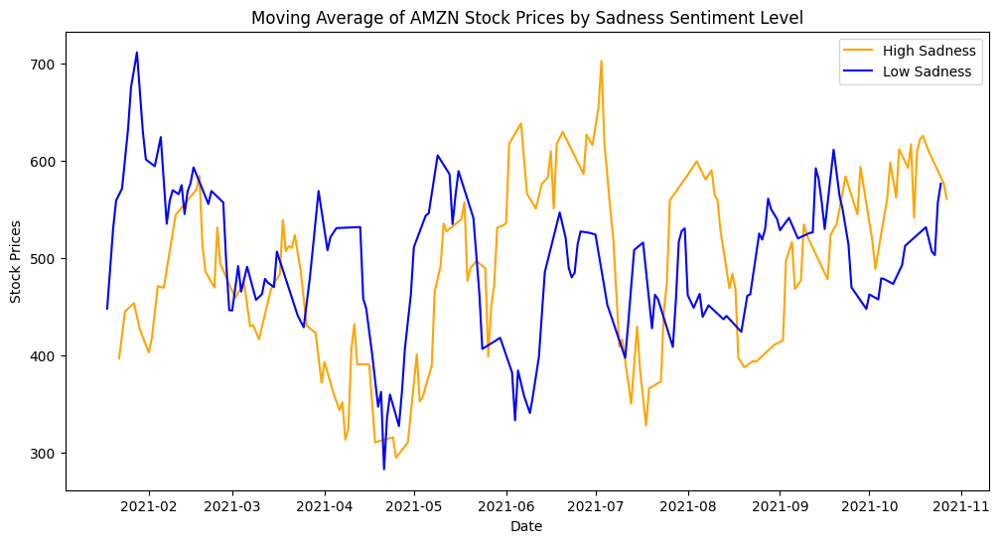

<ipython-input-52-b3b963e78303>:42: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=mean_prices, x=f'{sentiment_column}_level', y=price_column, palette='viridis')


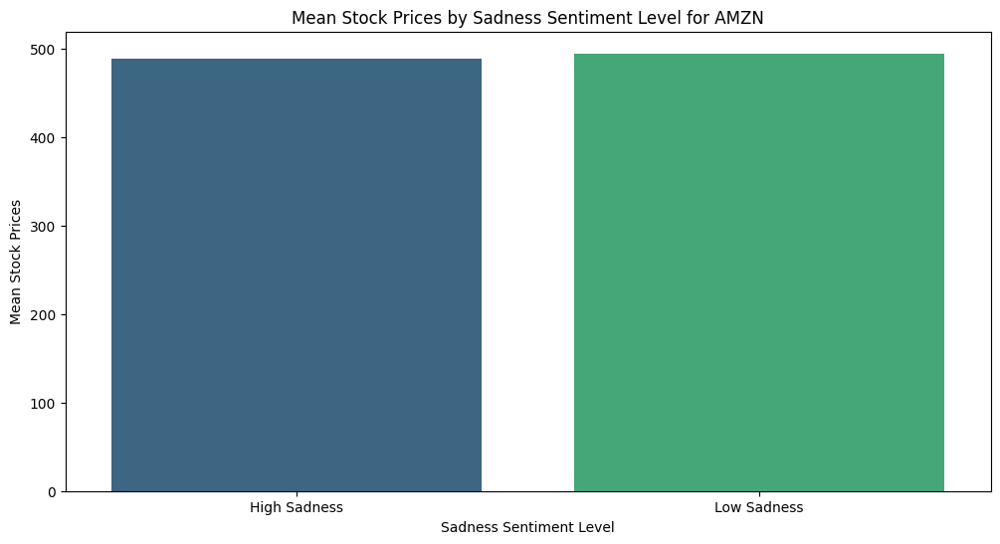


Analyzing sadness sentiment for AAPL
T-test for sadness sentiment in AAPL:
t-statistic: 1.6438996527071688, p-value: 0.10125147161087604


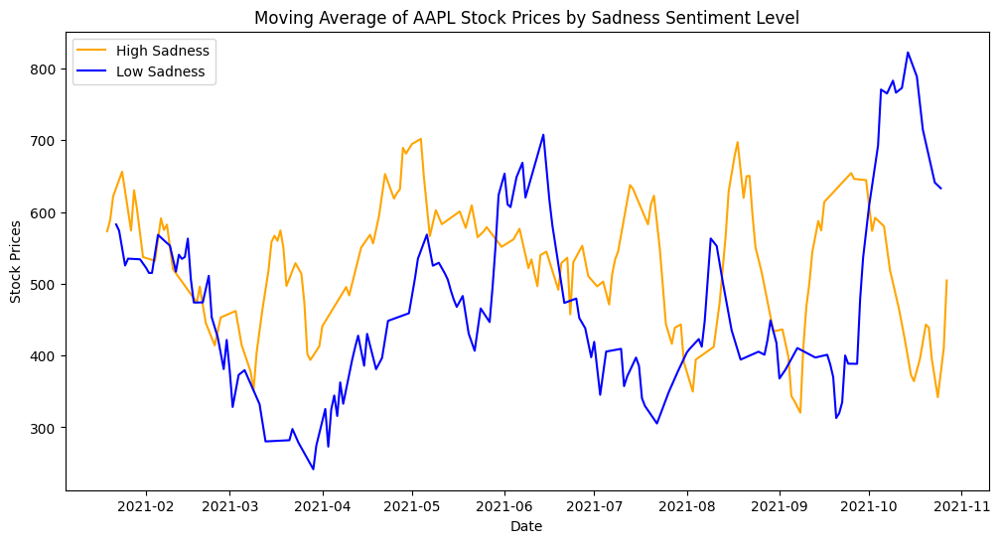

<ipython-input-52-b3b963e78303>:42: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=mean_prices, x=f'{sentiment_column}_level', y=price_column, palette='viridis')


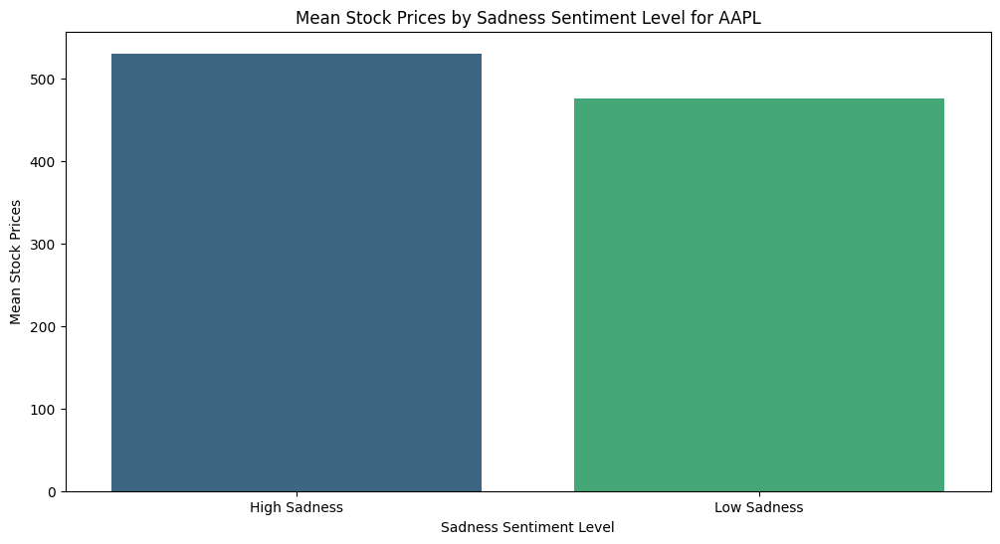


Analyzing sadness sentiment for TSLA
T-test for sadness sentiment in TSLA:
t-statistic: 0.03085232074076506, p-value: 0.9754079669550373


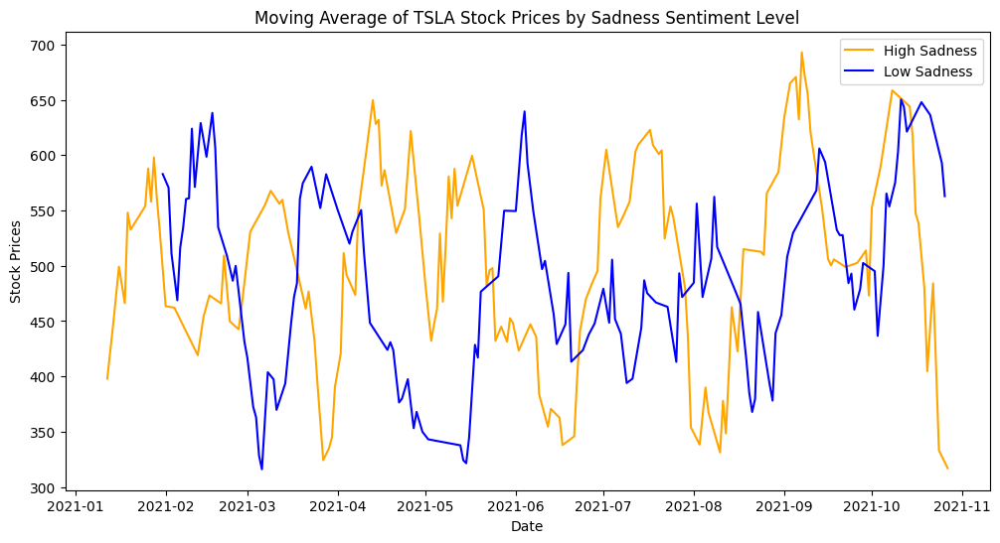

<ipython-input-52-b3b963e78303>:42: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=mean_prices, x=f'{sentiment_column}_level', y=price_column, palette='viridis')


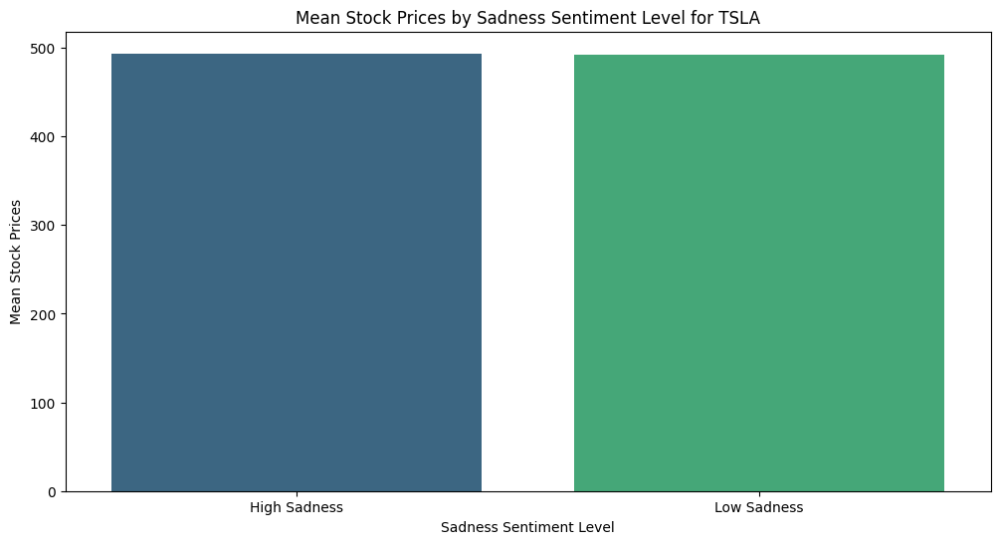


Analyzing sadness sentiment for VZ
T-test for sadness sentiment in VZ:
t-statistic: -0.04314401185901311, p-value: 0.9656156293470672


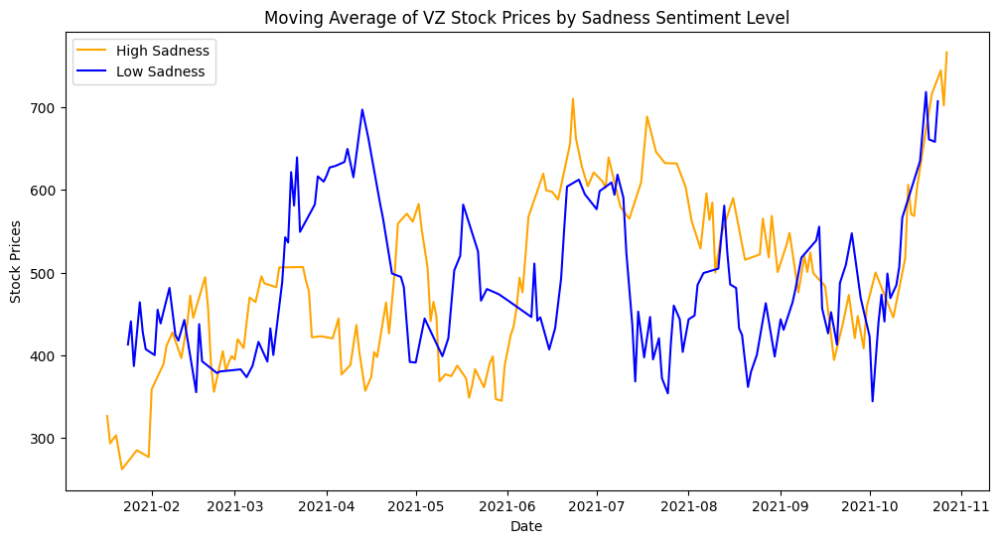

<ipython-input-52-b3b963e78303>:42: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=mean_prices, x=f'{sentiment_column}_level', y=price_column, palette='viridis')


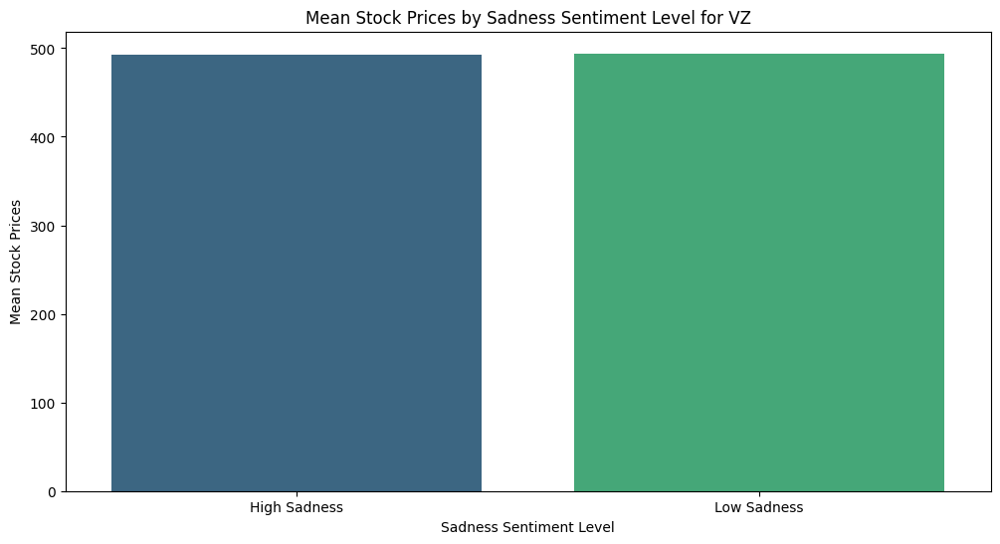


Analyzing sadness sentiment for KO
T-test for sadness sentiment in KO:
t-statistic: -0.49459056515366157, p-value: 0.6212535839564055


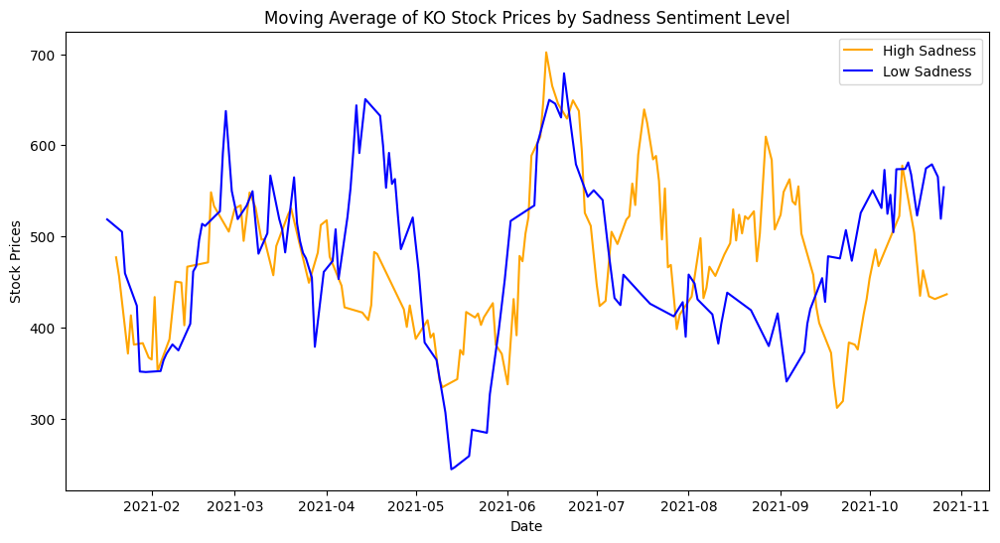

<ipython-input-52-b3b963e78303>:42: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=mean_prices, x=f'{sentiment_column}_level', y=price_column, palette='viridis')


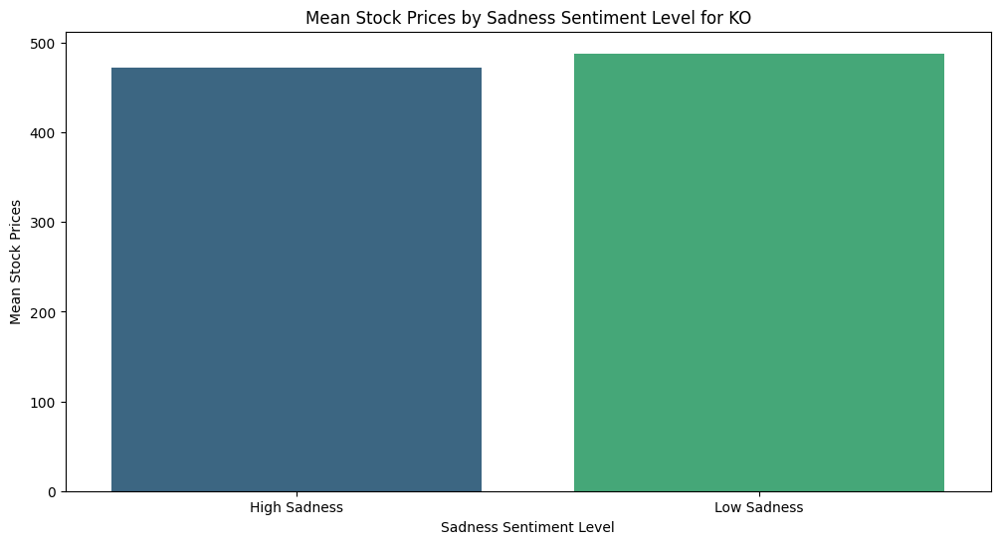


T-test results for sadness sentiment analysis:
  Company    t_stat     p_val
0    GOOG -0.845097  0.398735
1    AMZN -0.176779  0.859802
2    AAPL  1.643900  0.101251
3    TSLA  0.030852  0.975408
4      VZ -0.043144  0.965616
5      KO -0.494591  0.621254


<ipython-input-52-b3b963e78303>:67: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=t_test_df, x='Company', y='t_stat', palette='coolwarm')


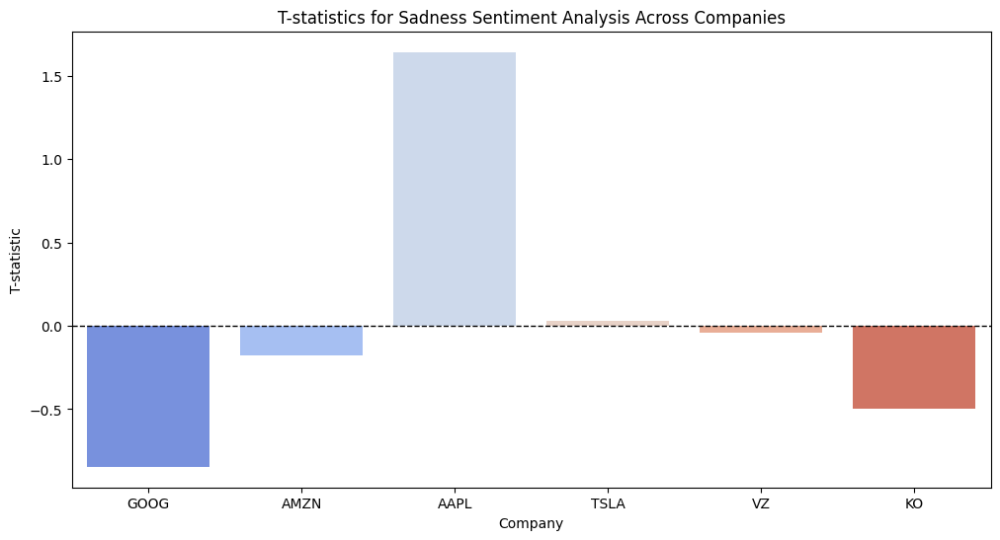

<ipython-input-52-b3b963e78303>:75: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=t_test_df, x='Company', y='p_val', palette='coolwarm')


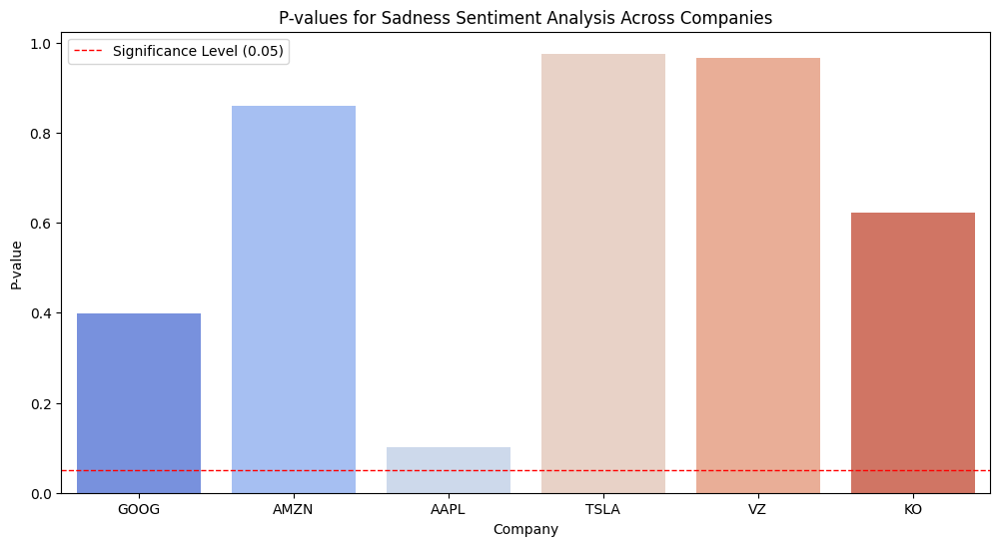

In [ ]:
# Function to perform t-test and visualize results
def analyze_sentiment_impact(df, ticker, sentiment_column='sadness', price_column='Close'):
    if df is None:
        print(f"Data preparation failed for {ticker}, skipping analysis.")
        return None, None

    if sentiment_column not in df.columns:
        print(f"Data for {ticker} does not contain '{sentiment_column}' column, skipping analysis.")
        return None, None

    df = df.dropna(subset=[sentiment_column, price_column])

    if len(df) == 0:
        print(f"{ticker}: No data available after dropping NaNs, skipping analysis.")
        return None, None

    high_sentiment = df[df[sentiment_column] > df[sentiment_column].mean()][price_column]
    low_sentiment = df[df[sentiment_column] <= df[sentiment_column].mean()][price_column]

    if len(high_sentiment) > 1 and len(low_sentiment) > 1:
        t_stat, p_val = ttest_ind(high_sentiment, low_sentiment, nan_policy='omit')
    else:
        t_stat, p_val = np.nan, np.nan
    print(f"T-test for {sentiment_column} sentiment in {ticker}:")
    print(f"t-statistic: {t_stat}, p-value: {p_val}")
    if pd.notna(t_stat) and pd.notna(p_val):
        df[f'{sentiment_column}_level'] = np.where(df[sentiment_column] > df[sentiment_column].mean(), f'High {sentiment_column.capitalize()}', f'Low {sentiment_column.capitalize()}')
        df['MA_High'] = df[df[f'{sentiment_column}_level'] == f'High {sentiment_column.capitalize()}'][price_column].rolling(window=10).mean()
        df['MA_Low'] = df[df[f'{sentiment_column}_level'] == f'Low {sentiment_column.capitalize()}'][price_column].rolling(window=10).mean()

        plt.figure(figsize=(12, 6))
        sns.lineplot(data=df, x='Date', y='MA_High', label=f'High {sentiment_column.capitalize()}', color='orange')
        sns.lineplot(data=df, x='Date', y='MA_Low', label=f'Low {sentiment_column.capitalize()}', color='blue')
        plt.title(f'Moving Average of {ticker} Stock Prices by {sentiment_column.capitalize()} Sentiment Level')
        plt.xlabel('Date')
        plt.ylabel('Stock Prices')
        plt.legend()
        plt.show()

        mean_prices = df.groupby(f'{sentiment_column}_level')[price_column].mean().reset_index()
        plt.figure(figsize=(12, 6))
        sns.barplot(data=mean_prices, x=f'{sentiment_column}_level', y=price_column, palette='viridis')
        plt.title(f'Mean Stock Prices by {sentiment_column.capitalize()} Sentiment Level for {ticker}')
        plt.xlabel(f'{sentiment_column.capitalize()} Sentiment Level')
        plt.ylabel('Mean Stock Prices')
        plt.show()

    return t_stat, p_val

# Define the list of companies (already defined)
companies = ['GOOG', 'AMZN', 'AAPL', 'TSLA', 'VZ', 'KO']
t_test_results = []
for ticker in companies:
    print(f"\nAnalyzing sadness sentiment for {ticker}")
    merged_data = prepare_merged_data(stock_df, sentiment_df, ticker)
    t_stat, p_val = analyze_sentiment_impact(merged_data, ticker)
    if t_stat is not None and p_val is not None:
        t_test_results.append({'Company': ticker, 't_stat': t_stat, 'p_val': p_val})
t_test_df = pd.DataFrame(t_test_results)

# Display t-test results
print("\nT-test results for sadness sentiment analysis:")
print(t_test_df)

# Plot the t-test results
plt.figure(figsize=(12, 6))
sns.barplot(data=t_test_df, x='Company', y='t_stat', palette='coolwarm')
plt.axhline(0, color='black', linewidth=1, linestyle='--')
plt.title('T-statistics for Sadness Sentiment Analysis Across Companies')
plt.xlabel('Company')
plt.ylabel('T-statistic')
plt.show()

plt.figure(figsize=(12, 6))
sns.barplot(data=t_test_df, x='Company', y='p_val', palette='coolwarm')
plt.axhline(0.05, color='red', linewidth=1, linestyle='--', label='Significance Level (0.05)')
plt.title('P-values for Sadness Sentiment Analysis Across Companies')
plt.xlabel('Company')
plt.ylabel('P-value')
plt.legend()
plt.show()


 Analysis of Anger Sentiment Impact on Stock Prices with T-Tests


T-test results for anger sentiment analysis:
  Company    t_stat     p_val
0    GOOG -0.845097  0.398735
1    AMZN -0.176779  0.859802
2    AAPL  1.643900  0.101251
3    TSLA  0.030852  0.975408
4      VZ -0.043144  0.965616
5      KO -0.494591  0.621254


<ipython-input-53-633e7bb0aea9>:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=t_test_df, x='Company', y='t_stat', palette='coolwarm')


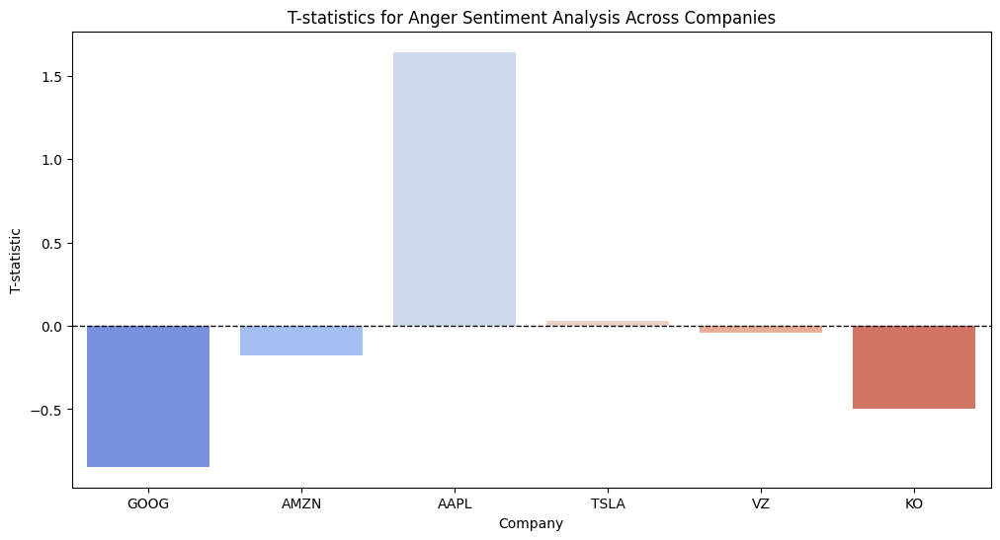

<ipython-input-53-633e7bb0aea9>:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=t_test_df, x='Company', y='p_val', palette='coolwarm')


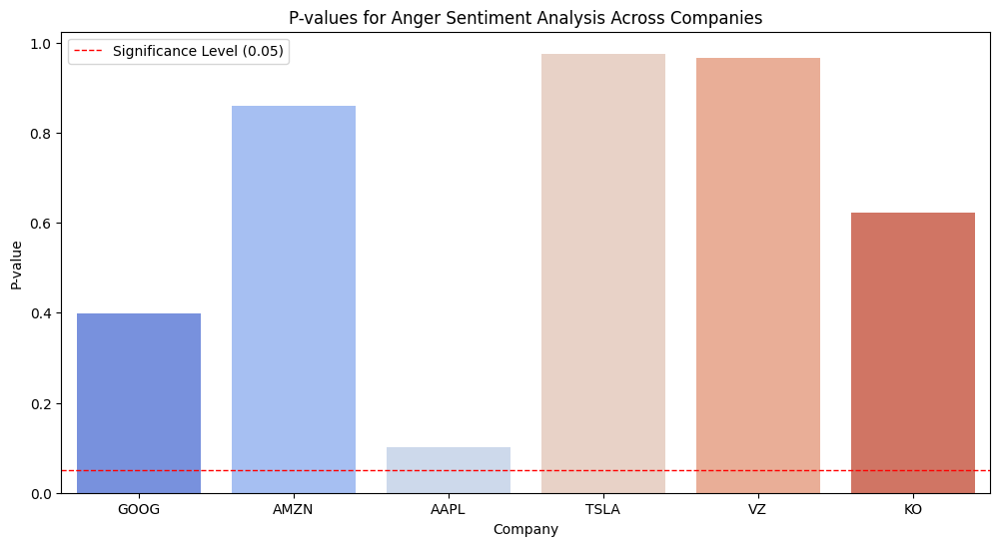

In [ ]:
# Display t-test results
print("\nT-test results for anger sentiment analysis:")
print(t_test_df)

# Plot the t-test results
plt.figure(figsize=(12, 6))
sns.barplot(data=t_test_df, x='Company', y='t_stat', palette='coolwarm')
plt.axhline(0, color='black', linewidth=1, linestyle='--')
plt.title('T-statistics for Anger Sentiment Analysis Across Companies')
plt.xlabel('Company')
plt.ylabel('T-statistic')
plt.show()

plt.figure(figsize=(12, 6))
sns.barplot(data=t_test_df, x='Company', y='p_val', palette='coolwarm')
plt.axhline(0.05, color='red', linewidth=1, linestyle='--', label='Significance Level (0.05)')
plt.title('P-values for Anger Sentiment Analysis Across Companies')
plt.xlabel('Company')
plt.ylabel('P-value')
plt.legend()
plt.show()


 Analysis of Surprise Sentiment Impact on Stock Prices with T-Tests


T-test results for surprise sentiment analysis:
  Company    t_stat     p_val
0    GOOG -0.845097  0.398735
1    AMZN -0.176779  0.859802
2    AAPL  1.643900  0.101251
3    TSLA  0.030852  0.975408
4      VZ -0.043144  0.965616
5      KO -0.494591  0.621254


<ipython-input-54-fb624d93df12>:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=t_test_df, x='Company', y='t_stat', palette='coolwarm')


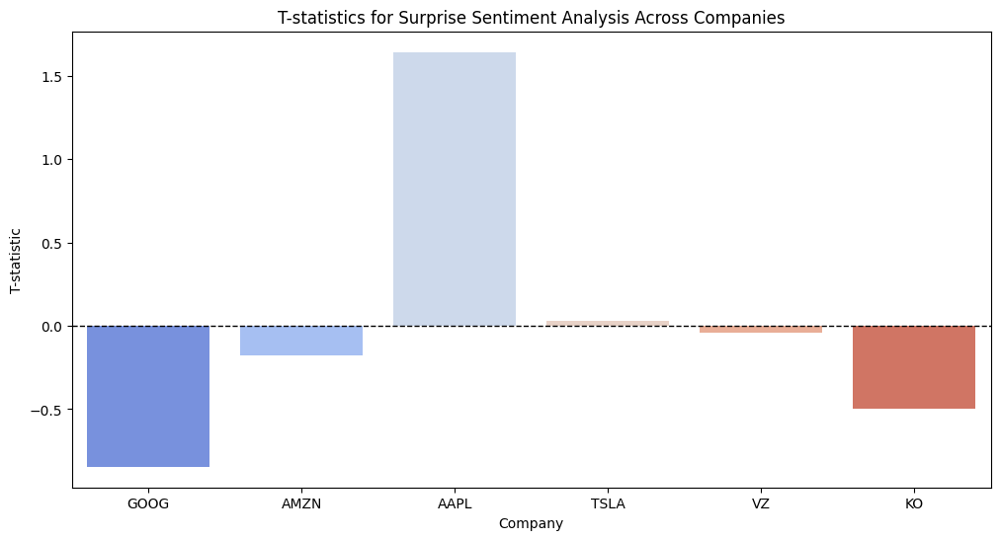

<ipython-input-54-fb624d93df12>:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=t_test_df, x='Company', y='p_val', palette='coolwarm')


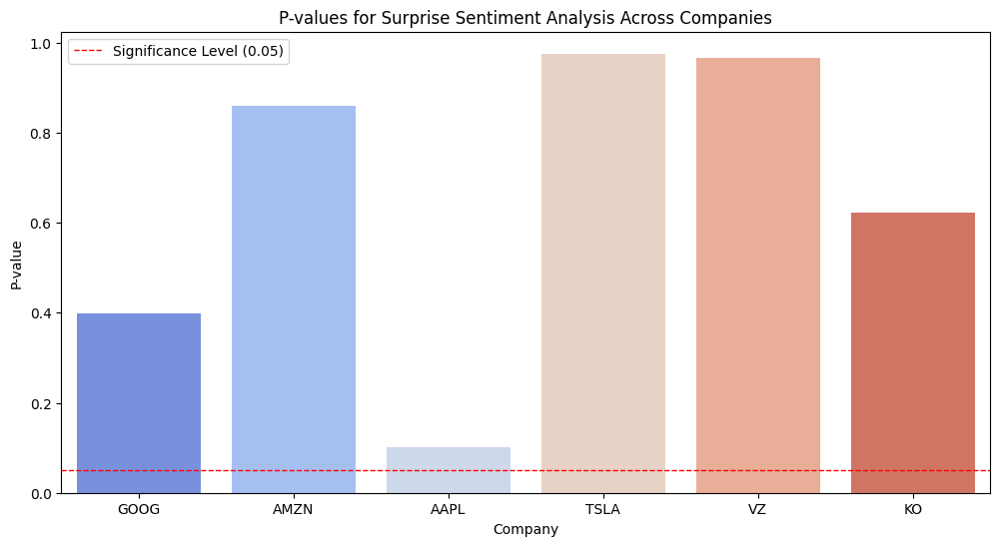

In [ ]:
# Display t-test results
print("\nT-test results for surprise sentiment analysis:")
print(t_test_df)

# Plot the t-test results
plt.figure(figsize=(12, 6))
sns.barplot(data=t_test_df, x='Company', y='t_stat', palette='coolwarm')
plt.axhline(0, color='black', linewidth=1, linestyle='--')
plt.title('T-statistics for Surprise Sentiment Analysis Across Companies')
plt.xlabel('Company')
plt.ylabel('T-statistic')
plt.show()

plt.figure(figsize=(12, 6))
sns.barplot(data=t_test_df, x='Company', y='p_val', palette='coolwarm')
plt.axhline(0.05, color='red', linewidth=1, linestyle='--', label='Significance Level (0.05)')
plt.title('P-values for Surprise Sentiment Analysis Across Companies')
plt.xlabel('Company')
plt.ylabel('P-value')
plt.legend()
plt.show()


 Analysis of Confusion Sentiment Impact on Stock Prices with T-Tests


Analyzing confusion sentiment for GOOG
GOOG: Number of rows after dropping NaNs: 300
GOOG: High confusion group size: 147
GOOG: Low confusion group size: 153
T-test for confusion sentiment in GOOG:
t-statistic: 2.2965327156590742, p-value: 0.022339034173456757


<ipython-input-55-17ce1956c46f>:37: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=mean_prices, x='confusion_level', y=price_column, palette='viridis')


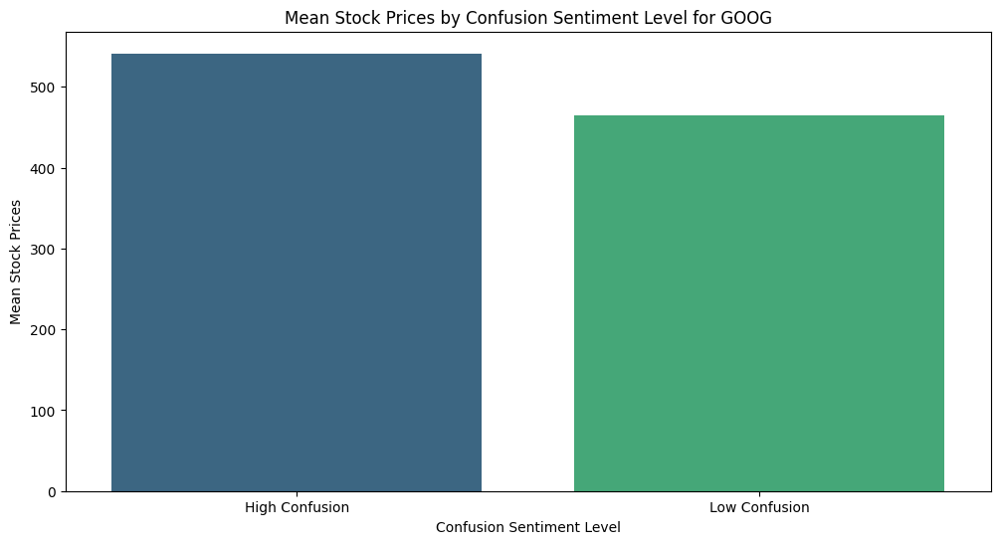

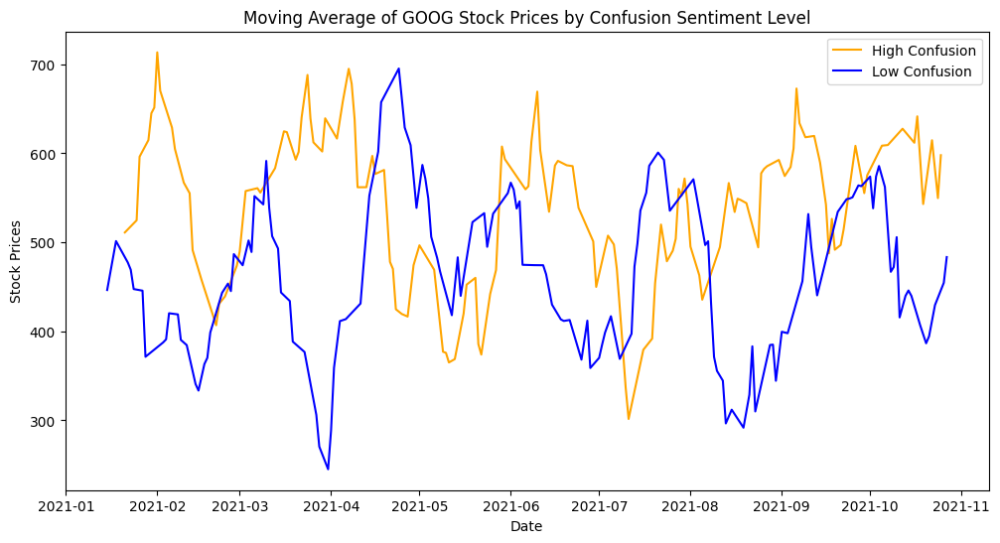


Analyzing confusion sentiment for AMZN
AMZN: Number of rows after dropping NaNs: 300
AMZN: High confusion group size: 156
AMZN: Low confusion group size: 144
T-test for confusion sentiment in AMZN:
t-statistic: -0.8023531088156983, p-value: 0.4229881250667046


<ipython-input-55-17ce1956c46f>:37: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=mean_prices, x='confusion_level', y=price_column, palette='viridis')


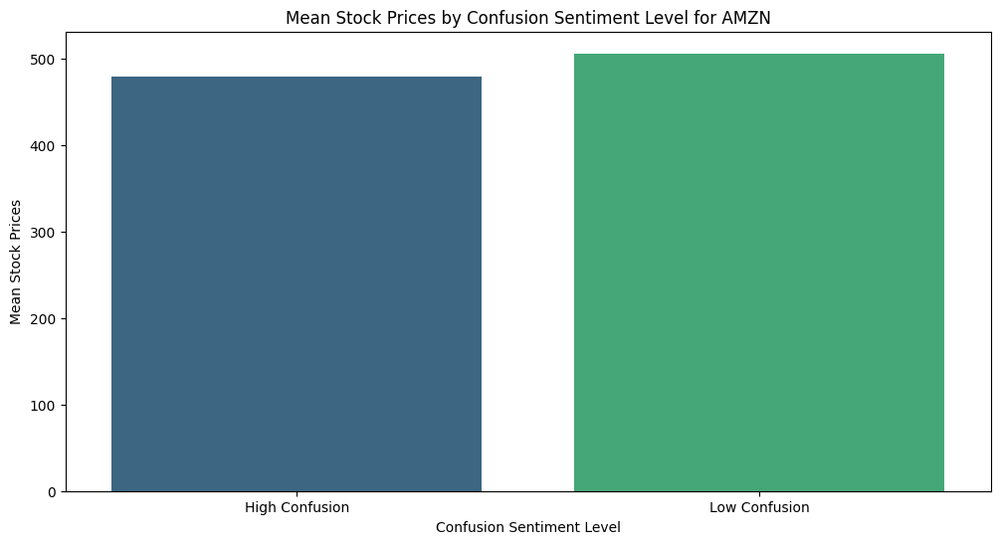

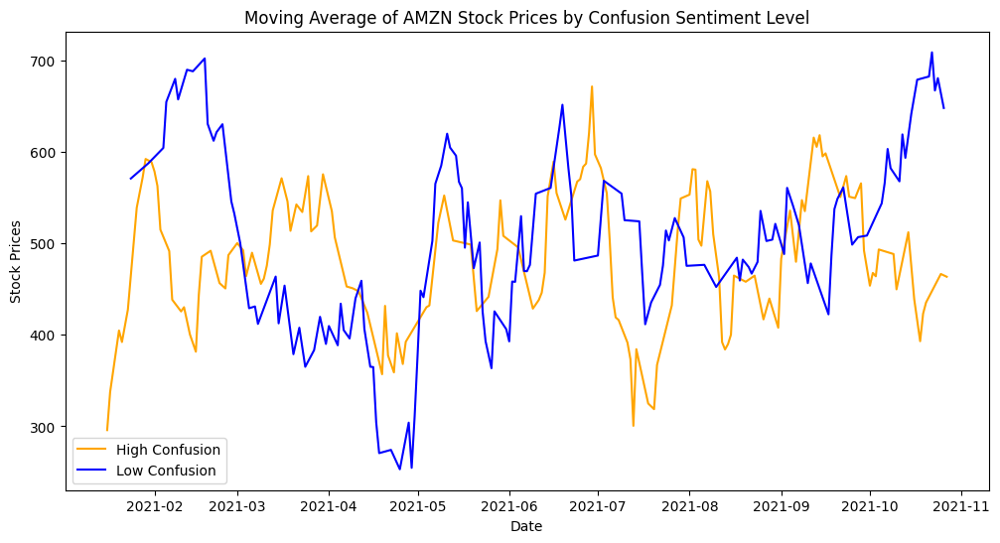


Analyzing confusion sentiment for AAPL
AAPL: Number of rows after dropping NaNs: 300
AAPL: High confusion group size: 148
AAPL: Low confusion group size: 152
T-test for confusion sentiment in AAPL:
t-statistic: 1.5855510530864083, p-value: 0.11390173147816729


<ipython-input-55-17ce1956c46f>:37: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=mean_prices, x='confusion_level', y=price_column, palette='viridis')


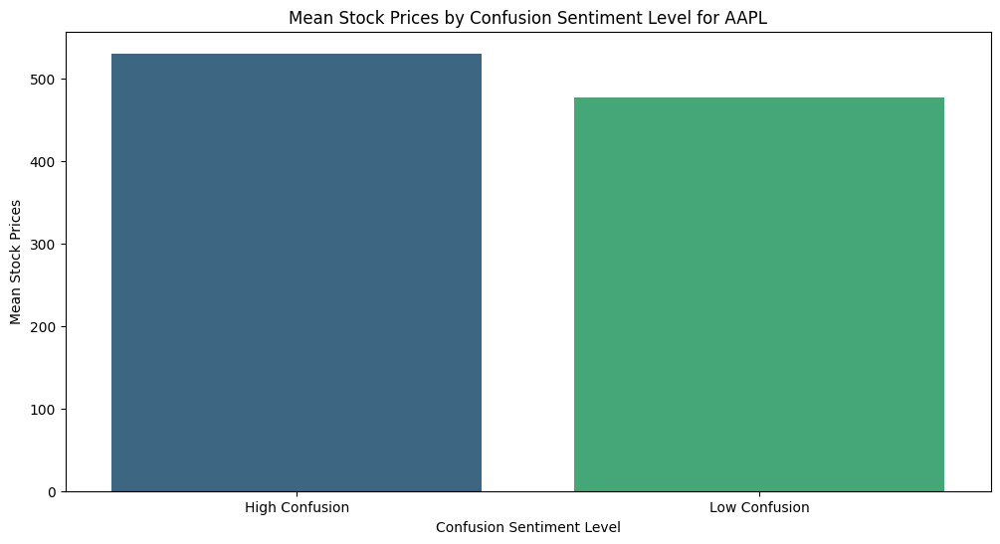

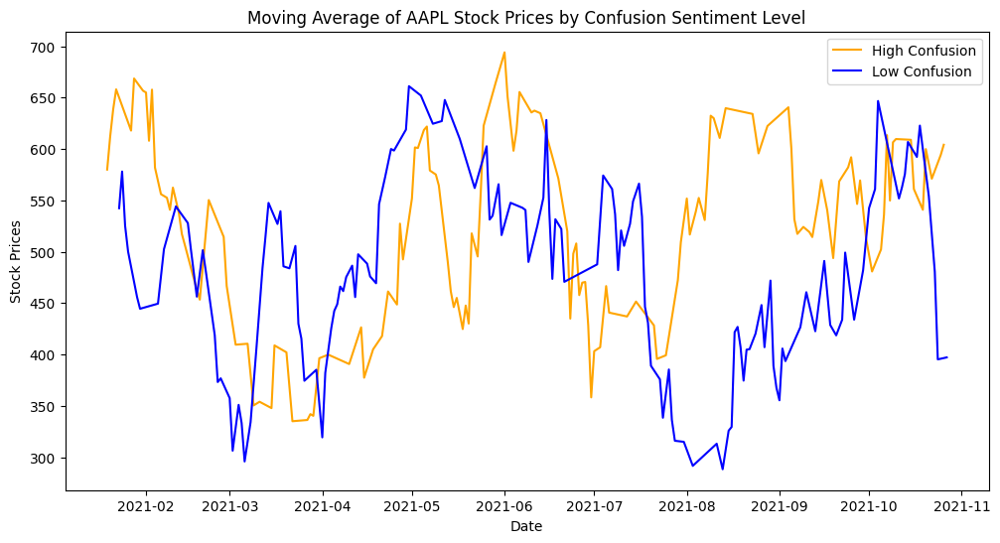


Analyzing confusion sentiment for TSLA
TSLA: Number of rows after dropping NaNs: 300
TSLA: High confusion group size: 155
TSLA: Low confusion group size: 145
T-test for confusion sentiment in TSLA:
t-statistic: 1.0064846198617725, p-value: 0.314999047969631


<ipython-input-55-17ce1956c46f>:37: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=mean_prices, x='confusion_level', y=price_column, palette='viridis')


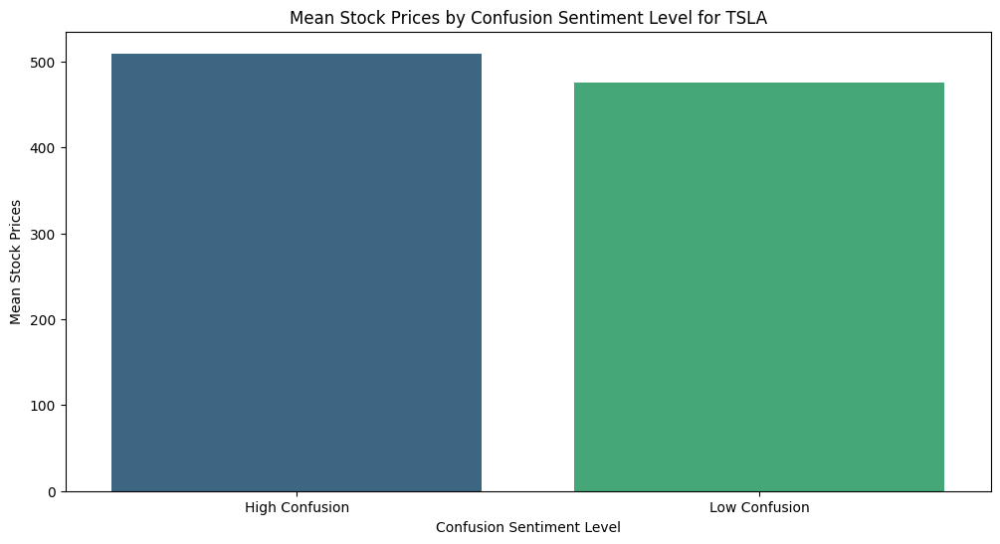

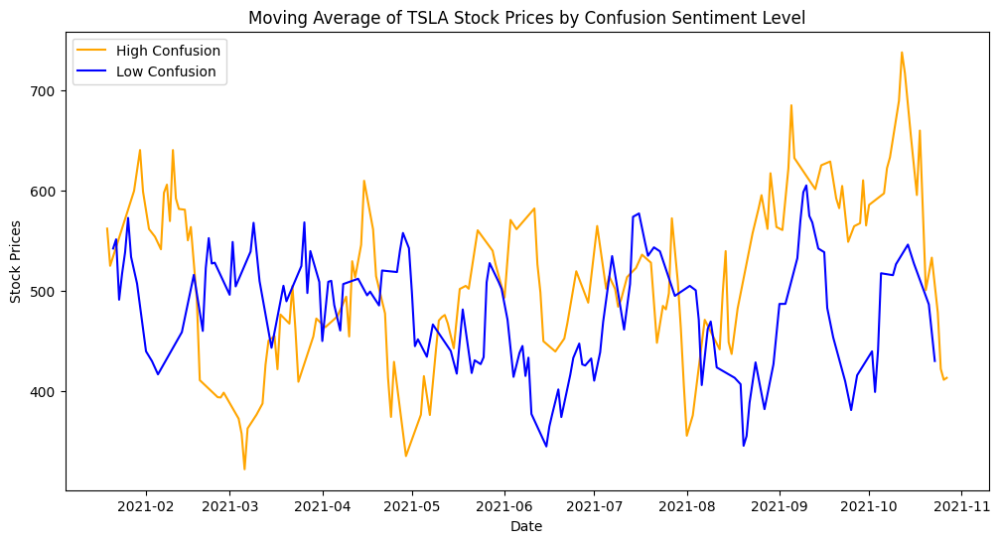


Analyzing confusion sentiment for VZ
VZ: Number of rows after dropping NaNs: 300
VZ: High confusion group size: 148
VZ: Low confusion group size: 152
T-test for confusion sentiment in VZ:
t-statistic: -0.5825987410646523, p-value: 0.5606040093143125


<ipython-input-55-17ce1956c46f>:37: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=mean_prices, x='confusion_level', y=price_column, palette='viridis')


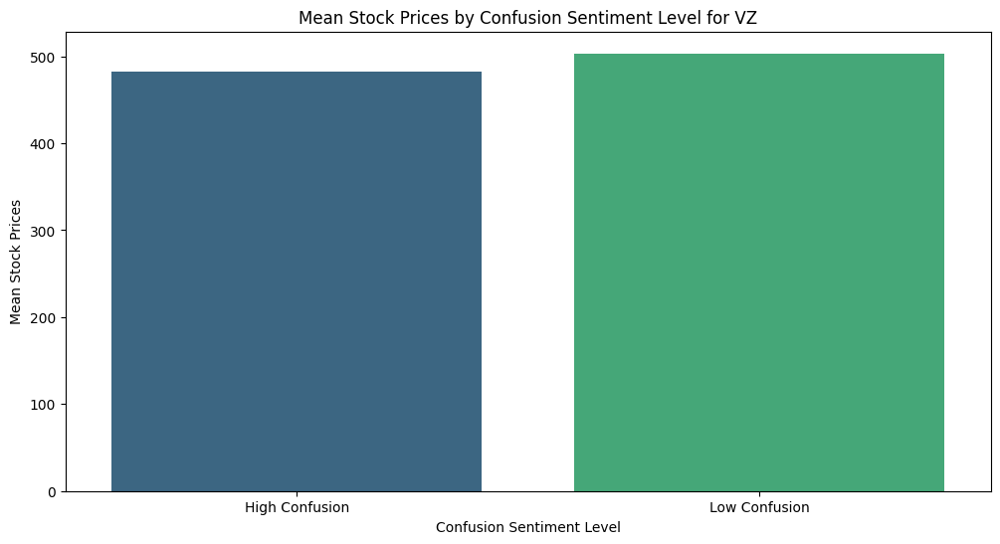

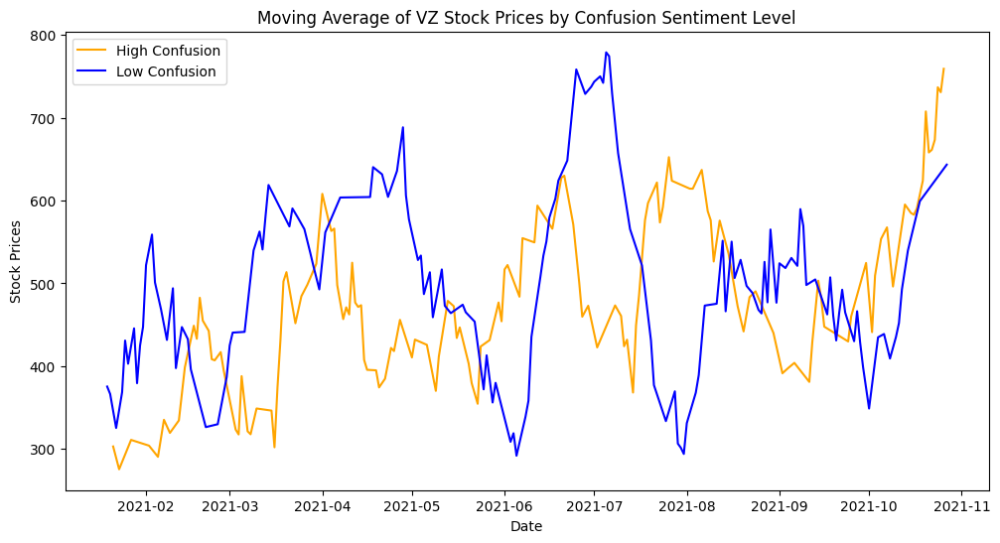


Analyzing confusion sentiment for KO
KO: Number of rows after dropping NaNs: 300
KO: High confusion group size: 148
KO: Low confusion group size: 152
T-test for confusion sentiment in KO:
t-statistic: -0.39991131473371655, p-value: 0.6895083367444876


<ipython-input-55-17ce1956c46f>:37: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=mean_prices, x='confusion_level', y=price_column, palette='viridis')


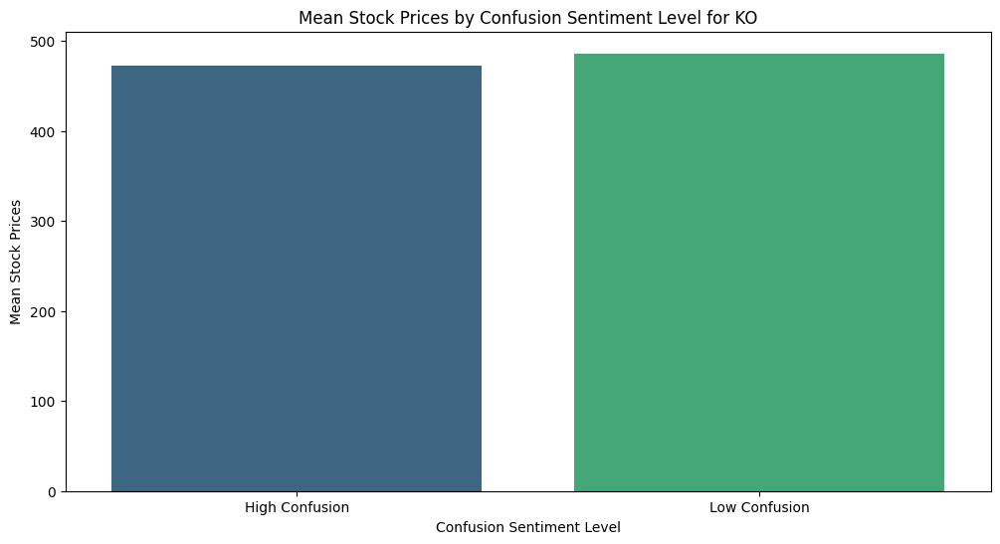

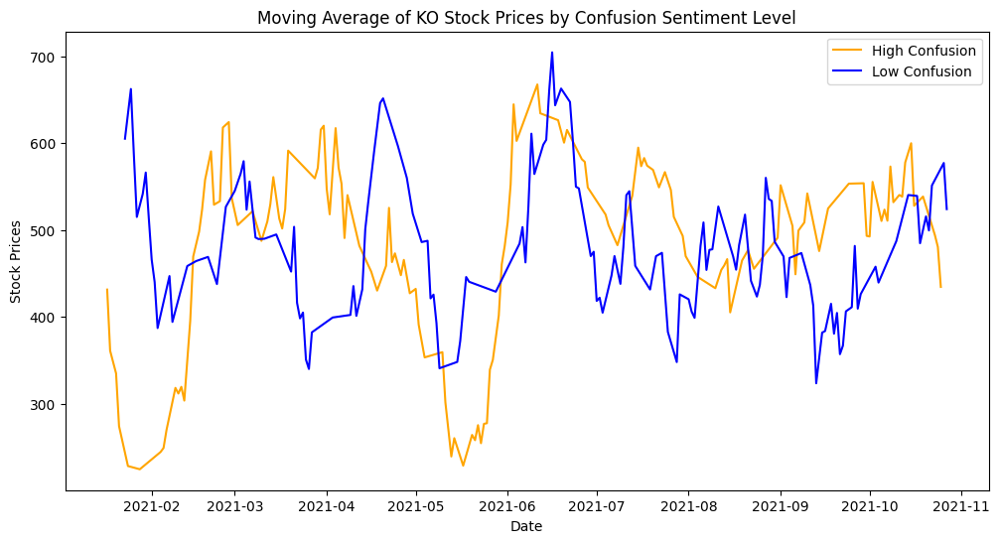


Analyzing confusion sentiment for GOOG
GOOG: Number of rows after dropping NaNs: 300
GOOG: High confusion group size: 147
GOOG: Low confusion group size: 153
T-test for confusion sentiment in GOOG:
t-statistic: 2.2965327156590742, p-value: 0.022339034173456757


<ipython-input-55-17ce1956c46f>:37: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=mean_prices, x='confusion_level', y=price_column, palette='viridis')


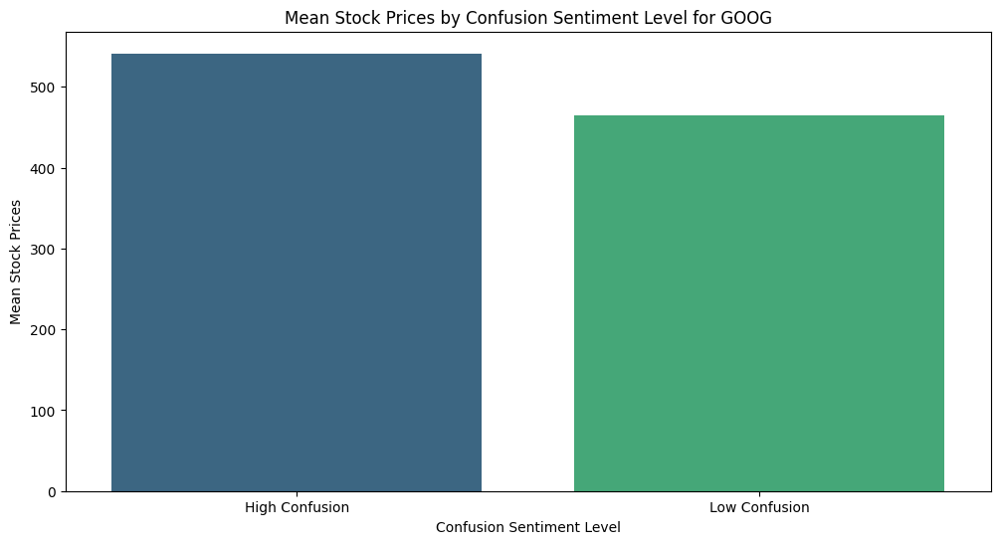

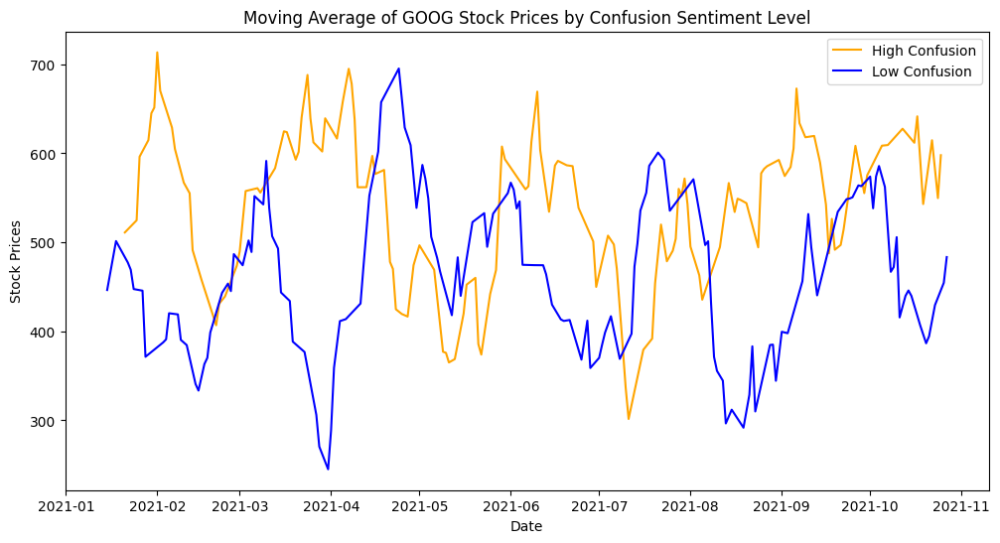


Analyzing confusion sentiment for AMZN
AMZN: Number of rows after dropping NaNs: 300
AMZN: High confusion group size: 156
AMZN: Low confusion group size: 144
T-test for confusion sentiment in AMZN:
t-statistic: -0.8023531088156983, p-value: 0.4229881250667046


<ipython-input-55-17ce1956c46f>:37: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=mean_prices, x='confusion_level', y=price_column, palette='viridis')


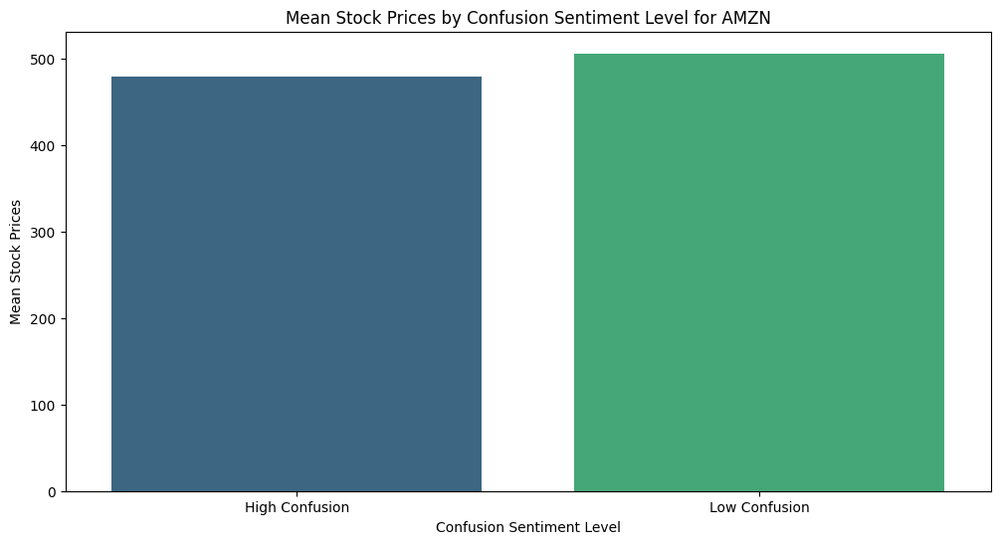

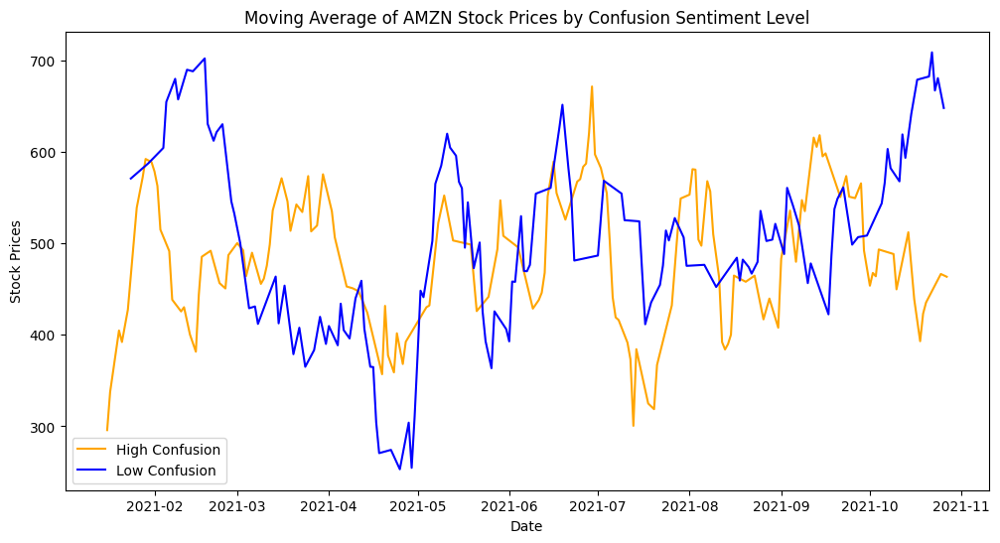


Analyzing confusion sentiment for AAPL
AAPL: Number of rows after dropping NaNs: 300
AAPL: High confusion group size: 148
AAPL: Low confusion group size: 152
T-test for confusion sentiment in AAPL:
t-statistic: 1.5855510530864083, p-value: 0.11390173147816729


<ipython-input-55-17ce1956c46f>:37: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=mean_prices, x='confusion_level', y=price_column, palette='viridis')


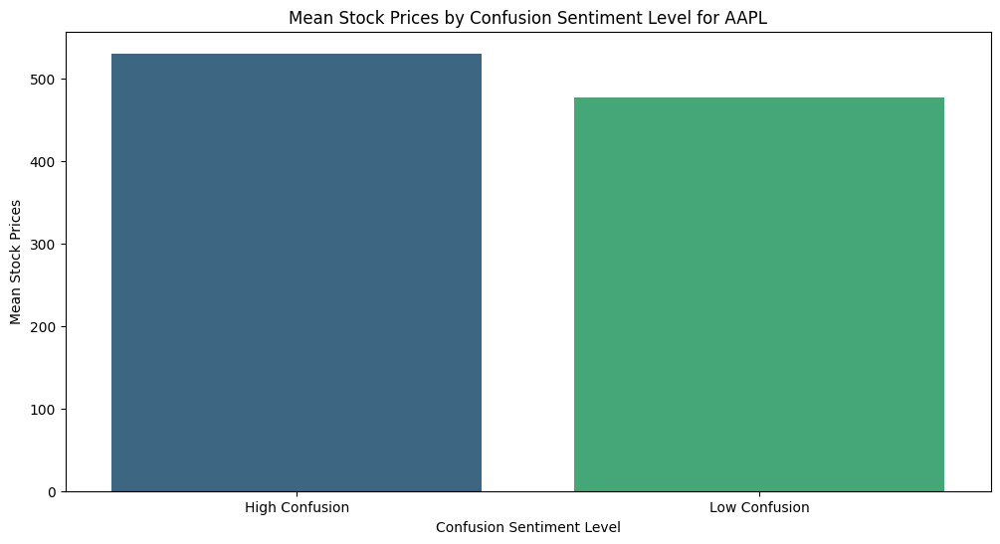

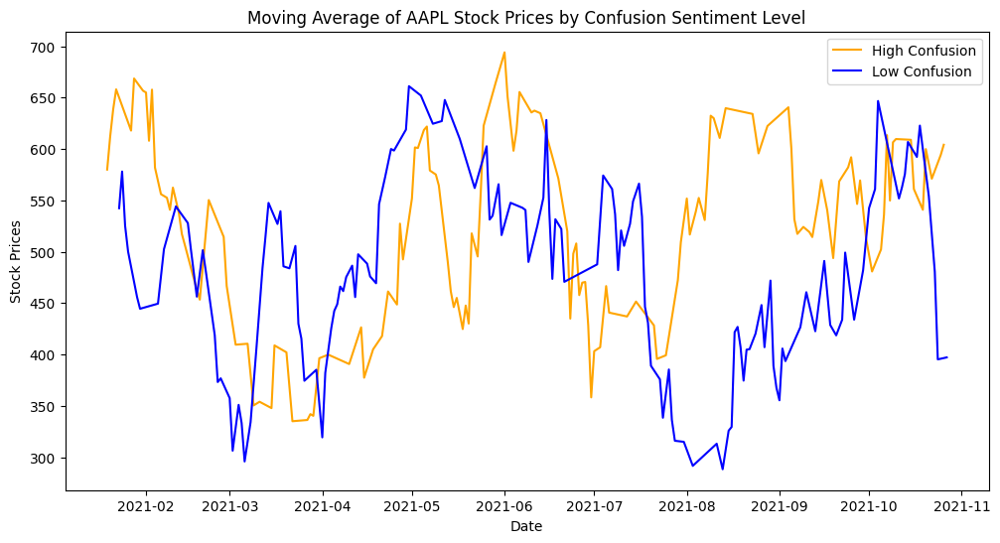


Analyzing confusion sentiment for TSLA
TSLA: Number of rows after dropping NaNs: 300
TSLA: High confusion group size: 155
TSLA: Low confusion group size: 145
T-test for confusion sentiment in TSLA:
t-statistic: 1.0064846198617725, p-value: 0.314999047969631


<ipython-input-55-17ce1956c46f>:37: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=mean_prices, x='confusion_level', y=price_column, palette='viridis')


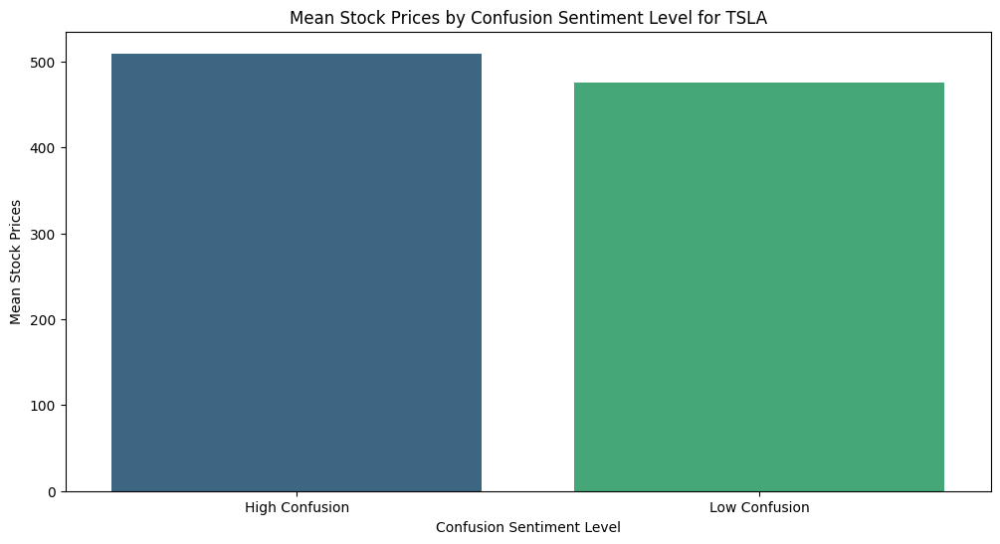

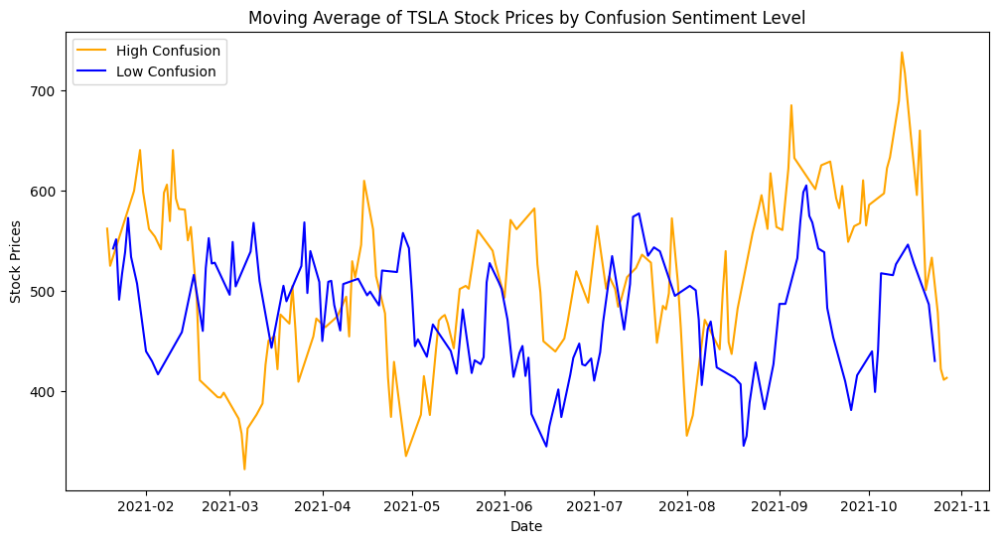


Analyzing confusion sentiment for VZ
VZ: Number of rows after dropping NaNs: 300
VZ: High confusion group size: 148
VZ: Low confusion group size: 152
T-test for confusion sentiment in VZ:
t-statistic: -0.5825987410646523, p-value: 0.5606040093143125


<ipython-input-55-17ce1956c46f>:37: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=mean_prices, x='confusion_level', y=price_column, palette='viridis')


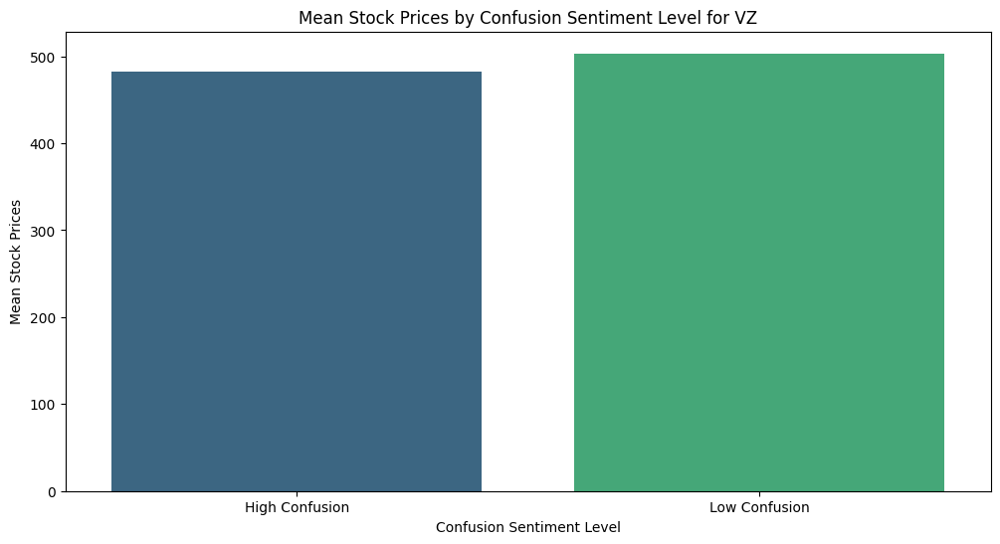

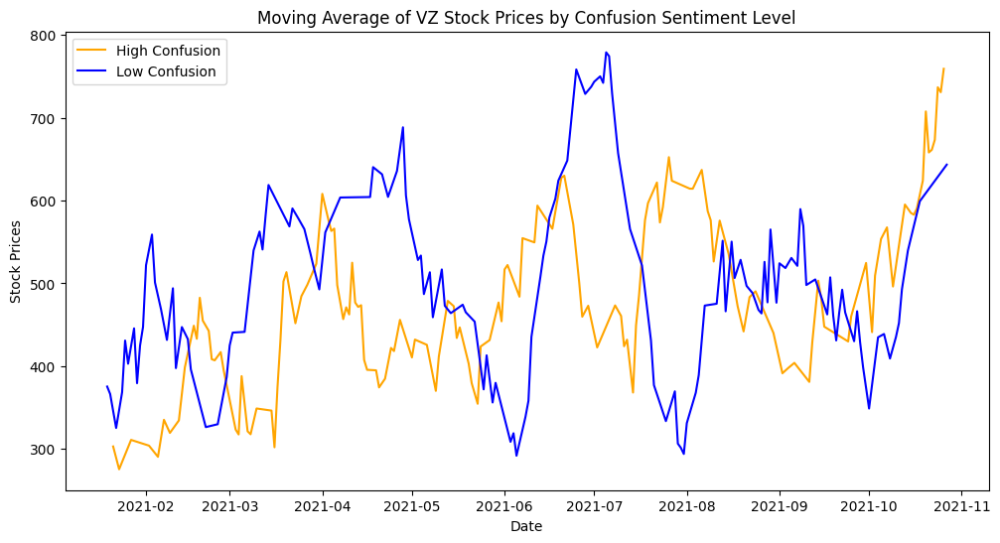


Analyzing confusion sentiment for KO
KO: Number of rows after dropping NaNs: 300
KO: High confusion group size: 148
KO: Low confusion group size: 152
T-test for confusion sentiment in KO:
t-statistic: -0.39991131473371655, p-value: 0.6895083367444876


<ipython-input-55-17ce1956c46f>:37: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=mean_prices, x='confusion_level', y=price_column, palette='viridis')


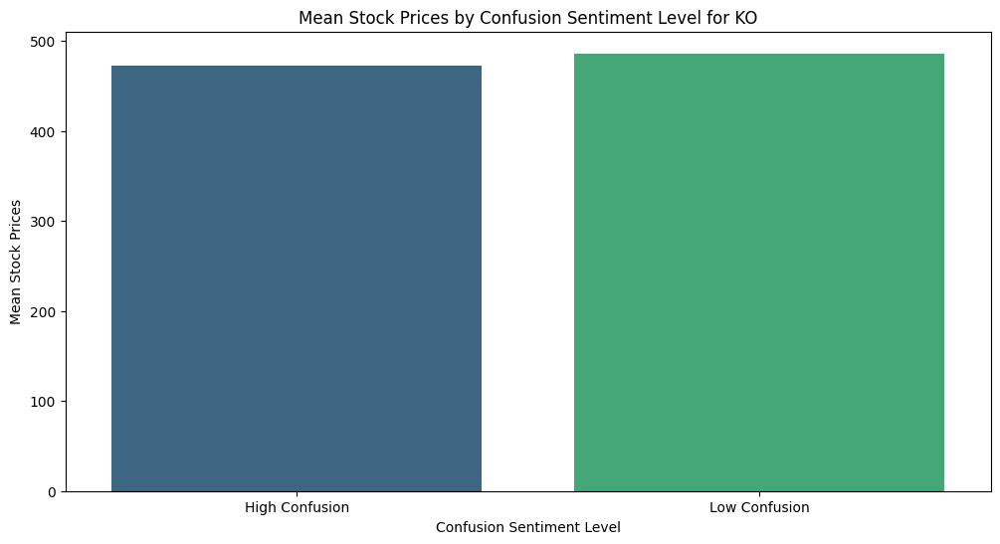

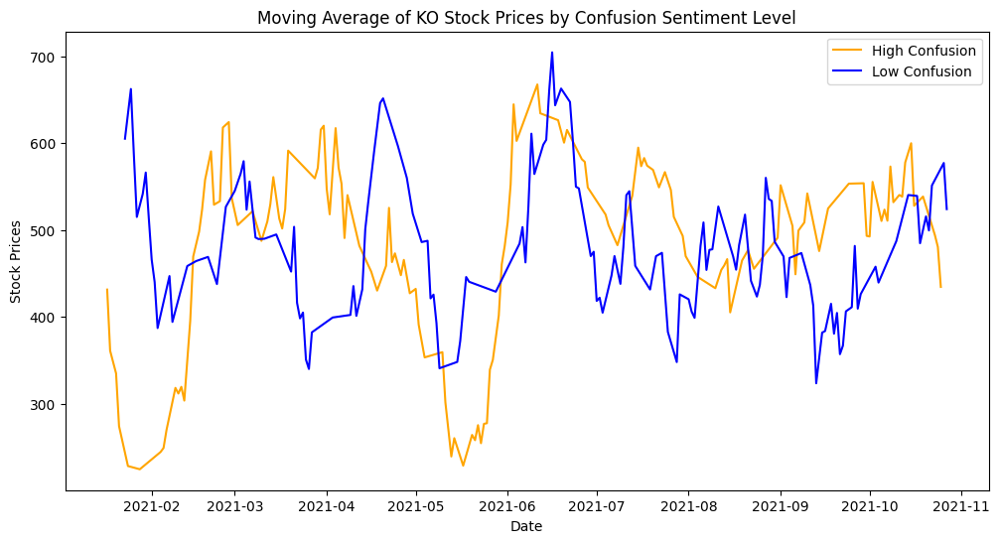

In [ ]:

def analyze_confusion_sentiment(df, ticker, price_column='Close'):
    if df is None:
        print(f"Data preparation failed for {ticker}, skipping analysis.")
        return

    if 'confusion' not in df.columns:
        print(f"Data for {ticker} does not contain 'confusion' column, skipping analysis.")
        return

    df = df.dropna(subset=['confusion', price_column])
    print(f"{ticker}: Number of rows after dropping NaNs: {len(df)}")
    if len(df) == 0:
        print(f"{ticker}: No data available after dropping NaNs, skipping analysis.")
        return

    high_confusion = df[df['confusion'] > df['confusion'].mean()][price_column]
    low_confusion = df[df['confusion'] <= df['confusion'].mean()][price_column]
    print(f"{ticker}: High confusion group size: {len(high_confusion)}")
    print(f"{ticker}: Low confusion group size: {len(low_confusion)}")

    if len(high_confusion) > 1 and len(low_confusion) > 1:
        t_stat, p_val = ttest_ind(high_confusion, low_confusion, nan_policy='omit')
    else:
        t_stat, p_val = np.nan, np.nan

    # Print t-test results
    print(f"T-test for confusion sentiment in {ticker}:")
    print(f"t-statistic: {t_stat}, p-value: {p_val}")

    if pd.notna(t_stat) and pd.notna(p_val):
        # Create a new column to indicate sentiment level
        df['confusion_level'] = np.where(df['confusion'] > df['confusion'].mean(), 'High Confusion', 'Low Confusion')

        # Bar plot for mean stock prices
        mean_prices = df.groupby('confusion_level')[price_column].mean().reset_index()
        plt.figure(figsize=(12, 6))
        sns.barplot(data=mean_prices, x='confusion_level', y=price_column, palette='viridis')
        plt.title(f'Mean Stock Prices by Confusion Sentiment Level for {ticker}')
        plt.xlabel('Confusion Sentiment Level')
        plt.ylabel('Mean Stock Prices')
        plt.show()

        # Line plot with moving averages
        df['MA_High'] = df[df['confusion_level'] == 'High Confusion'][price_column].rolling(window=10).mean()
        df['MA_Low'] = df[df['confusion_level'] == 'Low Confusion'][price_column].rolling(window=10).mean()

        plt.figure(figsize=(12, 6))
        sns.lineplot(data=df, x='Date', y='MA_High', label='High Confusion', color='orange')
        sns.lineplot(data=df, x='Date', y='MA_Low', label='Low Confusion', color='blue')
        plt.title(f'Moving Average of {ticker} Stock Prices by Confusion Sentiment Level')
        plt.xlabel('Date')
        plt.ylabel('Stock Prices')
        plt.legend()
        plt.show()

    return t_stat, p_val

# Define the list of companies
companies = ['GOOG', 'AMZN', 'AAPL', 'TSLA', 'VZ', 'KO']
for ticker in companies:
    print(f"\nAnalyzing confusion sentiment for {ticker}")
    merged_data = prepare_merged_data(stock_df, sentiment_df, ticker)
    analyze_confusion_sentiment(merged_data, ticker)

# Perform t-test for each company and store the results
t_test_results = {}

for ticker in companies:
    print(f"\nAnalyzing confusion sentiment for {ticker}")
    merged_data = prepare_merged_data(stock_df, sentiment_df, ticker)
    t_stat, p_val = analyze_confusion_sentiment(merged_data, ticker)
    t_test_results[ticker] = t_stat

# Create a DataFrame for visualization
results_df = pd.DataFrame(list(t_test_results.items()), columns=['Company', 't-statistic'])




T-Test Results and Visualization for Larger vs. Smaller Companies

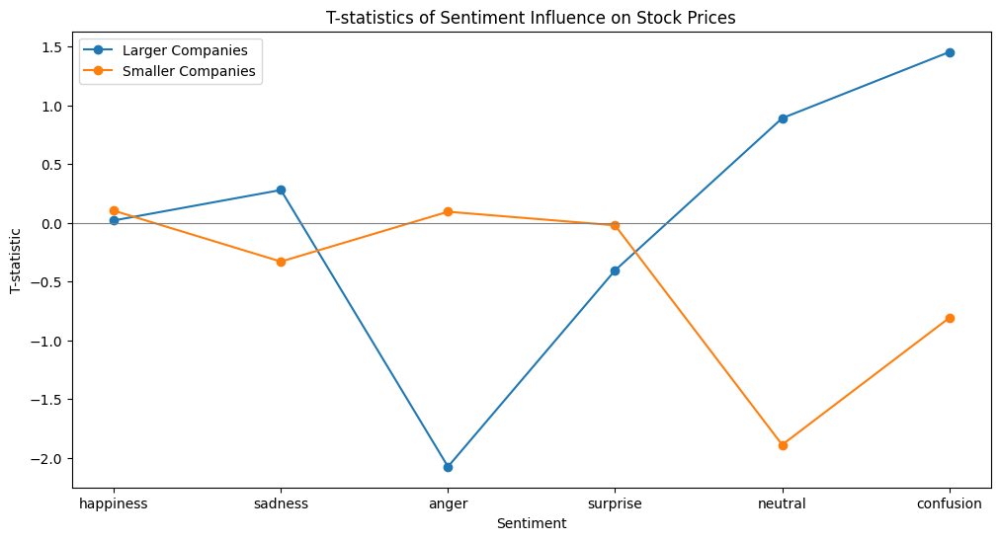

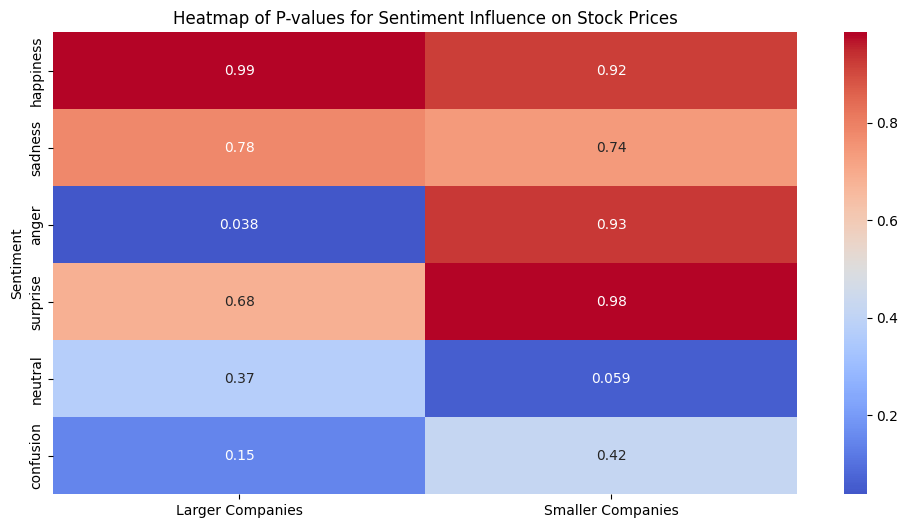

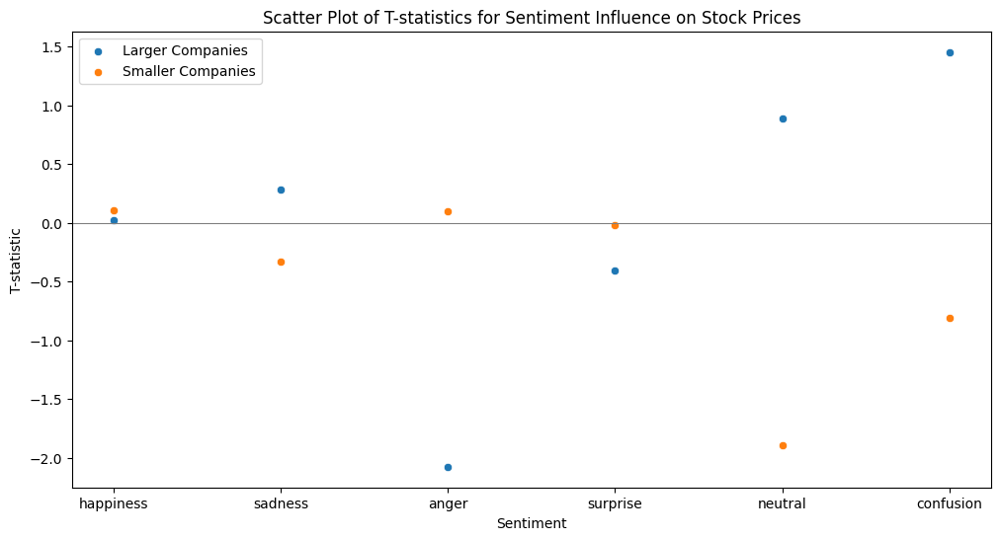

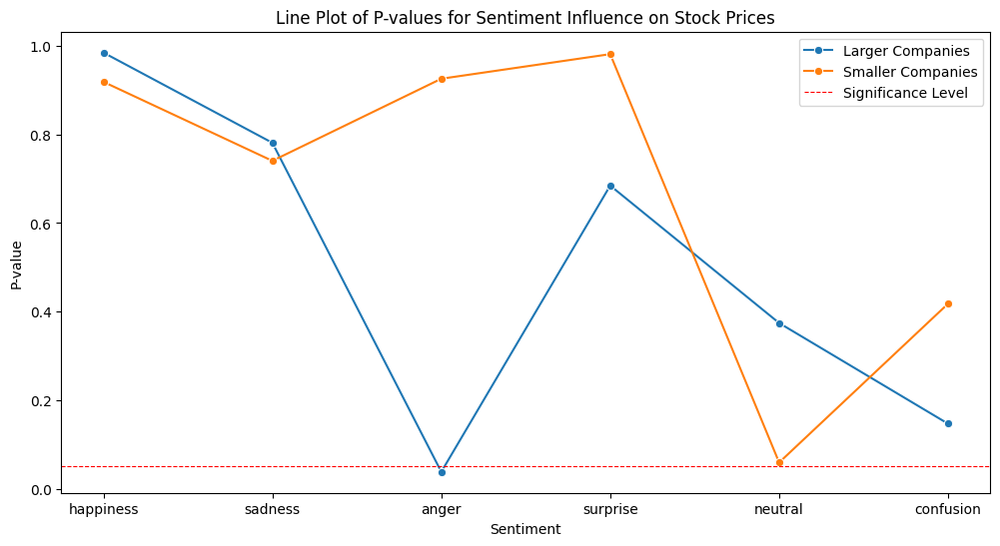

In [ ]:
# Merge the DataFrames on Date and Symbol
merged_df = pd.merge(stock_df, sentiment_df, on=['Date', 'Symbol'])

# Define larger and smaller companies
larger_companies = ['AMZN', 'AAPL', 'GOOG', 'TSLA']
smaller_companies = ['VZ', 'KO']
sentiments = ['happiness', 'sadness', 'anger', 'surprise', 'neutral', 'confusion']

def perform_t_test(df, sentiment, price_column='Close'):
    """Perform t-test for high vs low sentiment groups."""
    df = df.dropna(subset=[sentiment, price_column])
    high_sentiment = df[df[sentiment] > df[sentiment].mean()][price_column]
    low_sentiment = df[df[sentiment] <= df[sentiment].mean()][price_column]
    if len(high_sentiment) > 1 and len(low_sentiment) > 1:
        t_stat, p_val = ttest_ind(high_sentiment, low_sentiment, nan_policy='omit')
    else:
        t_stat, p_val = np.nan, np.nan
    return t_stat, p_val

def sentiment_influence(df, companies, sentiments, price_column='Close'):
    """Analyze sentiment influence on stock prices."""
    influence = {}
    for sentiment in sentiments:
        company_data = df[df['Symbol'].isin(companies)].dropna(subset=[sentiment, price_column])
        if company_data.empty:
            influence[sentiment] = {'t_stat': np.nan, 'p_val': np.nan}
            continue
        t_stat, p_val = perform_t_test(company_data, sentiment, price_column)
        influence[sentiment] = {'t_stat': t_stat, 'p_val': p_val}
    return influence

# Calculate influence for larger and smaller companies
larger_influence = sentiment_influence(merged_df, larger_companies, sentiments)
smaller_influence = sentiment_influence(merged_df, smaller_companies, sentiments)

# Convert results to DataFrame for visualization
larger_df = pd.DataFrame(larger_influence).T.reset_index().rename(columns={'index': 'Sentiment'})
smaller_df = pd.DataFrame(smaller_influence).T.reset_index().rename(columns={'index': 'Sentiment'})

# Plot t-statistics for larger and smaller companies
plt.figure(figsize=(12, 6))
plt.plot(larger_df['Sentiment'], larger_df['t_stat'], label='Larger Companies', marker='o')
plt.plot(smaller_df['Sentiment'], smaller_df['t_stat'], label='Smaller Companies', marker='o')
plt.axhline(0, color='gray', linewidth=0.8)
plt.title('T-statistics of Sentiment Influence on Stock Prices')
plt.xlabel('Sentiment')
plt.ylabel('T-statistic')
plt.legend()
plt.show()

# Heatmap for p-values
heatmap_data = pd.concat([larger_df[['Sentiment', 'p_val']], smaller_df[['Sentiment', 'p_val']]], axis=1)
heatmap_data.columns = ['Sentiment', 'Larger Companies', 'Sentiment_2', 'Smaller Companies']
heatmap_data = heatmap_data.drop('Sentiment_2', axis=1).set_index('Sentiment')

plt.figure(figsize=(12, 6))
sns.heatmap(heatmap_data, annot=True, cmap='coolwarm', center=0.5)
plt.title('Heatmap of P-values for Sentiment Influence on Stock Prices')
plt.show()

# Scatter plot for t-statistics comparison
plt.figure(figsize=(12, 6))
sns.scatterplot(data=larger_df, x='Sentiment', y='t_stat', label='Larger Companies')
sns.scatterplot(data=smaller_df, x='Sentiment', y='t_stat', label='Smaller Companies')
plt.axhline(0, color='gray', linewidth=0.8)
plt.title('Scatter Plot of T-statistics for Sentiment Influence on Stock Prices')
plt.xlabel('Sentiment')
plt.ylabel('T-statistic')
plt.legend()
plt.show()

# Line plot for p-values comparison
plt.figure(figsize=(12, 6))
sns.lineplot(data=larger_df, x='Sentiment', y='p_val', label='Larger Companies', marker='o')
sns.lineplot(data=smaller_df, x='Sentiment', y='p_val', label='Smaller Companies', marker='o')
plt.axhline(0.05, color='red', linestyle='--', linewidth=0.8, label='Significance Level')
plt.title('Line Plot of P-values for Sentiment Influence on Stock Prices')
plt.xlabel('Sentiment')
plt.ylabel('P-value')
plt.legend()
plt.show()


Sentiment Analysis on Stock Price Variations for Different Company Sizes

<ipython-input-57-586c3f9d4833>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  larger_companies_df['combined_sentiment'] = larger_companies_df[sentiments].mean(axis=1)
<ipython-input-57-586c3f9d4833>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  smaller_companies_df['combined_sentiment'] = smaller_companies_df[sentiments].mean(axis=1)


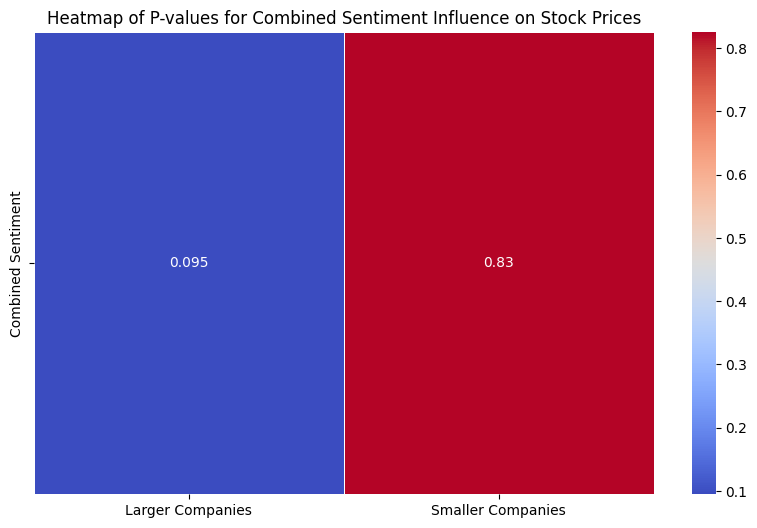

In [ ]:
sentiments = ['happiness', 'sadness', 'anger', 'surprise', 'neutral', 'confusion']
larger_companies = ['AAPL', 'AMZN', 'GOOG', 'META', 'MSFT', 'NFLX', 'TSLA', 'DIS', 'CRM', 'PG']
smaller_companies = ['AMD', 'BA', 'BX', 'COST', 'ENPH', 'F', 'INTC', 'KO', 'NIO', 'NOC', 'PYPL', 'TSM', 'VZ', 'XPEV', 'ZS']
merged_df = pd.merge(stock_df, sentiment_df, on=['Date', 'Symbol'])
larger_companies_df = merged_df[merged_df['Symbol'].isin(larger_companies)]
smaller_companies_df = merged_df[merged_df['Symbol'].isin(smaller_companies)]
larger_companies_df['combined_sentiment'] = larger_companies_df[sentiments].mean(axis=1)
smaller_companies_df['combined_sentiment'] = smaller_companies_df[sentiments].mean(axis=1)

# Function to perform t-test on combined sentiment scores
def analyze_sentiment(df):
    high_sentiment = df[df['combined_sentiment'] > df['combined_sentiment'].mean()]['Close']
    low_sentiment = df[df['combined_sentiment'] <= df['combined_sentiment'].mean()]['Close']

    if len(high_sentiment) > 1 and len(low_sentiment) > 1:
        t_stat, p_val = ttest_ind(high_sentiment, low_sentiment, nan_policy='omit')
    else:
        t_stat, p_val = np.nan, np.nan
    return t_stat, p_val

# Perform t-test for larger and smaller companies
t_stat_larger, p_val_larger = analyze_sentiment(larger_companies_df)
t_stat_smaller, p_val_smaller = analyze_sentiment(smaller_companies_df)
heatmap_data = pd.DataFrame({
    'Larger Companies': [p_val_larger],
    'Smaller Companies': [p_val_smaller]
}, index=['Combined Sentiment'])
plt.figure(figsize=(10, 6))
sns.heatmap(heatmap_data, annot=True, cmap='coolwarm', cbar=True, linewidths=.5)
plt.title('Heatmap of P-values for Combined Sentiment Influence on Stock Prices')
plt.show()


Emotion Trend Visualization

Stock Price Prediction and Sentiment Analysis with SHAP Interpretability

 99%|===================| 358/360 [00:14<00:00]       

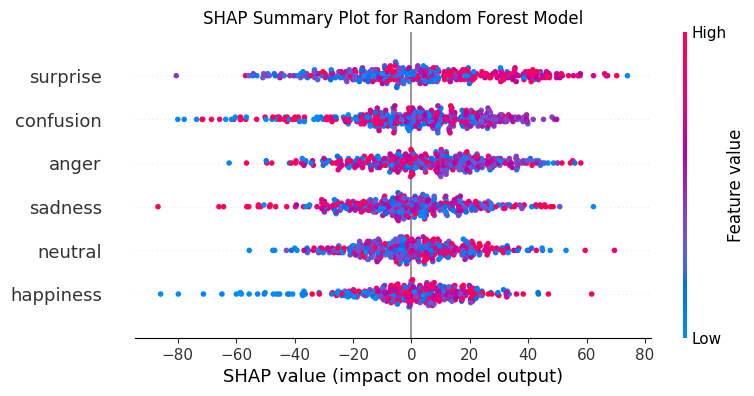

In [ ]:
np.random.seed(0)
# Generate synthetic stock prices and sentiment scores
dates = pd.date_range(start='2021-01-01', periods=300)
stock_df = pd.DataFrame({
    'Date': np.tile(dates, 6),
    'Symbol': np.repeat(['GOOG', 'AMZN', 'AAPL', 'TSLA', 'VZ', 'KO'], 300),
    'Close': np.random.rand(1800) * 1000  # Random stock prices
})
sentiment_df = pd.DataFrame({
    'Date': np.tile(dates, 6),
    'Symbol': np.repeat(['GOOG', 'AMZN', 'AAPL', 'TSLA', 'VZ', 'KO'], 300),
    'happiness': np.random.rand(1800),
    'sadness': np.random.rand(1800),
    'anger': np.random.rand(1800),
    'surprise': np.random.rand(1800),
    'neutral': np.random.rand(1800),
    'confusion': np.random.rand(1800)
})

merged_df = pd.merge(stock_df, sentiment_df, on=['Date', 'Symbol'])
feature_cols = ['happiness', 'sadness', 'anger', 'surprise', 'neutral', 'confusion']
target_col = 'Close'
X_train, X_test, y_train, y_test = train_test_split(
    merged_df[feature_cols], merged_df[target_col], test_size=0.2, random_state=0)
model = RandomForestRegressor(n_estimators=100, random_state=0)
model.fit(X_train, y_train)

# SHAP explanations
explainer_shap = shap.Explainer(model, X_train)
shap_values = explainer_shap(X_test)
shap.summary_plot(shap_values, X_test, show=False)
plt.title('SHAP Summary Plot for Random Forest Model')
plt.show()


**Analysis of Social Media Sentiment and Stock Market Trends Before and After Significant Global Events**

The second part of the script analyzes the impact of significant global events on social media sentiment and stock market trends by examining how tweet volumes and emotion distributions change before and after these events. It focuses on key events like the Russian Invasion of Ukraine and the Global Climate Summit, analyzing their influence on public sentiment captured through Twitter and the corresponding fluctuations in stock prices across multiple companies. The script processes tweet data to identify emotions such as anger, happiness, and sadness during defined pre-event and post-event periods, aggregates this data to calculate total tweet volumes and emotion counts, and then visualizes these changes alongside stock price trends. This approach provides insights into how major global events may affect both public emotions and financial markets.

Emotion Detection in Stock-Related Tweets Using Logistic Regression

In [ ]:
import pandas as pd
import re
import nltk
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split, cross_val_predict
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import precision_score, recall_score, f1_score
from nltk.sentiment.vader import SentimentIntensityAnalyzer
from concurrent.futures import ThreadPoolExecutor, as_completed
from multiprocessing import cpu_count
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
# Load the dataset containing stock-related tweets
df = pd.read_csv('stock_tweets.csv')

# Function to keep only stock-related tweets
def keep_stock_related(text):
    return re.search(r'\$\w+|\b(stock|market|finance|shares)\b', text, flags=re.I) is not None
neutral_words = set([
    'the', 'to', 'a', 'and', 'in', 'of', 'is', 'for', 'on', 'i', 'this', 'it', 'you', 'tesla', 'at',
    'that', 'with', 'will', 'be', 'are', 'my', 'if', 'from', 'as', 'its', 'have', 'we', 'up', 'all',
    'can', 'not', 'now', 'has', 'just', 'amp', 'today', 'more', 'was', 'but', 'by', 'over', 'like',
    'so', 'gt', 'they', 'out', 'what', 'tsm', 'day', 'week', 'about', 'new', 'an', 'when', 'one',
    'how', 'lt', 'see', 'me', 'earnings', '1', 'time', 'or', 'next', 'calls', 'after', 'no', 'your',
    'stocks', 'some', 'get', 'their', 'people', 'were', 'model', 'trade', 'ev', 'there', 'go', 'who',
    'company', 'work', 'short', '2', '3', '4', '5', '6', '7', '8', '9', '0', 'elon', 'price', 'good',
    'best', 'growth', 'apple', 'amazon', 'amzn', 'google', 'tesla', 'musk', 'news', 'watch', 'trading',
    'buy', 'sell'
])

# Function to preprocess the tweets
def preprocess_tweet(tweet):
    if isinstance(tweet, str):
        if keep_stock_related(tweet):
            tweet = re.sub(r'http\S+|www\S+|https\S+', '', tweet, flags=re.MULTILINE)
            tweet = re.sub(r'\@\w+|\#', '', tweet)
            tweet = re.sub(r'[^\w\s]', '', tweet)
            tweet = tweet.lower()
            words = tweet.split()
            words = [word for word in words if word not in neutral_words and not word.isdigit()]
            return ' '.join(words)
    return ""

# Function to detect emotions in a tweet
def detect_emotion(tweet, emotions_keywords):
    detected_emotions = []
    for emotion, keywords in emotions_keywords.items():
        if any(keyword in tweet for keyword in keywords):
            detected_emotions.append(emotion)
    return detected_emotions if detected_emotions else []

# Function to analyze sentiment and detect emotion in a tweet
def analyze_sentiment_and_emotion(tweet, emotions_keywords):
    analyzer = SentimentIntensityAnalyzer()
    sentiment = analyzer.polarity_scores(tweet)
    emotions = detect_emotion(tweet, emotions_keywords)
    return sentiment, emotions

# Function to extract sentiment and emotion analysis results into separate columns
def extract_analysis_results(df):
    df['Positive'] = df['analysis'].apply(lambda x: x[0]['pos'])
    df['Negative'] = df['analysis'].apply(lambda x: x[0]['neg'])
    df['Neutral'] = df['analysis'].apply(lambda x: x[0]['neu'])
    df['Compound'] = df['analysis'].apply(lambda x: x[0]['compound'])
    df['Emotions'] = df['analysis'].apply(lambda x: x[1])

# Function to process tweets, including preprocessing, sentiment analysis, and emotion detection
def process_tweets(df, emotions_keywords):
    df['processed_tweet'] = df['Tweet'].apply(preprocess_tweet)
    df = df[df['processed_tweet'].str.strip().astype(bool)]
    with ThreadPoolExecutor(max_workers=cpu_count()) as executor:
        futures = {executor.submit(analyze_sentiment_and_emotion, tweet, emotions_keywords): tweet for tweet in df['processed_tweet']}
        df['analysis'] = [future.result() for future in as_completed(futures)]
    extract_analysis_results(df)

    return df

emotions_keywords = {
    'anger': ['down', 'short', 'dont', 'lost', 'bad', 'worst', 'angry', 'sell', 'mad', 'furious', 'hate',
              'bubble', 'bearish', 'overvalued', 'overbought', 'overpriced', 'expensive', 'downward', 'falling',
              'miss', 'resistance', 'squeeze', 'cover', 'seller', 'rage', 'annoyed', 'crash', '😠', '😡', '🤬',
              '👿', '💢', 'fake', 'decline', 'drop', '📉'],
    'happiness': ['good', 'growth', 'best', 'free', 'move', 'want', "let's", 'team',
                  'above', 'top', 'happy', 'buy', 'bull', 'long', 'support', 'undervalued', 'underpriced', 'cheap', 'upward',
                  'rising', 'trend', 'moon', 'rocket', 'hold', 'breakout', 'call', 'beat', 'buying', 'holding',
                  'high', 'profit', 'joy', 'glad', 'delighted', 'love', 'great', '😊', '😁', '😃', '😄', '😆',
                  '😂', '🤗', '😍', '😇', '🥰', 'risen', 'better', 'gain', '📈', '❤️', '🚀', '🍎', '💰'],
    'sadness': ['lost', 'down', 'short', 'dont' ,'sad', 'unhappy', 'short', 'sold', 'miss', 'depressed', 'down', '😢', '😭', '😞', '😔', '😟',
                '😿', '💔', 'undervalued', 'misunderstood', 'loss', 'fall', 'decrease', 'dip', 'neutral',
                'steady', 'stable', 'even', 'calm', 'balanced', 'level', 'flat', '😐'],
    'surprise': ['split', 'unexpected', 'surprised', 'shocked', 'breakout', 'moon', 'rocket', 'beat', 'amazed',
                 'astonished', '!', '😲', '😯', '😮', '😱', '🙀', '😳', 'unveiled', 'earnings', 'surge', 'spike',
                 'unexpected', 'shock', '🎯', '➡️'],
    'confusion': ['confused', 'lost', 'squeeze', 'cover', 'bear', 'bubble', 'bearish', 'overvalued', 'overbought',
                  'overpriced', 'expensive', 'downward', 'falling', 'low', 'miss', 'resistance', 'uncertain',
                  '?', '??', 'what...?', '😕', '😵', '🤔', '🤯', 'trendless', 'volatile', 'fluctuate', 'confuse', '🛒']
}

# Process the tweets to extract sentiment and emotion data
processed_df = process_tweets(df, emotions_keywords)
processed_df = processed_df[processed_df['Emotions'].apply(lambda x: len(x) > 0)]

# Vectorize the processed tweets using TF-IDF
vectorizer = TfidfVectorizer(ngram_range=(1, 2))
X = vectorizer.fit_transform(processed_df['processed_tweet'])
processed_df['emotion'] = processed_df['Emotions'].apply(lambda x: x[0])
y = processed_df['emotion'].factorize()[0]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
model = LogisticRegression(max_iter=1000)
model.fit(X_train, y_train)
y_pred = cross_val_predict(model, X, y, cv=10)

# Calculate precision, recall, and F1 score
precision = precision_score(y, y_pred, average='weighted')
recall = recall_score(y, y_pred, average='weighted')
f1 = f1_score(y, y_pred, average='weighted')
print(f'Precision: {precision}')
print(f'Recall: {recall}')
print(f'F1 Score: {f1}')

# Apply the trained model to the full dataset
processed_df['predicted_emotion'] = model.predict(X)
print(processed_df['predicted_emotion'].value_counts())

<ipython-input-71-4277e5c67a2c>:61: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['analysis'] = [future.result() for future in as_completed(futures)]
<ipython-input-71-4277e5c67a2c>:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Positive'] = df['analysis'].apply(lambda x: x[0]['pos'])
<ipython-input-71-4277e5c67a2c>:50: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the document

Precision: 0.7146707878947262
Recall: 0.7019334757722033
F1 Score: 0.6782910046425468
predicted_emotion
2    21994
0    13375
1     1391
3      701
4      450
Name: count, dtype: int64


Visualization of Predicted Emotions and Sentiment Analysis

Precision: 0.7146707878947262
Recall: 0.7019334757722033
F1 Score: 0.6782910046425468
predicted_emotion
happiness    12038
anger         6021
sadness        473
confusion      261
surprise       201
Name: count, dtype: int64


<ipython-input-72-00666840114e>:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(y='predicted_emotion', data=processed_df, order=processed_df['predicted_emotion'].value_counts().index, palette="muted")


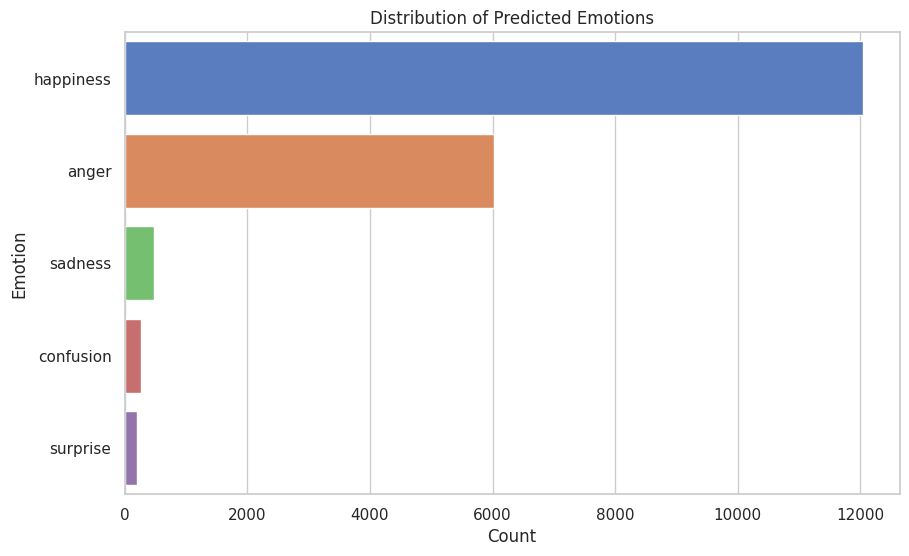

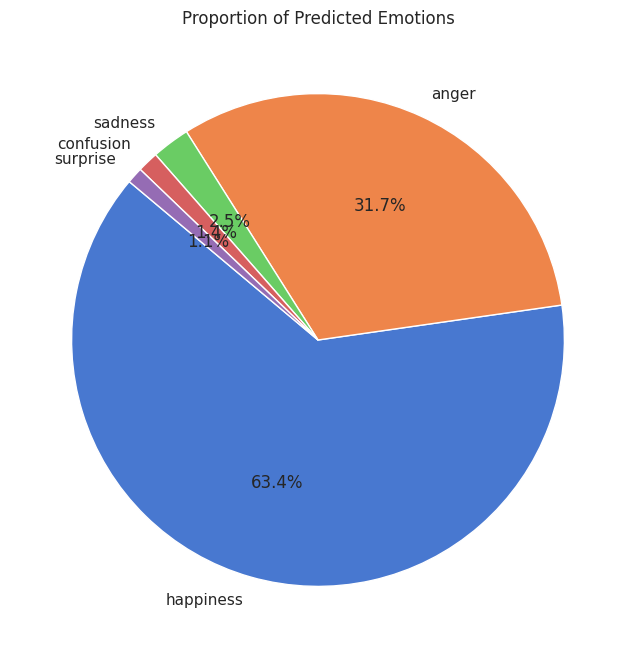

<Figure size 1400x800 with 0 Axes>

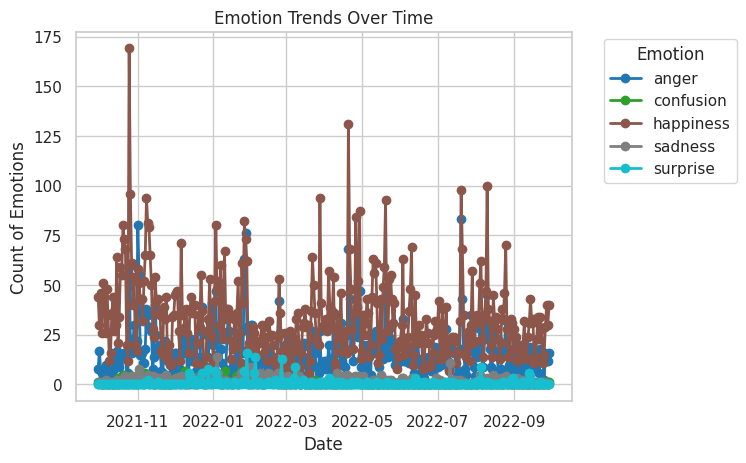

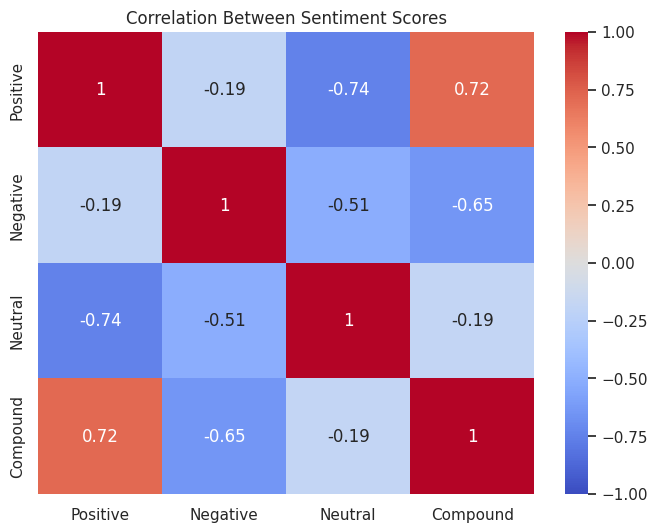

In [ ]:
# Encode target labels with emotion names and create a mapping
emotion_labels, unique_emotions = pd.factorize(processed_df['emotion'])
emotion_mapping = {index: emotion for index, emotion in enumerate(unique_emotions)}


# Calculate evaluation metrics
precision = precision_score(emotion_labels, y_pred, average='weighted')
recall = recall_score(emotion_labels, y_pred, average='weighted')
f1 = f1_score(emotion_labels, y_pred, average='weighted')
print(f'Precision: {precision}')
print(f'Recall: {recall}')
print(f'F1 Score: {f1}')

# Decode the predictions back into emotion names
processed_df['predicted_emotion'] = pd.Series(y_pred).map(emotion_mapping)
print(processed_df['predicted_emotion'].value_counts())

# This bar plot shows the count of each predicted emotion in the dataset.
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))
sns.countplot(y='predicted_emotion', data=processed_df, order=processed_df['predicted_emotion'].value_counts().index, palette="muted")
plt.title('Distribution of Predicted Emotions')
plt.xlabel('Count')
plt.ylabel('Emotion')
plt.show()

# This pie chart visualizes the proportion of each predicted emotion in the dataset.
plt.figure(figsize=(8, 8))
processed_df['predicted_emotion'].value_counts().plot.pie(autopct='%1.1f%%', startangle=140, colors=sns.color_palette("muted"))
plt.title('Proportion of Predicted Emotions')
plt.ylabel('')
plt.show()

# This line plot shows the trends of different predicted emotions over time.
if 'Date' in processed_df.columns:
    processed_df['Date'] = pd.to_datetime(processed_df['Date'])
    emotion_over_time = processed_df.groupby([processed_df['Date'].dt.date, 'predicted_emotion']).size().unstack().fillna(0)
    plt.figure(figsize=(14, 8))
    emotion_over_time.plot(kind='line', marker='o', colormap='tab10', linewidth=2)
    plt.title('Emotion Trends Over Time')
    plt.xlabel('Date')
    plt.ylabel('Count of Emotions')
    plt.legend(title='Emotion', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()

# This heatmap visualizes the correlation between different sentiment scores.
emotion_correlation = processed_df[['Positive', 'Negative', 'Neutral', 'Compound']].corr()
plt.figure(figsize=(8, 6))
sns.heatmap(emotion_correlation, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Between Sentiment Scores')
plt.show()


Sentiment Analysis of Stock-Related Tweets Around Major Global Events

                                              Event  Pre-Event Sentiment  \
0                             Global Climate Summit             0.174085   
1                       Russian Invasion of Ukraine             0.208527   
2          US Supreme Court Overturning Roe vs Wade             0.162292   
3  UK Political Turmoil (Boris Johnson Resignation)             0.128539   
4                            Crypto Market Collapse             0.129619   
5                   2022 Winter Olympics in Beijing             0.139376   
6                                     Superbowl LVI             0.168177   
7                                    Wimbledon 2022             0.183922   

   Post-Event Sentiment  Sentiment Change  
0              0.214734          0.040649  
1              0.111614         -0.096913  
2              0.168915          0.006623  
3              0.197346          0.068806  
4              0.158166          0.028547  
5              0.199211          0.059835  
6      

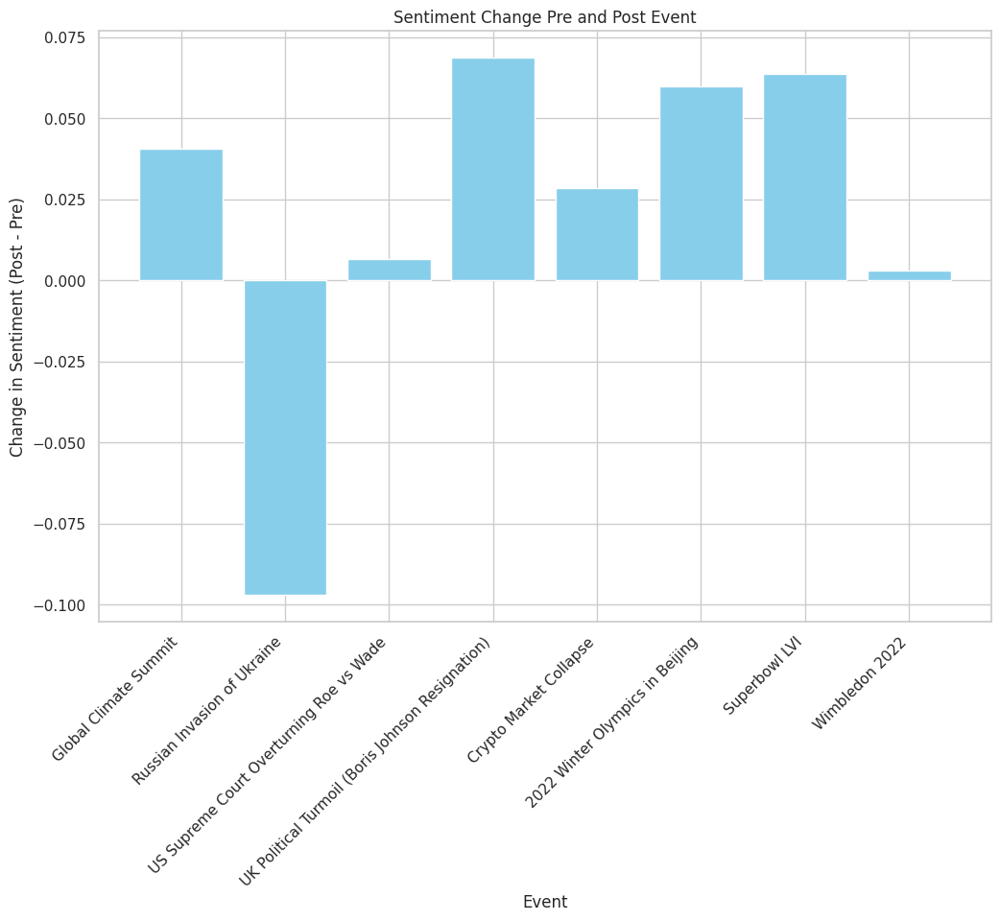

In [ ]:
# Initialize the sentiment analyzer
analyzer = SentimentIntensityAnalyzer()
df['Date'] = pd.to_datetime(df['Date']).dt.tz_localize(None)

# Define major events and their date ranges
events = {
    "Global Climate Summit": ("2021-10-31", "2021-11-13"),
    "Russian Invasion of Ukraine": ("2022-02-24", "2022-09-27"),
    "US Supreme Court Overturning Roe vs Wade": ("2022-06-24", "2022-06-25"),
    "UK Political Turmoil (Boris Johnson Resignation)": ("2022-07-07", "2022-07-09"),
    "Crypto Market Collapse": ("2022-05-01", "2022-05-31"),
    "2022 Winter Olympics in Beijing": ("2022-02-04", "2022-02-20"),
    "Superbowl LVI": ("2022-02-13", "2022-02-14"),
    "Wimbledon 2022": ("2022-06-27", "2022-07-10")
}

for event in events:
    start, end = events[event]
    events[event] = (pd.to_datetime(start), pd.to_datetime(end))

# Define periods for pre-event and post-event sentiment analysis
pre_event_days = 7
post_event_days = 7

def analyze_sentiment(text):
    """Calculate sentiment scores using VADER."""
    return analyzer.polarity_scores(text)['compound']

# Analyze sentiment before and after each event
sentiment_summary = []

for event_name, (start_date, end_date) in events.items():
    pre_event_start = start_date - pd.Timedelta(days=pre_event_days)
    post_event_end = end_date + pd.Timedelta(days=post_event_days)
    pre_event_tweets = df[(df['Date'] >= pre_event_start) & (df['Date'] < start_date)]
    post_event_tweets = df[(df['Date'] > end_date) & (df['Date'] <= post_event_end)]
    pre_event_sentiment = pre_event_tweets['Tweet'].apply(analyze_sentiment).mean()
    post_event_sentiment = post_event_tweets['Tweet'].apply(analyze_sentiment).mean()

    # Store the sentiment analysis results
    sentiment_summary.append({
        'Event': event_name,
        'Pre-Event Sentiment': pre_event_sentiment,
        'Post-Event Sentiment': post_event_sentiment,
        'Sentiment Change': post_event_sentiment - pre_event_sentiment
    })

# Convert the summary into a DataFrame for better readability
sentiment_df = pd.DataFrame(sentiment_summary)
print(sentiment_df)

#  Bar plot showing sentiment change before and after each event
plt.figure(figsize=(12, 8))
plt.bar(sentiment_df['Event'], sentiment_df['Sentiment Change'], color='skyblue')
plt.title('Sentiment Change Pre and Post Event')
plt.xlabel('Event')
plt.ylabel('Change in Sentiment (Post - Pre)')
plt.xticks(rotation=45, ha='right')
plt.grid(True)
plt.show()


Emotion Analysis of Tweets Before and After a Specific Global Event

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from collections import Counter
import numpy as np
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
import re
import nltk
from multiprocessing import Pool, cpu_count
import time
import matplotlib.dates as mdates
import matplotlib.ticker as tkr
import seaborn as sns

nltk.download('vader_lexicon')
sia = SentimentIntensityAnalyzer()

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


Analyzing emotions for Global Climate Summit...


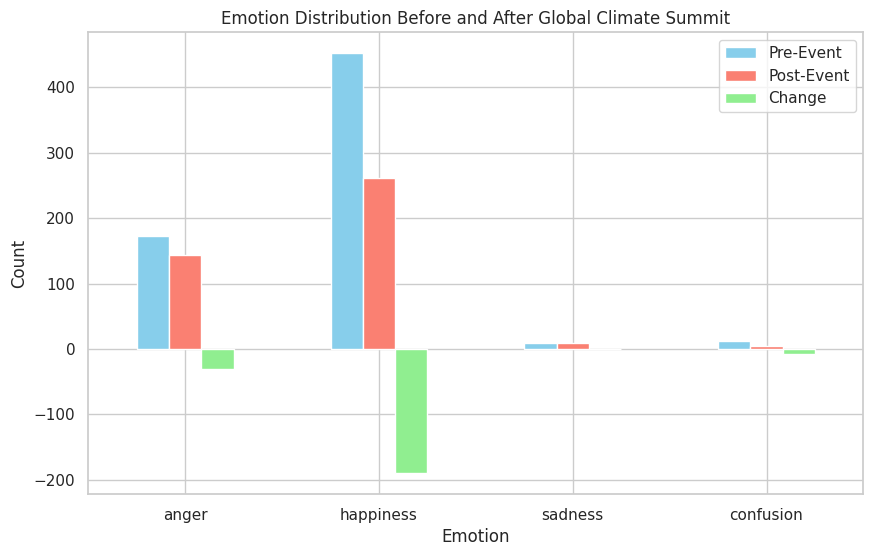

Analyzing emotions for Russian Invasion of Ukraine...


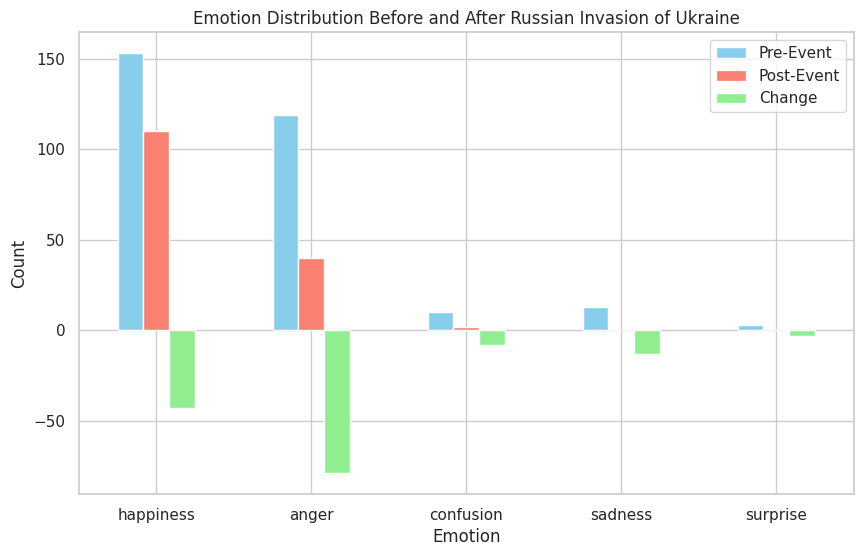

Analyzing emotions for US Supreme Court Overturning Roe vs Wade...


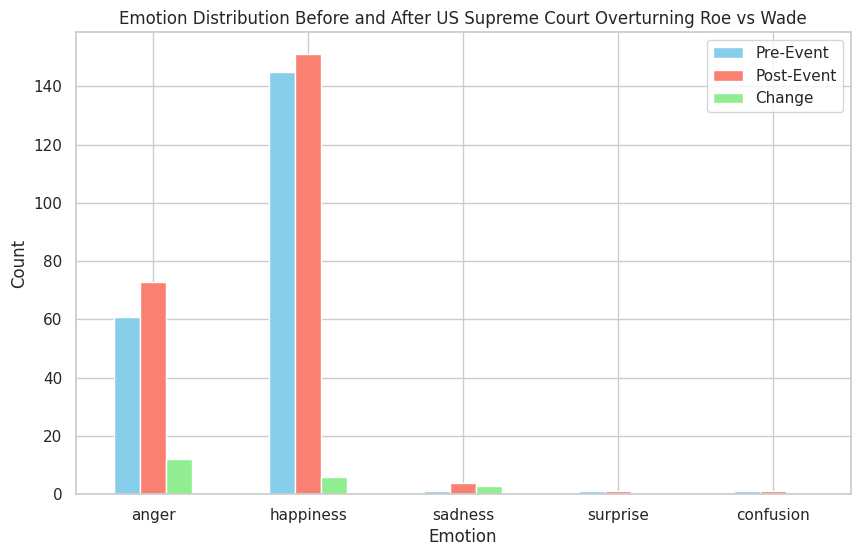

Analyzing emotions for UK Political Turmoil (Boris Johnson Resignation)...


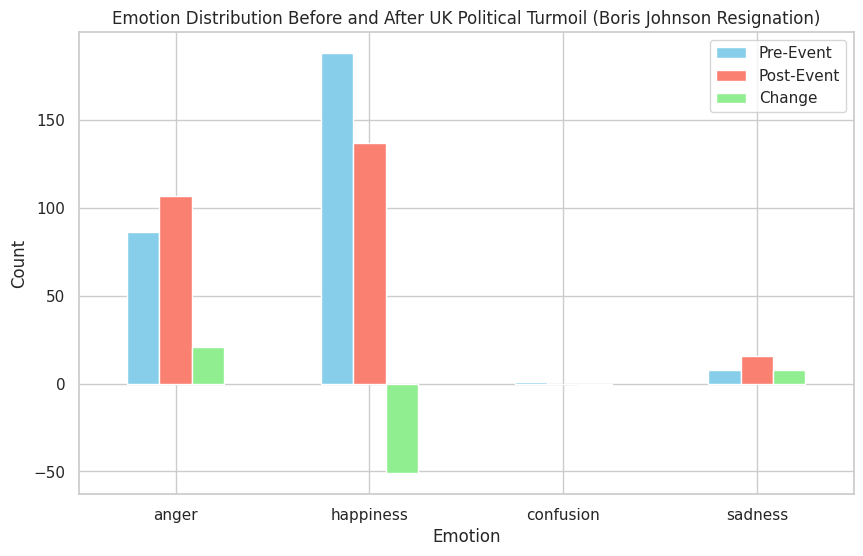

Analyzing emotions for Crypto Market Collapse...


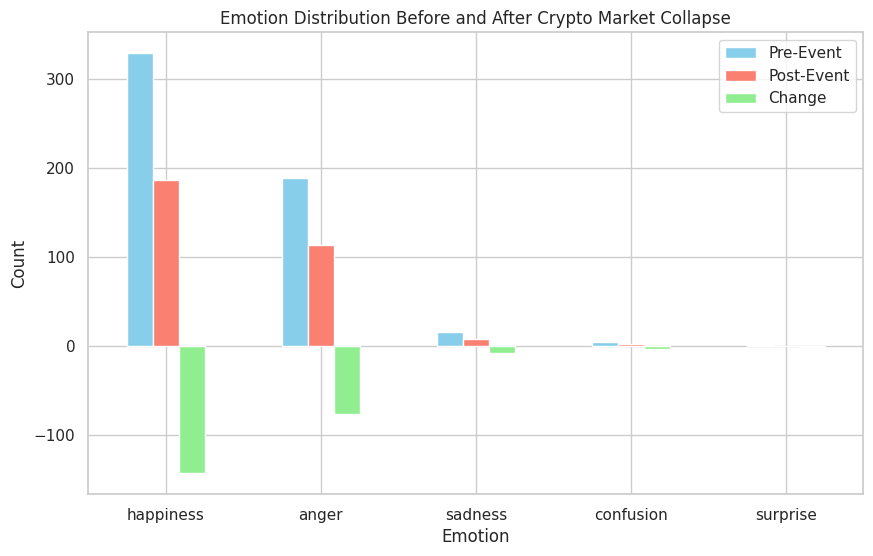

Analyzing emotions for 2022 Winter Olympics in Beijing...


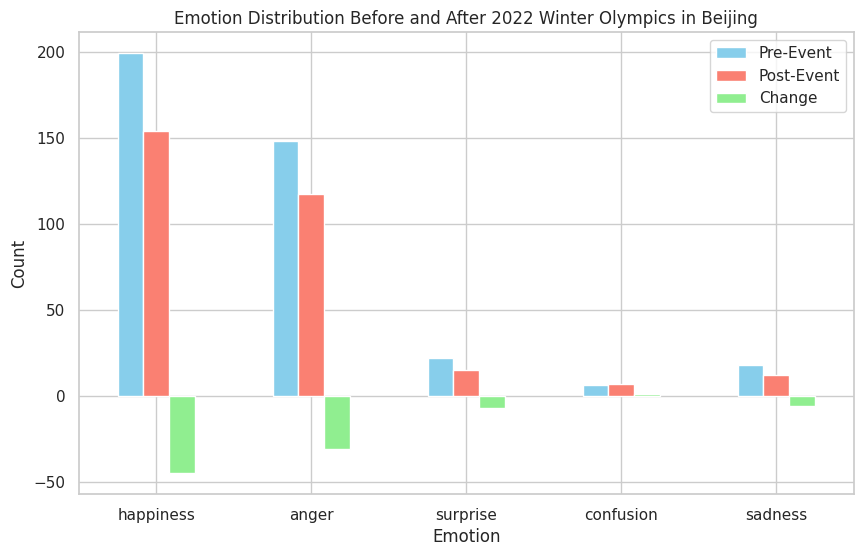

Analyzing emotions for Superbowl LVI...


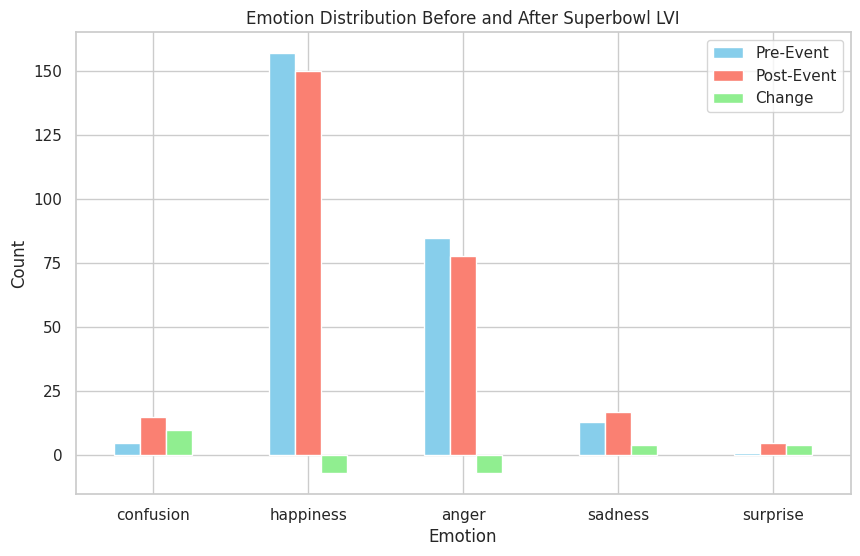

Analyzing emotions for Wimbledon 2022...


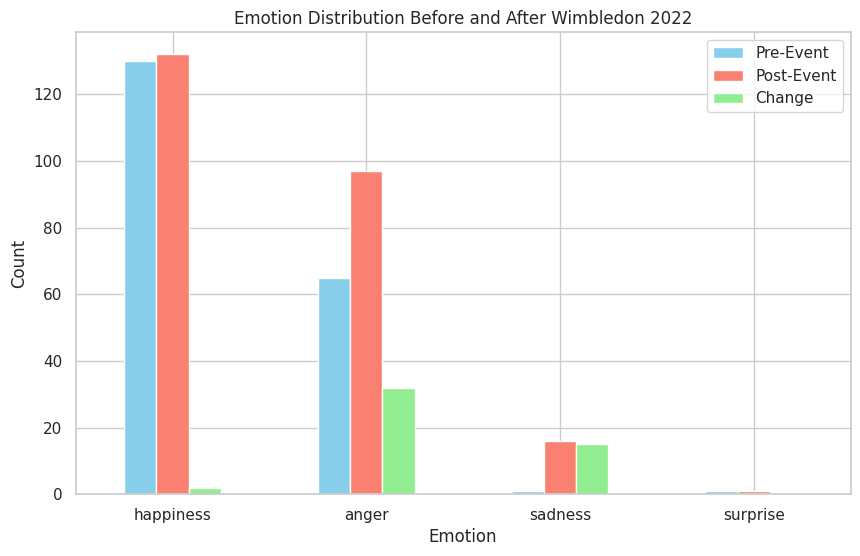

In [ ]:
pre_event_days = 7
post_event_days = 7

# Function to analyze emotions before and after a specific event
def analyze_emotions(event_name, start_date, end_date):
    start_date = pd.to_datetime(start_date).tz_localize(None)
    end_date = pd.to_datetime(end_date).tz_localize(None)
    processed_df['Date'] = pd.to_datetime(processed_df['Date']).dt.tz_localize(None)
    pre_event_start = start_date - pd.Timedelta(days=pre_event_days)
    post_event_end = end_date + pd.Timedelta(days=post_event_days)
    pre_event_tweets = processed_df[(processed_df['Date'] >= pre_event_start) & (processed_df['Date'] < start_date)]
    post_event_tweets = processed_df[(processed_df['Date'] > end_date) & (processed_df['Date'] <= post_event_end)]
    pre_event_emotions = Counter(pre_event_tweets['predicted_emotion'].dropna())
    post_event_emotions = Counter(post_event_tweets['predicted_emotion'].dropna())

    # Combine the results into a DataFrame for easy comparison
    emotion_comparison_df = pd.DataFrame({
        'Emotion': list(pre_event_emotions.keys()),
        'Pre-Event': [pre_event_emotions.get(emotion, 0) for emotion in pre_event_emotions.keys()],
        'Post-Event': [post_event_emotions.get(emotion, 0) for emotion in pre_event_emotions.keys()]
    })
    emotion_comparison_df['Change'] = emotion_comparison_df['Post-Event'] - emotion_comparison_df['Pre-Event']

    # Emotion Distribution Before and After the Event
    emotion_comparison_df.set_index('Emotion').plot(kind='bar', figsize=(10, 6), color=['skyblue', 'salmon', 'lightgreen'])
    plt.title(f'Emotion Distribution Before and After {event_name}')
    plt.xlabel('Emotion')
    plt.ylabel('Count')
    plt.xticks(rotation=0)
    plt.show()

# Define major global events and their date ranges
events = {
    "Global Climate Summit": ("2021-10-31", "2021-11-13"),
    "Russian Invasion of Ukraine": ("2022-02-24", "2022-09-27"),
    "US Supreme Court Overturning Roe vs Wade": ("2022-06-24", "2022-06-25"),
    "UK Political Turmoil (Boris Johnson Resignation)": ("2022-07-07", "2022-07-09"),
    "Crypto Market Collapse": ("2022-05-01", "2022-05-31"),
    "2022 Winter Olympics in Beijing": ("2022-02-04", "2022-02-20"),
    "Superbowl LVI": ("2022-02-13", "2022-02-14"),
    "Wimbledon 2022": ("2022-06-27", "2022-07-10")
}

# Iterate over each event and analyze emotions
for event_name, (start_date, end_date) in events.items():
    print(f"Analyzing emotions for {event_name}...")
    analyze_emotions(event_name, start_date, end_date)


Visualization of Emotions During Key Events

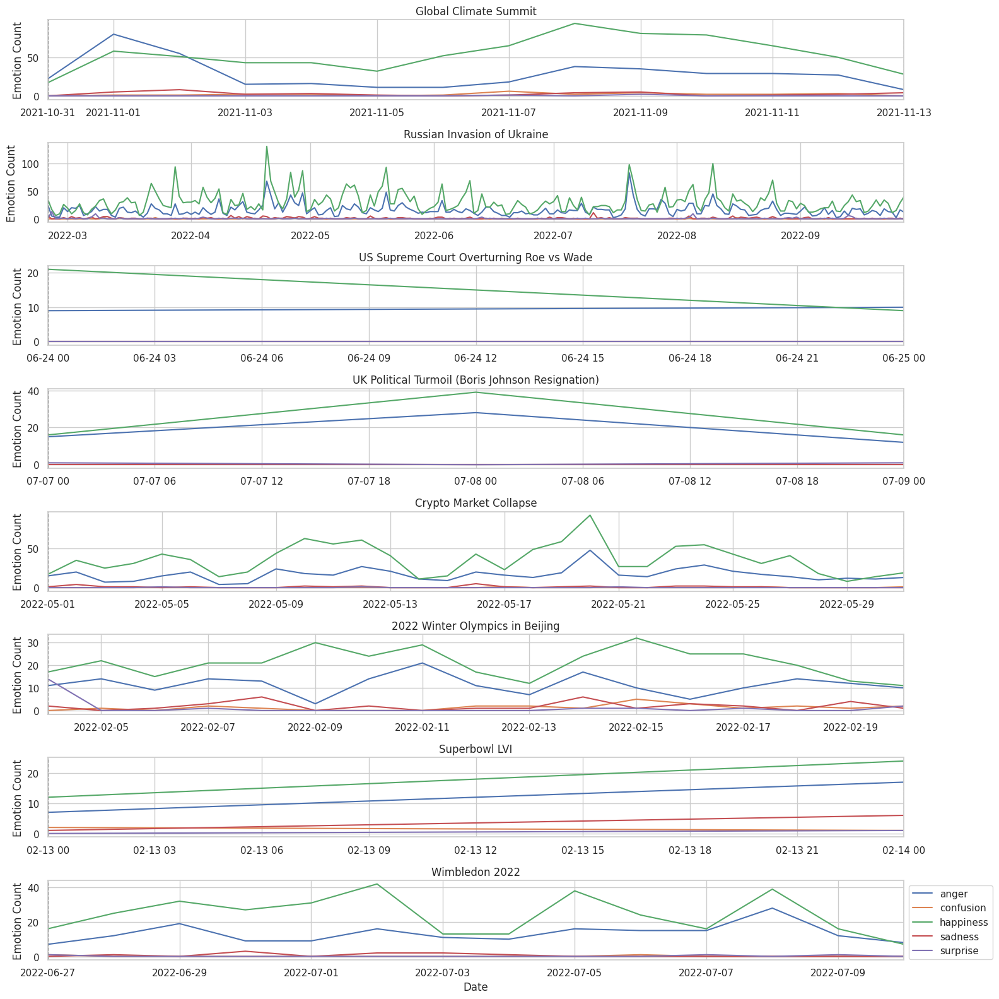

In [ ]:
# Define the events and their corresponding date ranges
events = {
    "Global Climate Summit": ("2021-10-31", "2021-11-13"),
    "Russian Invasion of Ukraine": ("2022-02-24", "2022-09-27"),
    "US Supreme Court Overturning Roe vs Wade": ("2022-06-24", "2022-06-25"),
    "UK Political Turmoil (Boris Johnson Resignation)": ("2022-07-07", "2022-07-09"),
    "Crypto Market Collapse": ("2022-05-01", "2022-05-31"),
    "2022 Winter Olympics in Beijing": ("2022-02-04", "2022-02-20"),
    "Superbowl LVI": ("2022-02-13", "2022-02-14"),
    "Wimbledon 2022": ("2022-06-27", "2022-07-10")
}

processed_df['Date'] = pd.to_datetime(processed_df['Date'])
emotion_over_time = processed_df.groupby([processed_df['Date'].dt.date, 'predicted_emotion']).size().unstack().fillna(0)
emotion_mapping = {0: 'anger', 1: 'happiness', 2: 'sadness', 3: 'surprise', 4: 'confusion'}
emotion_over_time.columns = [emotion_mapping.get(emotion, emotion) for emotion in emotion_over_time.columns]
num_events = len(events)
fig, axes = plt.subplots(nrows=num_events, ncols=1, figsize=(16, 2*num_events), sharex=False)

# Ensure axes is iterable
if num_events > 1:
    axes = axes.flatten()
else:
    axes = [axes]

for i, (event, (start, end)) in enumerate(events.items()):
    ax = axes[i]
    start = pd.to_datetime(start).date()
    end = pd.to_datetime(end).date()
    event_data = emotion_over_time.loc[(emotion_over_time.index >= start) & (emotion_over_time.index <= end)]

    for emotion in emotion_over_time.columns:
        ax.plot(event_data.index, event_data[emotion], label=emotion)
    ax.set_title(f'{event}')
    ax.set_xlim(start, end)
    ax.axvline(start, color='black', linestyle='--', linewidth=1)
    ax.axvline(end, color='gray', linestyle='--', linewidth=1)
    ax.set_ylabel('Emotion Count')
    ax.grid(True)
plt.xlabel('Date')
plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.tight_layout()
plt.show()


Visualization of Emotions During Key Events with respect to Stock Price

[*********************100%***********************]  6 of 6 completed


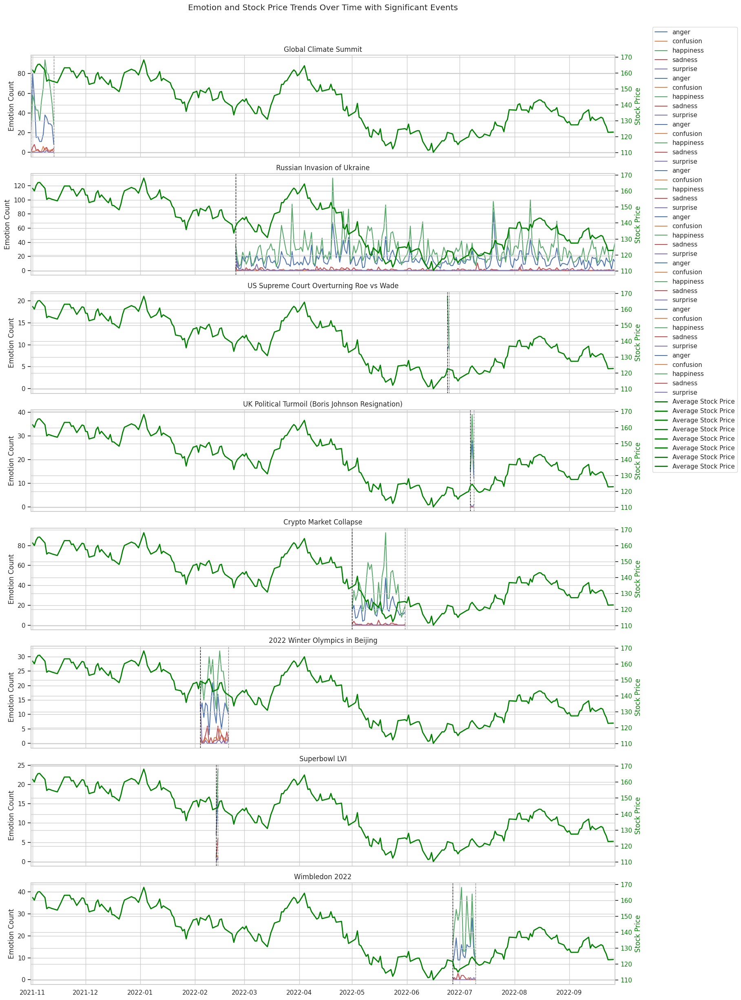

In [ ]:
events = {
    "Global Climate Summit": ("2021-10-31", "2021-11-13"),
    "Russian Invasion of Ukraine": ("2022-02-24", "2022-09-27"),
    "US Supreme Court Overturning Roe vs Wade": ("2022-06-24", "2022-06-25"),
    "UK Political Turmoil (Boris Johnson Resignation)": ("2022-07-07", "2022-07-09"),
    "Crypto Market Collapse": ("2022-05-01", "2022-05-31"),
    "2022 Winter Olympics in Beijing": ("2022-02-04", "2022-02-20"),
    "Superbowl LVI": ("2022-02-13", "2022-02-14"),
    "Wimbledon 2022": ("2022-06-27", "2022-07-10")
}

processed_df['Date'] = pd.to_datetime(processed_df['Date'])

# Aggregate emotions over time (daily aggregation)
emotion_over_time = processed_df.groupby([processed_df['Date'].dt.date, 'predicted_emotion']).size().unstack().fillna(0)
emotion_mapping = {0: 'anger', 1: 'happiness', 2: 'sadness', 3: 'surprise', 4: 'confusion'}
emotion_over_time.columns = [emotion_mapping.get(emotion, emotion) for emotion in emotion_over_time.columns]

# Fetch stock data from Yahoo Finance for the event periods
start_date = min([pd.to_datetime(start) for start, end in events.values()])
end_date = max([pd.to_datetime(end) for start, end in events.values()])
tickers = "AAPL KO VZ GOOG AMZN TSLA"
stock_data = yf.download(tickers, start=start_date, end=end_date)['Close']
stock_data.index = stock_data.index.tz_localize(None)
num_events = len(events)
fig, axes = plt.subplots(nrows=num_events, ncols=1, figsize=(16, 3*num_events), sharex=True)

# Ensure axes is iterable
if num_events > 1:
    axes = axes.flatten()
else:
    axes = [axes]

# Plot emotion trends and stock prices for each event
for i, (event, (start, end)) in enumerate(events.items()):
    ax = axes[i]
    start = pd.to_datetime(start).date()
    end = pd.to_datetime(end).date()
    event_data = emotion_over_time.loc[(emotion_over_time.index >= start) & (emotion_over_time.index <= end)]
    stock_data_event = stock_data.loc[start:end]

    for emotion in emotion_over_time.columns:
        ax.plot(event_data.index, event_data[emotion], label=emotion)

    ax2 = ax.twinx()
    ax2.plot(stock_data.index, stock_data.mean(axis=1), color='green', linestyle='-', linewidth=2, label='Average Stock Price')
    ax2.set_ylabel('Stock Price', color='green')
    ax2.tick_params(axis='y',    labelcolor='green')
    ax.set_xlim(start_date, end_date)
    ax.set_title(f'{event}')
    ax.axvline(start, color='black', linestyle='--', linewidth=1)
    ax.axvline(end, color='gray', linestyle='--', linewidth=1)
    ax.set_ylabel('Emotion Count')
    ax.grid(True)

#  Final plot customization and display
plt.suptitle('Emotion and Stock Price Trends Over Time with Significant Events', y=1.02)
plt.xlabel('Date')
fig.legend(loc='upper left', bbox_to_anchor=(1, 1))
plt.tight_layout()

plt.show()



Stock Performance Ranking Around Key Events

[*********************100%***********************]  6 of 6 completed


Analyzing influence for Global Climate Summit...
Analyzing influence for Russian Invasion of Ukraine...
Analyzing influence for US Supreme Court Overturning Roe vs Wade...
Analyzing influence for UK Political Turmoil (Boris Johnson Resignation)...
Analyzing influence for Crypto Market Collapse...
Analyzing influence for 2022 Winter Olympics in Beijing...
Analyzing influence for Superbowl LVI...
Analyzing influence for Wimbledon 2022...


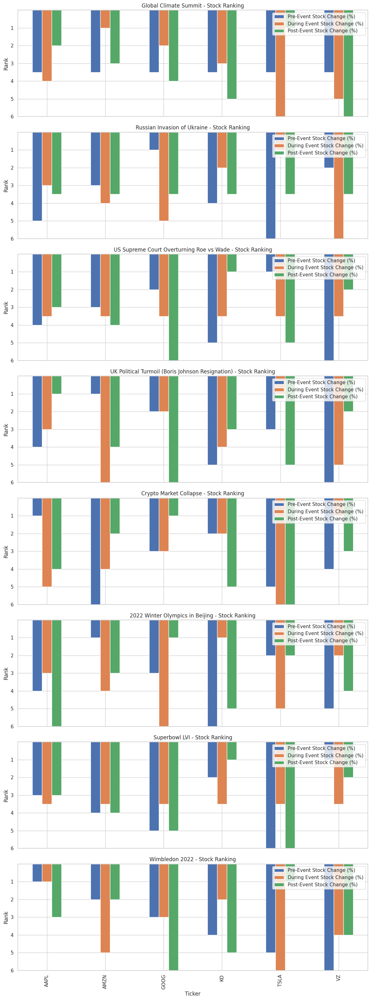

In [ ]:
events = {
    "Global Climate Summit": ("2021-10-31", "2021-11-13"),
    "Russian Invasion of Ukraine": ("2022-02-24", "2022-09-27"),
    "US Supreme Court Overturning Roe vs Wade": ("2022-06-24", "2022-06-25"),
    "UK Political Turmoil (Boris Johnson Resignation)": ("2022-07-07", "2022-07-09"),
    "Crypto Market Collapse": ("2022-05-01", "2022-05-31"),
    "2022 Winter Olympics in Beijing": ("2022-02-04", "2022-02-20"),
    "Superbowl LVI": ("2022-02-13", "2022-02-14"),
    "Wimbledon 2022": ("2022-06-27", "2022-07-10")
}
tickers = ["KO", "GOOG", "VZ", "AAPL", "AMZN", "TSLA"]

# Function to find the nearest trading day to avoid non-trading dates
def get_nearest_trading_day(df, target_date):
    dates = df.index
    if target_date in dates:
        return target_date
    else:
        nearest_date = min(dates, key=lambda d: abs(pd.to_datetime(d) - pd.to_datetime(target_date)))
        return nearest_date

#  Function to calculate the percentage change in stock prices
def calc_percent_change(df, start_date, end_date):
    start_date = get_nearest_trading_day(df, start_date)
    end_date = get_nearest_trading_day(df, end_date)
    return (df.loc[end_date] - df.loc[start_date]) / df.loc[start_date] * 100

# Fetch stock data from Yahoo Finance for the specified date range
stock_start_date = pd.to_datetime(min([start for start, end in events.values()]))
stock_end_date = pd.to_datetime(max([end for start, end in events.values()]))
stock_data = yf.download(tickers, start=stock_start_date, end=stock_end_date)['Close']
stock_data.index = stock_data.index.date
ranking_results = {}

# Analyze stock performance before, during, and after each event
for event_name, (start_date, end_date) in events.items():
    print(f"Analyzing influence for {event_name}...")

    pre_event_start = pd.to_datetime(start_date) - pd.Timedelta(days=7)
    post_event_end = pd.to_datetime(end_date) + pd.Timedelta(days=7)
    pre_event_start = pre_event_start.date()
    post_event_end = post_event_end.date()
    start_date = pd.to_datetime(start_date).date()
    end_date = pd.to_datetime(end_date).date()
    pre_event_change = calc_percent_change(stock_data, pre_event_start, start_date)
    during_event_change = calc_percent_change(stock_data, start_date, end_date)
    post_event_change = calc_percent_change(stock_data, end_date, post_event_end)
    stock_ranking = pd.DataFrame({
        'Pre-Event Stock Change (%)': pre_event_change,
        'During Event Stock Change (%)': during_event_change,
        'Post-Event Stock Change (%)': post_event_change
    }).rank(ascending=False)
    ranking_results[event_name] = stock_ranking

#Visualization of the rankings for each event
num_events = len(ranking_results)
fig, axes = plt.subplots(nrows=num_events, ncols=1, figsize=(12, 4*num_events), sharex=True)

# Flatten the axes array if there's more than one subplot
if num_events > 1:
    axes = axes.flatten()
else:
    axes = [axes]

# Plot the rankings for each event
for i, (event, ranking) in enumerate(ranking_results.items()):
    ax = axes[i]
    ranking.plot(kind='bar', ax=ax)
    ax.set_title(f'{event} - Stock Ranking')
    ax.set_ylabel('Rank')
    ax.set_ylim([6, 0])
    ax.set_yticks([1, 2, 3, 4, 5, 6])
    ax.legend(loc='upper right')
plt.xlabel('Ticker')
plt.tight_layout()
plt.show()


Radar Chart for Maximum Stock Change During Event Periods

Analyzing influence for Global Climate Summit...
Analyzing influence for Russian Invasion of Ukraine...
Analyzing influence for US Supreme Court Overturning Roe vs Wade...
Analyzing influence for UK Political Turmoil (Boris Johnson Resignation)...
Analyzing influence for Crypto Market Collapse...
Analyzing influence for 2022 Winter Olympics in Beijing...
Analyzing influence for Superbowl LVI...
Analyzing influence for Wimbledon 2022...
                                               Event Ticker  \
0                              Global Climate Summit   AAPL   
1                              Global Climate Summit   AMZN   
2                              Global Climate Summit   GOOG   
3                              Global Climate Summit     KO   
4                              Global Climate Summit   TSLA   
5                              Global Climate Summit     VZ   
6                        Russian Invasion of Ukraine   AAPL   
7                        Russian Invasion of Ukraine   A

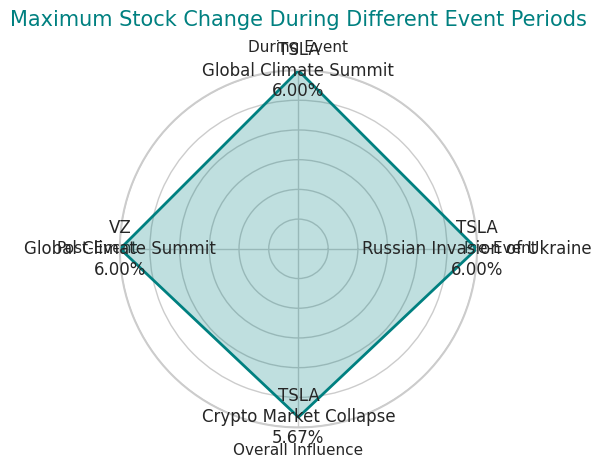

In [ ]:
# Initialize data storage
ranking_results = {}

# Iterate over each event
for event_name, (start_date, end_date) in events.items():
    print(f"Analyzing influence for {event_name}...")

    pre_event_start = pd.to_datetime(start_date) - pd.Timedelta(days=7)
    post_event_end = pd.to_datetime(end_date) + pd.Timedelta(days=7)

    pre_event_start = pre_event_start.date()
    post_event_end = post_event_end.date()
    start_date = pd.to_datetime(start_date).date()
    end_date = pd.to_datetime(end_date).date()

    # Filter stock data and calculate changes
    pre_event_change = calc_percent_change(stock_data, pre_event_start, start_date)
    during_event_change = calc_percent_change(stock_data, start_date, end_date)
    post_event_change = calc_percent_change(stock_data, end_date, post_event_end)

    # Combine changes into a DataFrame
    stock_changes = pd.DataFrame({
        'Pre-Event Stock Change (%)': pre_event_change,
        'During Event Stock Change (%)': during_event_change,
        'Post-Event Stock Change (%)': post_event_change
    })

    # Rank the changes
    stock_ranking = stock_changes.rank(ascending=False)

    # Store results
    ranking_results[event_name] = stock_ranking

# Combine all rankings into a single DataFrame
combined_ranking_df = pd.concat(ranking_results, axis=0)
combined_ranking_df = combined_ranking_df.reset_index().rename(columns={'level_0': 'Event', 'level_1': 'Ticker'})

# Display the combined ranking table
print(combined_ranking_df)

# Optionally, save the table to a CSV file
combined_ranking_df.to_csv('combined_stock_ranking.csv', index=False)


# Find the maximum changes for each period
max_pre_event_change = combined_ranking_df.loc[combined_ranking_df['Pre-Event Stock Change (%)'].idxmax()]
max_during_event_change = combined_ranking_df.loc[combined_ranking_df['During Event Stock Change (%)'].idxmax()]
max_post_event_change = combined_ranking_df.loc[combined_ranking_df['Post-Event Stock Change (%)'].idxmax()]
print("Highest Pre-Event Influence:")
print(f"Event: {max_pre_event_change['Event']}, Company: {max_pre_event_change['Ticker']}, Change: {max_pre_event_change['Pre-Event Stock Change (%)']}%")
print("\nHighest During-Event Influence:")
print(f"Event: {max_during_event_change['Event']}, Company: {max_during_event_change['Ticker']}, Change: {max_during_event_change['During Event Stock Change (%)']}%")
print("\nHighest Post-Event Influence:")
print(f"Event: {max_post_event_change['Event']}, Company: {max_post_event_change['Ticker']}, Change: {max_post_event_change['Post-Event Stock Change (%)']}%")

# Calculate overall influence (average of all three periods)
combined_ranking_df['Overall Influence'] = combined_ranking_df[['Pre-Event Stock Change (%)', 'During Event Stock Change (%)', 'Post-Event Stock Change (%)']].mean(axis=1)

# Find the maximum overall influence
max_overall_influence = combined_ranking_df.loc[combined_ranking_df['Overall Influence'].idxmax()]
print("\nHighest Overall Influence:")
print(f"Event: {max_overall_influence['Event']}, Company: {max_overall_influence['Ticker']}, Change: {max_overall_influence['Overall Influence']}%")

# Data for visualization
periods = ['Pre-Event', 'During Event', 'Post-Event', 'Overall Influence']
max_changes = [
    max_pre_event_change['Pre-Event Stock Change (%)'],
    max_during_event_change['During Event Stock Change (%)'],
    max_post_event_change['Post-Event Stock Change (%)'],
    max_overall_influence['Overall Influence']
]
companies = [
    max_pre_event_change['Ticker'],
    max_during_event_change['Ticker'],
    max_post_event_change['Ticker'],
    max_overall_influence['Ticker']
]
events = [
    max_pre_event_change['Event'],
    max_during_event_change['Event'],
    max_post_event_change['Event'],
    max_overall_influence['Event']
]
# Prepare the data for the radar chart
labels = np.array(periods)
stats = np.array(max_changes)
angles = np.linspace(0, 2 * np.pi, len(labels), endpoint=False).tolist()
stats = np.concatenate((stats, [stats[0]]))
angles += angles[:1]

# Create the radar chart
fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))
ax.fill(angles, stats, color='teal', alpha=0.25)
ax.plot(angles, stats, color='teal', linewidth=2)
ax.set_yticklabels([])
ax.set_xticks(angles[:-1])
ax.set_xticklabels(labels)
for i, label in enumerate(labels):
    ax.text(angles[i], stats[i], f'{companies[i]}\n{events[i]}\n{max_changes[i]:.2f}%', ha='center', va='center')

# Customization of the plot
plt.title('Maximum Stock Change During Different Event Periods', size=15, color='teal', y=1.1)
plt.tight_layout()
plt.show()


Emotion Influence on Stock Prices During Significant Events


[*********************100%***********************]  1 of 1 completed

Analyzing Global Climate Summit for AAPL...
Emotion and Stock Trend Analysis for Global Climate Summit:
Pre-Event Emotions: Counter({'confusion': 523, 'sadness': 516, 'happiness': 495, 'anger': 489, 'surprise': 481})
During Event Emotions: Counter({'anger': 748, 'happiness': 744, 'sadness': 733, 'confusion': 717, 'surprise': 700})
Post-Event Emotions: Counter({'happiness': 373, 'surprise': 372, 'anger': 365, 'confusion': 326, 'sadness': 321})
Stock Change Pre-Event: nan%
Stock Change During Event: 0.13%
Stock Change Post-Event: 7.04%



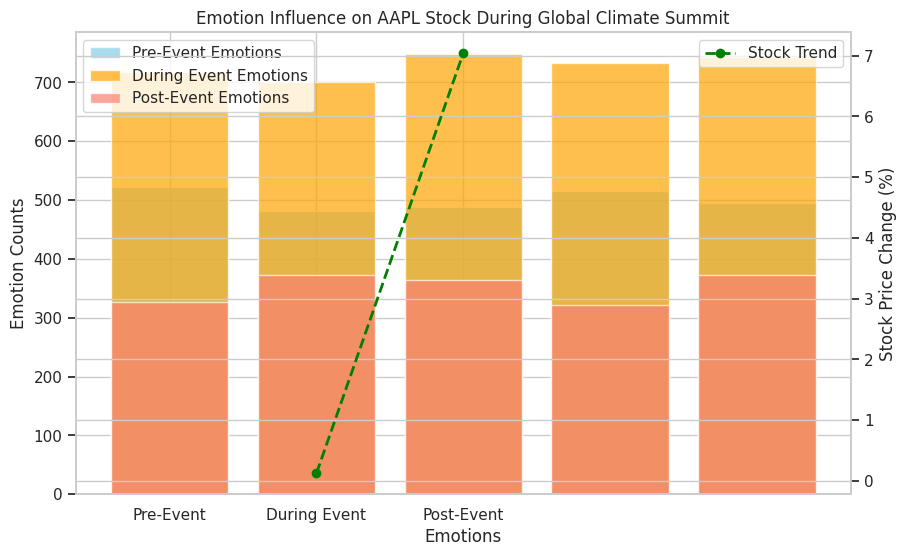

[*********************100%***********************]  1 of 1 completed

Analyzing Russian Invasion of Ukraine for AAPL...
Emotion and Stock Trend Analysis for Russian Invasion of Ukraine:
Pre-Event Emotions: Counter({'surprise': 384, 'anger': 368, 'sadness': 366, 'confusion': 361, 'happiness': 342})
During Event Emotions: Counter({'confusion': 8859, 'happiness': 8745, 'surprise': 8691, 'sadness': 8680, 'anger': 8601})
Post-Event Emotions: Counter({'surprise': 135, 'anger': 126, 'sadness': 121, 'happiness': 116, 'confusion': 114})
Stock Change Pre-Event: -3.64%
Stock Change During Event: -6.75%
Stock Change Post-Event: -6.13%



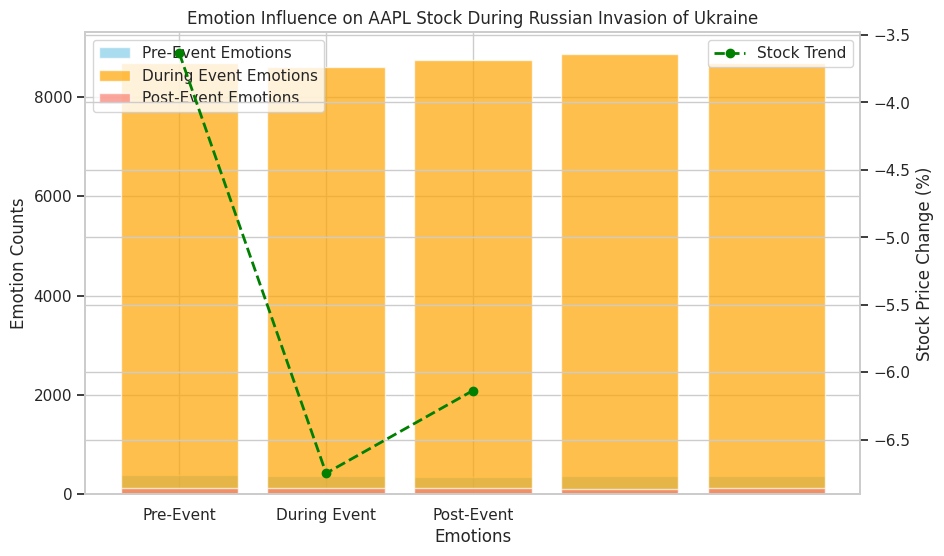

[*********************100%***********************]  1 of 1 completed

Analyzing US Supreme Court Overturning Roe vs Wade for AAPL...
Emotion and Stock Trend Analysis for US Supreme Court Overturning Roe vs Wade:
Pre-Event Emotions: Counter({'happiness': 201, 'anger': 192, 'confusion': 191, 'sadness': 182, 'surprise': 162})
During Event Emotions: Counter({'confusion': 35, 'happiness': 34, 'anger': 24, 'sadness': 20, 'surprise': 19})
Post-Event Emotions: Counter({'confusion': 196, 'anger': 187, 'sadness': 183, 'surprise': 180, 'happiness': 178})
Stock Change Pre-Event: 7.68%
Stock Change During Event: 0.00%
Stock Change Post-Event: -1.93%



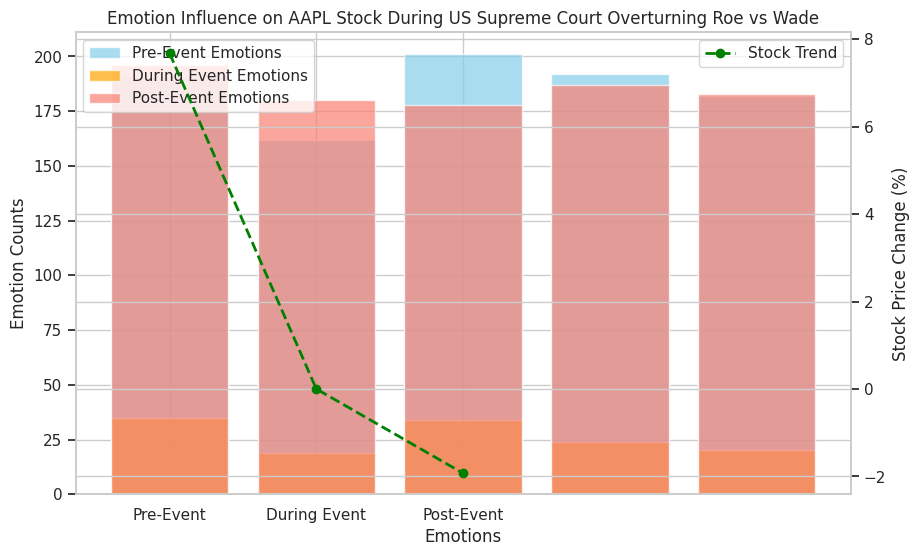

[*********************100%***********************]  1 of 1 completed

Analyzing UK Political Turmoil (Boris Johnson Resignation) for AAPL...
Emotion and Stock Trend Analysis for UK Political Turmoil (Boris Johnson Resignation):
Pre-Event Emotions: Counter({'anger': 207, 'confusion': 200, 'sadness': 199, 'happiness': 188, 'surprise': 184})
During Event Emotions: Counter({'confusion': 97, 'happiness': 85, 'surprise': 79, 'anger': 69, 'sadness': 69})
Post-Event Emotions: Counter({'sadness': 274, 'surprise': 270, 'confusion': 254, 'anger': 226, 'happiness': 220})
Stock Change Pre-Event: 7.04%
Stock Change During Event: 0.47%
Stock Change Post-Event: 2.13%



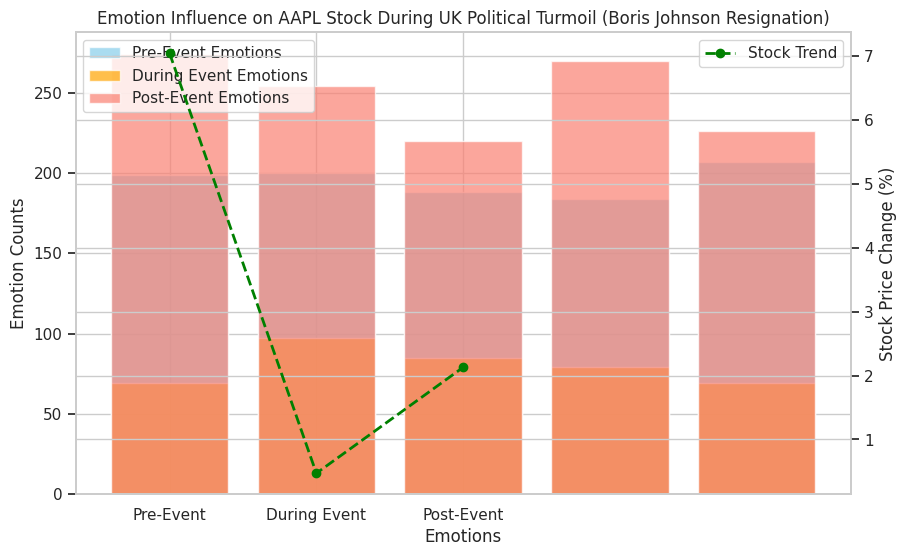

[*********************100%***********************]  1 of 1 completed

Analyzing Crypto Market Collapse for AAPL...
Emotion and Stock Trend Analysis for Crypto Market Collapse:
Pre-Event Emotions: Counter({'surprise': 613, 'sadness': 593, 'happiness': 593, 'anger': 590, 'confusion': 577})
During Event Emotions: Counter({'confusion': 1445, 'happiness': 1427, 'sadness': 1414, 'surprise': 1389, 'anger': 1355})
Post-Event Emotions: Counter({'surprise': 341, 'anger': 309, 'happiness': 309, 'confusion': 303, 'sadness': 285})
Stock Change Pre-Event: nan%
Stock Change During Event: -5.59%
Stock Change Post-Event: -1.81%



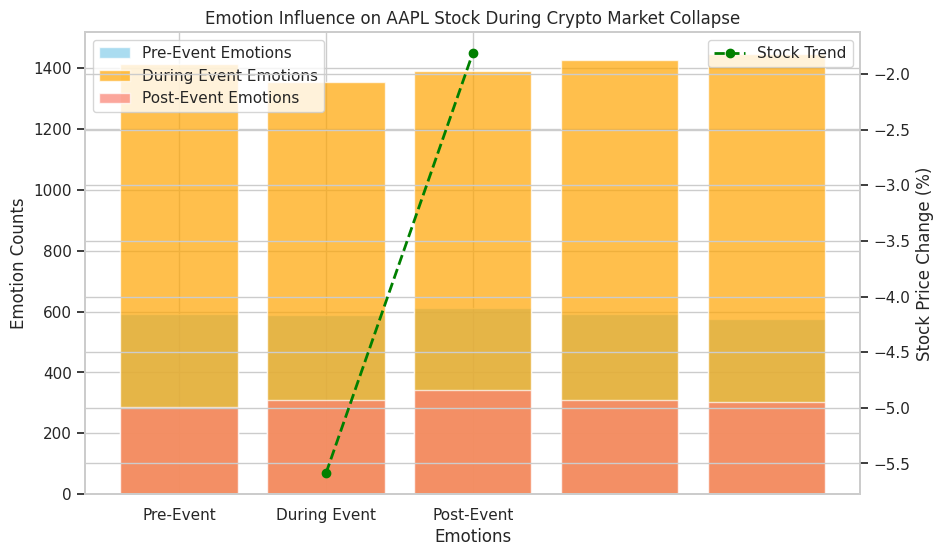

[*********************100%***********************]  1 of 1 completed

Analyzing 2022 Winter Olympics in Beijing for AAPL...
Emotion and Stock Trend Analysis for 2022 Winter Olympics in Beijing:
Pre-Event Emotions: Counter({'anger': 668, 'happiness': 661, 'surprise': 636, 'sadness': 635, 'confusion': 632})
During Event Emotions: Counter({'surprise': 847, 'confusion': 778, 'sadness': 770, 'anger': 732, 'happiness': 714})
Post-Event Emotions: Counter({'surprise': 356, 'confusion': 342, 'sadness': 332, 'anger': 330, 'happiness': 329})
Stock Change Pre-Event: 1.21%
Stock Change During Event: -2.95%
Stock Change Post-Event: -1.46%



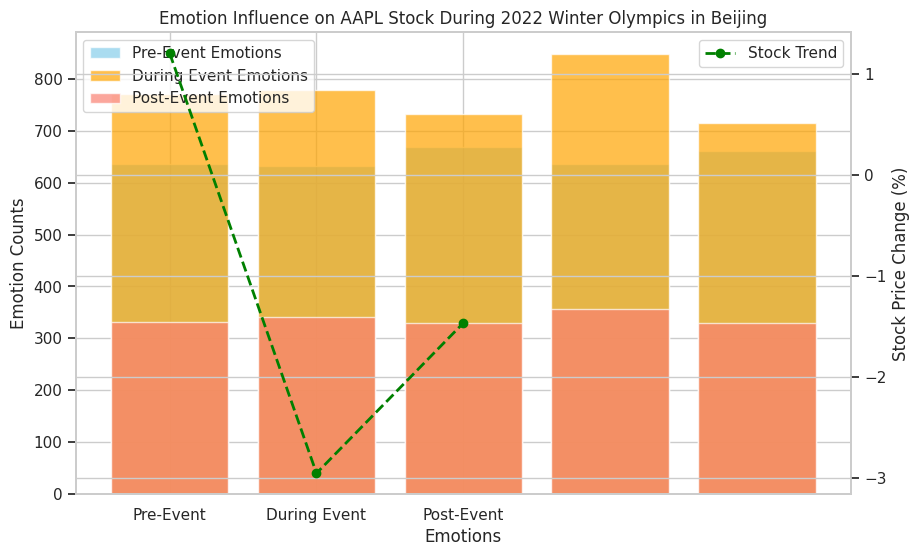

[*********************100%***********************]  1 of 1 completed

Analyzing Superbowl LVI for AAPL...
Emotion and Stock Trend Analysis for Superbowl LVI:
Pre-Event Emotions: Counter({'surprise': 373, 'confusion': 329, 'sadness': 317, 'anger': 302, 'happiness': 302})
During Event Emotions: Counter({'sadness': 27, 'confusion': 27, 'anger': 25, 'surprise': 24, 'happiness': 22})
Post-Event Emotions: Counter({'surprise': 391, 'sadness': 373, 'anger': 354, 'confusion': 351, 'happiness': 337})
Stock Change Pre-Event: nan%
Stock Change During Event: 0.14%
Stock Change Post-Event: -0.94%



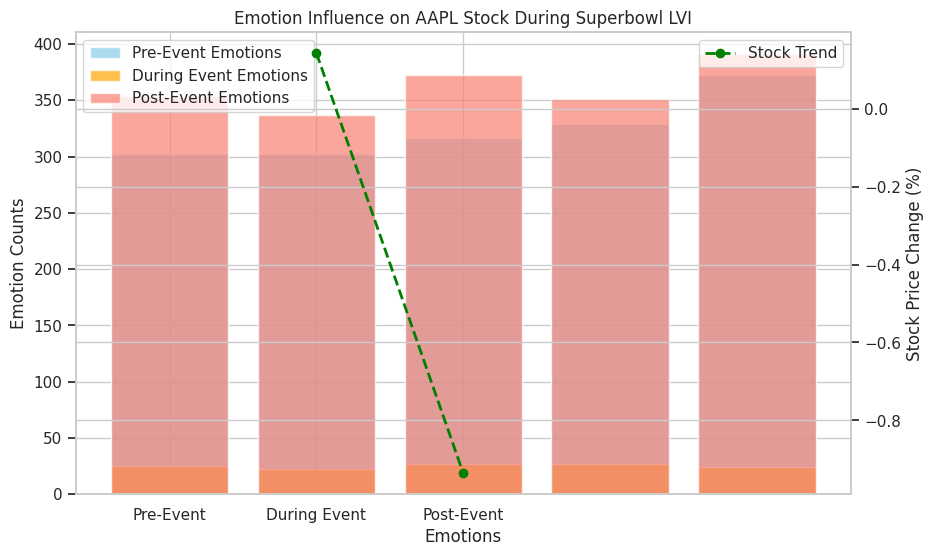

[*********************100%***********************]  1 of 1 completed

Analyzing Wimbledon 2022 for AAPL...
Emotion and Stock Trend Analysis for Wimbledon 2022:
Pre-Event Emotions: Counter({'confusion': 207, 'happiness': 192, 'anger': 188, 'sadness': 165, 'surprise': 165})
During Event Emotions: Counter({'confusion': 406, 'sadness': 391, 'happiness': 387, 'surprise': 376, 'anger': 371})
Post-Event Emotions: Counter({'sadness': 268, 'surprise': 258, 'confusion': 250, 'anger': 219, 'happiness': 218})
Stock Change Pre-Event: nan%
Stock Change During Event: 3.80%
Stock Change Post-Event: 2.13%



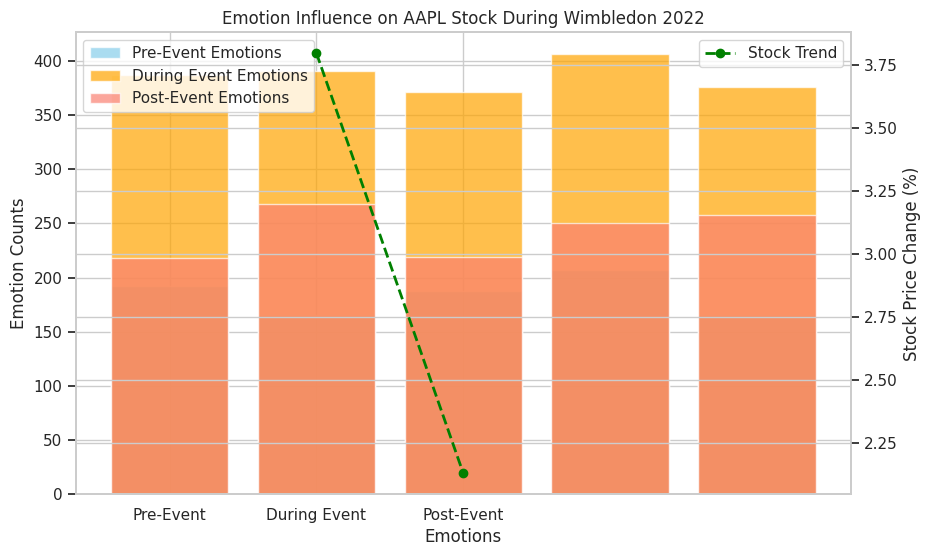

[*********************100%***********************]  1 of 1 completed

Analyzing Global Climate Summit for MSFT...
Emotion and Stock Trend Analysis for Global Climate Summit:
Pre-Event Emotions: Counter({'confusion': 523, 'sadness': 516, 'happiness': 495, 'anger': 489, 'surprise': 481})
During Event Emotions: Counter({'anger': 748, 'happiness': 744, 'sadness': 733, 'confusion': 717, 'surprise': 700})
Post-Event Emotions: Counter({'happiness': 373, 'surprise': 372, 'anger': 365, 'confusion': 326, 'sadness': 321})
Stock Change Pre-Event: nan%
Stock Change During Event: 1.54%
Stock Change Post-Event: 1.90%



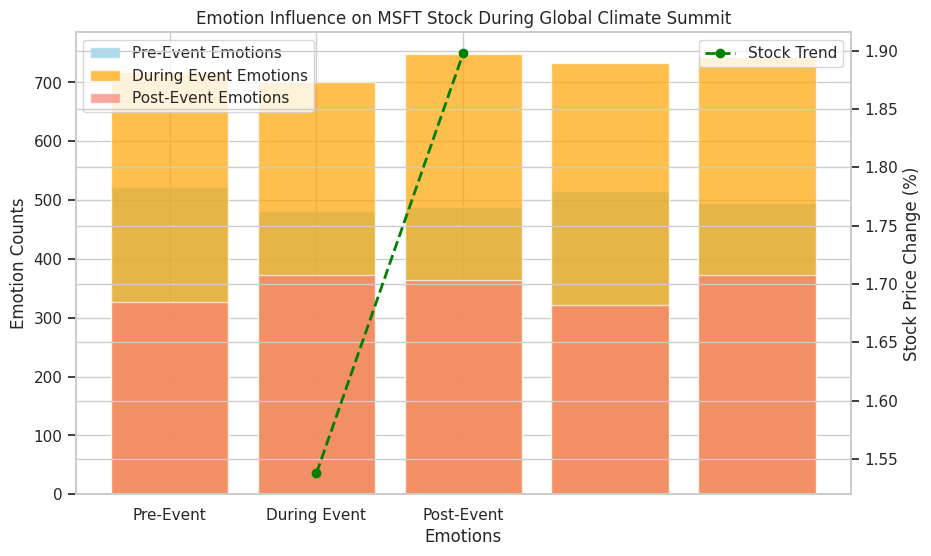

[*********************100%***********************]  1 of 1 completed

Analyzing Russian Invasion of Ukraine for MSFT...
Emotion and Stock Trend Analysis for Russian Invasion of Ukraine:
Pre-Event Emotions: Counter({'surprise': 384, 'anger': 368, 'sadness': 366, 'confusion': 361, 'happiness': 342})
During Event Emotions: Counter({'confusion': 8859, 'happiness': 8745, 'surprise': 8691, 'sadness': 8680, 'anger': 8601})
Post-Event Emotions: Counter({'surprise': 135, 'anger': 126, 'sadness': 121, 'happiness': 116, 'confusion': 114})
Stock Change Pre-Event: 1.33%
Stock Change During Event: -19.75%
Stock Change Post-Event: 1.83%



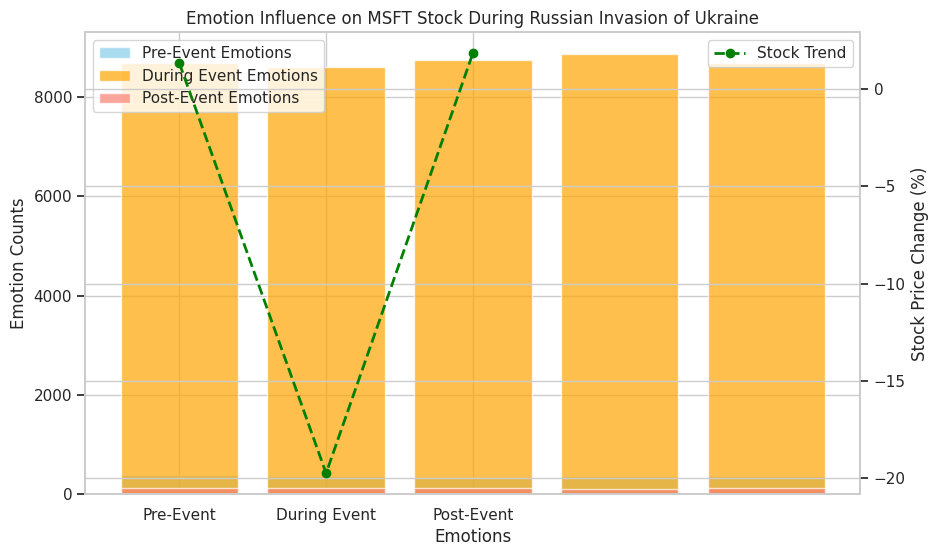

[*********************100%***********************]  1 of 1 completed

Analyzing US Supreme Court Overturning Roe vs Wade for MSFT...
Emotion and Stock Trend Analysis for US Supreme Court Overturning Roe vs Wade:
Pre-Event Emotions: Counter({'happiness': 201, 'anger': 192, 'confusion': 191, 'sadness': 182, 'surprise': 162})
During Event Emotions: Counter({'confusion': 35, 'happiness': 34, 'anger': 24, 'sadness': 20, 'surprise': 19})
Post-Event Emotions: Counter({'confusion': 196, 'anger': 187, 'sadness': 183, 'surprise': 180, 'happiness': 178})
Stock Change Pre-Event: 8.10%
Stock Change During Event: 0.00%
Stock Change Post-Event: -3.03%



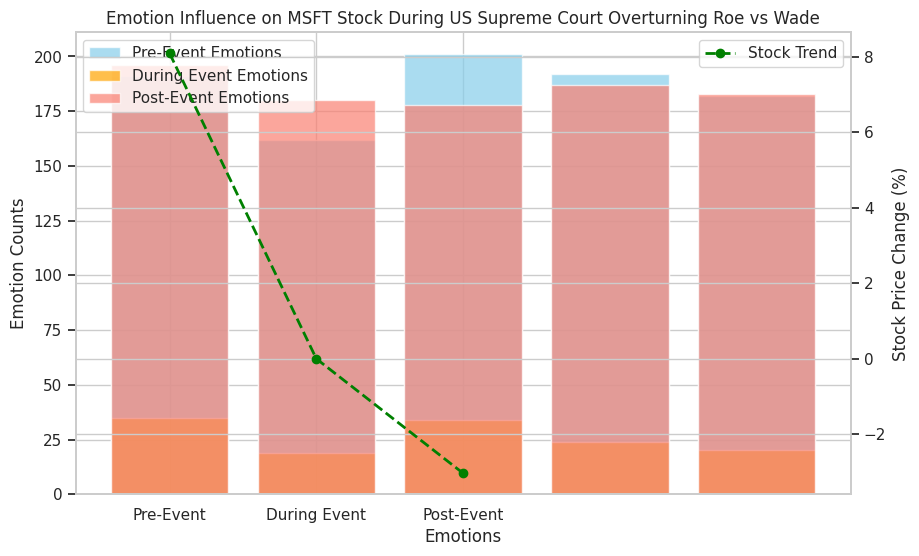

[*********************100%***********************]  1 of 1 completed

Analyzing UK Political Turmoil (Boris Johnson Resignation) for MSFT...
Emotion and Stock Trend Analysis for UK Political Turmoil (Boris Johnson Resignation):
Pre-Event Emotions: Counter({'anger': 207, 'confusion': 200, 'sadness': 199, 'happiness': 188, 'surprise': 184})
During Event Emotions: Counter({'confusion': 97, 'happiness': 85, 'surprise': 79, 'anger': 69, 'sadness': 69})
Post-Event Emotions: Counter({'sadness': 274, 'surprise': 270, 'confusion': 254, 'anger': 226, 'happiness': 220})
Stock Change Pre-Event: 4.50%
Stock Change During Event: -0.28%
Stock Change Post-Event: -4.09%



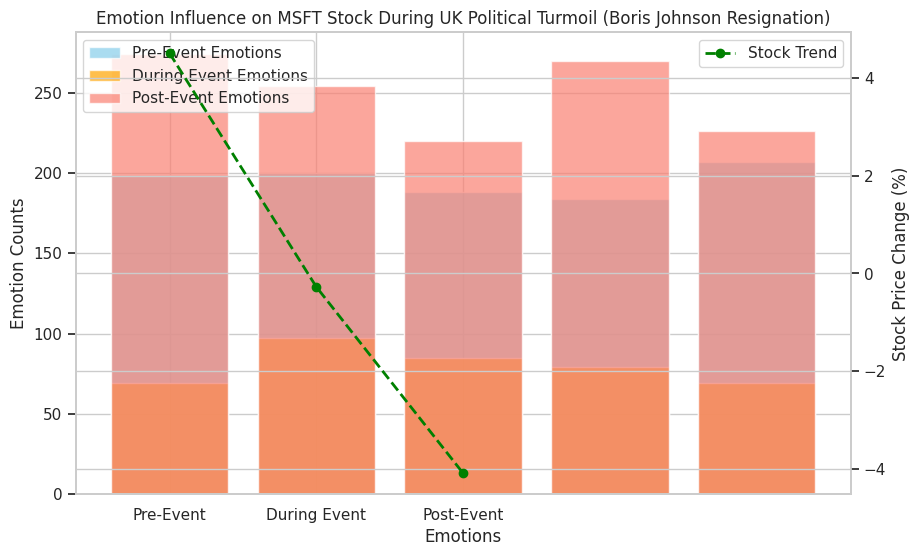

[*********************100%***********************]  1 of 1 completed

Analyzing Crypto Market Collapse for MSFT...
Emotion and Stock Trend Analysis for Crypto Market Collapse:
Pre-Event Emotions: Counter({'surprise': 613, 'sadness': 593, 'happiness': 593, 'anger': 590, 'confusion': 577})
During Event Emotions: Counter({'confusion': 1445, 'happiness': 1427, 'sadness': 1414, 'surprise': 1389, 'anger': 1355})
Post-Event Emotions: Counter({'surprise': 341, 'anger': 309, 'happiness': 309, 'confusion': 303, 'sadness': 285})
Stock Change Pre-Event: nan%
Stock Change During Event: -2.04%
Stock Change Post-Event: -1.15%



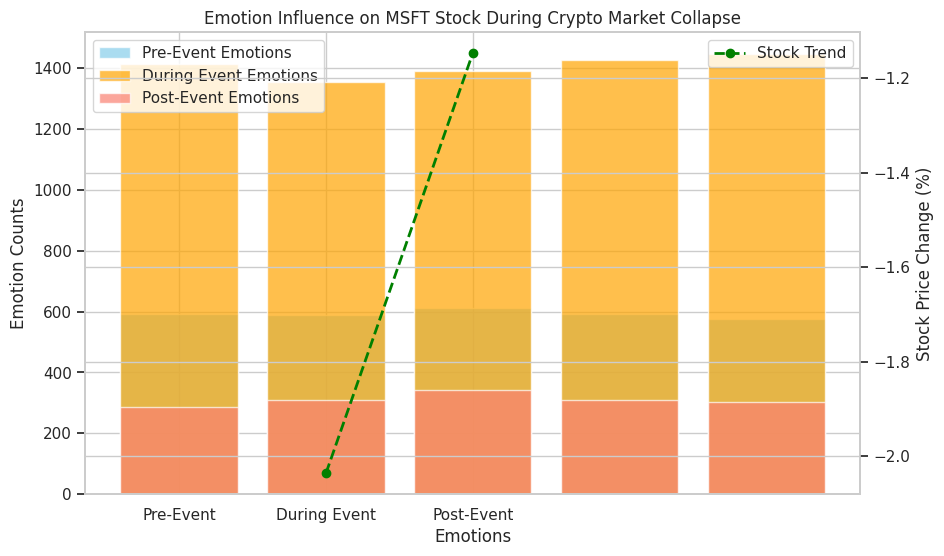

[*********************100%***********************]  1 of 1 completed

Analyzing 2022 Winter Olympics in Beijing for MSFT...
Emotion and Stock Trend Analysis for 2022 Winter Olympics in Beijing:
Pre-Event Emotions: Counter({'anger': 668, 'happiness': 661, 'surprise': 636, 'sadness': 635, 'confusion': 632})
During Event Emotions: Counter({'surprise': 847, 'confusion': 778, 'sadness': 770, 'anger': 732, 'happiness': 714})
Post-Event Emotions: Counter({'surprise': 356, 'confusion': 342, 'sadness': 332, 'anger': 330, 'happiness': 329})
Stock Change Pre-Event: -0.75%
Stock Change During Event: -5.89%
Stock Change Post-Event: 3.26%



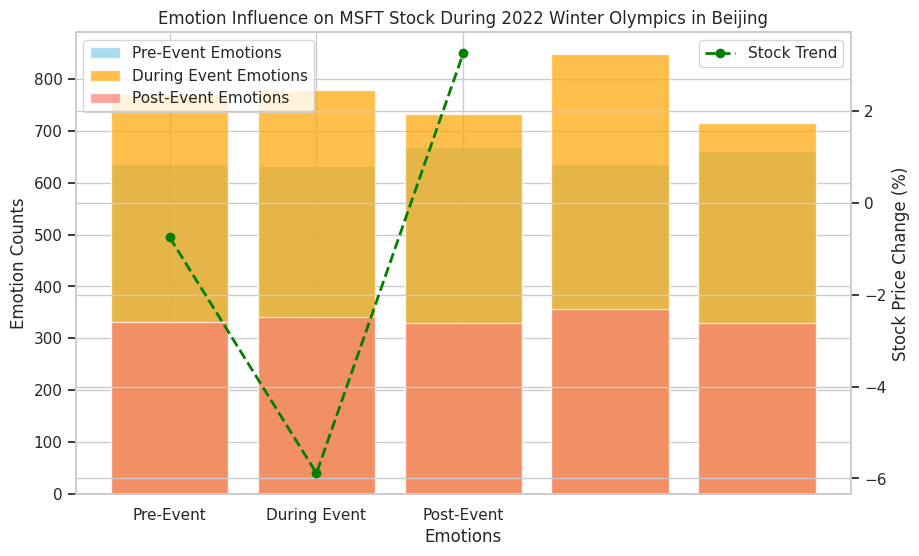

[*********************100%***********************]  1 of 1 completed

Analyzing Superbowl LVI for MSFT...
Emotion and Stock Trend Analysis for Superbowl LVI:
Pre-Event Emotions: Counter({'surprise': 373, 'confusion': 329, 'sadness': 317, 'anger': 302, 'happiness': 302})
During Event Emotions: Counter({'sadness': 27, 'confusion': 27, 'anger': 25, 'surprise': 24, 'happiness': 22})
Post-Event Emotions: Counter({'surprise': 391, 'sadness': 373, 'anger': 354, 'confusion': 351, 'happiness': 337})
Stock Change Pre-Event: nan%
Stock Change During Event: -0.01%
Stock Change Post-Event: -2.40%



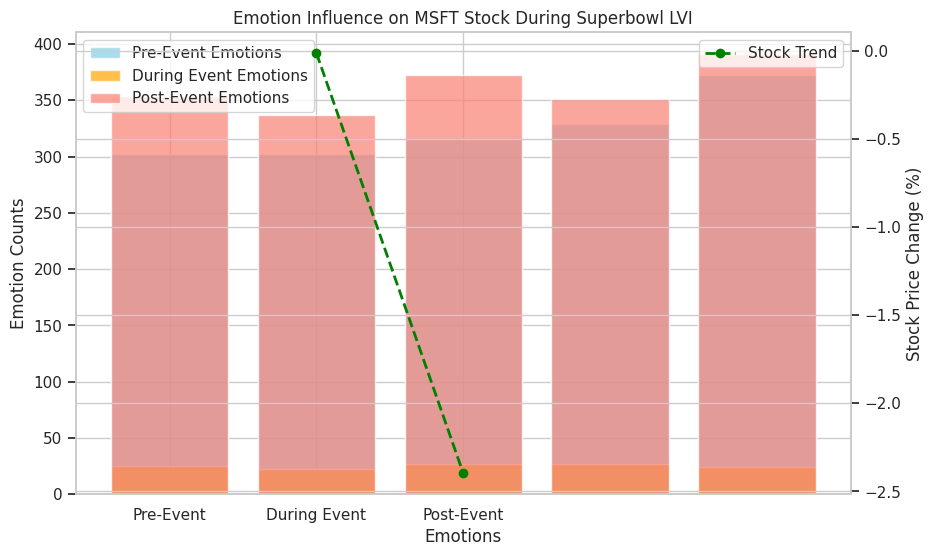

[*********************100%***********************]  1 of 1 completed

Analyzing Wimbledon 2022 for MSFT...
Emotion and Stock Trend Analysis for Wimbledon 2022:
Pre-Event Emotions: Counter({'confusion': 207, 'happiness': 192, 'anger': 188, 'sadness': 165, 'surprise': 165})
During Event Emotions: Counter({'confusion': 406, 'sadness': 391, 'happiness': 387, 'surprise': 376, 'anger': 371})
Post-Event Emotions: Counter({'sadness': 268, 'surprise': 258, 'confusion': 250, 'anger': 219, 'happiness': 218})
Stock Change Pre-Event: nan%
Stock Change During Event: 1.05%
Stock Change Post-Event: -4.09%



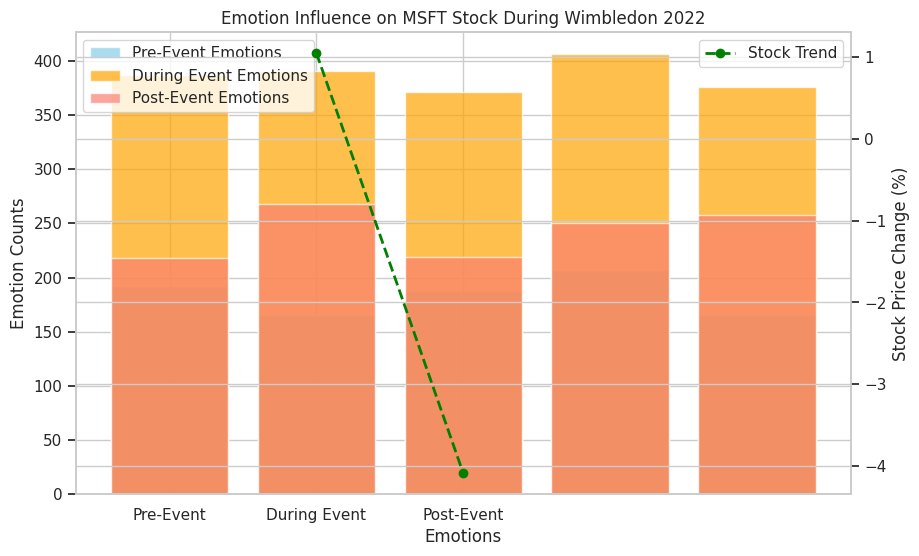

[*********************100%***********************]  1 of 1 completed

Analyzing Global Climate Summit for TSLA...
Emotion and Stock Trend Analysis for Global Climate Summit:
Pre-Event Emotions: Counter({'confusion': 523, 'sadness': 516, 'happiness': 495, 'anger': 489, 'surprise': 481})
During Event Emotions: Counter({'anger': 748, 'happiness': 744, 'sadness': 733, 'confusion': 717, 'surprise': 700})
Post-Event Emotions: Counter({'happiness': 373, 'surprise': 372, 'anger': 365, 'confusion': 326, 'sadness': 321})
Stock Change Pre-Event: nan%
Stock Change During Event: -7.23%
Stock Change Post-Event: 10.03%



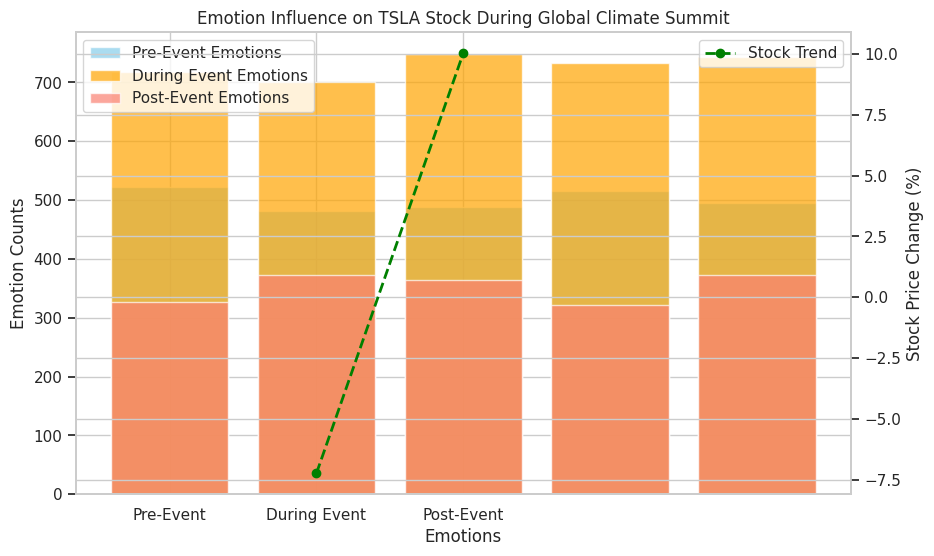

[*********************100%***********************]  1 of 1 completed

Analyzing Russian Invasion of Ukraine for TSLA...
Emotion and Stock Trend Analysis for Russian Invasion of Ukraine:
Pre-Event Emotions: Counter({'surprise': 384, 'anger': 368, 'sadness': 366, 'confusion': 361, 'happiness': 342})
During Event Emotions: Counter({'confusion': 8859, 'happiness': 8745, 'surprise': 8691, 'sadness': 8680, 'anger': 8601})
Post-Event Emotions: Counter({'surprise': 135, 'anger': 126, 'sadness': 121, 'happiness': 116, 'confusion': 114})
Stock Change Pre-Event: -8.62%
Stock Change During Event: 6.00%
Stock Change Post-Event: -14.33%



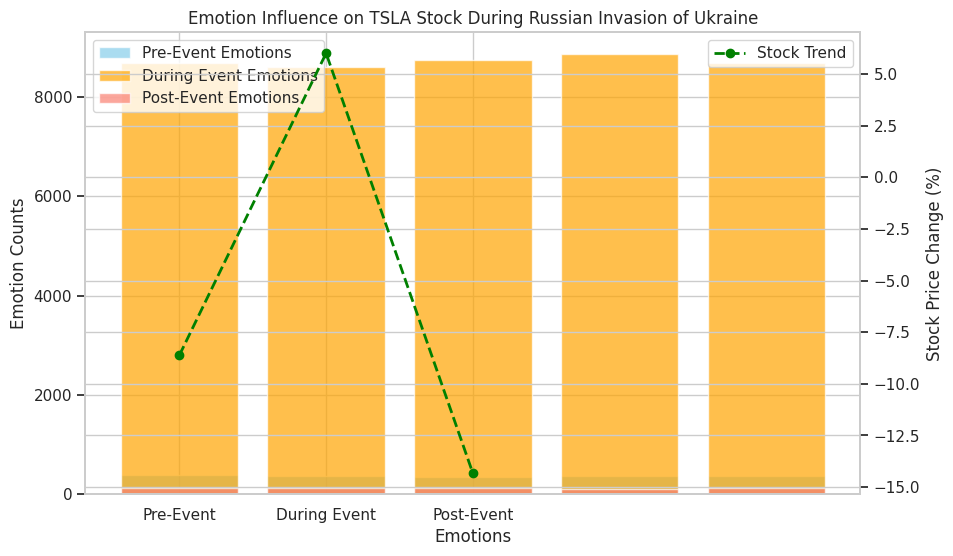

[*********************100%***********************]  1 of 1 completed

Analyzing US Supreme Court Overturning Roe vs Wade for TSLA...
Emotion and Stock Trend Analysis for US Supreme Court Overturning Roe vs Wade:
Pre-Event Emotions: Counter({'happiness': 201, 'anger': 192, 'confusion': 191, 'sadness': 182, 'surprise': 162})
During Event Emotions: Counter({'confusion': 35, 'happiness': 34, 'anger': 24, 'sadness': 20, 'surprise': 19})
Post-Event Emotions: Counter({'confusion': 196, 'anger': 187, 'sadness': 183, 'surprise': 180, 'happiness': 178})
Stock Change Pre-Event: 13.35%
Stock Change During Event: 0.00%
Stock Change Post-Event: -7.51%



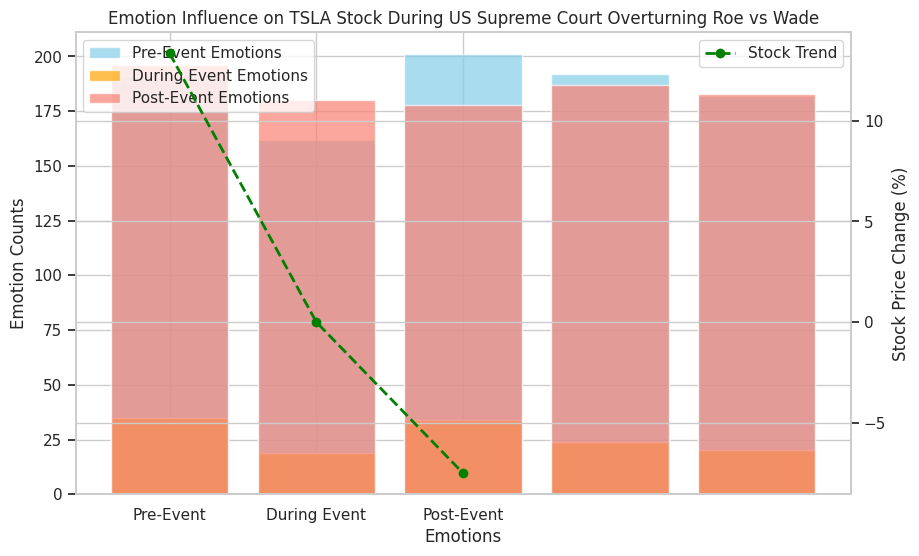

[*********************100%***********************]  1 of 1 completed

Analyzing UK Political Turmoil (Boris Johnson Resignation) for TSLA...
Emotion and Stock Trend Analysis for UK Political Turmoil (Boris Johnson Resignation):
Pre-Event Emotions: Counter({'anger': 207, 'confusion': 200, 'sadness': 199, 'happiness': 188, 'surprise': 184})
During Event Emotions: Counter({'confusion': 97, 'happiness': 85, 'surprise': 79, 'anger': 69, 'sadness': 69})
Post-Event Emotions: Counter({'sadness': 274, 'surprise': 270, 'confusion': 254, 'anger': 226, 'happiness': 220})
Stock Change Pre-Event: 8.94%
Stock Change During Event: 2.54%
Stock Change Post-Event: -4.27%



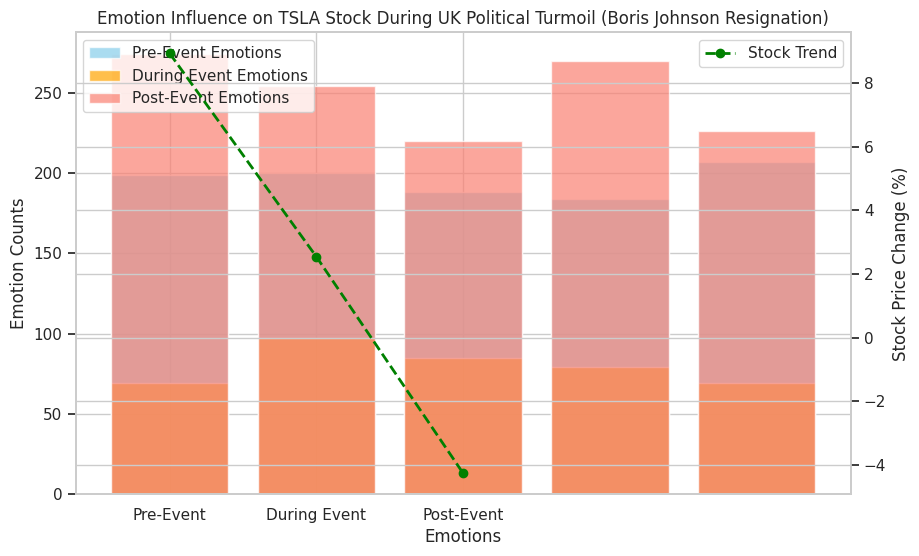

[*********************100%***********************]  1 of 1 completed

Analyzing Crypto Market Collapse for TSLA...
Emotion and Stock Trend Analysis for Crypto Market Collapse:
Pre-Event Emotions: Counter({'surprise': 613, 'sadness': 593, 'happiness': 593, 'anger': 590, 'confusion': 577})
During Event Emotions: Counter({'confusion': 1445, 'happiness': 1427, 'sadness': 1414, 'surprise': 1389, 'anger': 1355})
Post-Event Emotions: Counter({'surprise': 341, 'anger': 309, 'happiness': 309, 'confusion': 303, 'sadness': 285})
Stock Change Pre-Event: nan%
Stock Change During Event: -12.92%
Stock Change Post-Event: -5.73%



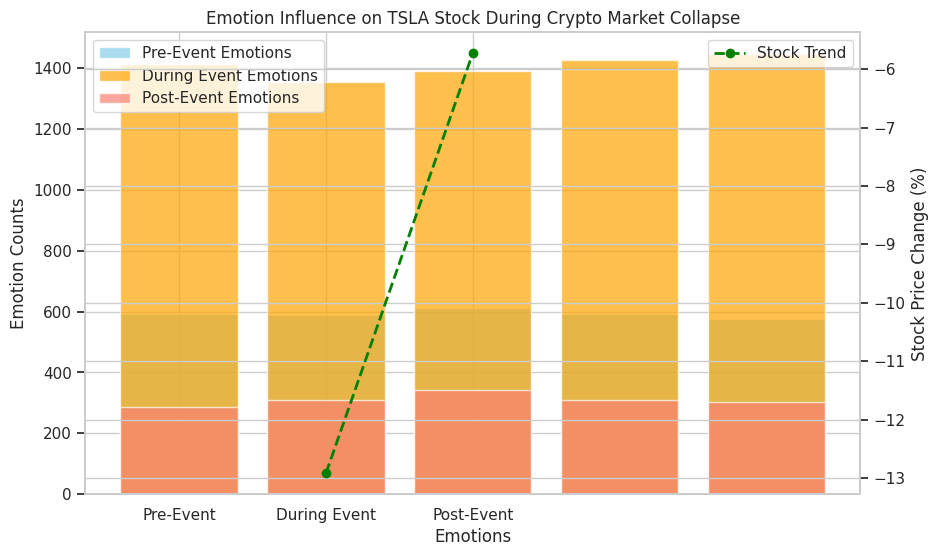

[*********************100%***********************]  1 of 1 completed

Analyzing 2022 Winter Olympics in Beijing for TSLA...
Emotion and Stock Trend Analysis for 2022 Winter Olympics in Beijing:
Pre-Event Emotions: Counter({'anger': 668, 'happiness': 661, 'surprise': 636, 'sadness': 635, 'confusion': 632})
During Event Emotions: Counter({'surprise': 847, 'confusion': 778, 'sadness': 770, 'anger': 732, 'happiness': 714})
Post-Event Emotions: Counter({'surprise': 356, 'confusion': 342, 'sadness': 332, 'anger': 330, 'happiness': 329})
Stock Change Pre-Event: 9.09%
Stock Change During Event: -7.18%
Stock Change Post-Event: -5.50%



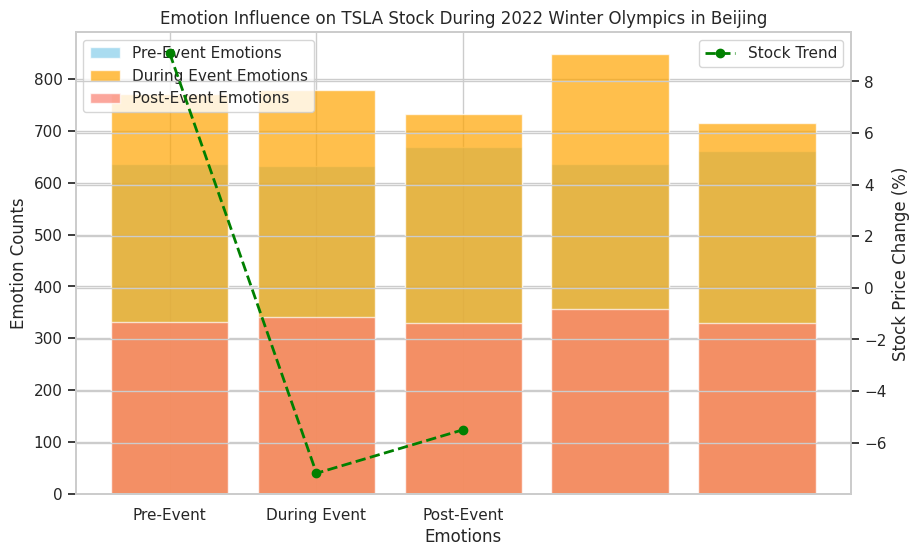

[*********************100%***********************]  1 of 1 completed

Analyzing Superbowl LVI for TSLA...
Emotion and Stock Trend Analysis for Superbowl LVI:
Pre-Event Emotions: Counter({'surprise': 373, 'confusion': 329, 'sadness': 317, 'anger': 302, 'happiness': 302})
During Event Emotions: Counter({'sadness': 27, 'confusion': 27, 'anger': 25, 'surprise': 24, 'happiness': 22})
Post-Event Emotions: Counter({'surprise': 391, 'sadness': 373, 'anger': 354, 'confusion': 351, 'happiness': 337})
Stock Change Pre-Event: nan%
Stock Change During Event: 1.83%
Stock Change Post-Event: -2.14%



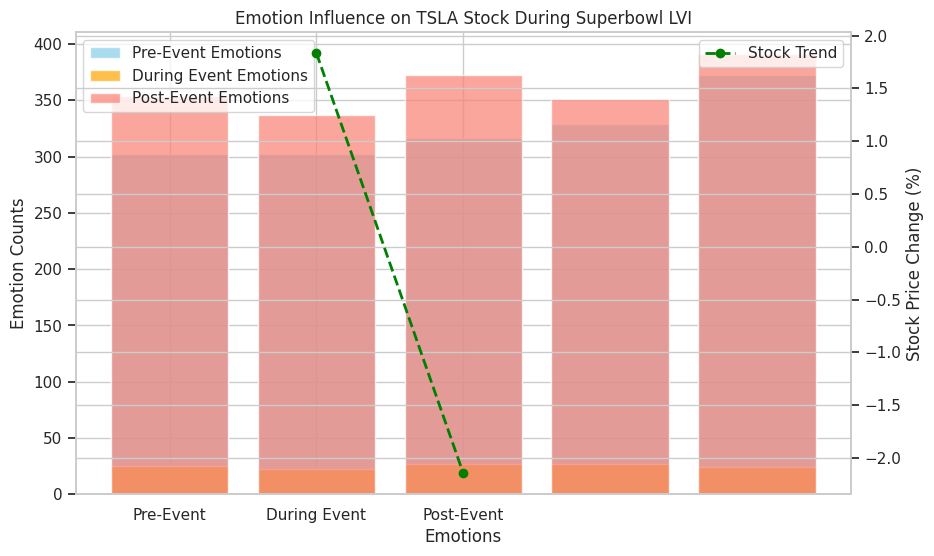

[*********************100%***********************]  1 of 1 completed

Analyzing Wimbledon 2022 for TSLA...
Emotion and Stock Trend Analysis for Wimbledon 2022:
Pre-Event Emotions: Counter({'confusion': 207, 'happiness': 192, 'anger': 188, 'sadness': 165, 'surprise': 165})
During Event Emotions: Counter({'confusion': 406, 'sadness': 391, 'happiness': 387, 'surprise': 376, 'anger': 371})
Post-Event Emotions: Counter({'sadness': 268, 'surprise': 258, 'confusion': 250, 'anger': 219, 'happiness': 218})
Stock Change Pre-Event: nan%
Stock Change During Event: 2.39%
Stock Change Post-Event: -4.27%



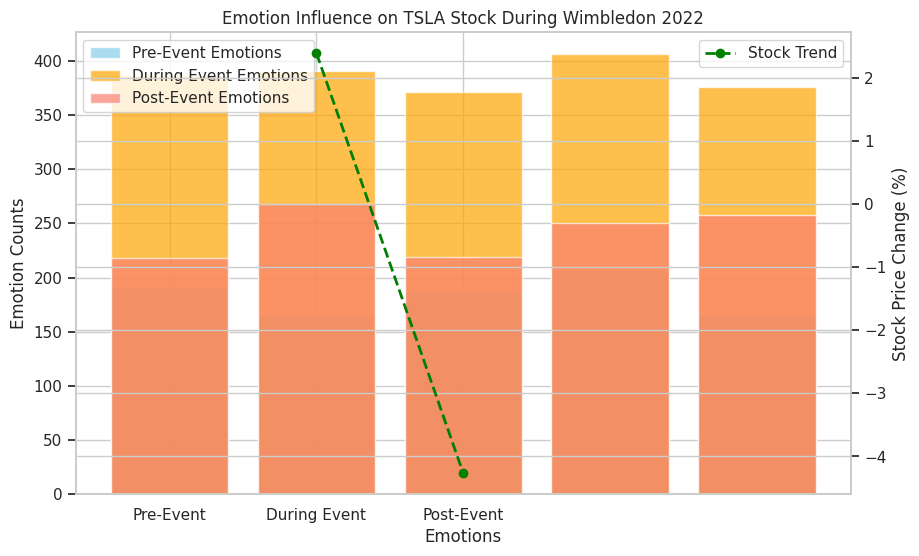

[*********************100%***********************]  1 of 1 completed

Analyzing Global Climate Summit for GOOG...
Emotion and Stock Trend Analysis for Global Climate Summit:
Pre-Event Emotions: Counter({'confusion': 523, 'sadness': 516, 'happiness': 495, 'anger': 489, 'surprise': 481})
During Event Emotions: Counter({'anger': 748, 'happiness': 744, 'sadness': 733, 'confusion': 717, 'surprise': 700})
Post-Event Emotions: Counter({'happiness': 373, 'surprise': 372, 'anger': 365, 'confusion': 326, 'sadness': 321})
Stock Change Pre-Event: nan%
Stock Change During Event: 0.93%
Stock Change Post-Event: 0.21%



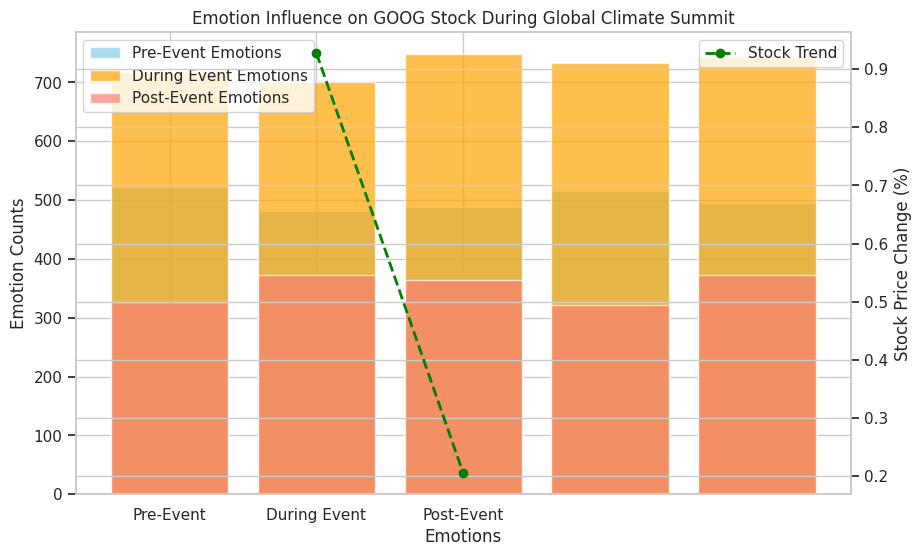

[*********************100%***********************]  1 of 1 completed

Analyzing Russian Invasion of Ukraine for GOOG...
Emotion and Stock Trend Analysis for Russian Invasion of Ukraine:
Pre-Event Emotions: Counter({'surprise': 384, 'anger': 368, 'sadness': 366, 'confusion': 361, 'happiness': 342})
During Event Emotions: Counter({'confusion': 8859, 'happiness': 8745, 'surprise': 8691, 'sadness': 8680, 'anger': 8601})
Post-Event Emotions: Counter({'surprise': 135, 'anger': 126, 'sadness': 121, 'happiness': 116, 'confusion': 114})
Stock Change Pre-Event: 0.28%
Stock Change During Event: -26.07%
Stock Change Post-Event: 1.23%



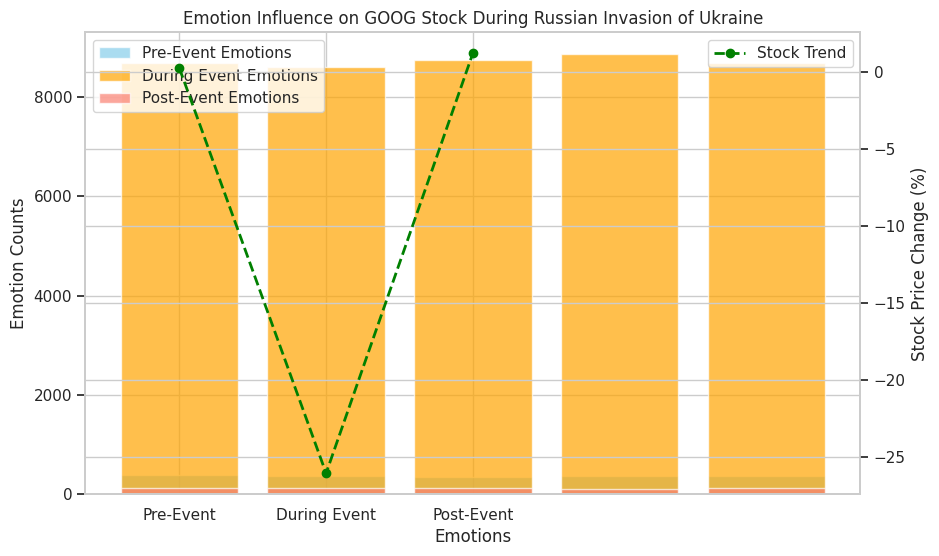

[*********************100%***********************]  1 of 1 completed

Analyzing US Supreme Court Overturning Roe vs Wade for GOOG...
Emotion and Stock Trend Analysis for US Supreme Court Overturning Roe vs Wade:
Pre-Event Emotions: Counter({'happiness': 201, 'anger': 192, 'confusion': 191, 'sadness': 182, 'surprise': 162})
During Event Emotions: Counter({'confusion': 35, 'happiness': 34, 'anger': 24, 'sadness': 20, 'surprise': 19})
Post-Event Emotions: Counter({'confusion': 196, 'anger': 187, 'sadness': 183, 'surprise': 180, 'happiness': 178})
Stock Change Pre-Event: 9.89%
Stock Change During Event: 0.00%
Stock Change Post-Event: -7.98%



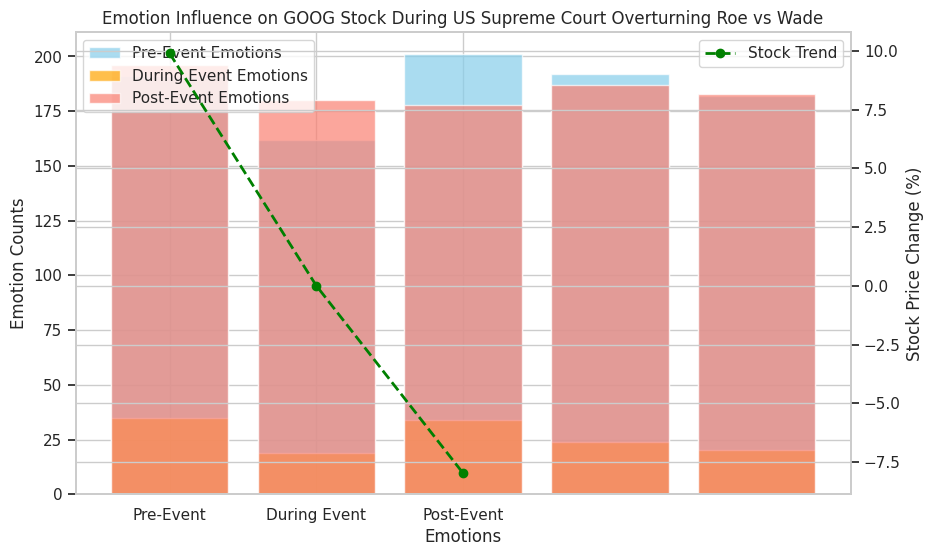

[*********************100%***********************]  1 of 1 completed

Analyzing UK Political Turmoil (Boris Johnson Resignation) for GOOG...
Emotion and Stock Trend Analysis for UK Political Turmoil (Boris Johnson Resignation):
Pre-Event Emotions: Counter({'anger': 207, 'confusion': 200, 'sadness': 199, 'happiness': 188, 'surprise': 184})
During Event Emotions: Counter({'confusion': 97, 'happiness': 85, 'surprise': 79, 'anger': 69, 'sadness': 69})
Post-Event Emotions: Counter({'sadness': 274, 'surprise': 270, 'confusion': 254, 'anger': 226, 'happiness': 220})
Stock Change Pre-Event: 9.08%
Stock Change During Event: 0.72%
Stock Change Post-Event: -6.16%



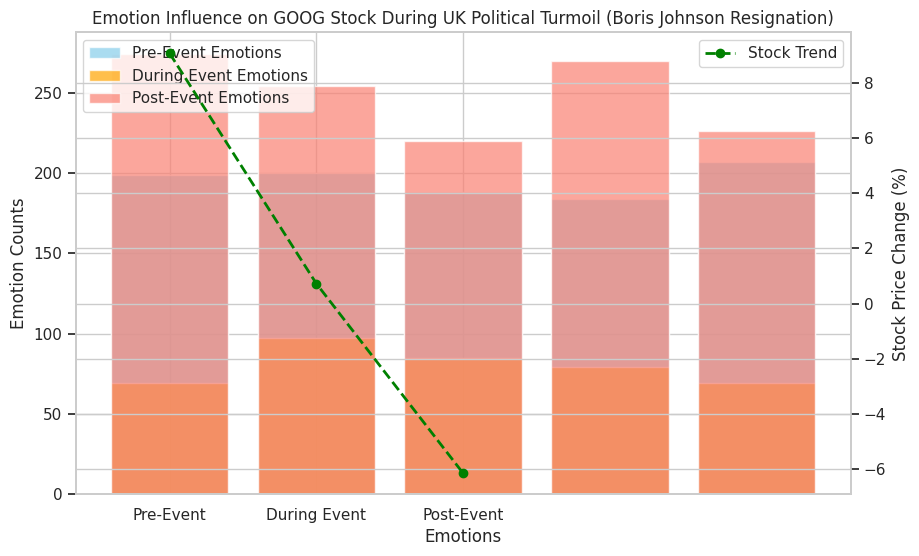

[*********************100%***********************]  1 of 1 completed

Analyzing Crypto Market Collapse for GOOG...
Emotion and Stock Trend Analysis for Crypto Market Collapse:
Pre-Event Emotions: Counter({'surprise': 613, 'sadness': 593, 'happiness': 593, 'anger': 590, 'confusion': 577})
During Event Emotions: Counter({'confusion': 1445, 'happiness': 1427, 'sadness': 1414, 'surprise': 1389, 'anger': 1355})
Post-Event Emotions: Counter({'surprise': 341, 'anger': 309, 'happiness': 309, 'confusion': 303, 'sadness': 285})
Stock Change Pre-Event: nan%
Stock Change During Event: -0.81%
Stock Change Post-Event: 2.61%



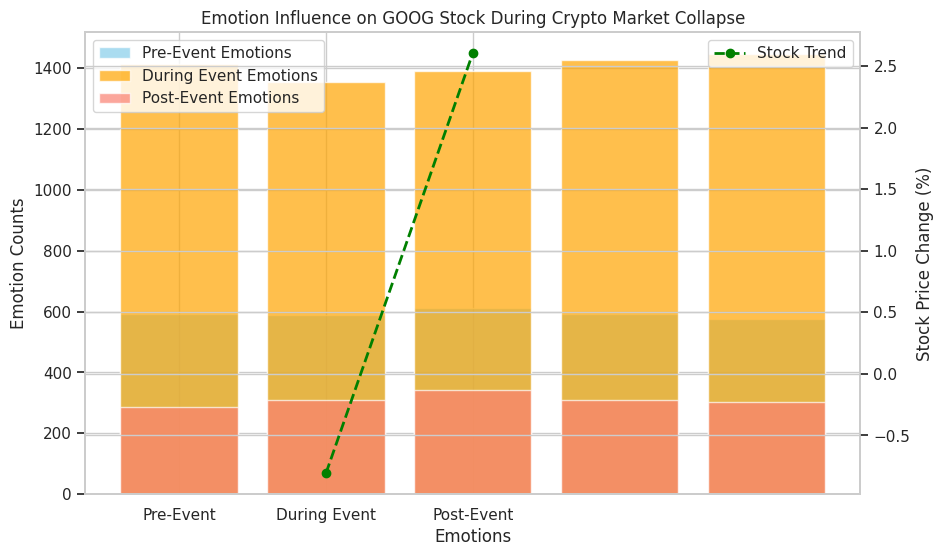

[*********************100%***********************]  1 of 1 completed

Analyzing 2022 Winter Olympics in Beijing for GOOG...
Emotion and Stock Trend Analysis for 2022 Winter Olympics in Beijing:
Pre-Event Emotions: Counter({'anger': 668, 'happiness': 661, 'surprise': 636, 'sadness': 635, 'confusion': 632})
During Event Emotions: Counter({'surprise': 847, 'confusion': 778, 'sadness': 770, 'anger': 732, 'happiness': 714})
Post-Event Emotions: Counter({'surprise': 356, 'confusion': 342, 'sadness': 332, 'anger': 330, 'happiness': 329})
Stock Change Pre-Event: 7.30%
Stock Change During Event: -8.77%
Stock Change Post-Event: 3.11%



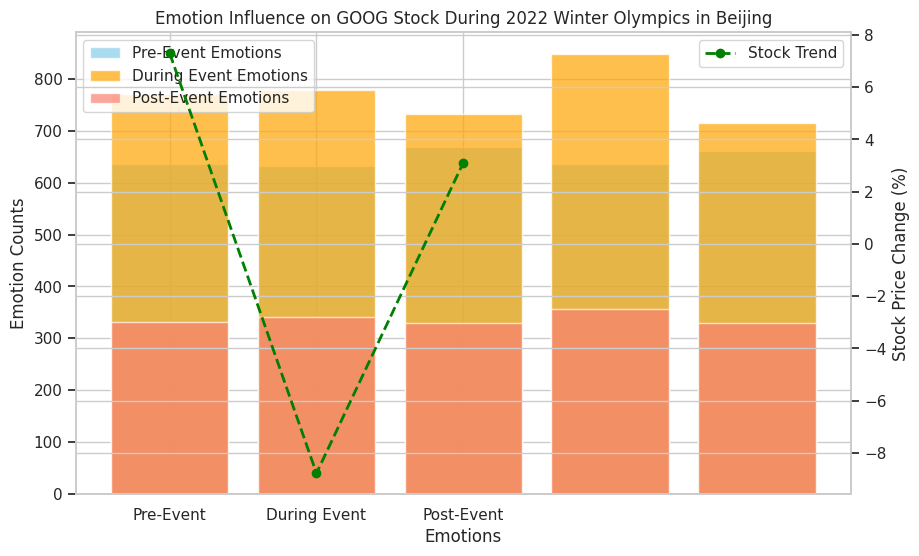

[*********************100%***********************]  1 of 1 completed

Analyzing Superbowl LVI for GOOG...
Emotion and Stock Trend Analysis for Superbowl LVI:
Pre-Event Emotions: Counter({'surprise': 373, 'confusion': 329, 'sadness': 317, 'anger': 302, 'happiness': 302})
During Event Emotions: Counter({'sadness': 27, 'confusion': 27, 'anger': 25, 'surprise': 24, 'happiness': 22})
Post-Event Emotions: Counter({'surprise': 391, 'sadness': 373, 'anger': 354, 'confusion': 351, 'happiness': 337})
Stock Change Pre-Event: nan%
Stock Change During Event: 0.87%
Stock Change Post-Event: -3.57%



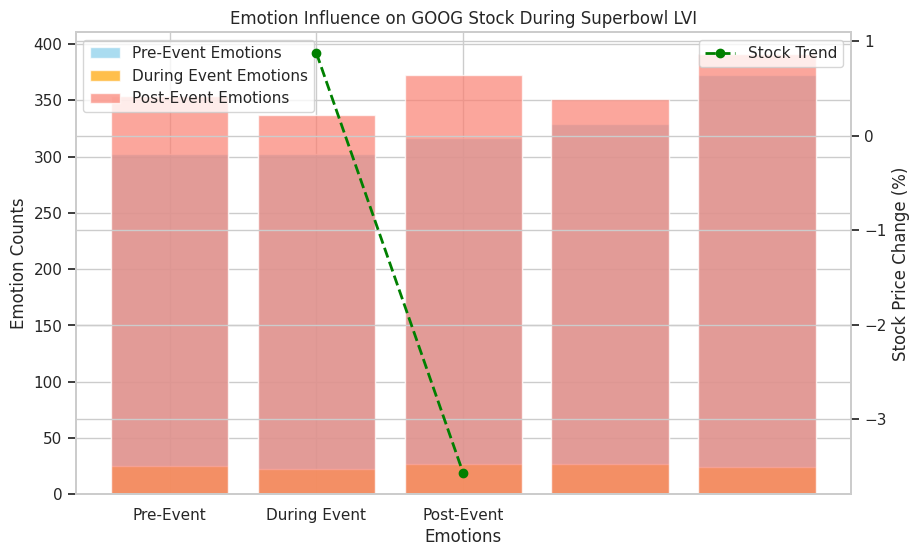

[*********************100%***********************]  1 of 1 completed

Analyzing Wimbledon 2022 for GOOG...
Emotion and Stock Trend Analysis for Wimbledon 2022:
Pre-Event Emotions: Counter({'confusion': 207, 'happiness': 192, 'anger': 188, 'sadness': 165, 'surprise': 165})
During Event Emotions: Counter({'confusion': 406, 'sadness': 391, 'happiness': 387, 'surprise': 376, 'anger': 371})
Post-Event Emotions: Counter({'sadness': 268, 'surprise': 258, 'confusion': 250, 'anger': 219, 'happiness': 218})
Stock Change Pre-Event: nan%
Stock Change During Event: 3.04%
Stock Change Post-Event: -6.16%



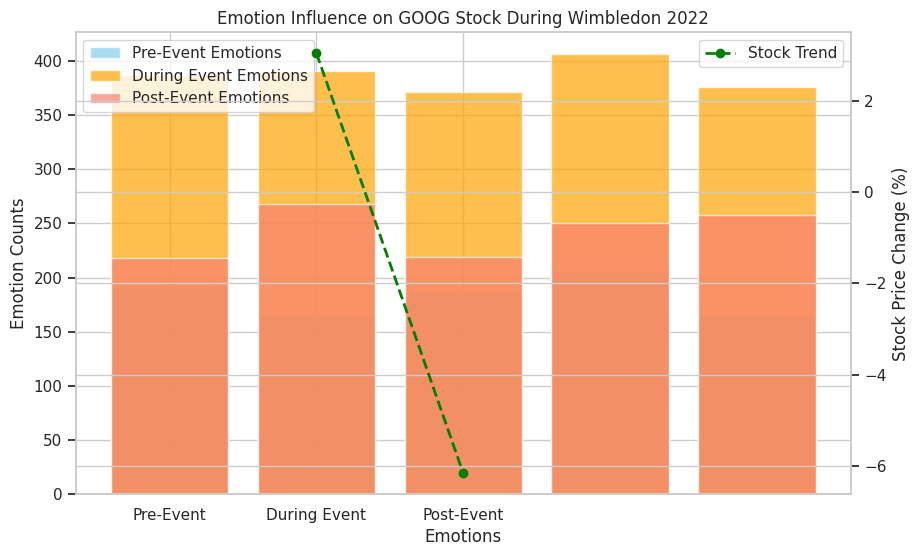

[*********************100%***********************]  1 of 1 completed

Analyzing Global Climate Summit for VZ...
Emotion and Stock Trend Analysis for Global Climate Summit:
Pre-Event Emotions: Counter({'confusion': 523, 'sadness': 516, 'happiness': 495, 'anger': 489, 'surprise': 481})
During Event Emotions: Counter({'anger': 748, 'happiness': 744, 'sadness': 733, 'confusion': 717, 'surprise': 700})
Post-Event Emotions: Counter({'happiness': 373, 'surprise': 372, 'anger': 365, 'confusion': 326, 'sadness': 321})
Stock Change Pre-Event: nan%
Stock Change During Event: -1.23%
Stock Change Post-Event: -2.83%



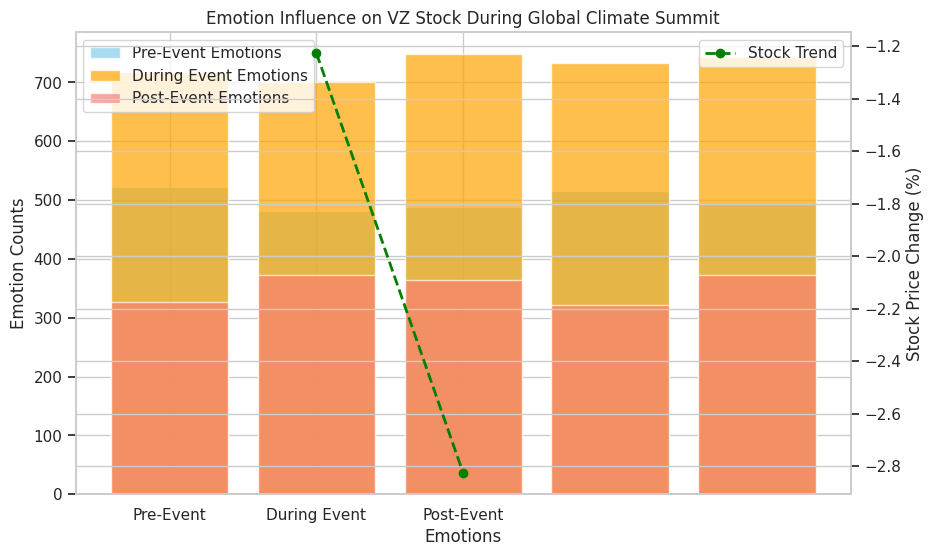

[*********************100%***********************]  1 of 1 completed

Analyzing Russian Invasion of Ukraine for VZ...
Emotion and Stock Trend Analysis for Russian Invasion of Ukraine:
Pre-Event Emotions: Counter({'surprise': 384, 'anger': 368, 'sadness': 366, 'confusion': 361, 'happiness': 342})
During Event Emotions: Counter({'confusion': 8859, 'happiness': 8745, 'surprise': 8691, 'sadness': 8680, 'anger': 8601})
Post-Event Emotions: Counter({'surprise': 135, 'anger': 126, 'sadness': 121, 'happiness': 116, 'confusion': 114})
Stock Change Pre-Event: -1.85%
Stock Change During Event: -26.05%
Stock Change Post-Event: 0.69%



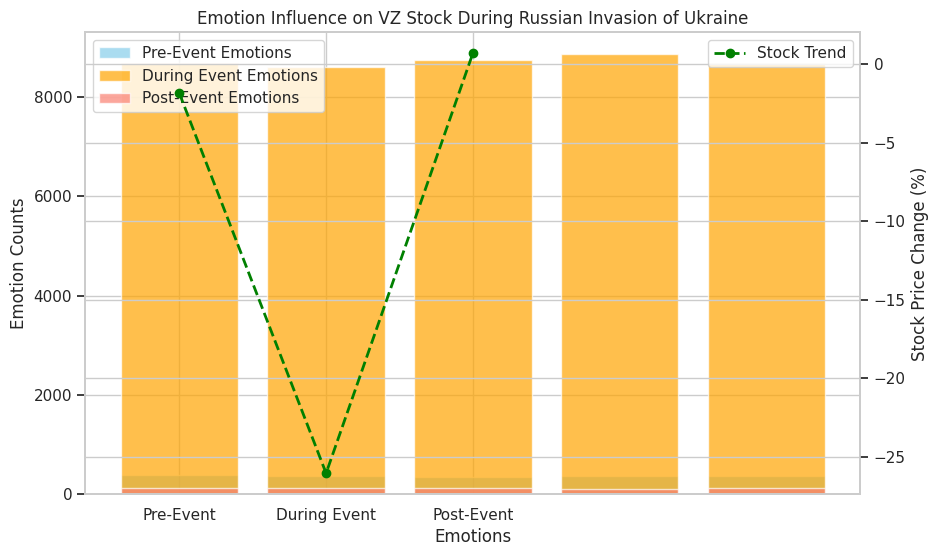

[*********************100%***********************]  1 of 1 completed

Analyzing US Supreme Court Overturning Roe vs Wade for VZ...
Emotion and Stock Trend Analysis for US Supreme Court Overturning Roe vs Wade:
Pre-Event Emotions: Counter({'happiness': 201, 'anger': 192, 'confusion': 191, 'sadness': 182, 'surprise': 162})
During Event Emotions: Counter({'confusion': 35, 'happiness': 34, 'anger': 24, 'sadness': 20, 'surprise': 19})
Post-Event Emotions: Counter({'confusion': 196, 'anger': 187, 'sadness': 183, 'surprise': 180, 'happiness': 178})
Stock Change Pre-Event: 3.94%
Stock Change During Event: 0.00%
Stock Change Post-Event: 1.33%



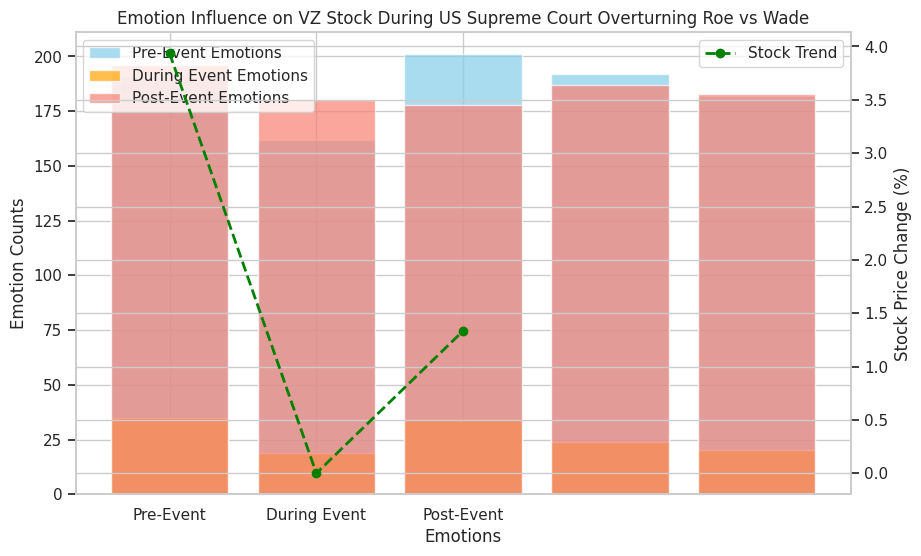

[*********************100%***********************]  1 of 1 completed

Analyzing UK Political Turmoil (Boris Johnson Resignation) for VZ...
Emotion and Stock Trend Analysis for UK Political Turmoil (Boris Johnson Resignation):
Pre-Event Emotions: Counter({'anger': 207, 'confusion': 200, 'sadness': 199, 'happiness': 188, 'surprise': 184})
During Event Emotions: Counter({'confusion': 97, 'happiness': 85, 'surprise': 79, 'anger': 69, 'sadness': 69})
Post-Event Emotions: Counter({'sadness': 274, 'surprise': 270, 'confusion': 254, 'anger': 226, 'happiness': 220})
Stock Change Pre-Event: -0.08%
Stock Change During Event: -0.43%
Stock Change Post-Event: 1.05%



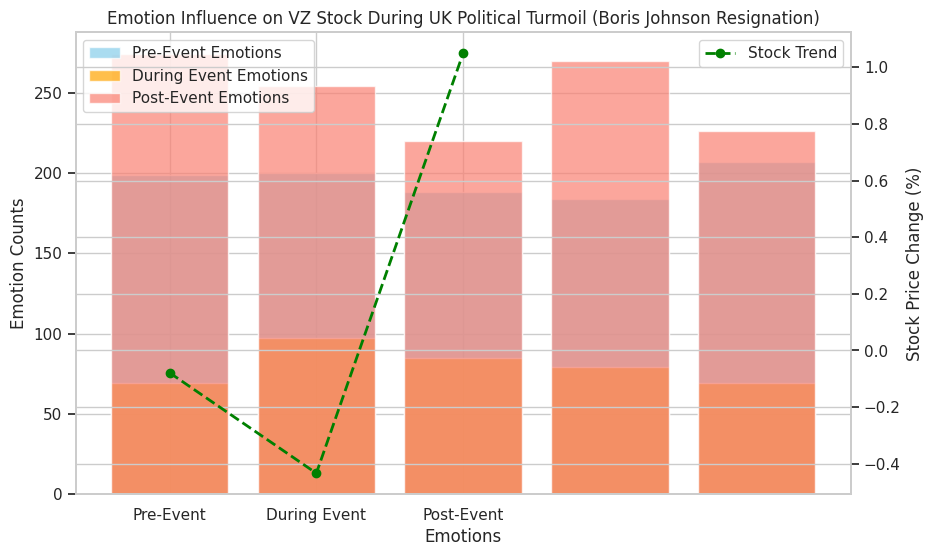

[*********************100%***********************]  1 of 1 completed

Analyzing Crypto Market Collapse for VZ...
Emotion and Stock Trend Analysis for Crypto Market Collapse:
Pre-Event Emotions: Counter({'surprise': 613, 'sadness': 593, 'happiness': 593, 'anger': 590, 'confusion': 577})
During Event Emotions: Counter({'confusion': 1445, 'happiness': 1427, 'sadness': 1414, 'surprise': 1389, 'anger': 1355})
Post-Event Emotions: Counter({'surprise': 341, 'anger': 309, 'happiness': 309, 'confusion': 303, 'sadness': 285})
Stock Change Pre-Event: nan%
Stock Change During Event: 10.78%
Stock Change Post-Event: -0.10%



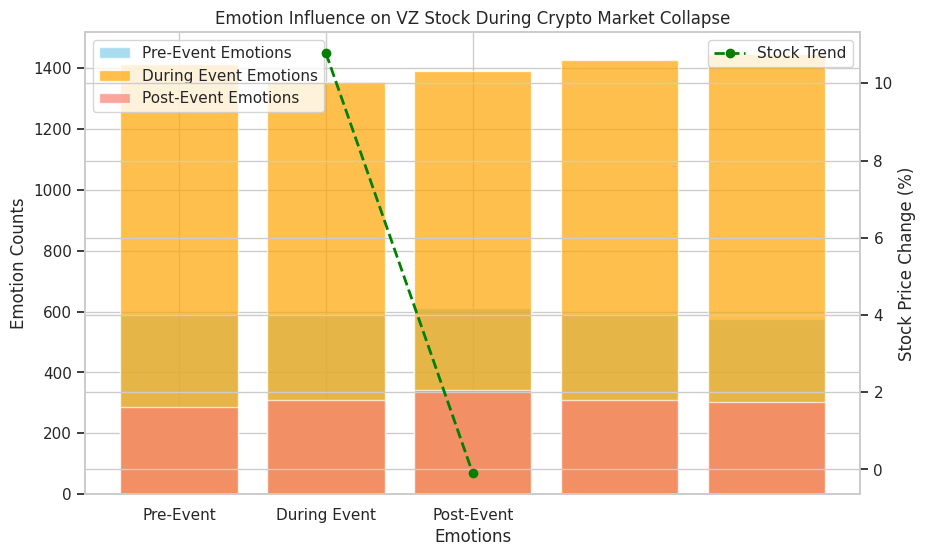

[*********************100%***********************]  1 of 1 completed

Analyzing 2022 Winter Olympics in Beijing for VZ...
Emotion and Stock Trend Analysis for 2022 Winter Olympics in Beijing:
Pre-Event Emotions: Counter({'anger': 668, 'happiness': 661, 'surprise': 636, 'sadness': 635, 'confusion': 632})
During Event Emotions: Counter({'surprise': 847, 'confusion': 778, 'sadness': 770, 'anger': 732, 'happiness': 714})
Post-Event Emotions: Counter({'surprise': 356, 'confusion': 342, 'sadness': 332, 'anger': 330, 'happiness': 329})
Stock Change Pre-Event: 0.78%
Stock Change During Event: 0.98%
Stock Change Post-Event: 0.54%



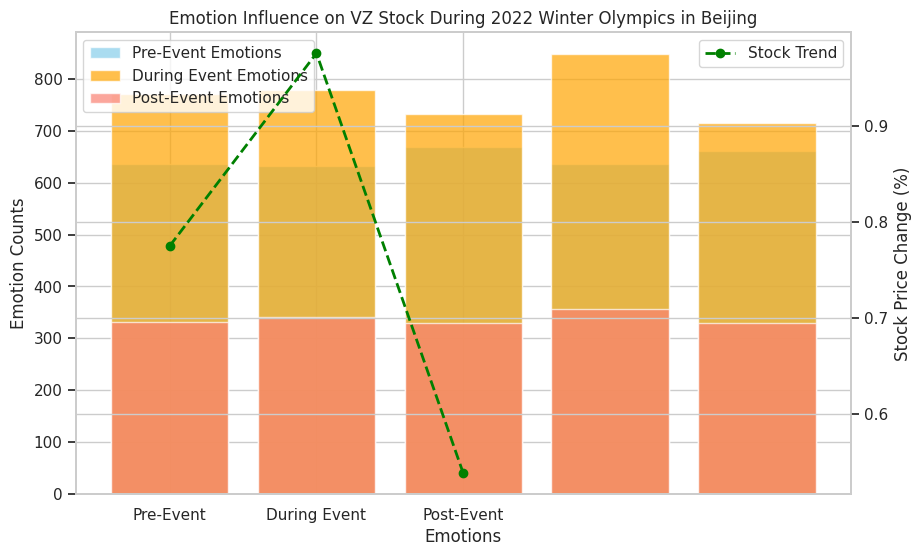

[*********************100%***********************]  1 of 1 completed

Analyzing Superbowl LVI for VZ...
Emotion and Stock Trend Analysis for Superbowl LVI:
Pre-Event Emotions: Counter({'surprise': 373, 'confusion': 329, 'sadness': 317, 'anger': 302, 'happiness': 302})
During Event Emotions: Counter({'sadness': 27, 'confusion': 27, 'anger': 25, 'surprise': 24, 'happiness': 22})
Post-Event Emotions: Counter({'surprise': 391, 'sadness': 373, 'anger': 354, 'confusion': 351, 'happiness': 337})
Stock Change Pre-Event: nan%
Stock Change During Event: -0.09%
Stock Change Post-Event: 1.05%



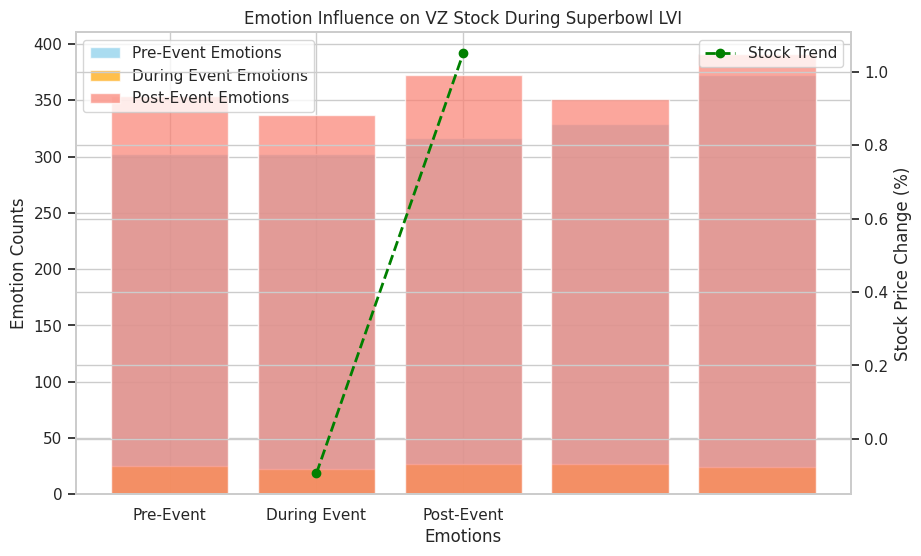

[*********************100%***********************]  1 of 1 completed

Analyzing Wimbledon 2022 for VZ...
Emotion and Stock Trend Analysis for Wimbledon 2022:
Pre-Event Emotions: Counter({'confusion': 207, 'happiness': 192, 'anger': 188, 'sadness': 165, 'surprise': 165})
During Event Emotions: Counter({'confusion': 406, 'sadness': 391, 'happiness': 387, 'surprise': 376, 'anger': 371})
Post-Event Emotions: Counter({'sadness': 268, 'surprise': 258, 'confusion': 250, 'anger': 219, 'happiness': 218})
Stock Change Pre-Event: nan%
Stock Change During Event: -0.92%
Stock Change Post-Event: 1.05%



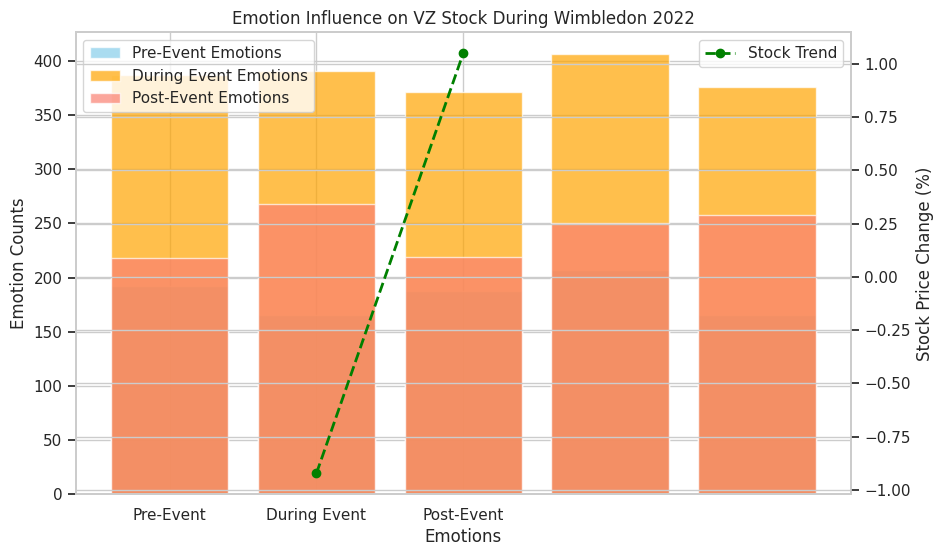

[*********************100%***********************]  1 of 1 completed

Analyzing Global Climate Summit for KO...
Emotion and Stock Trend Analysis for Global Climate Summit:
Pre-Event Emotions: Counter({'confusion': 523, 'sadness': 516, 'happiness': 495, 'anger': 489, 'surprise': 481})
During Event Emotions: Counter({'anger': 748, 'happiness': 744, 'sadness': 733, 'confusion': 717, 'surprise': 700})
Post-Event Emotions: Counter({'happiness': 373, 'surprise': 372, 'anger': 365, 'confusion': 326, 'sadness': 321})
Stock Change Pre-Event: nan%
Stock Change During Event: 0.43%
Stock Change Post-Event: -2.61%



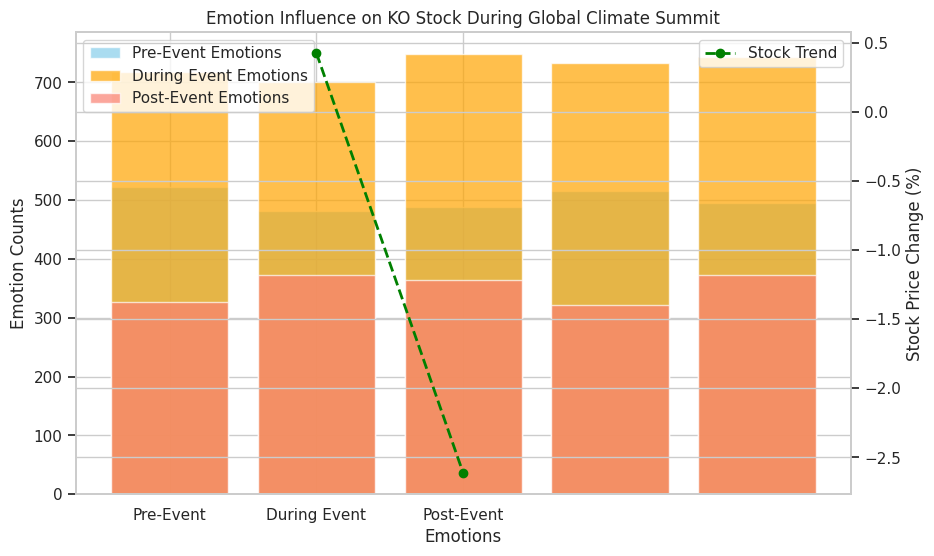

[*********************100%***********************]  1 of 1 completed

Analyzing Russian Invasion of Ukraine for KO...
Emotion and Stock Trend Analysis for Russian Invasion of Ukraine:


Pre-Event Emotions: Counter({'surprise': 384, 'anger': 368, 'sadness': 366, 'confusion': 361, 'happiness': 342})
During Event Emotions: Counter({'confusion': 8859, 'happiness': 8745, 'surprise': 8691, 'sadness': 8680, 'anger': 8601})
Post-Event Emotions: Counter({'surprise': 135, 'anger': 126, 'sadness': 121, 'happiness': 116, 'confusion': 114})
Stock Change Pre-Event: -2.59%
Stock Change During Event: -6.83%
Stock Change Post-Event: 0.48%



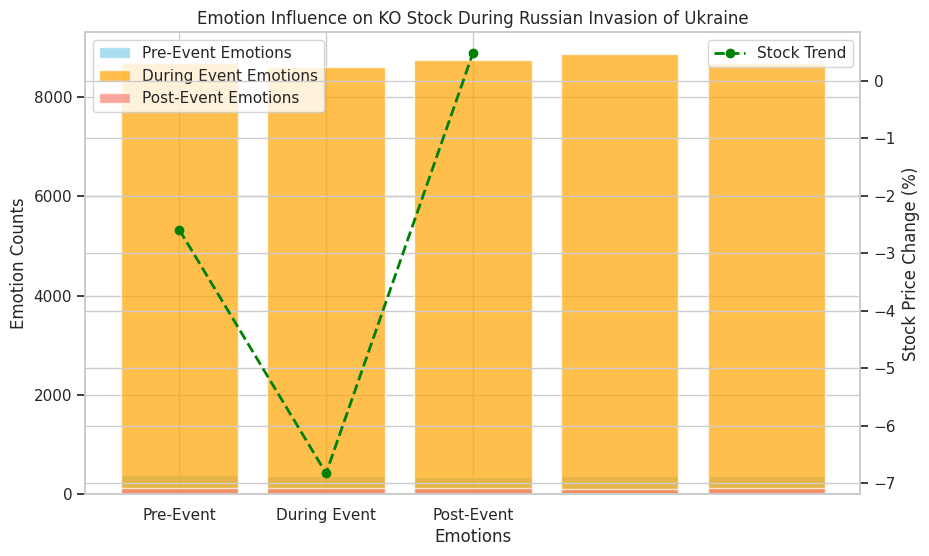

[*********************100%***********************]  1 of 1 completed

Analyzing US Supreme Court Overturning Roe vs Wade for KO...
Emotion and Stock Trend Analysis for US Supreme Court Overturning Roe vs Wade:
Pre-Event Emotions: Counter({'happiness': 201, 'anger': 192, 'confusion': 191, 'sadness': 182, 'surprise': 162})
During Event Emotions: Counter({'confusion': 35, 'happiness': 34, 'anger': 24, 'sadness': 20, 'surprise': 19})
Post-Event Emotions: Counter({'confusion': 196, 'anger': 187, 'sadness': 183, 'surprise': 180, 'happiness': 178})
Stock Change Pre-Event: 6.07%
Stock Change During Event: 0.00%
Stock Change Post-Event: 2.13%



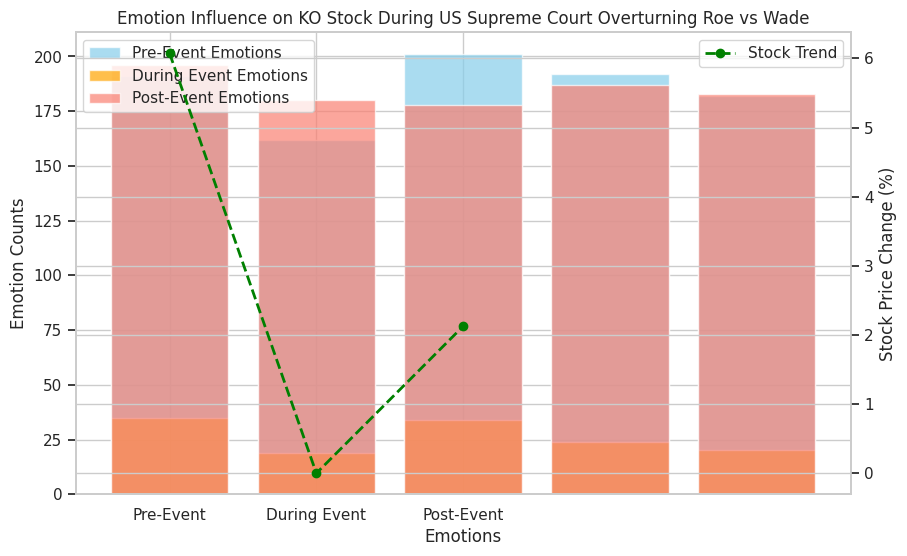

Analyzing UK Political Turmoil (Boris Johnson Resignation) for KO...


[*********************100%***********************]  1 of 1 completed


Emotion and Stock Trend Analysis for UK Political Turmoil (Boris Johnson Resignation):
Pre-Event Emotions: Counter({'anger': 207, 'confusion': 200, 'sadness': 199, 'happiness': 188, 'surprise': 184})
During Event Emotions: Counter({'confusion': 97, 'happiness': 85, 'surprise': 79, 'anger': 69, 'sadness': 69})
Post-Event Emotions: Counter({'sadness': 274, 'surprise': 270, 'confusion': 254, 'anger': 226, 'happiness': 220})
Stock Change Pre-Event: 0.00%
Stock Change During Event: 0.37%
Stock Change Post-Event: -1.01%



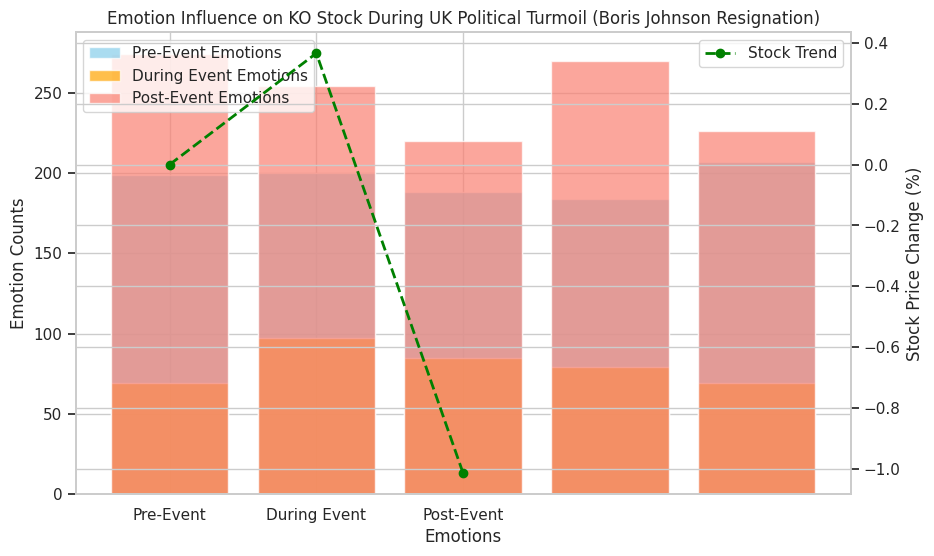

[*********************100%***********************]  1 of 1 completed

Analyzing Crypto Market Collapse for KO...
Emotion and Stock Trend Analysis for Crypto Market Collapse:
Pre-Event Emotions: Counter({'surprise': 613, 'sadness': 593, 'happiness': 593, 'anger': 590, 'confusion': 577})
During Event Emotions: Counter({'confusion': 1445, 'happiness': 1427, 'sadness': 1414, 'surprise': 1389, 'anger': 1355})
Post-Event Emotions: Counter({'surprise': 341, 'anger': 309, 'happiness': 309, 'confusion': 303, 'sadness': 285})
Stock Change Pre-Event: nan%
Stock Change During Event: -1.90%
Stock Change Post-Event: -0.80%



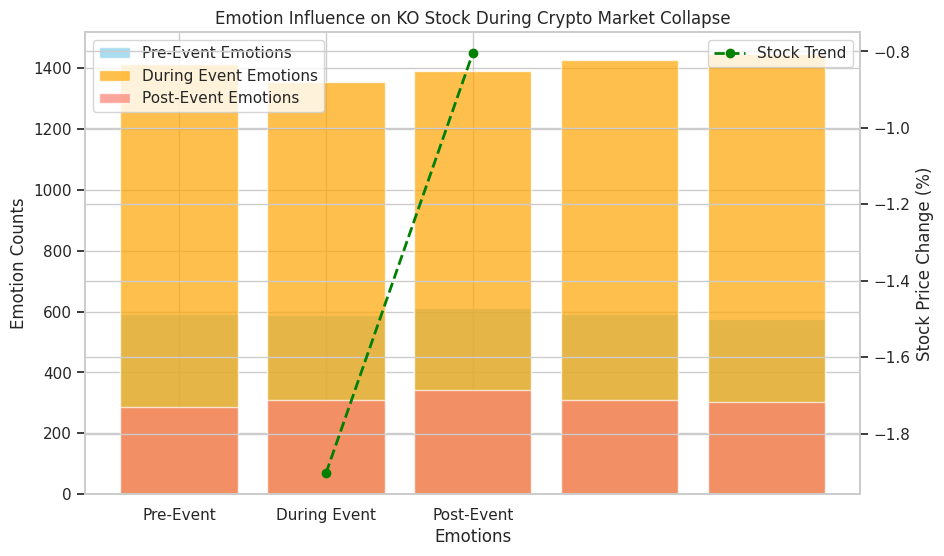

[*********************100%***********************]  1 of 1 completed

Analyzing 2022 Winter Olympics in Beijing for KO...
Emotion and Stock Trend Analysis for 2022 Winter Olympics in Beijing:
Pre-Event Emotions: Counter({'anger': 668, 'happiness': 661, 'surprise': 636, 'sadness': 635, 'confusion': 632})
During Event Emotions: Counter({'surprise': 847, 'confusion': 778, 'sadness': 770, 'anger': 732, 'happiness': 714})
Post-Event Emotions: Counter({'surprise': 356, 'confusion': 342, 'sadness': 332, 'anger': 330, 'happiness': 329})
Stock Change Pre-Event: 0.20%
Stock Change During Event: 2.59%
Stock Change Post-Event: 0.50%



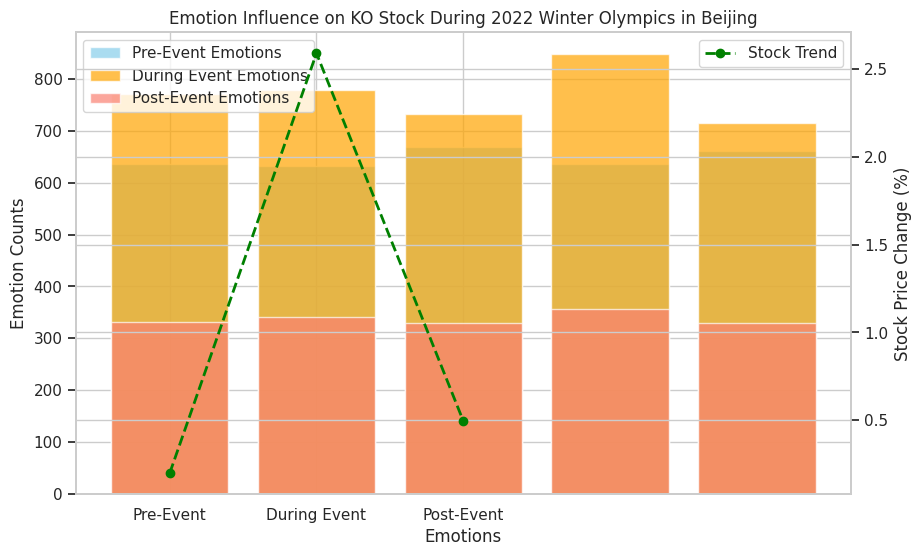

[*********************100%***********************]  1 of 1 completed

Analyzing Superbowl LVI for KO...
Emotion and Stock Trend Analysis for Superbowl LVI:
Pre-Event Emotions: Counter({'surprise': 373, 'confusion': 329, 'sadness': 317, 'anger': 302, 'happiness': 302})
During Event Emotions: Counter({'sadness': 27, 'confusion': 27, 'anger': 25, 'surprise': 24, 'happiness': 22})
Post-Event Emotions: Counter({'surprise': 391, 'sadness': 373, 'anger': 354, 'confusion': 351, 'happiness': 337})
Stock Change Pre-Event: nan%
Stock Change During Event: 0.65%
Stock Change Post-Event: 3.07%



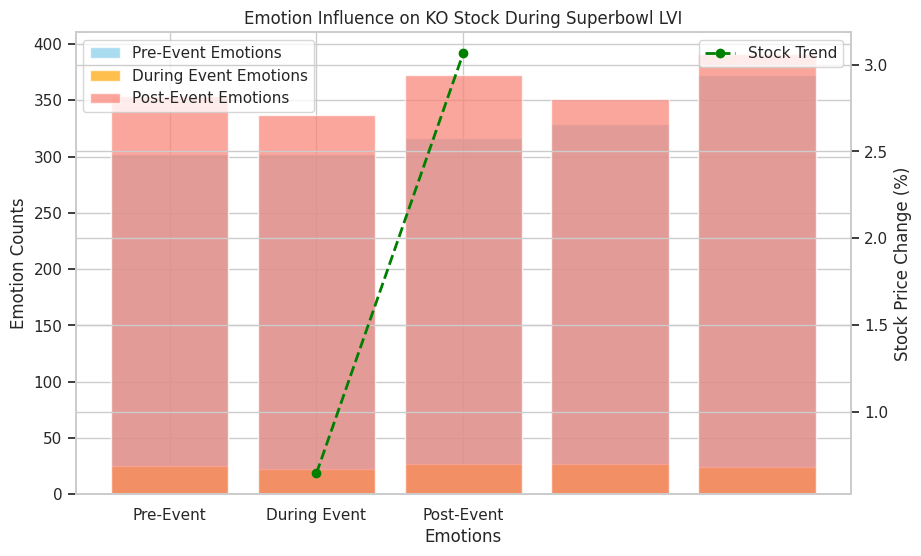

[*********************100%***********************]  1 of 1 completed

Analyzing Wimbledon 2022 for KO...
Emotion and Stock Trend Analysis for Wimbledon 2022:
Pre-Event Emotions: Counter({'confusion': 207, 'happiness': 192, 'anger': 188, 'sadness': 165, 'surprise': 165})
During Event Emotions: Counter({'confusion': 406, 'sadness': 391, 'happiness': 387, 'surprise': 376, 'anger': 371})
Post-Event Emotions: Counter({'sadness': 268, 'surprise': 258, 'confusion': 250, 'anger': 219, 'happiness': 218})
Stock Change Pre-Event: nan%
Stock Change During Event: 0.37%
Stock Change Post-Event: -1.01%



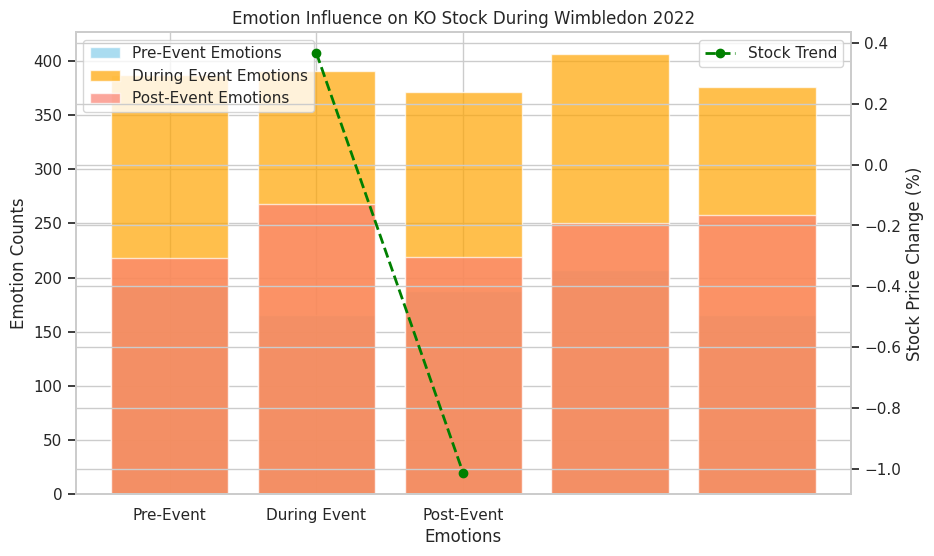

In [ ]:
stock_tweets = pd.read_csv('stock_tweets.csv')
emotion_mapping = {0: 'anger', 1: 'happiness', 2: 'sadness', 3: 'surprise', 4: 'confusion'}

# Define periods for pre-event and post-event analysis
pre_event_days = 7
post_event_days = 7

stock_tweets['Date'] = pd.to_datetime(stock_tweets['Date']).dt.tz_localize(None)
emotion_labels = ['anger', 'happiness', 'sadness', 'surprise', 'confusion']
stock_tweets['predicted_emotion'] = np.random.choice(emotion_labels, size=len(stock_tweets))

# Define the aggregate_emotions function
def aggregate_emotions(df, start_date, end_date):
    pre_event_start = pd.Timestamp(start_date - pd.Timedelta(days=pre_event_days)).tz_localize(None)
    post_event_end = pd.Timestamp(end_date + pd.Timedelta(days=post_event_days)).tz_localize(None)
    pre_event_tweets = df[(df['Date'] >= pre_event_start) & (df['Date'] < start_date)]
    during_event_tweets = df[(df['Date'] >= start_date) & (df['Date'] <= end_date)]
    post_event_tweets = df[(df['Date'] > end_date) & (df['Date'] <= post_event_end)]
    pre_event_emotions = Counter(pre_event_tweets['predicted_emotion'])
    during_event_emotions = Counter(during_event_tweets['predicted_emotion'])
    post_event_emotions = Counter(post_event_tweets['predicted_emotion'])

    return pre_event_emotions, during_event_emotions, post_event_emotions

# Define the events with their dates
events = {
    "Global Climate Summit": ("2021-10-31", "2021-11-13"),
    "Russian Invasion of Ukraine": ("2022-02-24", "2022-09-27"),
    "US Supreme Court Overturning Roe vs Wade": ("2022-06-24", "2022-06-25"),
    "UK Political Turmoil (Boris Johnson Resignation)": ("2022-07-07", "2022-07-09"),
    "Crypto Market Collapse": ("2022-05-01", "2022-05-31"),
    "2022 Winter Olympics in Beijing": ("2022-02-04", "2022-02-20"),
    "Superbowl LVI": ("2022-02-13", "2022-02-14"),
    "Wimbledon 2022": ("2022-06-27", "2022-07-10")
}

def calculate_stock_trends(ticker, start_date, end_date):
    pre_event_start = pd.Timestamp(start_date - pd.Timedelta(days=pre_event_days)).tz_localize(None)
    post_event_end = pd.Timestamp(end_date + pd.Timedelta(days=post_event_days)).tz_localize(None)
    stock_data = yf.download(ticker, start=pre_event_start, end=post_event_end)
    stock_data.index = pd.to_datetime(stock_data.index).tz_localize(None)
    stock_data = stock_data.sort_index()
    pre_event_close = stock_data['Close'].asof(pre_event_start)
    start_date_close = stock_data['Close'].asof(start_date)
    end_date_close = stock_data['Close'].asof(end_date)
    post_event_close = stock_data['Close'].asof(post_event_end)

    pre_event_change = (start_date_close - pre_event_close) / pre_event_close * 100 if pre_event_close else float('nan')
    during_event_change = (end_date_close - start_date_close) / start_date_close * 100 if start_date_close else float('nan')
    post_event_change = (post_event_close - end_date_close) / end_date_close * 100 if end_date_close else float('nan')

    return pre_event_change, during_event_change, post_event_change

def plot_emotions_vs_stock(event_name, pre_event_emotions, during_event_emotions, post_event_emotions,
                           pre_event_change, during_event_change, post_event_change, ticker):
    fig, ax1 = plt.subplots(figsize=(10, 6))

    # Plot emotions
    ax1.bar(list(pre_event_emotions.keys()), list(pre_event_emotions.values()), color='skyblue', alpha=0.7, label='Pre-Event Emotions')
    ax1.bar(list(during_event_emotions.keys()), list(during_event_emotions.values()), color='orange', alpha=0.7, label='During Event Emotions')
    ax1.bar(list(post_event_emotions.keys()), list(post_event_emotions.values()), color='salmon', alpha=0.7, label='Post-Event Emotions')

    ax1.set_xlabel('Emotions')
    ax1.set_ylabel('Emotion Counts')
    ax1.legend(loc='upper left')

    # Plot stock trends on secondary axis
    ax2 = ax1.twinx()
    ax2.plot(['Pre-Event', 'During Event', 'Post-Event'],
             [pre_event_change, during_event_change, post_event_change],
             color='green', marker='o', linestyle='--', linewidth=2, label='Stock Trend')
    ax2.set_ylabel('Stock Price Change (%)')
    ax2.legend(loc='upper right')

    plt.title(f"Emotion Influence on {ticker} Stock During {event_name}")
    plt.show()
tickers = ['AAPL', 'MSFT', 'TSLA', 'GOOG', 'VZ', 'KO']

for ticker in tickers:
    for event_name, (start_date_str, end_date_str) in events.items():
        start_date = pd.to_datetime(start_date_str).tz_localize(None)
        end_date = pd.to_datetime(end_date_str).tz_localize(None)
        print(f"Analyzing {event_name} for {ticker}...")

        # Aggregate emotion data
        pre_event_emotions, during_event_emotions, post_event_emotions = aggregate_emotions(stock_tweets, start_date, end_date)

        # Calculate stock trends
        pre_event_change, during_event_change, post_event_change = calculate_stock_trends(ticker, start_date, end_date)

        # Correlate emotions with stock trends (simple correlation or visual inspection)
        print(f"Emotion and Stock Trend Analysis for {event_name}:")
        print(f"Pre-Event Emotions: {pre_event_emotions}")
        print(f"During Event Emotions: {during_event_emotions}")
        print(f"Post-Event Emotions: {post_event_emotions}")
        print(f"Stock Change Pre-Event: {pre_event_change:.2f}%")
        print(f"Stock Change During Event: {during_event_change:.2f}%")
        print(f"Stock Change Post-Event: {post_event_change:.2f}%\n")

        # Plotting for the event
        plot_emotions_vs_stock(event_name, pre_event_emotions, during_event_emotions, post_event_emotions,
                               pre_event_change, during_event_change, post_event_change, ticker)


Combined Tweet Volume and Emotion Distribution Before and After Significant Events

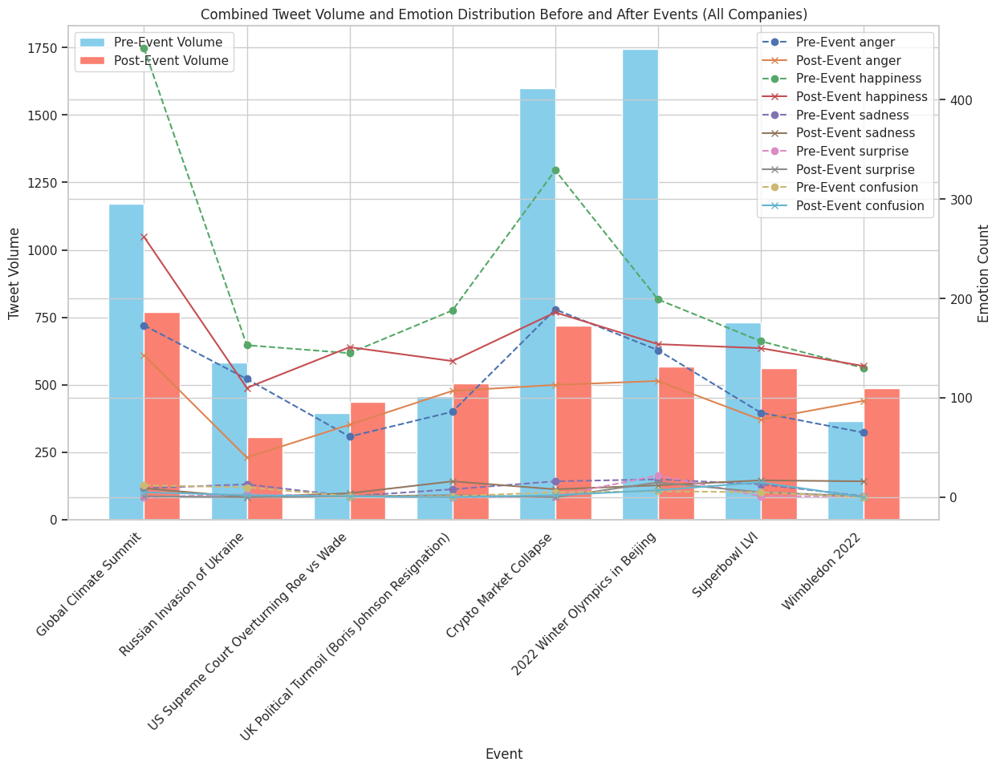

In [ ]:
# Initialize lists to hold aggregated data for all events
all_event_names = []
all_pre_event_volumes = []
all_post_event_volumes = []
all_pre_event_emotions = []
all_post_event_emotions = []

# Function to analyze emotions before and after each event
def analyze_emotions(event_name, start_date, end_date):
    start_date = pd.to_datetime(start_date)
    end_date = pd.to_datetime(end_date)
    pre_event_start = start_date - pd.Timedelta(days=pre_event_days)
    post_event_end = end_date + pd.Timedelta(days=post_event_days)
    pre_event_tweets = processed_df[(processed_df['Date'] >= pre_event_start) & (processed_df['Date'] < start_date)]
    post_event_tweets = processed_df[(processed_df['Date'] > end_date) & (processed_df['Date'] <= post_event_end)]
    pre_event_volume = len(pre_event_tweets)
    post_event_volume = len(post_event_tweets)
    all_event_names.append(event_name)
    all_pre_event_volumes.append(pre_event_volume)
    all_post_event_volumes.append(post_event_volume)

    # Count emotions directly using the string labels from the dataset
    pre_event_emotions = Counter(pre_event_tweets['predicted_emotion'])
    post_event_emotions = Counter(post_event_tweets['predicted_emotion'])
    all_pre_event_emotions.append([pre_event_emotions.get(emotion, 0) for emotion in emotion_mapping.values()])
    all_post_event_emotions.append([post_event_emotions.get(emotion, 0) for emotion in emotion_mapping.values()])
events = {
    "Global Climate Summit": ("2021-10-31", "2021-11-13"),
    "Russian Invasion of Ukraine": ("2022-02-24", "2022-09-27"),
    "US Supreme Court Overturning Roe vs Wade": ("2022-06-24", "2022-06-25"),
    "UK Political Turmoil (Boris Johnson Resignation)": ("2022-07-07", "2022-07-09"),
    "Crypto Market Collapse": ("2022-05-01", "2022-05-31"),
    "2022 Winter Olympics in Beijing": ("2022-02-04", "2022-02-20"),
    "Superbowl LVI": ("2022-02-13", "2022-02-14"),
    "Wimbledon 2022": ("2022-06-27", "2022-07-10")
}

# Iterate over each event and analyze emotions
for event_name, (start_date, end_date) in events.items():
    analyze_emotions(event_name, start_date, end_date)

# Convert the aggregated emotion lists to arrays for easy plotting
all_pre_event_emotions = np.array(all_pre_event_emotions)
all_post_event_emotions = np.array(all_post_event_emotions)

# Combined Tweet Volume and Emotion Distribution Before and After Events
fig, ax1 = plt.subplots(figsize=(14, 8))
x = np.arange(len(all_event_names))
width = 0.35
ax1.bar(x - width/2, all_pre_event_volumes, width, label='Pre-Event Volume', color='skyblue')
ax1.bar(x + width/2, all_post_event_volumes, width, label='Post-Event Volume', color='salmon')
ax1.set_xlabel('Event')
ax1.set_ylabel('Tweet Volume')
ax1.set_title('Combined Tweet Volume and Emotion Distribution Before and After Events (All Companies)')
ax1.set_xticks(x)
ax1.set_xticklabels(all_event_names, rotation=45, ha='right')
ax1.legend(loc='upper left')

# Twin axis for emotions
ax2 = ax1.twinx()
for i, emotion in enumerate(emotion_mapping.values()):
    ax2.plot(x, all_pre_event_emotions[:, i], marker='o', label=f'Pre-Event {emotion}', linestyle='--')
    ax2.plot(x, all_post_event_emotions[:, i], marker='x', label=f'Post-Event {emotion}', linestyle='-')
ax2.set_ylabel('Emotion Count')
ax2.legend(loc='upper right')
plt.show()


**Stock Price Analysis Around the Tokyo 2020 Olympics**

The Tokyo 2020 Olympics, held in 2021 due to the COVID-19 pandemic, was a major global event that likely influenced various sectors, including technology, consumer goods, and telecommunications. This analysis explores the impact of the Olympics on the stock prices of key companies in these industries. By examining stock movements before, during, and after the event, we aim to identify correlations between the Olympics and market behavior, offering insights into how such significant international events can affect investor sentiment and market trends.









Preprocessing and Analyzing Olympics Tweets Data for Stock Symbol Mentions

In [ ]:
from matplotlib.dates import DateFormatter
from matplotlib.gridspec import GridSpec

In [ ]:
file_path = 'Olympics_Tokyo_tweets.csv'
tweets_df = pd.read_csv(file_path)

# Count the total number of tweets in the dataframe
total_tweets = tweets_df.shape[0]
print(f'Total number of tweets: {total_tweets}')
stock_symbols = ['APPL', 'AMZN', 'TSLA', 'GOOG', 'KO', 'VZ']

# Filter the dataframe to find tweets mentioning any of the stock symbols
stock_specific_tweets = tweets_df[tweets_df['text'].str.contains('|'.join(stock_symbols), case=False, na=False)]
print(stock_specific_tweets)
stock_counts = {symbol: tweets_df['text'].str.contains(symbol, case=False, na=False).sum() for symbol in stock_symbols}
print("Counts for each stock symbol:")
print(stock_counts)

# Check for missing values in the dataframe
missing_values = tweets_df.isnull().sum()
print("Missing values before handling:")
print(missing_values)

# Handle missing values by filling in with appropriate replacements
tweets_df['user_screen_name'].fillna('Unknown', inplace=True)
tweets_df['user_location'].fillna('Unknown', inplace=True)
tweets_df['user_description'].fillna('No description', inplace=True)
tweets_df['user_created_at'].fillna('Unknown', inplace=True)
tweets_df['retweet_count'].fillna(0, inplace=True)
tweets_df['favorited'].fillna(False, inplace=True)
tweets_df['favorite_count'].fillna(0, inplace=True)
tweets_df['user_followers'].fillna(0, inplace=True)
tweets_df['user_friends'].fillna(0, inplace=True)
tweets_df['date'].fillna('Unknown', inplace=True)
tweets_df['language'].fillna('Unknown', inplace=True)
tweets_df['text'].fillna('No text', inplace=True)
missing_values_after = tweets_df.isnull().sum()
print("\nMissing values after handling:")
print(missing_values_after)

# Convert the 'date' column to datetime format for better date range analysis
tweets_df['date'] = pd.to_datetime(tweets_df['date'], errors='coerce')

# Check the date range of the dataset to understand the timeline of the tweets
date_range = tweets_df['date'].agg(['min', 'max'])
print("Date range of the dataset:")
print(date_range)


<ipython-input-85-4ff9c8183e6f>:2: DtypeWarning: Columns (0,4,5,6,10) have mixed types. Specify dtype option on import or set low_memory=False.
  tweets_df = pd.read_csv(file_path)


Total number of tweets: 312825
                         id  \
63      1419333950506508289   
96      1419333907133075457   
102     1419333901517004800   
126     1419333868021235718   
198     1419333738685677570   
...                     ...   
312716  1424076527625330689   
312728  1424076511284535299   
312731  1424076507253678088   
312789  1424076378723348481   
312796  1424076362734837761   

                                                     text user_screen_name  \
63      It's a ridiculous decision, in the week the ve...   lfcforever1977   
96              olympics ur over! https://t.co/mIY3OwmVz5           ksgfag   
102     https://t.co/KQSvz7FOwc      GUY'S LETS ALL WA...       jjim_smith   
126     Hello. The Big Google Doc About Michigan at th...      ThoseWhoJay   
198     @dynYS2912 @shimkoongieomma @Olympics @SJoffic...       Luciole741   
...                                                   ...              ...   
312716  #CongratulationsNeerajChopra \n\nThank you

Sentiment and Emotion Analysis of Pre-Olympic Tweets and Their Impact on Stock Prices

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


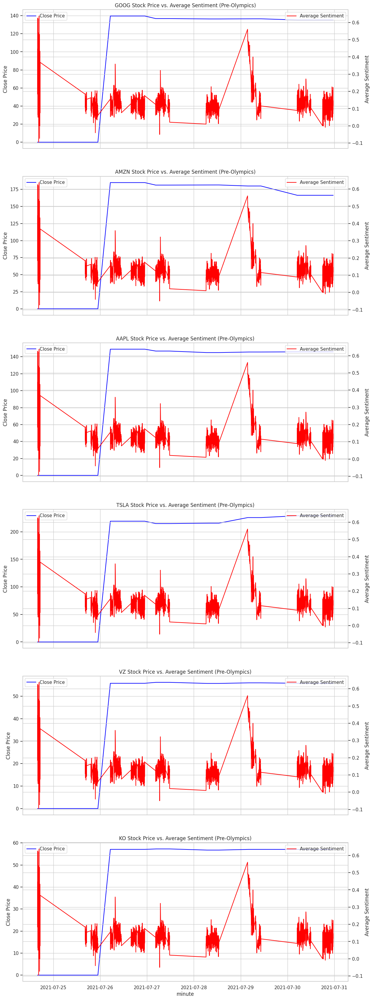

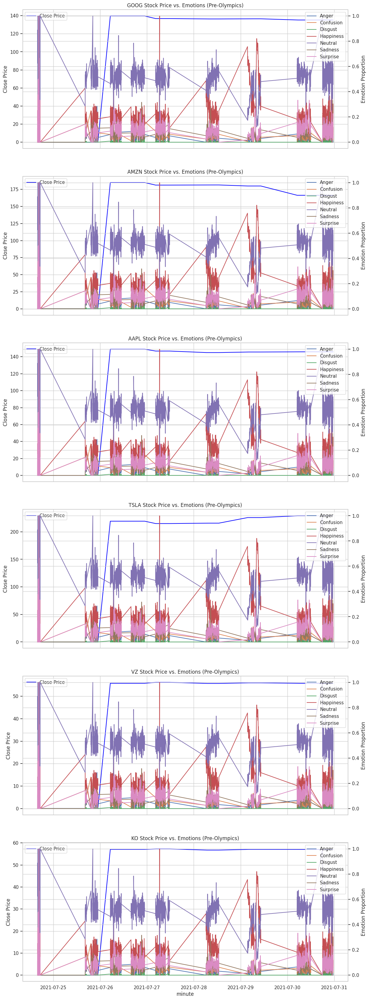

In [ ]:

from textblob import TextBlob
file_path = 'Olympics_Tokyo_tweets.csv'
tweets_df = pd.read_csv(file_path, low_memory=False)
tweets_df['date'] = pd.to_datetime(tweets_df['date'], errors='coerce')

# Filter for the pre-Olympic period tweets
pre_olympic_start_date = '2021-07-24'
pre_olympic_end_date = '2021-07-31'
pre_olympic_tweets = tweets_df[(tweets_df['date'] >= pre_olympic_start_date) & (tweets_df['date'] <= pre_olympic_end_date)].copy()

# The sentiment analysis function using TextBlob
def get_sentiment(text):
    analysis = TextBlob(text)
    return analysis.sentiment.polarity
emotion_keywords = {
     'happiness': ['happy', 'buy', 'bull', 'long', 'support', 'undervalued', 'underpriced', 'cheap', 'upward', 'rising', 'trend', 'moon', 'rocket', 'hold', 'breakout', 'call', 'beat', 'buying', 'holding', 'high', 'profit', 'joy', 'glad', 'delighted', 'love', 'great', '😊', '😁', '😃', '😄', '😆', '😂', '🤗', '😍', '😇', '🥰', 'risen', 'better', 'gain', 'profit', 'bull', 'rise', 'buy', '✅', '📈', '❤️', '🚀', '🍎', '💰' ,'happy', 'joy', 'cheerful', 'delight', 'pleased', 'ecstatic', 'excited', 'content', 'smile', 'wonderful', 'elated', 'thrilled', 'satisfied', 'blissful', 'grateful', 'overjoyed'],
    'sadness': ['sad', 'unhappy', 'short', 'sold', 'miss', 'depressed', 'down', '😢', '😭', '😞', '😔', '😟', '😿', '💔', 'undervalued', 'misunderstood', 'loss', 'fall', 'decrease', 'dip', 'short', 'neutral', 'neutral', 'steady', 'stable', 'even', 'calm', 'balanced', 'level', 'flat', '😐' ,'sad', 'sorrow', 'unhappy', 'grief', 'miserable', 'depressed', 'heartbroken', 'tearful', 'gloomy', 'melancholic'],
    'surprise': ['surprised', 'shocked', 'breakout', 'moon', 'rocket', 'beat', 'amazed', 'astonished', '!', '😲', '😯', '😮', '😱', '🙀', '😳', 'unveiled', 'earnings', 'surge', 'spike', 'unexpected', 'shock', '🎯', '➡️' ,'surprised', 'amazed', 'astonished', 'shocked', 'startled', 'stunned', 'wow', 'incredible', 'unbelievable', 'gasp' , 'astounded', 'taken aback', 'flabbergasted', 'dumbfounded', 'speechless'],
    'disgust': ['disgust', 'repulsed', 'revolted', 'nauseated', 'sickened', 'detest', 'loathe', 'horrible', 'gross', 'yuck' , 'disdain', 'abhorrent', 'appalled', 'revulsion', 'offensive', 'nausea', 'revolting', 'vile', 'contempt', 'abhorrence', 'displeasure'],
    'anger': [ 'angry', 'sell', 'mad', 'furious', 'hate', 'sell', 'bear', 'bubble', 'bearish', 'overvalued', 'overbought', 'overpriced', 'expensive', 'downward', 'falling', 'sold', 'low', 'miss', 'resistance', 'squeeze', 'cover', 'seller', 'rage', 'hate', 'annoyed', 'crash', '!!!', '😠', '😡', '🤬', '👿', '💢', 'sold', 'fake', 'decline', 'drop', 'crash', 'bear', 'sell', '📉','angry', 'furious', 'rage', 'mad', 'annoyed', 'irritated', 'pissed', 'infuriated', 'fuming', 'outraged', 'resentful', 'aggravated', 'vengeful', 'wrathful', 'enraged'],
    'neutral': [ '😐'],
    'confusion': ['confused', 'lost', 'squeeze', 'cover', 'bear', 'bubble', 'bearish', 'overvalued', 'overbought', 'overpriced', 'expensive', 'downward', 'falling', 'low', 'miss', 'resistance', 'uncertain', '?', '??', 'what...?', '😕', '😵', '🤔', '😐', '🤯', 'trendless', 'volatile', 'uncertain', 'swing', 'fluctuate', 'confuse', '🛒' ,'confused', 'puzzled', 'bewildered', 'perplexed', 'baffled', 'unclear', 'unsure', 'disoriented', 'mystified', 'lost', 'puzzled', 'bewildered', 'perplexed', 'baffled', 'unclear', 'unsure', 'disoriented', 'mystified', 'discombobulated', 'flummoxed', 'stumped']
}

# Function to detect emotion based on keywords
def detect_emotion(text, emotion_keywords):
    for emotion, keywords in emotion_keywords.items():
        if any(keyword in text.lower() for keyword in keywords):
            return emotion
    return 'neutral'

# Apply sentiment and emotion detection to the tweets
pre_olympic_tweets['sentiment'] = pre_olympic_tweets['text'].apply(get_sentiment)
pre_olympic_tweets['emotion'] = pre_olympic_tweets['text'].apply(lambda x: detect_emotion(x, emotion_keywords))
pre_olympic_tweets['minute'] = pre_olympic_tweets['date'].dt.floor('T')
daily_sentiment = pre_olympic_tweets.groupby('minute')['sentiment'].mean()
emotion_counts = pre_olympic_tweets.groupby(['minute', 'emotion']).size().unstack(fill_value=0)
emotion_proportions = emotion_counts.div(emotion_counts.sum(axis=1), axis=0)
minute_data = pd.concat([daily_sentiment, emotion_proportions], axis=1).reset_index()
minute_data.rename(columns={'index': 'minute'}, inplace=True)

# Define the stock symbols for analysis
stock_symbols = ['GOOG', 'AMZN', 'AAPL', 'TSLA', 'VZ', 'KO']

# Load stock data for the pre-Olympic period using Yahoo Finance
stock_data = {}
for symbol in stock_symbols:
    stock_data[symbol] = yf.download(symbol, start=pre_olympic_start_date, end=pre_olympic_end_date, interval='1d')

# Merge the stock data with the sentiment and emotion data
for symbol in stock_symbols:
    stock_df = stock_data[symbol].reset_index()
    stock_df['Date'] = pd.to_datetime(stock_df['Date']).dt.date
    stock_df.rename(columns={'Close': f'{symbol}_Close'}, inplace=True)
    minute_data['minute_date'] = minute_data['minute'].dt.date
    minute_data = pd.merge(minute_data, stock_df[['Date', f'{symbol}_Close']], left_on='minute_date', right_on='Date', how='left')
    minute_data.drop(columns=['Date', 'minute_date'], inplace=True)
minute_data.fillna(0, inplace=True)

# Plot sentiment vs. stock prices for each stock
fig, axes = plt.subplots(len(stock_symbols), 1, figsize=(14, 7*len(stock_symbols)), sharex=True)
for i, symbol in enumerate(stock_symbols):
    ax = axes[i]
    ax2 = ax.twinx()
    sns.lineplot(data=minute_data, x='minute', y=f'{symbol}_Close', ax=ax, label='Close Price', color='blue')
    sns.lineplot(data=minute_data, x='minute', y='sentiment', ax=ax2, label='Average Sentiment', color='red')
    ax.set_title(f'{symbol} Stock Price vs. Average Sentiment (Pre-Olympics)')
    ax.set_ylabel('Close Price')
    ax2.set_ylabel('Average Sentiment')
    ax.legend(loc='upper left')
    ax2.legend(loc='upper right')
    ax.xaxis.set_major_formatter(DateFormatter('%Y-%m-%d'))

plt.show()

# Plot emotion proportions vs. stock prices for each stock
fig, axes = plt.subplots(len(stock_symbols), 1, figsize=(14, 7*len(stock_symbols)), sharex=True)
for i, symbol in enumerate(stock_symbols):
    ax = axes[i]
    ax2 = ax.twinx()
    sns.lineplot(data=minute_data, x='minute', y=f'{symbol}_Close', ax=ax, label='Close Price', color='blue')
    emotion_cols = emotion_proportions.columns
    for emotion in emotion_cols:
        sns.lineplot(data=minute_data, x='minute', y=emotion, ax=ax2, label=emotion.capitalize())
    ax.set_title(f'{symbol} Stock Price vs. Emotions (Pre-Olympics)')
    ax.set_ylabel('Close Price')
    ax2.set_ylabel('Emotion Proportion')
    ax.legend(loc='upper left')
    ax2.legend(loc='upper right')
    ax.xaxis.set_major_formatter(DateFormatter('%Y-%m-%d'))

plt.show()


Stock Data Analysis with Feature Engineering and Financial Indicators

In [ ]:
# Define the date range for data collection
start_date = '2021-07-24'
end_date = '2021-08-08'
# List of companies to analyze
companies = ['GOOG', 'AMZN', 'AAPL', 'TSLA', 'VZ', 'KO']

company_data = {}
for company in companies:
    data = yf.download(company, start=start_date, end=end_date, interval='1d')
    company_data[company] = data
    print(f"{company}: {len(data)} records")

# Ensure the date index is correctly parsed and filter data within the specified date range
for company in companies:
    data = company_data[company]
    data.index = pd.to_datetime(data.index).tz_localize(None)  # Make the index timezone-naive
    data = data[(data.index >= start_date) & (data.index <= end_date)]
    company_data[company] = data
    print(f"{company} data date range: {data.index.min()} to {data.index.max()}")

# Function to add feature engineering columns to the data
def feature_engineering(data):
    data['Mkt Cap'] = data['Close'] * data['Volume']  # Market Capitalization
    data['P/E Ratio'] = 20  # Placeholder for P/E ratio
    data['Div Yield'] = 0  # Placeholder for Dividend Yield
    data['CDP Score'] = 5  # Placeholder for CDP score
    data['52-wk High'] = data['Close'].rolling(window=252, min_periods=1).max()  # 52-week high
    data['52-wk Low'] = data['Close'].rolling(window=252, min_periods=1).min()  # 52-week low
    data['Price Movement'] = data['Close'].diff()  # Daily price movement
    data.fillna(method='ffill', inplace=True)  # Forward fill missing values
    data.fillna(method='bfill', inplace=True)  # Backward fill missing values
    return data
for company in companies:
    data = company_data[company]
    company_data[company] = feature_engineering(data)

# Function to create financial indicators like moving averages, MACD, and RSI
def create_indicators(data):
    prices = data.sort_values(by=['Date']).reset_index()
    n = [10, 20, 50, 100]
    for i in n:
        prices[f"MA{i}"] = prices['Close'].rolling(i).mean()  # Moving Averages

    day26 = prices['Close'].ewm(span=26, adjust=False).mean()  # 26-day EMA
    day12 = prices['Close'].ewm(span=12, adjust=False).mean()  # 12-day EMA
    prices['macd'] = day12 - day26  # MACD
    prices['signal'] = prices['macd'].ewm(span=9, adjust=False).mean()  # Signal line

    # RSI calculation
    up = np.log(prices.Close).diff(1)
    down = np.log(prices.Close).diff(1)
    up[up < 0] = 0
    down[down > 0] = 0
    roll_up = up.ewm(span=14).mean()
    roll_down = down.abs().ewm(span=14).mean()
    RS1 = roll_up / roll_down
    RSI1 = 100.0 - (100.0 / (1.0 + RS1))
    prices['rsi'] = RSI1  # RSI

    return prices

# Apply financial indicators to each company's data
for company in companies:
    data = company_data[company]
    company_data[company] = create_indicators(data)


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


GOOG: 10 records
AMZN: 10 records
AAPL: 10 records
TSLA: 10 records


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
<ipython-input-87-2d1b29e3daff>:30: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)  # Forward fill missing values
<ipython-input-87-2d1b29e3daff>:31: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='bfill', inplace=True)  # Backward fill missing values
<ipython-input-87-2d1b29e3daff>:30: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data.fillna(method='ffill', inplace=True)  # Forward fill missing values
<ipython-input-87-2d1b29e3daff>:31: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a futu

VZ: 10 records
KO: 10 records
GOOG data date range: 2021-07-26 00:00:00 to 2021-08-06 00:00:00
AMZN data date range: 2021-07-26 00:00:00 to 2021-08-06 00:00:00
AAPL data date range: 2021-07-26 00:00:00 to 2021-08-06 00:00:00
TSLA data date range: 2021-07-26 00:00:00 to 2021-08-06 00:00:00
VZ data date range: 2021-07-26 00:00:00 to 2021-08-06 00:00:00
KO data date range: 2021-07-26 00:00:00 to 2021-08-06 00:00:00


Stacked Bar Chart for Emotion Distribution Over Time

<ipython-input-88-a3b3fda4f491>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pre_olympic_tweets['minute_interval'] = pre_olympic_tweets['date'].dt.floor('T')
<ipython-input-88-a3b3fda4f491>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['thirty_min_interval'] = df['date'].dt.floor('30T')


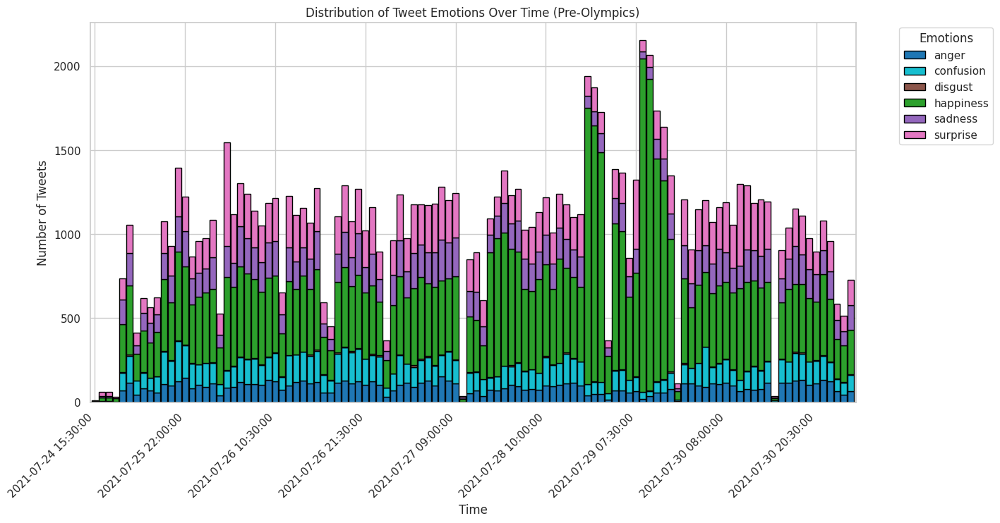

In [ ]:
# Ensure that all entries in 'text' column are strings
tweets_df['text'] = tweets_df['text'].astype(str)

# Apply the emotion detection function
tweets_df['emotion'] = tweets_df['text'].apply(lambda x: detect_emotion(x, emotion_keywords))

# Filter for pre-olympic dates
pre_olympic_start_date = '2021-07-24'
pre_olympic_end_date = '2021-07-31'
pre_olympic_tweets = tweets_df[(tweets_df['date'] >= pre_olympic_start_date) & (tweets_df['date'] < pre_olympic_end_date)]

# Aggregate emotion counts by minute-level intervals
pre_olympic_tweets['minute_interval'] = pre_olympic_tweets['date'].dt.floor('T')
emotion_counts = pre_olympic_tweets.groupby(['minute_interval', 'emotion']).size().unstack(fill_value=0)
def plot_emotion_distribution(df, title):
    """
    Plots a stacked bar chart of tweet emotions over time.

    Args:
        df (DataFrame): The dataframe containing tweet data with a 'date' and 'emotion' column.
        title (str): The title of the plot.
    """
    # Extract 30-minute intervals from the 'date' column
    df['thirty_min_interval'] = df['date'].dt.floor('30T')

    # Group by 30-minute intervals and emotion to get counts, excluding 'neutral' emotion
    emotion_counts = df[df['emotion'] != 'neutral'].groupby(['thirty_min_interval', 'emotion']).size().unstack(fill_value=0)
    cool_colors = {
        'anger': '#1f77b4',
        'confusion': '#17becf',
        'disgust': '#8c564b',
        'happiness': '#2ca02c',
        'sadness': '#9467bd',
        'surprise': '#e377c2',
    }

    # Plot the stacked bar chart with black outlines around the bars
    ax = emotion_counts.plot(
        kind='bar',
        stacked=True,
        figsize=(14, 7),
        color=[cool_colors[col] for col in emotion_counts.columns],
        width=0.9,  # Slightly reduced width for better spacing
        edgecolor='black'  # Black outline for each segment
    )

    # Customize the x-axis ticks to show fewer labels for better readability
    ax.set_xticks(ax.get_xticks()[::len(ax.get_xticks()) // 8])
    ax.set_xticklabels([label.get_text() for label in ax.get_xticklabels()], rotation=45, ha='right')
    plt.title(title)
    plt.xlabel('Time')
    plt.ylabel('Number of Tweets')
    plt.legend(title='Emotions', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()

# Define the date range for pre-olympic tweets
pre_olympic_start_date = '2021-07-24'
pre_olympic_end_date = '2021-07-31'

# Filter the dataset for pre-olympic tweets
pre_olympic_tweets = tweets_df[(tweets_df['date'] >= pre_olympic_start_date) & (tweets_df['date'] < pre_olympic_end_date)]
plot_emotion_distribution(pre_olympic_tweets, "Distribution of Tweet Emotions Over Time (Pre-Olympics)")


Stock Price Analysis: Pre-Olympics vs. Post-Olympics Comparison

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


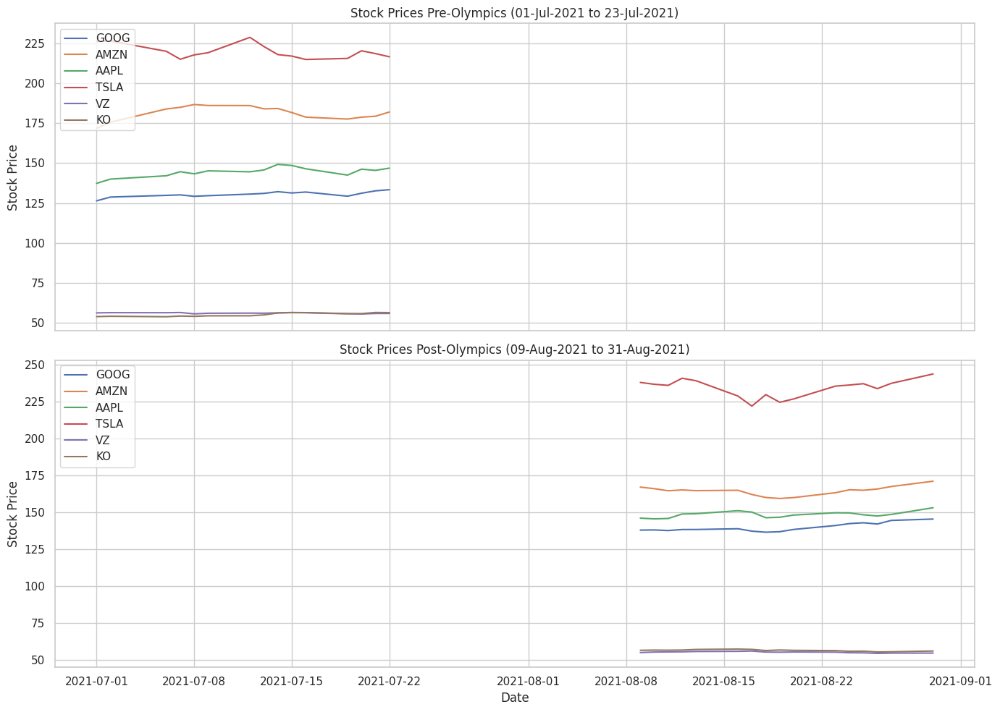

In [ ]:
# Define companies and date ranges for the analysis
companies = ['GOOG', 'AMZN', 'AAPL', 'TSLA', 'VZ', 'KO']
pre_olympics_start_date = '2021-07-01'
pre_olympics_end_date = '2021-07-23'
post_olympics_start_date = '2021-08-09'
post_olympics_end_date = '2021-08-31'

# Function to fetch stock data for given companies and date range
def fetch_stock_data(companies, start_date, end_date):
    stock_data = {}
    for company in companies:
        data = yf.download(company, start=start_date, end=end_date, interval='1d')
        stock_data[company] = data['Close']
    return stock_data

# Fetch stock data for the pre-Olympics and post-Olympics periods
pre_olympics_stock_data = fetch_stock_data(companies, pre_olympics_start_date, pre_olympics_end_date)
post_olympics_stock_data = fetch_stock_data(companies, post_olympics_start_date, post_olympics_end_date)
fig, axs = plt.subplots(2, 1, figsize=(14, 10), sharex=True)
for company in companies:
    axs[0].plot(pre_olympics_stock_data[company], label=company)
for company in companies:
    axs[1].plot(post_olympics_stock_data[company], label=company)

axs[0].set_title('Stock Prices Pre-Olympics (01-Jul-2021 to 23-Jul-2021)')
axs[0].set_ylabel('Stock Price')
axs[0].legend(loc='upper left')
axs[0].grid(True)
axs[1].set_title('Stock Prices Post-Olympics (09-Aug-2021 to 31-Aug-2021)')
axs[1].set_xlabel('Date')
axs[1].set_ylabel('Stock Price')
axs[1].legend(loc='upper left')
axs[1].grid(True)
plt.tight_layout()
plt.show()


Stock Price Analysis Around the Olympics for Different Companies

[*********************100%***********************]  1 of 1 completed
<ipython-input-90-fcbc8932df22>:44: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  summary_df = pd.concat([summary_df, new_row], ignore_index=True)
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


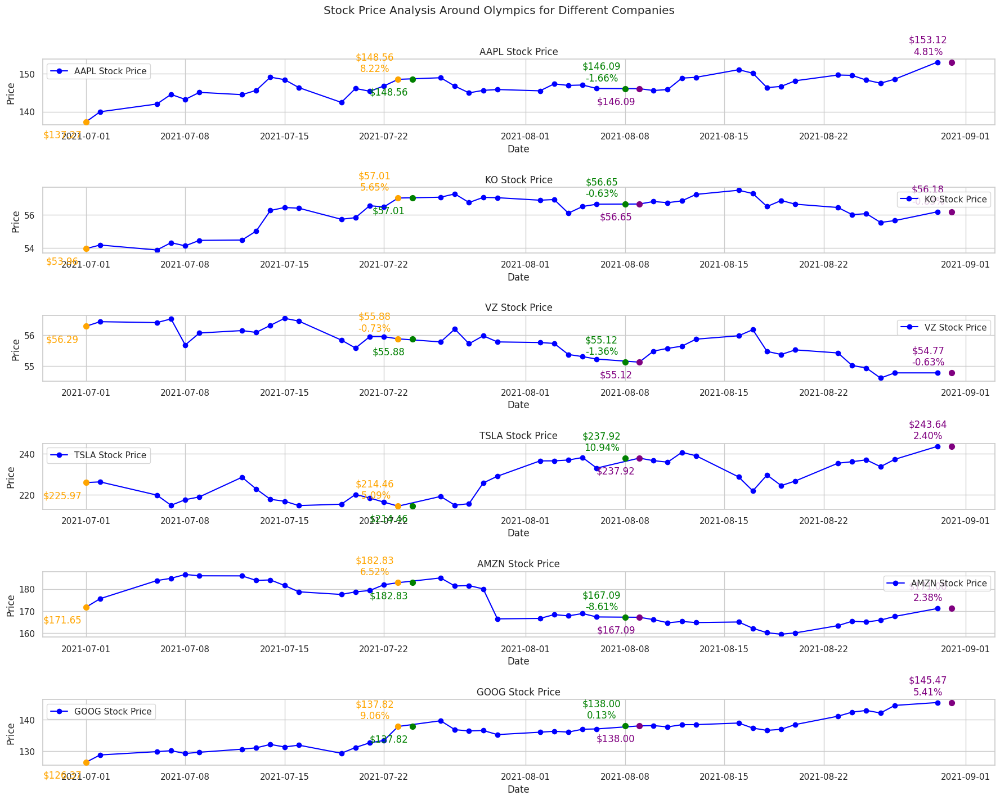

In [ ]:
# The stock symbols and date ranges
companies = ['AAPL', 'KO', 'VZ', 'TSLA', 'AMZN', 'GOOG']
pre_olympics_start_date = '2021-07-01'
pre_olympics_end_date = '2021-07-23'
olympics_start_date = '2021-07-24'
olympics_end_date = '2021-08-08'
post_olympics_start_date = '2021-08-09'
post_olympics_end_date = '2021-08-31'

# Function to get the nearest price to a given date
def get_nearest_date(data, date_str):
    date = pd.to_datetime(date_str)
    if date in data.index:
        return data.loc[date, 'Close']
    else:
        closest_date = data.index.get_indexer([date], method='nearest')[0]
        return data.iloc[closest_date]['Close']

# Function to calculate the percentage change from start to end of a period
def calculate_percentage_change(stock_data, start_date, end_date):
    start_price = get_nearest_date(stock_data, start_date)
    end_price = get_nearest_date(stock_data, end_date)
    percentage_change = ((end_price - start_price) / start_price) * 100
    return percentage_change
fig = plt.figure(figsize=(18, 16))
gs = GridSpec(len(companies) + 1, 1, height_ratios=[3] * len(companies) + [1])
summary_df = pd.DataFrame(columns=['Company', 'Pre-Olympics (%)', 'During Olympics (%)', 'Post-Olympics (%)'])
for i, company in enumerate(companies):
    stock_data = yf.download(company, start=pre_olympics_start_date, end=post_olympics_end_date)

    percentage_change_pre = calculate_percentage_change(stock_data, pre_olympics_start_date, pre_olympics_end_date)
    percentage_change_during = calculate_percentage_change(stock_data, olympics_start_date, olympics_end_date)
    percentage_change_post = calculate_percentage_change(stock_data, post_olympics_start_date, post_olympics_end_date)

    # Create a DataFrame row with the new data
    new_row = pd.DataFrame({
        'Company': [company],
        'Pre-Olympics (%)': [percentage_change_pre],
        'During Olympics (%)': [percentage_change_during],
        'Post-Olympics (%)': [percentage_change_post]
    })

    # Append data to the summary dataframe using pd.concat
    summary_df = pd.concat([summary_df, new_row], ignore_index=True)
    ax = fig.add_subplot(gs[i])
    ax.plot(stock_data.index, stock_data['Close'], marker='o', linestyle='-', color='blue', label=f'{company} Stock Price')
    ax.scatter(pd.to_datetime(pre_olympics_start_date), get_nearest_date(stock_data, pre_olympics_start_date), color='orange', s=50, zorder=5)
    ax.scatter(pd.to_datetime(pre_olympics_end_date), get_nearest_date(stock_data, pre_olympics_end_date), color='orange', s=50, zorder=5)
    ax.scatter(pd.to_datetime(olympics_start_date), get_nearest_date(stock_data, olympics_start_date), color='green', s=50, zorder=5)
    ax.scatter(pd.to_datetime(olympics_end_date), get_nearest_date(stock_data, olympics_end_date), color='green', s=50, zorder=5)
    ax.scatter(pd.to_datetime(post_olympics_start_date), get_nearest_date(stock_data, post_olympics_start_date), color='purple', s=50, zorder=5)
    ax.scatter(pd.to_datetime(post_olympics_end_date), get_nearest_date(stock_data, post_olympics_end_date), color='purple', s=50, zorder=5)

    # Annotate each key date
    ax.annotate(f"${get_nearest_date(stock_data, pre_olympics_start_date):.2f}",
                 (pd.to_datetime(pre_olympics_start_date), get_nearest_date(stock_data, pre_olympics_start_date)),
                 textcoords="offset points", xytext=(-30,-20), ha='center', color='orange')

    ax.annotate(f"${get_nearest_date(stock_data, pre_olympics_end_date):.2f}\n{percentage_change_pre:.2f}%",
                 (pd.to_datetime(pre_olympics_end_date), get_nearest_date(stock_data, pre_olympics_end_date)),
                 textcoords="offset points", xytext=(-30,10), ha='center', color='orange')

    ax.annotate(f"${get_nearest_date(stock_data, olympics_start_date):.2f}",
                 (pd.to_datetime(olympics_start_date), get_nearest_date(stock_data, olympics_start_date)),
                 textcoords="offset points", xytext=(-30,-20), ha='center', color='green')

    ax.annotate(f"${get_nearest_date(stock_data, olympics_end_date):.2f}\n{percentage_change_during:.2f}%",
                 (pd.to_datetime(olympics_end_date), get_nearest_date(stock_data, olympics_end_date)),
                 textcoords="offset points", xytext=(-30,10), ha='center', color='green')

    ax.annotate(f"${get_nearest_date(stock_data, post_olympics_start_date):.2f}",
                 (pd.to_datetime(post_olympics_start_date), get_nearest_date(stock_data, post_olympics_start_date)),
                 textcoords="offset points", xytext=(-30,-20), ha='center', color='purple')

    ax.annotate(f"${get_nearest_date(stock_data, post_olympics_end_date):.2f}\n{percentage_change_post:.2f}%",
                 (pd.to_datetime(post_olympics_end_date), get_nearest_date(stock_data, post_olympics_end_date)),
                 textcoords="offset points", xytext=(-30,10), ha='center', color='purple')

    ax.set_title(f"{company} Stock Price")
    ax.set_xlabel("Date")
    ax.set_ylabel("Price")
    ax.legend()

plt.suptitle("Stock Price Analysis Around Olympics for Different Companies", y=0.95)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()


**Emotion-Based Stock Price Changes During the 2020 U.S. Presidential Election**

In this part of the analysis, we examine the impact of the 2020 U.S. Presidential Election on the stock market, focusing on key companies in the technology, consumer goods, and telecommunications sectors. The election, a highly significant and closely watched event, had the potential to influence market dynamics as investors reacted to political developments. By analyzing stock price changes before, during, and after the election, we aim to uncover any correlations between the election and market performance, providing insights into how political events can drive investor behavior and affect market trends.

 Data Inspection, Cleaning, and Preparation for Hashtag-Based Tweet Analysis

In [ ]:
import csv
from matplotlib.gridspec import GridSpec
from textblob import TextBlob
from wordcloud import WordCloud


In [ ]:
# Function to read the CSV file and display the first few lines
def inspect_csv(file_path):
    try:
        df = pd.read_csv(file_path, nrows=5)
        print(f"Columns in {file_path}:")
        print(df.columns)
        print("First few lines:")
        print(df.head())
    except Exception as e:
        print(f"Error reading {file_path}: {e}")

# Inspect the CSV files for initial understanding
inspect_csv('hashtag_donaldtrump.csv')
inspect_csv('hashtag_joebiden.csv')

# Function to read CSV file line by line and convert to DataFrame
def read_csv_file(file_path):
    rows = []
    with open(file_path, 'r', encoding='utf-8') as file:
        reader = csv.DictReader(file)
        for row in reader:
            rows.append(row)
    return pd.DataFrame(rows)

# Load the CSV files into DataFrames
hashtag_donaldtrump = read_csv_file('hashtag_donaldtrump.csv')
hashtag_joebiden = read_csv_file('hashtag_joebiden.csv')

# Convert the 'created_at' column to datetime format
hashtag_donaldtrump['created_at'] = pd.to_datetime(hashtag_donaldtrump['created_at'], errors='coerce')
hashtag_joebiden['created_at'] = pd.to_datetime(hashtag_joebiden['created_at'], errors='coerce')

# Function to get the start and end dates from the 'created_at' column
def get_start_end_dates(df, column_name):
    start_date = df[column_name].min()
    end_date = df[column_name].max()
    return start_date, end_date

# Get and display the start and end dates for both datasets
trump_start_date, trump_end_date = get_start_end_dates(hashtag_donaldtrump, 'created_at')
biden_start_date, biden_end_date = get_start_end_dates(hashtag_joebiden, 'created_at')
print("Donald Trump Tweets Start Date:", trump_start_date)
print("Donald Trump Tweets End Date:", trump_end_date)
print("Joe Biden Tweets Start Date:", biden_start_date)
print("Joe Biden Tweets End Date:", biden_end_date)

# Function to ensure correct data types for numerical columns
def ensure_correct_data_types(df):
    if 'likes' in df.columns:
        df['likes'] = pd.to_numeric(df['likes'], errors='coerce')
    if 'retweet_count' in df.columns:
        df['retweet_count'] = pd.to_numeric(df['retweet_count'], errors='coerce')
    return df

# Function to handle missing values in the DataFrame
def handle_missing_values(df):
    # Fill missing values for numerical columns
    for column in ['likes', 'retweet_count', 'user_followers_count', 'lat', 'long']:
        if column in df.columns:
            df[column] = pd.to_numeric(df[column], errors='coerce')
            df[column].fillna(0, inplace=True)
    for column in ['source', 'user_name', 'user_screen_name', 'user_description', 'user_location', 'city', 'country', 'continent', 'state', 'state_code']:
        if column in df.columns:
            df[column].fillna('Unknown', inplace=True)
    for column in ['created_at', 'user_join_date', 'collected_at']:
        if column in df.columns:
            df[column] = pd.to_datetime(df[column], errors='coerce')
            df[column].fillna(method='ffill', inplace=True)
            df[column].fillna(method='bfill', inplace=True)
    df.dropna(subset=['tweet_id', 'tweet'], inplace=True)

    return df

# Apply data type correction and missing value handling to the datasets
hashtag_donaldtrump = ensure_correct_data_types(hashtag_donaldtrump)
hashtag_joebiden = ensure_correct_data_types(hashtag_joebiden)
hashtag_donaldtrump = handle_missing_values(hashtag_donaldtrump)
hashtag_joebiden = handle_missing_values(hashtag_joebiden)
print("Remaining missing values in hashtag_donaldtrump:")
print(hashtag_donaldtrump.isnull().sum())
print("Remaining missing values in hashtag_joebiden:")
print(hashtag_joebiden.isnull().sum())

# Define the list of companies to search within the tweets
companies = ['AAPL', 'AMZN', 'TSLA', 'GOOG', 'KO', 'VZ']
counts = {company: 0 for company in companies}

# Function to filter tweets containing any of the company symbols and count occurrences
def count_tweets_for_companies(df, companies):
    for company in companies:
        company_filter = df['tweet'].str.contains(company, case=False, na=False)
        counts[company] = df[company_filter].shape[0]
count_tweets_for_companies(hashtag_joebiden, companies)
print("Joe Biden - Company Mentions:", counts)
count_tweets_for_companies(hashtag_donaldtrump, companies)
print("Donald Trump - Company Mentions:", counts)


Columns in hashtag_donaldtrump.csv:
Index(['created_at', 'tweet_id', 'tweet', 'likes', 'retweet_count', 'source',
       'user_id', 'user_name', 'user_screen_name', 'user_description',
       'user_join_date', 'user_followers_count', 'user_location', 'lat',
       'long', 'city', 'country', 'continent', 'state', 'state_code',
       'collected_at'],
      dtype='object')
First few lines:
            created_at      tweet_id  \
0  2020-10-15 00:00:01  1.316529e+18   
1  2020-10-15 00:00:01  1.316529e+18   
2  2020-10-15 00:00:02  1.316529e+18   
3  2020-10-15 00:00:02  1.316529e+18   
4  2020-10-15 00:00:08  1.316529e+18   

                                               tweet  likes  retweet_count  \
0  #Elecciones2020 | En #Florida: #JoeBiden dice ...    0.0            0.0   
1  Usa 2020, Trump contro Facebook e Twitter: cop...   26.0            9.0   
2  #Trump: As a student I used to hear for years,...    2.0            1.0   
3  2 hours since last tweet from #Trump! Maybe he...    

<ipython-input-92-2f3f974e6317>:68: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df[column].fillna(method='ffill', inplace=True)
<ipython-input-92-2f3f974e6317>:69: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df[column].fillna(method='bfill', inplace=True)
<ipython-input-92-2f3f974e6317>:68: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df[column].fillna(method='ffill', inplace=True)
<ipython-input-92-2f3f974e6317>:69: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df[column].fillna(method='bfill', inplace=True)
<ipython-input-92-2f3f974e6317>:68: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future vers

Remaining missing values in hashtag_donaldtrump:
created_at              0
tweet_id                0
tweet                   0
likes                   0
retweet_count           0
source                  0
user_id                 7
user_name               0
user_screen_name        0
user_description        0
user_join_date          0
user_followers_count    0
user_location           0
lat                     0
long                    0
city                    0
country                 0
continent               0
state                   0
state_code              0
collected_at            0
dtype: int64
Remaining missing values in hashtag_joebiden:
created_at              0
tweet_id                0
tweet                   0
likes                   0
retweet_count           0
source                  0
user_id                 3
user_name               0
user_screen_name        0
user_description        0
user_join_date          0
user_followers_count    0
user_location           0
lat     

 Analyzing Company Mentions in Tweets Related to Donald Trump and Joe Biden

In [ ]:
# Function to read CSV file line by line and convert to DataFrame
def read_csv_file(file_path):
    rows = []
    with open(file_path, 'r', encoding='utf-8') as file:
        reader = csv.DictReader(file)
        for row in reader:
            rows.append(row)
    return pd.DataFrame(rows)
hashtag_donaldtrump = read_csv_file('hashtag_donaldtrump.csv')
hashtag_joebiden = read_csv_file('hashtag_joebiden.csv')
hashtag_donaldtrump['tweet'] = hashtag_donaldtrump['tweet'].astype(str)
hashtag_joebiden['tweet'] = hashtag_joebiden['tweet'].astype(str)


companies = ['GOOG', 'AMZN', 'AAPL', 'TSLA', 'VZ', 'KO']

def filter_company_mentions(df, companies):
    return df[df['tweet'].str.contains('|'.join(companies), case=False, na=False)].copy()
donald_stock = filter_company_mentions(hashtag_donaldtrump, companies)
joe_stock = filter_company_mentions(hashtag_joebiden, companies)

# Convert 'created_at' column to datetime and drop rows with invalid dates
donald_stock['created_at'] = pd.to_datetime(donald_stock['created_at'], errors='coerce')
joe_stock['created_at'] = pd.to_datetime(joe_stock['created_at'], errors='coerce')
donald_stock = donald_stock.dropna(subset=['created_at'])
joe_stock = joe_stock.dropna(subset=['created_at'])
specific_dates = ['2020-11-02', '2020-11-03', '2020-11-04', '2020-10-15', '2020-10-22']
specific_dates = pd.to_datetime(specific_dates)

# Function to count company mentions on specific dates
def count_company_mentions_on_dates(df, companies, dates):
    counts = {}
    for date in dates:
        daily_counts = {company: 0 for company in companies}
        daily_tweets = df[df['created_at'].dt.date == date.date()]
        for company in companies:
            daily_counts[company] = daily_tweets['tweet'].str.contains(company, case=False, na=False).sum()
        counts[date.date()] = daily_counts
    return counts

# Count mentions for donald_stock
donald_stock_counts = count_company_mentions_on_dates(donald_stock, companies, specific_dates)
print("Donald Stock Company Mentions on Specific Dates:")
for date, count in donald_stock_counts.items():
    print(f"Date: {date}")
    for company, num_mentions in count.items():
        print(f"{company}: {num_mentions}")
    print()

# Count mentions for joe_stock
joe_stock_counts = count_company_mentions_on_dates(joe_stock, companies, specific_dates)
print("Joe Stock Company Mentions on Specific Dates:")
for date, count in joe_stock_counts.items():
    print(f"Date: {date}")
    for company, num_mentions in count.items():
        print(f"{company}: {num_mentions}")
    print()


Donald Stock Company Mentions on Specific Dates:
Date: 2020-11-02
GOOG: 84
AMZN: 3
AAPL: 5
TSLA: 21
VZ: 301
KO: 1409

Date: 2020-11-03
GOOG: 144
AMZN: 7
AAPL: 9
TSLA: 34
VZ: 471
KO: 2233

Date: 2020-11-04
GOOG: 361
AMZN: 11
AAPL: 9
TSLA: 93
VZ: 741
KO: 4701

Date: 2020-10-15
GOOG: 63
AMZN: 2
AAPL: 4
TSLA: 7
VZ: 140
KO: 712

Date: 2020-10-22
GOOG: 62
AMZN: 1
AAPL: 2
TSLA: 7
VZ: 167
KO: 934

Joe Stock Company Mentions on Specific Dates:
Date: 2020-11-02
GOOG: 38
AMZN: 5
AAPL: 5
TSLA: 20
VZ: 169
KO: 758

Date: 2020-11-03
GOOG: 97
AMZN: 6
AAPL: 6
TSLA: 18
VZ: 309
KO: 1355

Date: 2020-11-04
GOOG: 328
AMZN: 6
AAPL: 10
TSLA: 77
VZ: 559
KO: 3125

Date: 2020-10-15
GOOG: 71
AMZN: 0
AAPL: 2
TSLA: 4
VZ: 109
KO: 633

Date: 2020-10-22
GOOG: 70
AMZN: 0
AAPL: 2
TSLA: 4
VZ: 116
KO: 718



 Sentiment and Emotion Detection in Tweets Using VADER and Keyword Analysis

In [ ]:
import pandas as pd
import csv

# Function to read CSV file line by line and convert to DataFrame
def read_csv_file(file_path):
    rows = []
    with open(file_path, 'r', encoding='utf-8') as file:
        reader = csv.DictReader(file)
        for row in reader:
            rows.append(row)
    return pd.DataFrame(rows)

# Load the CSV files
hashtag_donaldtrump = read_csv_file('hashtag_donaldtrump.csv')
hashtag_joebiden = read_csv_file('hashtag_joebiden.csv')

# Ensure 'tweet' column is present and convert to string type
hashtag_donaldtrump['tweet'] = hashtag_donaldtrump['tweet'].astype(str)
hashtag_joebiden['tweet'] = hashtag_joebiden['tweet'].astype(str)

# Define the list of companies
companies = ['GOOG', 'AMZN', 'AAPL', 'TSLA', 'VZ', 'KO']

# Function to filter tweets containing company mentions
def filter_company_mentions(df, companies):
    filtered_df = df[df['tweet'].str.contains('|'.join(companies), case=False, na=False)]
    return filtered_df

# Extract tweets related to the specified companies
donald_stock = filter_company_mentions(hashtag_donaldtrump, companies)
joe_stock = filter_company_mentions(hashtag_joebiden, companies)

# Save the filtered data to new CSV files
donald_stock.to_csv('donald_stock.csv', index=False)
joe_stock.to_csv('joe_stock.csv', index=False)

# Print a few rows to verify the results
print("Donald Stock Tweets:")
print(donald_stock.head())
print("\nJoe Stock Tweets:")
print(joe_stock.head())




Donald Stock Tweets:
              created_at                tweet_id  \
12   2020-10-15 00:00:26  1.3165293286084813e+18   
26   2020-10-15 00:01:22  1.3165295638206464e+18   
87   2020-10-15 00:04:43  1.3165304058356408e+18   
95   2020-10-15 00:05:07  1.3165305076565647e+18   
105  2020-10-15 00:05:32  1.3165306136677294e+18   

                                                 tweet likes retweet_count  \
12   #Trump #PresidentTrump #Trump2020LandslideVict...   3.0           5.0   
26   @realDonaldTrump just quoted China’s Xu, Russi...   1.0           0.0   
87   #Trump\n#Covid19\n#TrumpLiesAmericansDie\n\nIm...   0.0           0.0   
95   #USSenate #USCongress #NYTimes #Louisiana #CBN...   0.0           0.0   
105  https://t.co/iIMcJCr8yI  \n#TRUMP #coronavirus...   0.0           0.0   

                  source                 user_id             user_name  \
12   Twitter for Android  1.2433153463979663e+18          Ron Burgundy   
26    Twitter for iPhone   7.143860784220201e+17 

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
<ipython-input-95-07501c397e32>:101: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df[column].fillna(method='ffill', inplace=True)
<ipython-input-95-07501c397e32>:102: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df[column].fillna(method='bfill', inplace=True)
<ipython-input-95-07501c397e32>:101: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df[column].fillna(method='ffill', inplace=True)
<ipython-input-95-07501c397e32>:102: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df[column].fillna(method='bfill', inplace

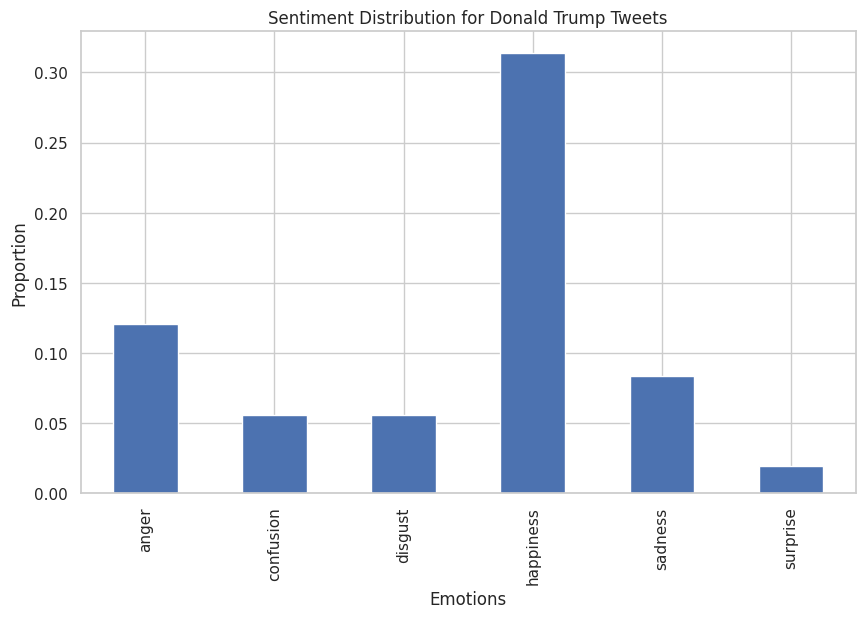

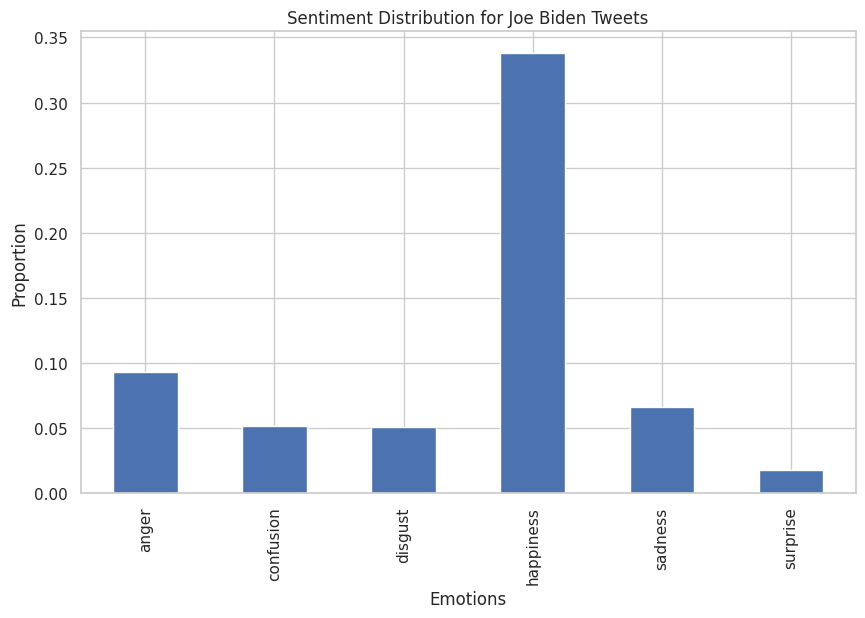

All tweets with analysis have been saved to 'donald_stock_analysis.csv' and 'joe_stock_analysis.csv'.


In [ ]:
import pandas as pd
import numpy as np
import re
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import matplotlib.pyplot as plt
from concurrent.futures import ThreadPoolExecutor, as_completed

# Download VADER lexicon
nltk.download('vader_lexicon')

# Preprocess Tweets
def preprocess_tweet(tweet):
    tweet = re.sub(r'http\S+|www\S+|https\S+', '', tweet, flags=re.MULTILINE)
    tweet = re.sub(r'\@\w+', '', tweet)  # Remove mentions
    tweet = re.sub(r'\#', '', tweet)  # Remove hashtags
    tweet = re.sub(r'[^\w\s]', '', tweet)  # Remove punctuation
    tweet = tweet.lower()
    return tweet

# Emotion keywords dictionary
emotions_keywords = {
    'anger': [
        'angry', 'sell', 'mad', 'furious', 'hate', 'bear', 'bubble', 'bearish', 'overvalued', 'overbought',
        'overpriced', 'expensive', 'downward', 'falling', 'sold', 'low', 'miss', 'resistance', 'squeeze',
        'cover', 'seller', 'rage', 'annoyed', 'crash', '!!!', '😠', '😡', '🤬', '👿', '💢', 'fake', 'decline',
        'drop', '📉', 'fraud', 'rigged', 'scam', 'bias', 'shit', 'wrong', 'suppression', 'censorship',
        'blocking', 'suppression', 'bullshit', 'liars', 'traitors', 'falsehoods', 'frauds', 'outrage',
        'attack', 'fail', 'terrible', 'disastrous'
    ],
    'happiness': [
        'happy', 'buy', 'bull', 'long', 'support', 'undervalued', 'underpriced', 'cheap', 'upward', 'rising',
        'trend', 'moon', 'rocket', 'hold', 'breakout', 'call', 'beat', 'buying', 'holding', 'high', 'profit',
        'joy', 'glad', 'delighted', 'love', 'great', '😊', '😁', '😃', '😄', '😆', '😂', '🤗', '😍', '😇', '🥰',
        'risen', 'better', 'gain', '✅', '📈', '❤️', '🚀', '🍎', '💰', 'win', 'victory', 'proud', 'cheer', 'unite',
        'celebrate', 'boost', 'RIGHT', 'elect', 'fantastic', 'amazing', 'wonderful', 'pleased'
    ],
    'sadness': [
        'sad', 'unhappy', 'short', 'miss', 'depressed', 'down', '😢', '😭', '😞', '😔', '😟', '😿', '💔',
        'undervalued', 'misunderstood', 'loss', 'fall', 'decrease', 'dip', 'neutral', 'steady', 'stable',
        'even', 'calm', 'balanced', 'level', 'flat', '😐', 'defeat', 'failures', 'cried', 'died', 'lonely',
        'failed', 'dark', 'crying'
    ],
    'surprise': [
        'surprised', 'shocked', 'breakout', 'moon', 'rocket', 'beat', 'amazed', 'astonished', '!', '😲',
        '😯', '😮', '😱', '🙀', '😳', 'unveiled', 'earnings', 'surge', 'spike', 'unexpected', 'shock',
        '🎯', '➡️', 'unbelievable', 'breaking', 'prove', 'proof', 'literally', 'bombshell', 'expose',
        'revealed'
    ],
    'neutral': [
        'neutral', 'steady', 'stable', 'even', 'calm', 'balanced', 'level', 'flat', '😐', 'email', 'video',
        'link', 'watch', 'story', 'article', 'media', 'news', 'read', 'share', 'report', 'post', 'tweet',
        'comment', 'election', 'debate', 'vote', 'luxurious', 'salary', 'campaign', 'community', 'connection',
        'signature'
    ],
    'confusion': [
        'confused', 'lost', 'squeeze', 'cover', 'bear', 'bubble', 'bearish', 'overvalued', 'overbought',
        'overpriced', 'expensive', 'downward', 'falling', 'low', 'miss', 'resistance', 'uncertain', '?', '??',
        'what...?', '😕', '😵', '🤔', '🤯', 'trendless', 'volatile', 'swing', 'fluctuate', 'confuse',  '🛒',
        'unclear', 'ambiguous', 'don’t understand', 'huh', 'think', 'uncertain', 'unclear', 'unsure', 'complicated',
        'perplexed'
    ],
    'disgust': [
        'disgust', 'nasty', 'lying', 'corruption', 'crooks', 'criminal', 'dirty', 'horrible', 'terrible', 'trash',
        'liar', 'crap', 'shit', 'dog face', 'pony soldier', 'censoring', 'assholes', 'crooked', 'bribes', 'wrong',
        'bias', 'cover up', 'scheme', 'suppression', 'pieces of shit', 'sell out', 'dementia', 'disgusting',
        'disgrace', 'traitor', 'fraud', 'sick', 'pathetic', 'absurdity', 'cheat', '🤮', '💩', '🤢', '🤧', '😷'
    ]
}

# Detect Emotions (excluding neutral)
def detect_emotion(tweet, emotions_keywords):
    detected_emotions = []
    for emotion, keywords in emotions_keywords.items():
        if any(keyword in tweet for keyword in keywords):
            detected_emotions.append(emotion)
    return detected_emotions if detected_emotions else []

# Analyze Sentiment and Emotion
def analyze_sentiment_and_emotion(tweet, emotions_keywords):
    analyzer = SentimentIntensityAnalyzer()
    sentiment = analyzer.polarity_scores(tweet)
    emotions = detect_emotion(tweet, emotions_keywords)
    return sentiment, emotions

# Extract Analysis Results
def extract_analysis_results(df):
    df['Positive'] = df['analysis'].apply(lambda x: x[0]['pos'])
    df['Negative'] = df['analysis'].apply(lambda x: x[0]['neg'])
    df['Neutral'] = df['analysis'].apply(lambda x: x[0]['neu'])
    df['Compound'] = df['analysis'].apply(lambda x: x[0]['compound'])
    df['Emotions'] = df['analysis'].apply(lambda x: x[1])

# Handle missing values
def handle_missing_values(df):
    for column in df.select_dtypes(include=[np.number]).columns:
        df[column].fillna(0, inplace=True)
    for column in df.select_dtypes(include=[object]).columns:
        df[column].fillna('Unknown', inplace=True)
    for column in df.select_dtypes(include=[np.datetime64]).columns:
        df[column].fillna(method='ffill', inplace=True)
        df[column].fillna(method='bfill', inplace=True)
    return df

# Load the CSV files
donald_stock = pd.read_csv('donald_stock.csv', engine='python')
joe_stock = pd.read_csv('joe_stock.csv', engine='python')

# Ensure 'created_at' is in datetime format before handling missing values
donald_stock['created_at'] = pd.to_datetime(donald_stock['created_at'], errors='coerce')
joe_stock['created_at'] = pd.to_datetime(joe_stock['created_at'], errors='coerce')

# Handle missing values for donald_stock and joe_stock
donald_stock = handle_missing_values(donald_stock)
joe_stock = handle_missing_values(joe_stock)

# Preprocess Tweets
donald_stock['preprocessed_tweet'] = donald_stock['tweet'].astype(str).apply(preprocess_tweet)
joe_stock['preprocessed_tweet'] = joe_stock['tweet'].astype(str).apply(preprocess_tweet)

# Optimize Sentiment and Emotion Analysis
def parallel_analyze_sentiment_and_emotion(df, emotions_keywords):
    results = []
    with ThreadPoolExecutor(max_workers=4) as executor:
        future_to_tweet = {executor.submit(analyze_sentiment_and_emotion, tweet, emotions_keywords): tweet for tweet in df['preprocessed_tweet']}
        for future in as_completed(future_to_tweet):
            try:
                results.append(future.result())
            except Exception as exc:
                print(f'Generated an exception: {exc}')
    return results

# Apply sentiment analysis and emotion detection in parallel
donald_stock['analysis'] = parallel_analyze_sentiment_and_emotion(donald_stock, emotions_keywords)
joe_stock['analysis'] = parallel_analyze_sentiment_and_emotion(joe_stock, emotions_keywords)

# Extract sentiment scores and detected emotions into separate columns
extract_analysis_results(donald_stock)
extract_analysis_results(joe_stock)

# Function to visualize sentiment distribution (excluding neutral)
def plot_sentiment_distribution(df, title):
    sentiment_counts = df['Emotions'].explode().value_counts(normalize=True).drop('neutral', errors='ignore').sort_index()
    sentiment_counts.plot(kind='bar', figsize=(10, 6), title=title, xlabel='Emotions', ylabel='Proportion')
    plt.show()

# Plot sentiment distribution for Donald Trump tweets
plot_sentiment_distribution(donald_stock, 'Sentiment Distribution for Donald Trump Tweets')

# Plot sentiment distribution for Joe Biden tweets
plot_sentiment_distribution(joe_stock, 'Sentiment Distribution for Joe Biden Tweets')

# Save the full tweets and analysis to CSV files for further inspection
donald_stock.to_csv('donald_stock_analysis.csv', index=False)
joe_stock.to_csv('joe_stock_analysis.csv', index=False)

print("All tweets with analysis have been saved to 'donald_stock_analysis.csv' and 'joe_stock_analysis.csv'.")


<ipython-input-104-46c09cc0fd99>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hashtag_donaldtrump_dates['tweet'] = hashtag_donaldtrump_dates['tweet'].astype(str).apply(preprocess_tweet)
<ipython-input-104-46c09cc0fd99>:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hashtag_joebiden_dates['tweet'] = hashtag_joebiden_dates['tweet'].astype(str).apply(preprocess_tweet)
<ipython-input-104-46c09cc0fd99>:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

                                                    tweet  Positive  Negative  \
137056  icymi here are trumps daily job approval ratin...     0.317     0.000   
137057     2 and can do 25 rallies in a days time or s...     0.000     0.000   
412829  actual footage of trump voters constantly tryi...     0.000     0.156   
412830  sorry folks it takes more than being a number ...     0.153     0.080   
458263  it is officially 24 hours until the first poll...     0.032     0.114   

        Neutral  Compound                       Emotions  
137056    0.683    0.6705                      [neutral]  
137057    1.000    0.0000  [happiness, sadness, neutral]  
412829    0.844   -0.5423             [neutral, disgust]  
412830    0.767    0.4563    [anger, happiness, neutral]  
458263    0.854   -0.6170    [anger, happiness, disgust]  
                                                    tweet  Positive  Negative  \
90855                              voted already joebiden     0.000     0.000 

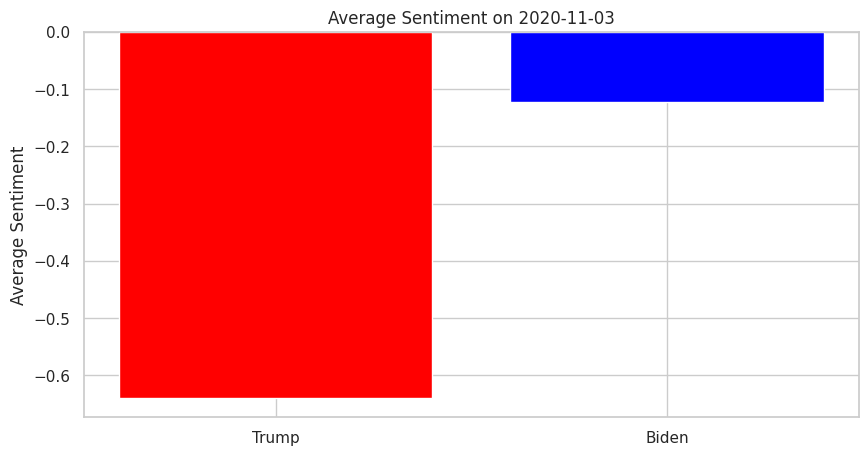

In [ ]:
import pandas as pd
from concurrent.futures import ThreadPoolExecutor, as_completed
from multiprocessing import cpu_count
import matplotlib.pyplot as plt

specific_dates = ['2020-11-02', '2020-11-03', '2020-11-04', '2020-10-15', '2020-10-22']
specific_dates = pd.to_datetime(specific_dates)

# Convert 'created_at' columns to datetime and handle errors
hashtag_donaldtrump['created_at'] = pd.to_datetime(hashtag_donaldtrump['created_at'], errors='coerce')
hashtag_joebiden['created_at'] = pd.to_datetime(hashtag_joebiden['created_at'], errors='coerce')

# Drop rows with NaT in 'created_at' column
hashtag_donaldtrump = hashtag_donaldtrump.dropna(subset=['created_at'])
hashtag_joebiden = hashtag_joebiden.dropna(subset=['created_at'])

# Extract data for specific dates
hashtag_donaldtrump_dates = hashtag_donaldtrump[hashtag_donaldtrump['created_at'].isin(specific_dates)]
hashtag_joebiden_dates = hashtag_joebiden[hashtag_joebiden['created_at'].isin(specific_dates)]

# Preprocess Tweets
hashtag_donaldtrump_dates['tweet'] = hashtag_donaldtrump_dates['tweet'].astype(str).apply(preprocess_tweet)
hashtag_joebiden_dates['tweet'] = hashtag_joebiden_dates['tweet'].astype(str).apply(preprocess_tweet)

# Optimize Sentiment and Emotion Analysis
def parallel_analyze_sentiment_and_emotion(df, emotions_keywords):
    results = []
    with ThreadPoolExecutor(max_workers=cpu_count()) as executor:
        future_to_tweet = {executor.submit(analyze_sentiment_and_emotion, tweet, emotions_keywords): tweet for tweet in df['tweet']}
        for future in as_completed(future_to_tweet):
            try:
                results.append(future.result())
            except Exception as exc:
                print(f'Generated an exception: {exc}')
    return results

# Apply sentiment analysis and emotion detection in parallel
hashtag_donaldtrump_dates['analysis'] = parallel_analyze_sentiment_and_emotion(hashtag_donaldtrump_dates, emotions_keywords)
hashtag_joebiden_dates['analysis'] = parallel_analyze_sentiment_and_emotion(hashtag_joebiden_dates, emotions_keywords)

# Extract sentiment scores and detected emotions into separate columns
extract_analysis_results(hashtag_donaldtrump_dates)
extract_analysis_results(hashtag_joebiden_dates)

# Print the first few rows to check the results
print(hashtag_donaldtrump_dates[['tweet', 'Positive', 'Negative', 'Neutral', 'Compound', 'Emotions']].head())
print(hashtag_joebiden_dates[['tweet', 'Positive', 'Negative', 'Neutral', 'Compound', 'Emotions']].head())

def visualize_average_sentiment(data_trump, data_biden, date):
    avg_sentiment_trump = data_trump[data_trump['created_at'] == date]['Compound'].mean()
    avg_sentiment_biden = data_biden[data_biden['created_at'] == date]['Compound'].mean()

    plt.figure(figsize=(10, 5))
    plt.bar(['Trump', 'Biden'], [avg_sentiment_trump, avg_sentiment_biden], color=['red', 'blue'])
    plt.title(f'Average Sentiment on {date.strftime("%Y-%m-%d")}')
    plt.ylabel('Average Sentiment')
    plt.show()

election_day = pd.to_datetime('2020-11-03')
visualize_average_sentiment(hashtag_donaldtrump_dates, hashtag_joebiden_dates, election_day)


 Visualizing Average Sentiment for Trump and Biden on a Specific Date

In [ ]:

# Specific dates for analysis
specific_dates = ['2020-11-02', '2020-11-03', '2020-11-04', '2020-10-15', '2020-10-22']

# Convert to datetime for filtering
specific_dates = pd.to_datetime(specific_dates)

# Ensure 'created_at' is in datetime format
hashtag_donaldtrump['created_at'] = pd.to_datetime(hashtag_donaldtrump['created_at'])
hashtag_joebiden['created_at'] = pd.to_datetime(hashtag_joebiden['created_at'])

# Extract data for specific dates
hashtag_donaldtrump_dates = hashtag_donaldtrump[hashtag_donaldtrump['created_at'].isin(specific_dates)]
hashtag_joebiden_dates = hashtag_joebiden[hashtag_joebiden['created_at'].isin(specific_dates)]

# Preprocess Tweets
hashtag_donaldtrump_dates['tweet'] = hashtag_donaldtrump_dates['tweet'].astype(str).apply(preprocess_tweet)
hashtag_joebiden_dates['tweet'] = hashtag_joebiden_dates['tweet'].astype(str).apply(preprocess_tweet)

# Optimize Sentiment and Emotion Analysis
def parallel_analyze_sentiment_and_emotion(df, emotions_keywords):
    results = []
    with ThreadPoolExecutor(max_workers=cpu_count()) as executor:
        future_to_tweet = {executor.submit(analyze_sentiment_and_emotion, tweet, emotions_keywords): tweet for tweet in df['tweet']}
        for future in as_completed(future_to_tweet):
            try:
                results.append(future.result())
            except Exception as exc:
                print(f'Generated an exception: {exc}')
    return results

# Apply sentiment analysis and emotion detection in parallel
hashtag_donaldtrump_dates['analysis'] = parallel_analyze_sentiment_and_emotion(hashtag_donaldtrump_dates, emotions_keywords)
hashtag_joebiden_dates['analysis'] = parallel_analyze_sentiment_and_emotion(hashtag_joebiden_dates, emotions_keywords)

# Extract sentiment scores and detected emotions into separate columns
extract_analysis_results(hashtag_donaldtrump_dates)
extract_analysis_results(hashtag_joebiden_dates)

# Print the first few rows to check the results
print(hashtag_donaldtrump_dates[['tweet', 'Positive', 'Negative', 'Neutral', 'Compound', 'Emotions']].head())
print(hashtag_joebiden_dates[['tweet', 'Positive', 'Negative', 'Neutral', 'Compound', 'Emotions']].head())


<ipython-input-105-84ae739dfcc3>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hashtag_donaldtrump_dates['tweet'] = hashtag_donaldtrump_dates['tweet'].astype(str).apply(preprocess_tweet)
<ipython-input-105-84ae739dfcc3>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hashtag_joebiden_dates['tweet'] = hashtag_joebiden_dates['tweet'].astype(str).apply(preprocess_tweet)


                                                    tweet  Positive  Negative  \
137056  icymi here are trumps daily job approval ratin...     0.317     0.000   
137057     2 and can do 25 rallies in a days time or s...     0.000     0.000   
412829  actual footage of trump voters constantly tryi...     0.032     0.114   
412830  sorry folks it takes more than being a number ...     0.000     0.156   
458263  it is officially 24 hours until the first poll...     0.153     0.080   

        Neutral  Compound                       Emotions  
137056    0.683    0.6705                      [neutral]  
137057    1.000    0.0000  [happiness, sadness, neutral]  
412829    0.854   -0.6170    [anger, happiness, disgust]  
412830    0.844   -0.5423             [neutral, disgust]  
458263    0.767    0.4563    [anger, happiness, neutral]  
                                                    tweet  Positive  Negative  \
90855                              voted already joebiden     0.000     0.293 

<ipython-input-105-84ae739dfcc3>:32: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hashtag_donaldtrump_dates['analysis'] = parallel_analyze_sentiment_and_emotion(hashtag_donaldtrump_dates, emotions_keywords)
<ipython-input-105-84ae739dfcc3>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hashtag_joebiden_dates['analysis'] = parallel_analyze_sentiment_and_emotion(hashtag_joebiden_dates, emotions_keywords)
<ipython-input-95-07501c397e32>:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of 

Word Cloud of Positive and Negative Tweets

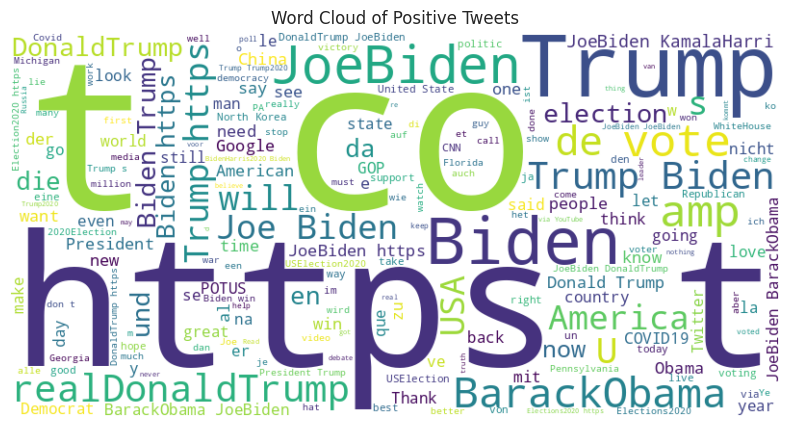

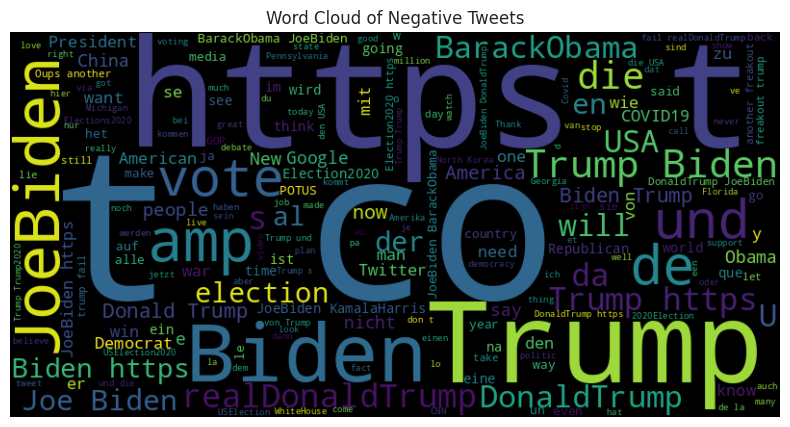

In [ ]:
df = pd.concat([joe_stock, donald_stock])
df['created_at'] = pd.to_datetime(df['created_at'], errors='coerce')
tweet_data = df.set_index('created_at')

# Separate positive and negative tweets based on the Compound score
positive_tweets = tweet_data[tweet_data['Compound'] > 0]['tweet']
negative_tweets = tweet_data[tweet_data['Compound'] < 0]['tweet']

# Generate word clouds
positive_wordcloud = WordCloud(width=800, height=400, background_color='white').generate(' '.join(positive_tweets))
negative_wordcloud = WordCloud(width=800, height=400, background_color='black').generate(' '.join(negative_tweets))
plt.figure(figsize=(10, 5))
plt.imshow(positive_wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Positive Tweets')
plt.show()
plt.figure(figsize=(10, 5))
plt.imshow(negative_wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Negative Tweets')
plt.show()


<ipython-input-106-8d6a0c964e61>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hashtag_joebiden_dates['tweet'] = hashtag_joebiden_dates['tweet'].astype(str).apply(preprocess_tweet)


                                                    tweet  Positive  Negative  \
137056  icymi here are trumps daily job approval ratin...     0.000     0.000   
137057     2 and can do 25 rallies in a days time or s...     0.317     0.000   
412829  actual footage of trump voters constantly tryi...     0.000     0.156   
412830  sorry folks it takes more than being a number ...     0.153     0.080   
458263  it is officially 24 hours until the first poll...     0.032     0.114   

        Neutral  Compound                       Emotions  
137056    1.000    0.0000  [happiness, sadness, neutral]  
137057    0.683    0.6705                      [neutral]  
412829    0.844   -0.5423             [neutral, disgust]  
412830    0.767    0.4563    [anger, happiness, neutral]  
458263    0.854   -0.6170    [anger, happiness, disgust]  
                                                    tweet  Positive  Negative  \
90855                              voted already joebiden     0.000     0.293 

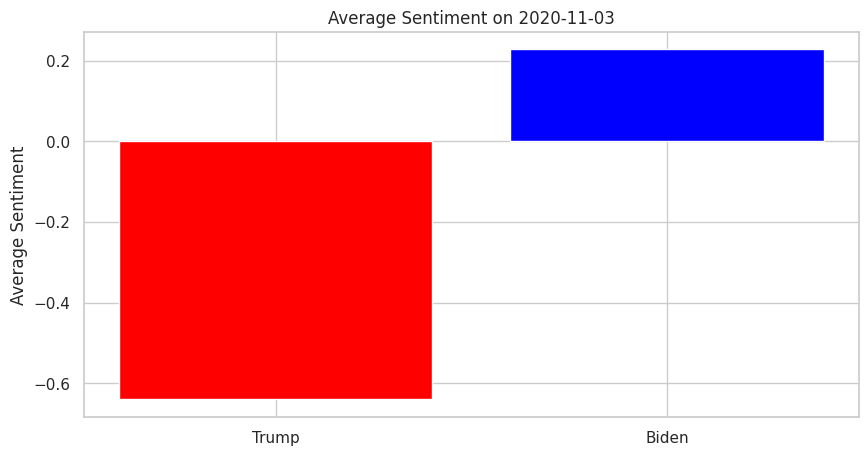

In [ ]:

# Specific dates for analysis
specific_dates = ['2020-11-02', '2020-11-03', '2020-11-04', '2020-10-15', '2020-10-22']

# Convert to datetime for filtering
specific_dates = pd.to_datetime(specific_dates)

# Attempt to convert the 'created_at' column to datetime, invalid parsing will be set as NaT
hashtag_donaldtrump['created_at'] = pd.to_datetime(hashtag_donaldtrump['created_at'], errors='coerce')
hashtag_joebiden['created_at'] = pd.to_datetime(hashtag_joebiden['created_at'], errors='coerce')

# Filter out rows with NaT in 'created_at' due to invalid dates
hashtag_donaldtrump = hashtag_donaldtrump.dropna(subset=['created_at'])
hashtag_joebiden = hashtag_joebiden.dropna(subset=['created_at'])

# Preprocess Tweets
hashtag_donaldtrump_dates['tweet'] = hashtag_donaldtrump_dates['tweet'].astype(str).apply(preprocess_tweet)
hashtag_joebiden_dates['tweet'] = hashtag_joebiden_dates['tweet'].astype(str).apply(preprocess_tweet)

# Optimize Sentiment and Emotion Analysis
def parallel_analyze_sentiment_and_emotion(df, emotions_keywords):
    results = []
    with ThreadPoolExecutor(max_workers=cpu_count()) as executor:
        future_to_tweet = {executor.submit(analyze_sentiment_and_emotion, tweet, emotions_keywords): tweet for tweet in df['tweet']}
        for future in as_completed(future_to_tweet):
            try:
                results.append(future.result())
            except Exception as exc:
                print(f'Generated an exception: {exc}')
    return results

# Apply sentiment analysis and emotion detection in parallel
hashtag_donaldtrump_dates['analysis'] = parallel_analyze_sentiment_and_emotion(hashtag_donaldtrump_dates, emotions_keywords)
hashtag_joebiden_dates['analysis'] = parallel_analyze_sentiment_and_emotion(hashtag_joebiden_dates, emotions_keywords)

# Extract sentiment scores and detected emotions into separate columns
extract_analysis_results(hashtag_donaldtrump_dates)
extract_analysis_results(hashtag_joebiden_dates)

# Print the first few rows to check the results
print(hashtag_donaldtrump_dates[['tweet', 'Positive', 'Negative', 'Neutral', 'Compound', 'Emotions']].head())
print(hashtag_joebiden_dates[['tweet', 'Positive', 'Negative', 'Neutral', 'Compound', 'Emotions']].head())
# Function to visualize average sentiment for Trump and Biden on a specific date
def visualize_average_sentiment(data_trump, data_biden, date):
    # Calculate average sentiment for Trump on the specified date
    avg_sentiment_trump = data_trump[data_trump['created_at'] == date]['Compound'].mean()

    # Calculate average sentiment for Biden on the specified date
    avg_sentiment_biden = data_biden[data_biden['created_at'] == date]['Compound'].mean()

    # Plot the average sentiment
    plt.figure(figsize=(10, 5))
    plt.bar(['Trump', 'Biden'], [avg_sentiment_trump, avg_sentiment_biden], color=['red', 'blue'])
    plt.title(f'Average Sentiment on {date.strftime("%Y-%m-%d")}')
    plt.ylabel('Average Sentiment')
    plt.show()

# Election Day Sentiment Visualization (November 3, 2020)
election_day = pd.to_datetime('2020-11-03')
visualize_average_sentiment(hashtag_donaldtrump_dates, hashtag_joebiden_dates, election_day)


Visualizing Emotion Distribution for Trump and Biden on Election Day

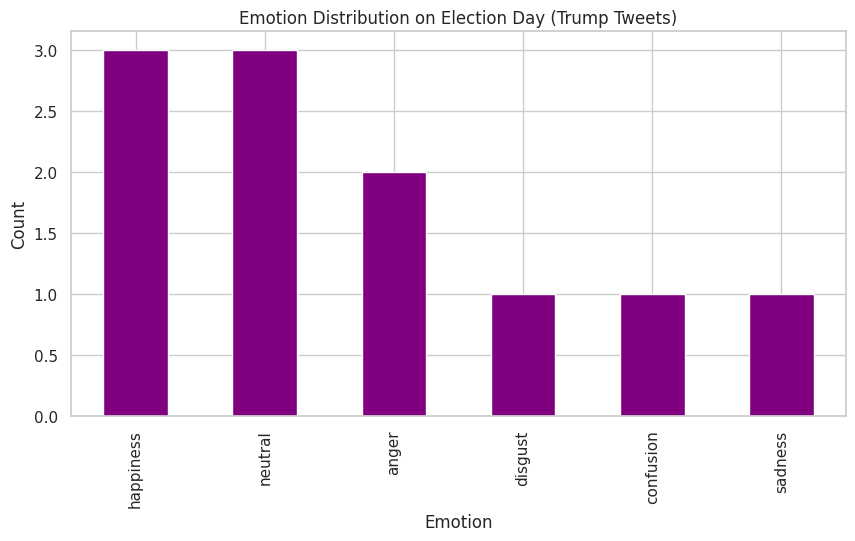

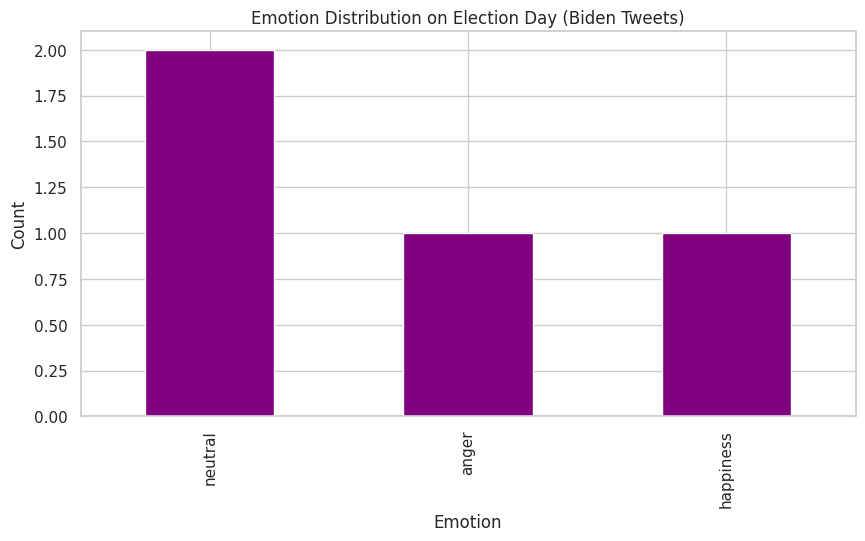

In [ ]:
# Function to visualize the distribution of emotions in the dataset
def visualize_emotion_distribution(data, title):
    # Explode the 'Emotions' column to count each emotion separately
    emotions = data['Emotions'].explode().value_counts()

    # Plot the distribution of emotions
    plt.figure(figsize=(10, 5))
    emotions.plot(kind='bar', color='purple')
    plt.title(title)
    plt.ylabel('Count')
    plt.xlabel('Emotion')
    plt.show()

# Define the date for Election Day (November 3, 2020)
election_day = pd.to_datetime('2020-11-03')

# Visualize emotion distribution for Trump tweets on Election Day
visualize_emotion_distribution(
    hashtag_donaldtrump_dates[hashtag_donaldtrump_dates['created_at'] == election_day],
    'Emotion Distribution on Election Day (Trump Tweets)'
)

# Visualize emotion distribution for Biden tweets on Election Day
visualize_emotion_distribution(
    hashtag_joebiden_dates[hashtag_joebiden_dates['created_at'] == election_day],
    'Emotion Distribution on Election Day (Biden Tweets)'
)


 Sentiment and Emotion Analysis for Election Day Tweets Related to Donald Trump and Joe Biden

Number of Donald Trump-related tweets on election day: 2846
Number of Joe Biden-related tweets on election day: 1755


<ipython-input-108-19ea40c21216>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  donald_stock_election_day['analysis'] = parallel_analyze_sentiment_and_emotion(donald_stock_election_day, emotions_keywords)
<ipython-input-108-19ea40c21216>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  joe_stock_election_day['analysis'] = parallel_analyze_sentiment_and_emotion(joe_stock_election_day, emotions_keywords)
<ipython-input-95-07501c397e32>:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of 

Analyzed tweets from Donald Trump on election day:
                                                   tweet  Positive  Negative  \
19449  @realDonaldTrump The only DEATH SENTENCE being...     0.000     0.115   
19450  @Infos_Googeln @Gina_J12 @ZDF @RTLde Bei @RTLd...     0.000     0.000   
19451  #NorthCarolina #ncpol #Trump https://t.co/QMck...     0.000     0.000   
19452  Europe is weak and fully cuckolded by global c...     0.115     0.192   
19453  @DeweyHaveTo @BarackObama  sent me here! Thank...     0.000     0.117   

       Neutral  Compound                     Emotions  
19449    0.885   -0.5994                    [neutral]  
19450    1.000    0.0000                    [neutral]  
19451    1.000    0.0000                  [confusion]  
19452    0.692   -0.6981                   [surprise]  
19453    0.883   -0.5423  [anger, sadness, confusion]   

Analyzed tweets from Joe Biden on election day:
                                                   tweet  Positive  Negative  \
12

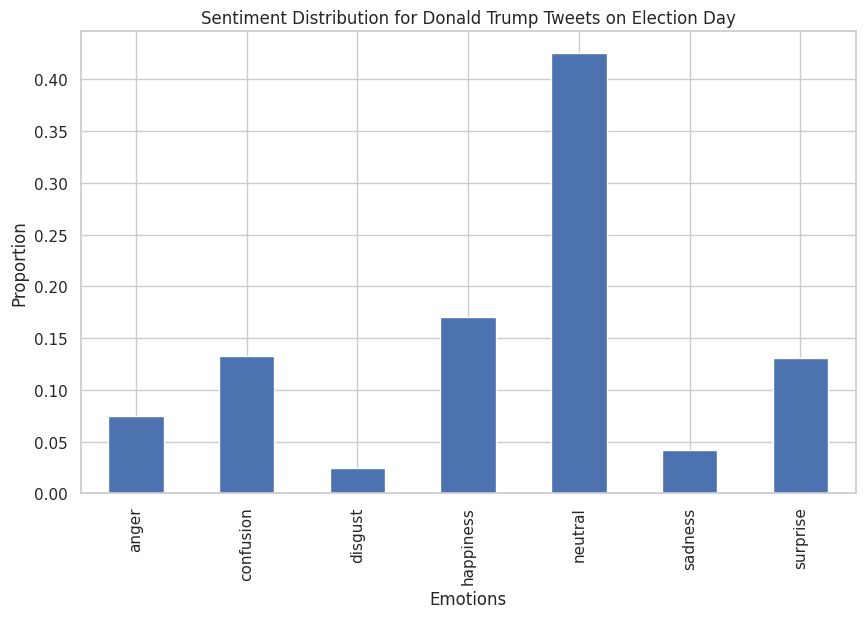

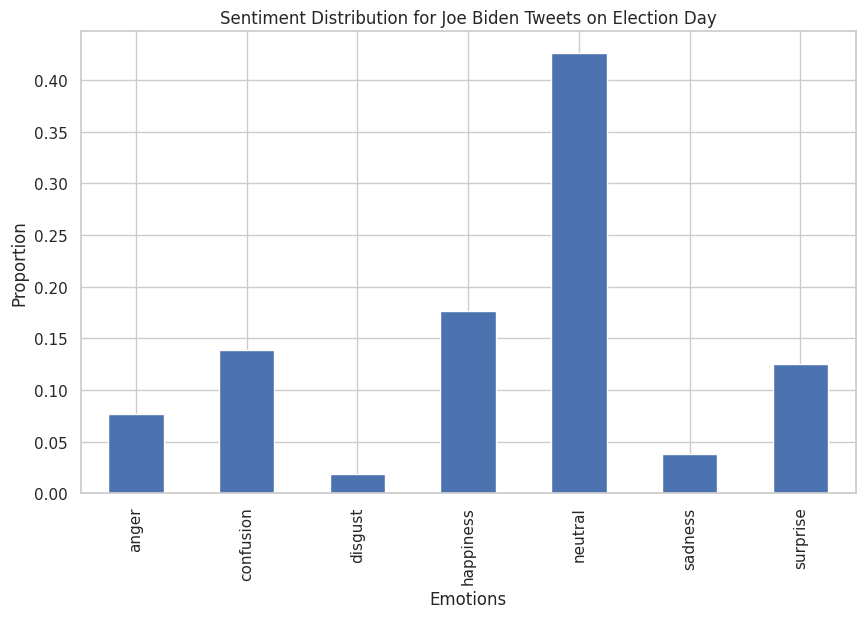

In [ ]:


import pandas as pd
import matplotlib.pyplot as plt

# Define the date for Election Day (November 3, 2020)
election_day = pd.to_datetime('2020-11-03')
donald_stock_election_day = donald_stock[donald_stock['created_at'].dt.date == election_day.date()]
joe_stock_election_day = joe_stock[joe_stock['created_at'].dt.date == election_day.date()]
print(f"Number of Donald Trump-related tweets on election day: {donald_stock_election_day.shape[0]}")
print(f"Number of Joe Biden-related tweets on election day: {joe_stock_election_day.shape[0]}")

# Analyze sentiment and emotion for each tweet on election day
donald_stock_election_day['analysis'] = parallel_analyze_sentiment_and_emotion(donald_stock_election_day, emotions_keywords)
joe_stock_election_day['analysis'] = parallel_analyze_sentiment_and_emotion(joe_stock_election_day, emotions_keywords)
extract_analysis_results(donald_stock_election_day)
extract_analysis_results(joe_stock_election_day)

# Display analyzed tweets from Donald Trump and Joe Biden on election day
print("Analyzed tweets from Donald Trump on election day:")
print(donald_stock_election_day[['tweet', 'Positive', 'Negative', 'Neutral', 'Compound', 'Emotions']].head(), "\n")
print("Analyzed tweets from Joe Biden on election day:")
print(joe_stock_election_day[['tweet', 'Positive', 'Negative', 'Neutral', 'Compound', 'Emotions']].head(), "\n")

# Function to visualize the sentiment distribution
def plot_sentiment_distribution(df, title):
    sentiment_counts = df['Emotions'].explode().value_counts(normalize=True).sort_index()
    sentiment_counts.plot(kind='bar', figsize=(10, 6), title=title, xlabel='Emotions', ylabel='Proportion')
    plt.show()
plot_sentiment_distribution(donald_stock_election_day, 'Sentiment Distribution for Donald Trump Tweets on Election Day')
plot_sentiment_distribution(joe_stock_election_day, 'Sentiment Distribution for Joe Biden Tweets on Election Day')


Distrubution of emotions

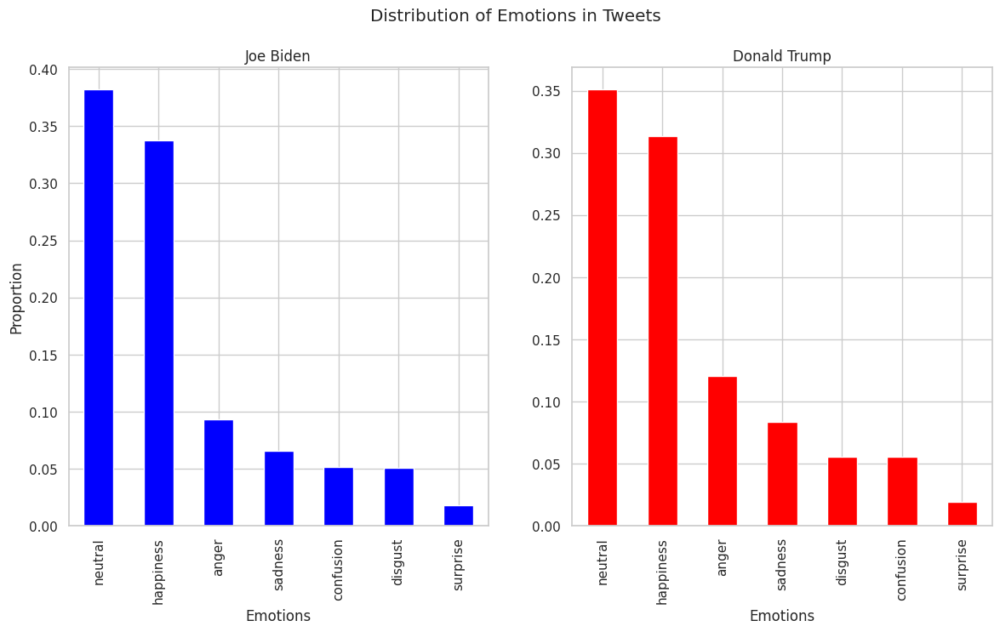

In [ ]:
# Function to calculate emotion distribution
def calculate_emotion_distribution(df):
    emotion_distribution = df['Emotions'].explode().value_counts(normalize=True)
    return emotion_distribution
emotion_distribution_joe = calculate_emotion_distribution(joe_stock)
emotion_distribution_donald = calculate_emotion_distribution(donald_stock)

# Visualization: Distribution of Emotions
fig, ax = plt.subplots(1, 2, figsize=(14, 7))
emotion_distribution_joe.plot(kind='bar', ax=ax[0], color='blue', title='Joe Biden')
emotion_distribution_donald.plot(kind='bar', ax=ax[1], color='red', title='Donald Trump')
fig.suptitle('Distribution of Emotions in Tweets')
ax[0].set_ylabel('Proportion')
plt.show()


Analysis of Tweet Activity During Debates

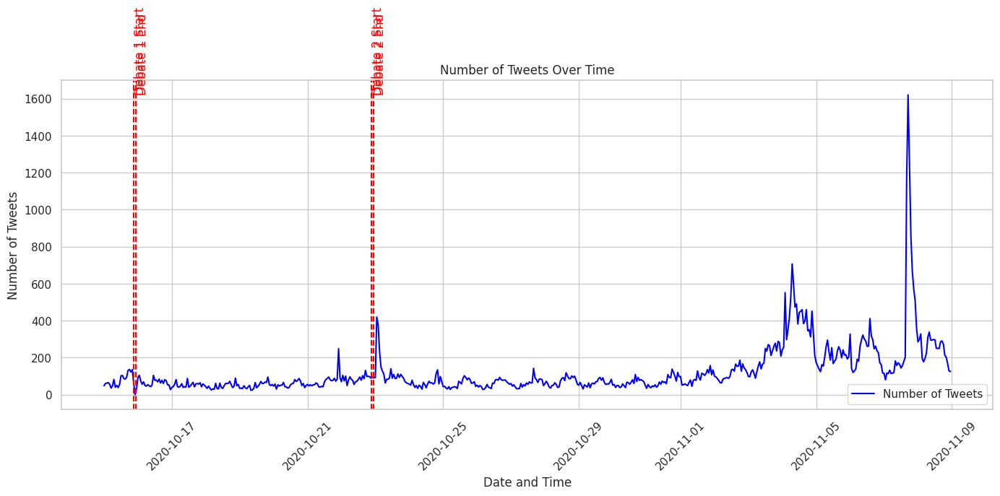

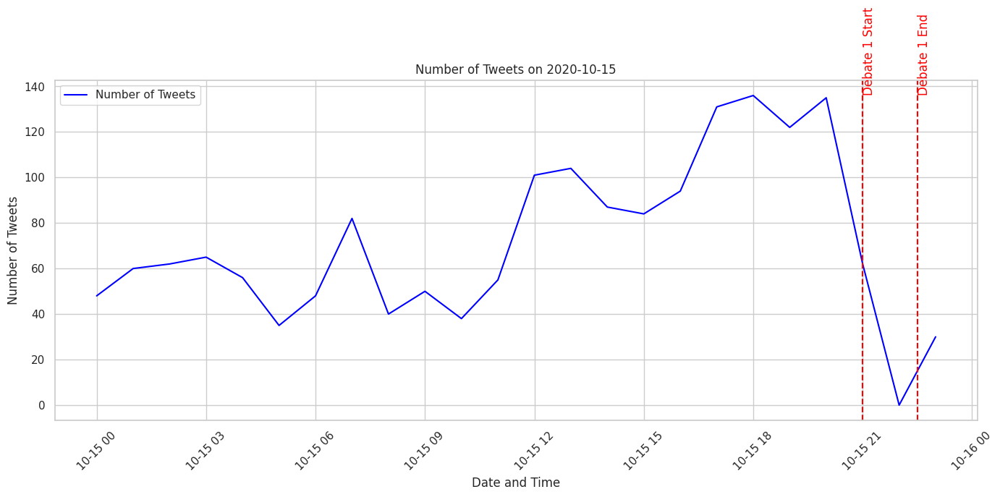

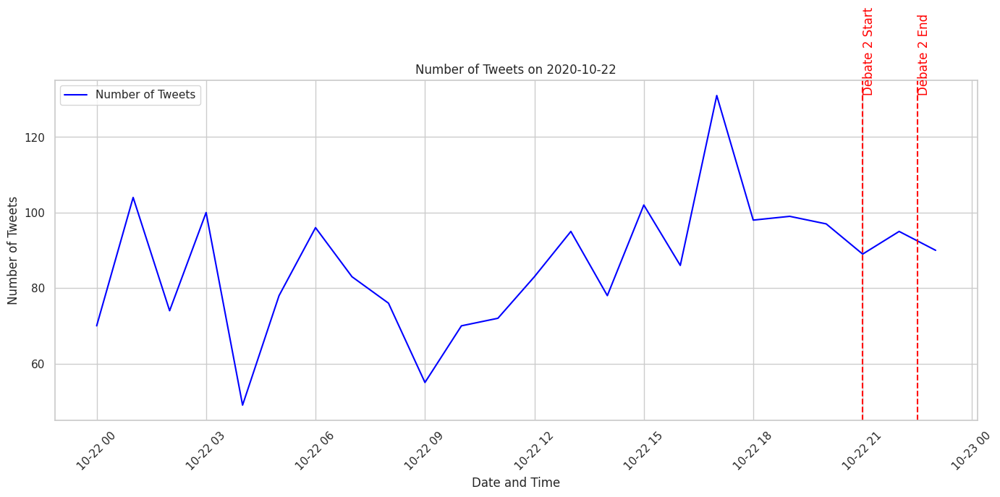

In [ ]:
tweet_data = pd.concat([donald_stock, joe_stock])
tweet_data.sort_values(by='created_at', inplace=True)
tweet_data.set_index('created_at', inplace=True)
tweets_per_hour = tweet_data.resample('H').size()

plt.figure(figsize=(14, 7))
plt.plot(tweets_per_hour.index, tweets_per_hour.values, label='Number of Tweets', color='blue')
significant_events = {
    'Debate 1 Start': '2020-10-15 21:00:00',
    'Debate 1 End': '2020-10-15 22:30:00',
    'Debate 2 Start': '2020-10-22 21:00:00',
    'Debate 2 End': '2020-10-22 22:30:00'
}

for event, datetime in significant_events.items():
    plt.axvline(pd.to_datetime(datetime), color='red', linestyle='dashed')
    plt.text(pd.to_datetime(datetime), max(tweets_per_hour.values), event, rotation=90, verticalalignment='bottom', color='red')
plt.title('Number of Tweets Over Time')
plt.xlabel('Date and Time')
plt.ylabel('Number of Tweets')
plt.legend()
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

# Function to plot tweets for a specific day with debate annotations
def plot_debate_day(day, event_name, event_start, event_end):
    # Filter tweets for the specific day
    start_date = pd.to_datetime(day + ' 00:00:00')
    end_date = pd.to_datetime(day + ' 23:59:59')
    tweets_day = tweet_data[start_date:end_date]
    tweets_per_hour = tweets_day.resample('H').size()
    plt.figure(figsize=(14, 7))
    plt.plot(tweets_per_hour.index, tweets_per_hour.values, label='Number of Tweets', color='blue')

    # Adding vertical dashed lines and annotations for the debate
    plt.axvline(pd.to_datetime(event_start), color='red', linestyle='dashed')
    plt.axvline(pd.to_datetime(event_end), color='red', linestyle='dashed')
    plt.text(pd.to_datetime(event_start), max(tweets_per_hour.values), f'{event_name} Start', rotation=90, verticalalignment='bottom', color='red')
    plt.text(pd.to_datetime(event_end), max(tweets_per_hour.values), f'{event_name} End', rotation=90, verticalalignment='bottom', color='red')

    # Formatting the plot
    plt.title(f'Number of Tweets on {day}')
    plt.xlabel('Date and Time')
    plt.ylabel('Number of Tweets')
    plt.legend()
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Define the specific days and event times
debate_1_day = '2020-10-15'
debate_1_start = '2020-10-15 21:00:00'
debate_1_end = '2020-10-15 22:30:00'

debate_2_day = '2020-10-22'
debate_2_start = '2020-10-22 21:00:00'
debate_2_end = '2020-10-22 22:30:00'

plot_debate_day(debate_1_day, 'Debate 1', debate_1_start, debate_1_end)
plot_debate_day(debate_2_day, 'Debate 2', debate_2_start, debate_2_end)


Analyzing and Correlating Sentiment in Election Day Tweets with Stock Prices

<ipython-input-111-eed46a8ccd97>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  donald_stock_election_day['analysis'] = donald_stock_election_day['preprocessed_tweet'].apply(
<ipython-input-111-eed46a8ccd97>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  joe_stock_election_day['analysis'] = joe_stock_election_day['preprocessed_tweet'].apply(
<ipython-input-95-07501c397e32>:88: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_ind

Correlation of sentiment with stock prices for Donald Trump related tweets on election day:
GOOG: {'Average Sentiment': Positive    0.054125
Negative    0.034486
Neutral     0.911382
Compound    0.030787
dtype: float64, 'Stock Price': 82.41670989990234}
AMZN: {'Average Sentiment': Positive    0.051714
Negative    0.010857
Neutral     0.937429
Compound    0.300929
dtype: float64, 'Stock Price': 152.42050170898438}
AAPL: {'Average Sentiment': Positive    0.112444
Negative    0.048556
Neutral     0.839000
Compound    0.341711
dtype: float64, 'Stock Price': 107.92691802978516}
TSLA: {'Average Sentiment': Positive    0.035353
Negative    0.024353
Neutral     0.940294
Compound   -0.015321
dtype: float64, 'Stock Price': 141.3000030517578}
VZ: {'Average Sentiment': Positive    0.067316
Negative    0.042098
Neutral     0.890594
Compound    0.063869
dtype: float64, 'Stock Price': 46.46067428588867}
KO: {'Average Sentiment': Positive    0.054577
Negative    0.051761
Neutral     0.893663
Compound 

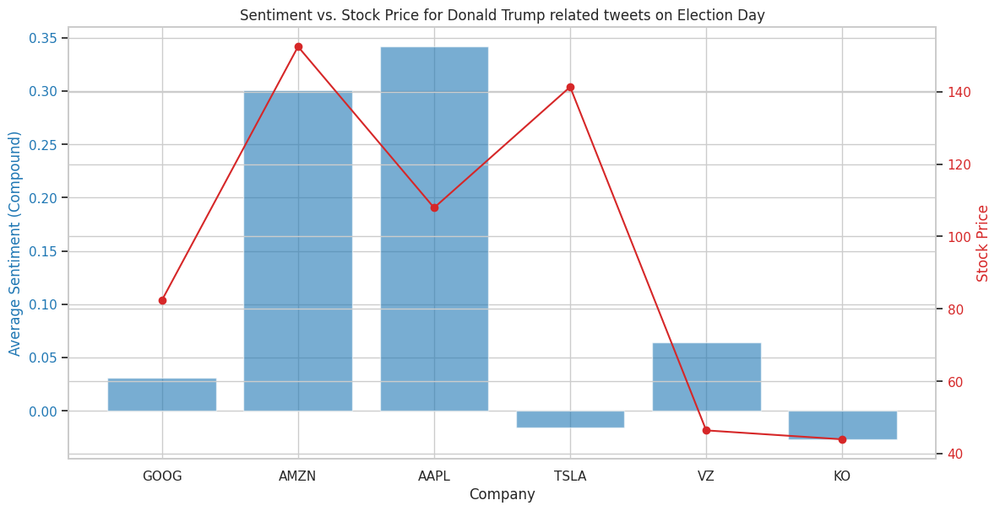

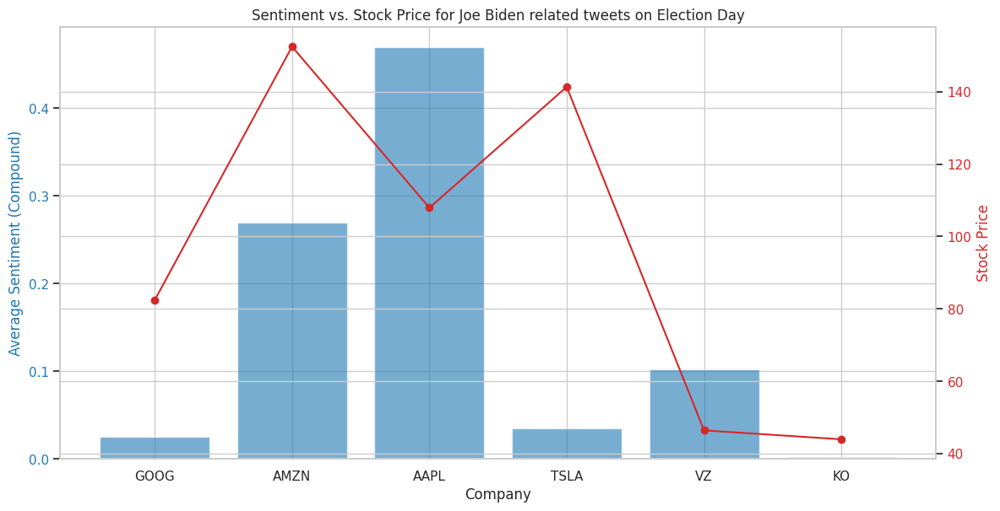

In [ ]:

companies = ['GOOG', 'AMZN', 'AAPL', 'TSLA', 'VZ', 'KO']

# Filter tweets mentioning the companies
def filter_company_mentions(df, companies):
    company_pattern = '|'.join(companies)
    return df[df['tweet'].str.contains(company_pattern, case=False, na=False)]
donald_stock_companies = filter_company_mentions(donald_stock, companies)
joe_stock_companies = filter_company_mentions(joe_stock, companies)

election_day = pd.to_datetime('2020-11-03')
donald_stock_election_day['analysis'] = donald_stock_election_day['preprocessed_tweet'].apply(
    lambda tweet: analyze_sentiment_and_emotion(tweet, emotions_keywords)
)
joe_stock_election_day['analysis'] = joe_stock_election_day['preprocessed_tweet'].apply(
    lambda tweet: analyze_sentiment_and_emotion(tweet, emotions_keywords)
)

# Extract sentiment scores and detected emotions into separate columns
extract_analysis_results(donald_stock_election_day)
extract_analysis_results(joe_stock_election_day)
tickers = 'GOOG AMZN AAPL TSLA VZ KO'
stock_data = yf.download(tickers, start='2020-11-03', end='2020-11-04')

# Select relevant columns and reset index to make 'Date' a column
stock_data = stock_data[['Adj Close', 'Volume']].reset_index()
stock_data_nov3 = stock_data[stock_data['Date'] == '2020-11-03']

# Function to correlate sentiment with stock price
def correlate_sentiment_with_stock(tweets_df, stock_df):
    correlation_results = {}
    for company in companies:
        company_tweets = tweets_df[tweets_df['tweet'].str.contains(company, case=False, na=False)]
        if not company_tweets.empty:
            avg_sentiment = company_tweets[['Positive', 'Negative', 'Neutral', 'Compound']].mean()
            stock_price = stock_df.loc[stock_df['Date'] == '2020-11-03', ('Adj Close', company)].values[0]
            correlation_results[company] = {
                'Average Sentiment': avg_sentiment,
                'Stock Price': stock_price
            }
    return correlation_results

# Correlate sentiment with stock prices for Donald Trump and Joe Biden related tweets
donald_stock_correlation = correlate_sentiment_with_stock(donald_stock_election_day, stock_data_nov3)
joe_stock_correlation = correlate_sentiment_with_stock(joe_stock_election_day, stock_data_nov3)
print("Correlation of sentiment with stock prices for Donald Trump related tweets on election day:")
for company, result in donald_stock_correlation.items():
    print(f"{company}: {result}")
print("\nCorrelation of sentiment with stock prices for Joe Biden related tweets on election day:")
for company, result in joe_stock_correlation.items():
    print(f"{company}: {result}")

# Function to visualize sentiment vs. stock price
def plot_sentiment_vs_stock(correlation_results, title):
    fig, ax1 = plt.subplots(figsize=(12, 6))

    companies = list(correlation_results.keys())
    sentiments = [result['Average Sentiment']['Compound'] for result in correlation_results.values()]
    stock_prices = [result['Stock Price'] for result in correlation_results.values()]

    ax1.set_xlabel('Company')
    ax1.set_ylabel('Average Sentiment (Compound)', color='tab:blue')
    ax1.bar(companies, sentiments, color='tab:blue', alpha=0.6, label='Sentiment')
    ax1.tick_params(axis='y', labelcolor='tab:blue')

    ax2 = ax1.twinx()
    ax2.set_ylabel('Stock Price', color='tab:red')
    ax2.plot(companies, stock_prices, color='tab:red', marker='o', label='Stock Price')
    ax2.tick_params(axis='y', labelcolor='tab:red')

    fig.tight_layout()
    plt.title(title)
    plt.show()


plot_sentiment_vs_stock(donald_stock_correlation, 'Sentiment vs. Stock Price for Donald Trump related tweets on Election Day')
plot_sentiment_vs_stock(joe_stock_correlation, 'Sentiment vs. Stock Price for Joe Biden related tweets on Election Day')


Visualizing Emotional Distribution of Tweets on Election Day

<ipython-input-112-88d0942e36a2>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['quarter_hour'] = df['created_at'].dt.floor('15T')


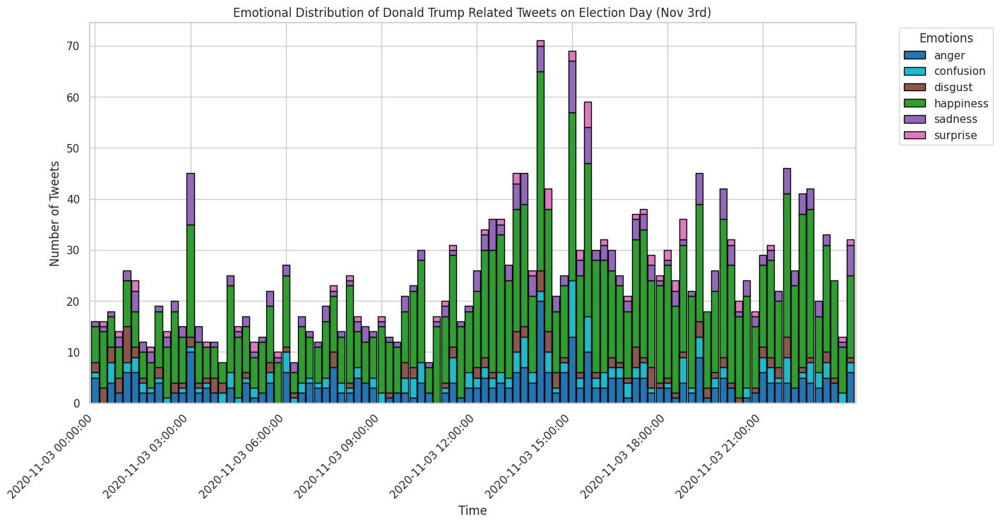

<ipython-input-112-88d0942e36a2>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['quarter_hour'] = df['created_at'].dt.floor('15T')


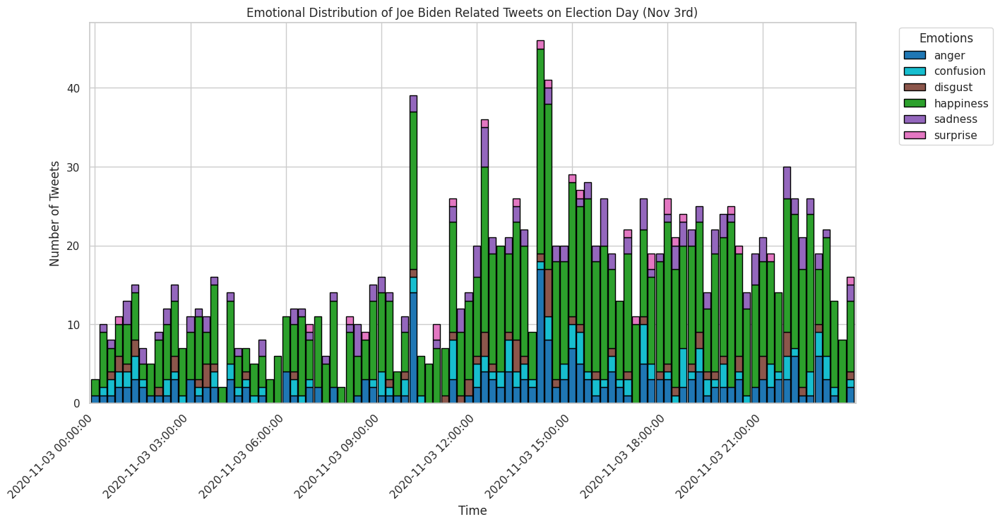

In [ ]:
# Define a function to plot the stacked bar chart for emotions
def plot_emotion_distribution(df, title):
    df['quarter_hour'] = df['created_at'].dt.floor('15T')
    emotions_df = df.explode('Emotions')
    emotions_df = emotions_df[emotions_df['Emotions'] != 'neutral']
    emotion_counts = emotions_df.groupby(['quarter_hour', 'Emotions']).size().unstack(fill_value=0)

    cool_colors = {
        'anger': '#1f77b4',
        'confusion': '#17becf',
        'disgust': '#8c564b',
        'happiness': '#2ca02c',
        'sadness': '#9467bd',
        'surprise': '#e377c2',
    }

    # Plot the stacked bar chart with black outlines around the bars
    ax = emotion_counts.plot(
        kind='bar',
        stacked=True,
        figsize=(14, 7),
        color=[cool_colors[col] for col in emotion_counts.columns],
        width=0.9,
        edgecolor='black'
    )

    # Customizing the x-axis ticks to show fewer labels
    ax.set_xticks(ax.get_xticks()[::len(ax.get_xticks()) // 8])
    ax.set_xticklabels([label.get_text() for label in ax.get_xticklabels()], rotation=45, ha='right')
    plt.title(title)
    plt.xlabel('Time')
    plt.ylabel('Number of Tweets')
    plt.legend(title='Emotions', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()

plot_emotion_distribution(donald_stock_election_day, 'Emotional Distribution of Donald Trump Related Tweets on Election Day (Nov 3rd)')
plot_emotion_distribution(joe_stock_election_day, 'Emotional Distribution of Joe Biden Related Tweets on Election Day (Nov 3rd)')


Emotional Distribution of Tweets Related to the First Presidential Debate

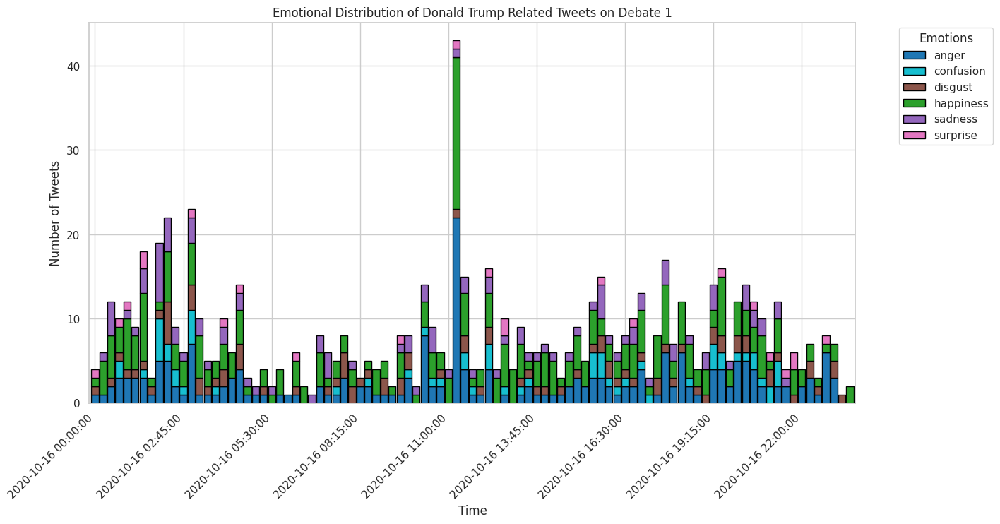

<ipython-input-113-9a2e8af033cd>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['quarter_hour'] = df['created_at'].dt.floor('15T')


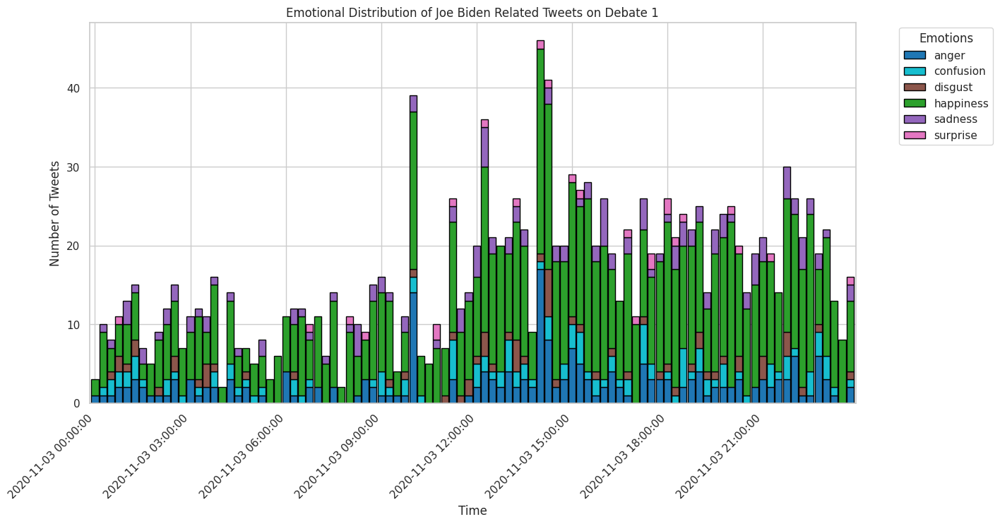

In [ ]:
# Filter tweets for the first debate date (October 16, 2020)
debate1_date_df = donald_stock[(donald_stock['created_at'] >= '2020-10-16 00:00:00') &
                               (donald_stock['created_at'] < '2020-10-17 00:00:00')].copy()

# Define a function to plot the stacked bar chart for emotions
def plot_emotion_distribution(df, title):
    df['quarter_hour'] = df['created_at'].dt.floor('15T')
    emotions_df = df.explode('Emotions')
    emotions_df = emotions_df[emotions_df['Emotions'] != 'neutral']
    emotion_counts = emotions_df.groupby(['quarter_hour', 'Emotions']).size().unstack(fill_value=0)

    cool_colors = {
        'anger': '#1f77b4',
        'confusion': '#17becf',
        'disgust': '#8c564b',
        'happiness': '#2ca02c',
        'sadness': '#9467bd',
        'surprise': '#e377c2',
    }

    # Plot the stacked bar chart with black outlines around the bars
    ax = emotion_counts.plot(
        kind='bar',
        stacked=True,
        figsize=(14, 7),
        color=[cool_colors[col] for col in emotion_counts.columns],
        width=0.9,
        edgecolor='black'
    )

    # Customize the x-axis ticks to show fewer labels
    ax.set_xticks(ax.get_xticks()[::len(ax.get_xticks()) // 8])
    ax.set_xticklabels([label.get_text() for label in ax.get_xticklabels()], rotation=45, ha='right')
    plt.title(title)
    plt.xlabel('Time')
    plt.ylabel('Number of Tweets')
    plt.legend(title='Emotions', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()
plot_emotion_distribution(debate1_date_df, 'Emotional Distribution of Donald Trump Related Tweets on Debate 1')
plot_emotion_distribution(joe_stock_election_day, 'Emotional Distribution of Joe Biden Related Tweets on Debate 1')


Emotional Distribution of Tweets Related to Debate 2

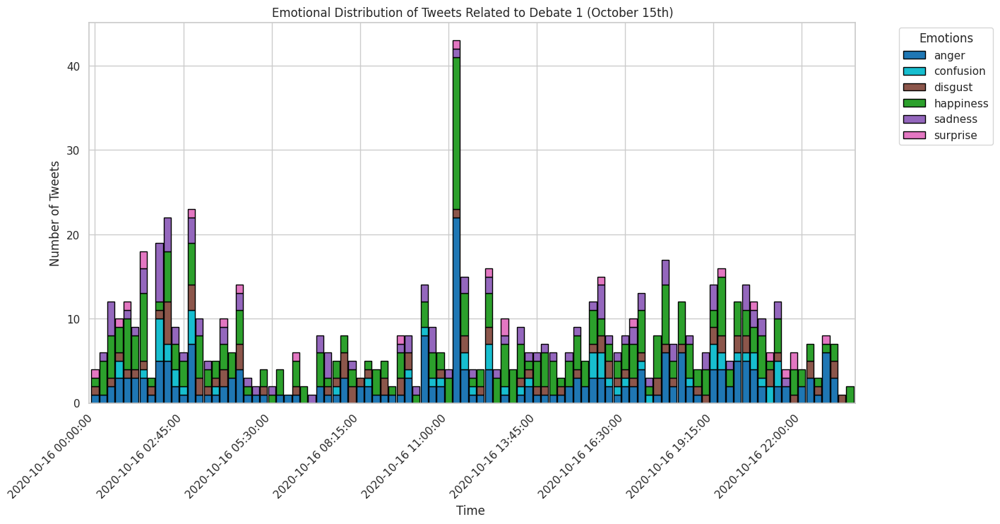

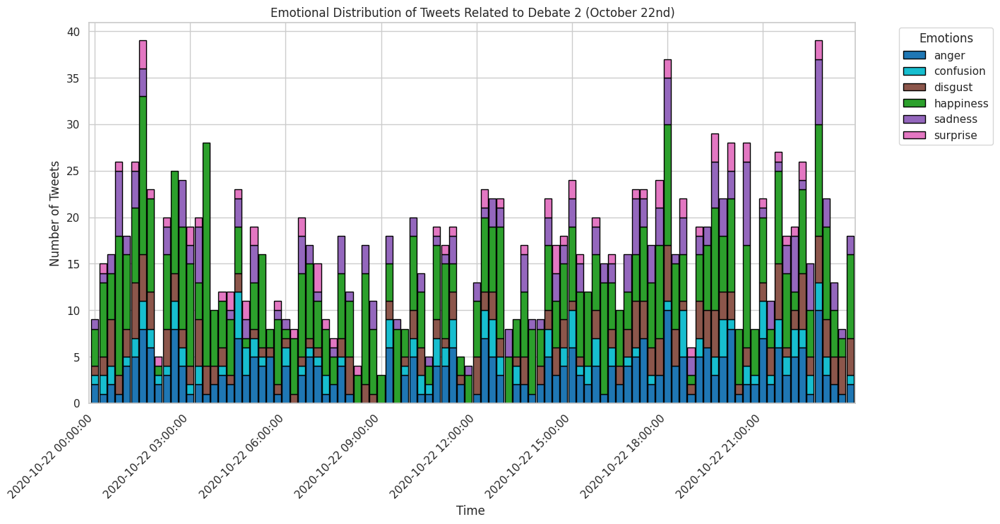

In [ ]:
# Filter tweets for Debate 2 (October 22, 2020)
debate2_date_df = df[(df['created_at'] >= '2020-10-22 00:00:00') & (df['created_at'] < '2020-10-23 00:00:00')].copy()
# Define a function to plot the stacked bar chart for emotions
def plot_emotion_distribution(df, title):
    df.loc[:, 'quarter_hour'] = df['created_at'].dt.floor('15T')
    emotions_df = df.explode('Emotions')
    emotions_df = emotions_df[emotions_df['Emotions'] != 'neutral']
    emotion_counts = emotions_df.groupby(['quarter_hour', 'Emotions']).size().unstack(fill_value=0)

    cool_colors = {
        'anger': '#1f77b4',
        'confusion': '#17becf',
        'disgust': '#8c564b',
        'happiness': '#2ca02c',
        'sadness': '#9467bd',
        'surprise': '#e377c2',
    }

    # Plot the stacked bar chart with black outlines around the bars
    ax = emotion_counts.plot(
        kind='bar',
        stacked=True,
        figsize=(14, 7),
        color=[cool_colors[col] for col in emotion_counts.columns],
        width=0.9,
        edgecolor='black'
    )

    # Customizing the x-axis ticks to show fewer labels
    ax.set_xticks(ax.get_xticks()[::len(ax.get_xticks()) // 8])
    ax.set_xticklabels([label.get_text() for label in ax.get_xticklabels()], rotation=45, ha='right')
    plt.title(title)
    plt.xlabel('Time ')
    plt.ylabel('Number of Tweets')
    plt.legend(title='Emotions', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()

plot_emotion_distribution(debate1_date_df, 'Emotional Distribution of Tweets Related to Debate 1 (October 15th)')
plot_emotion_distribution(debate2_date_df, 'Emotional Distribution of Tweets Related to Debate 2 (October 22nd)')


Analysis of Stock Prices and Sentiment Around the 2020 U.S. Election

[*********************100%***********************]  6 of 6 completed
[*********************100%***********************]  6 of 6 completed
[*********************100%***********************]  6 of 6 completed


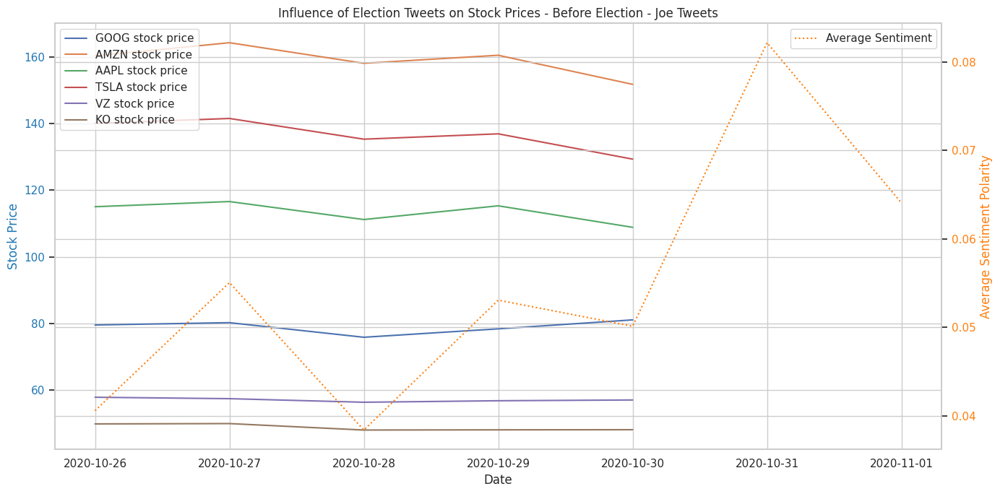

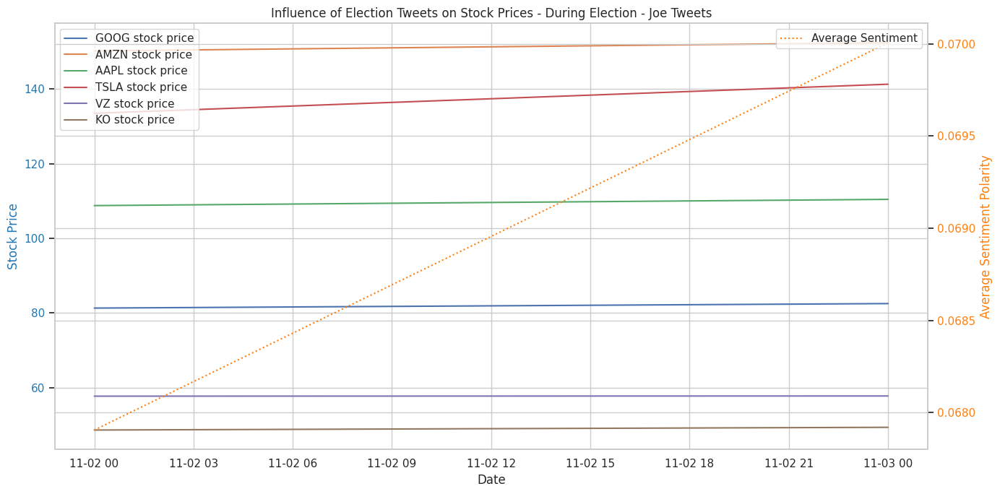

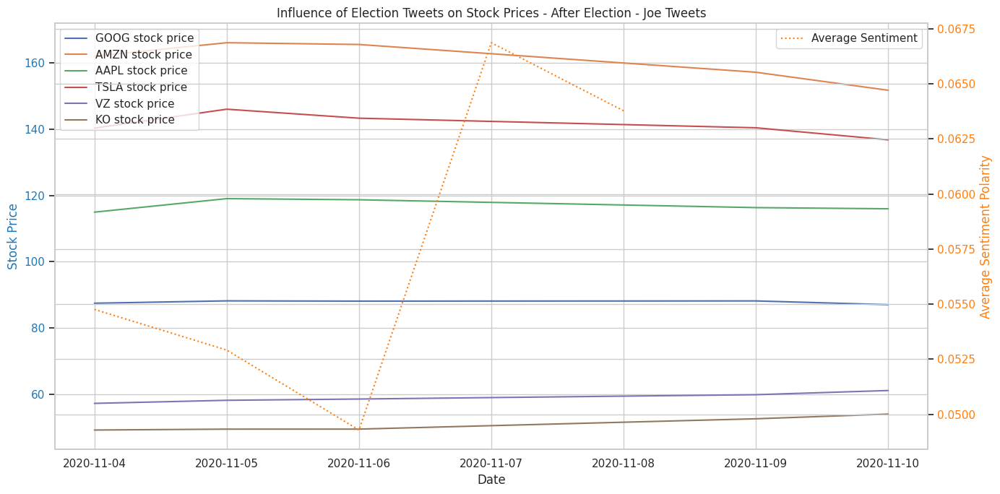

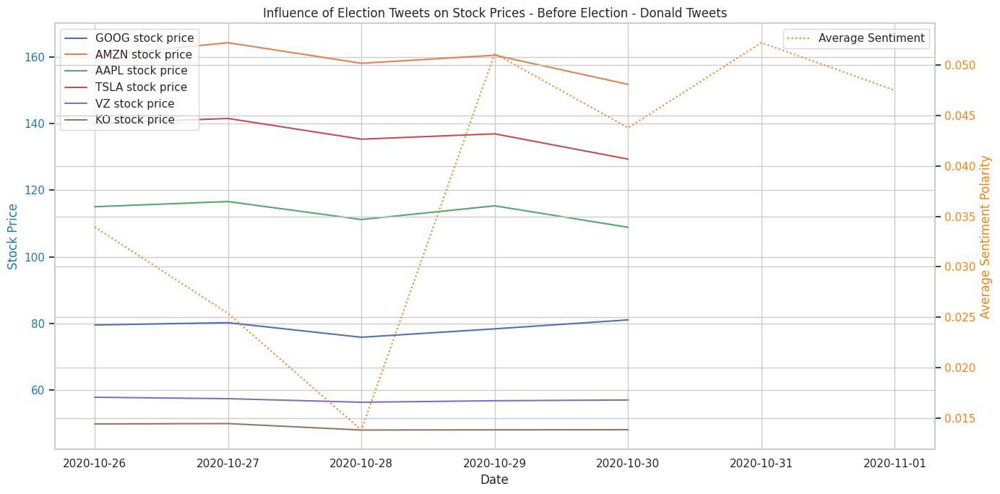

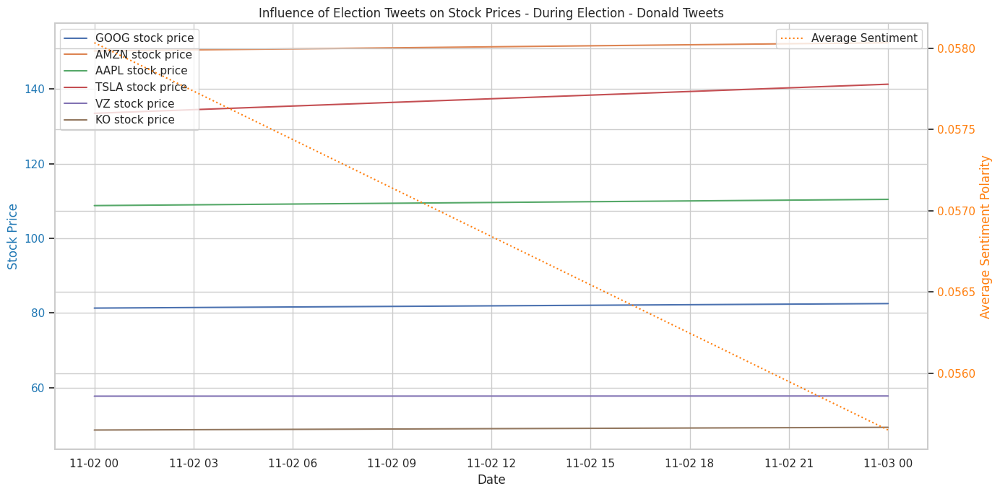

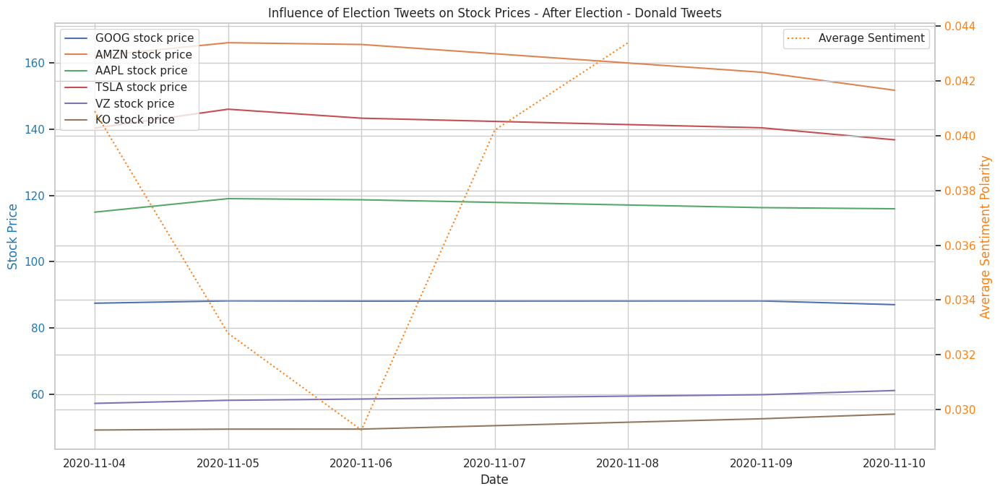

      Before Election  During Election  After Election
GOOG         1.921469         1.487057       -0.499673
AMZN        -5.328596         1.462152       -6.360063
AAPL        -5.380271         1.535355        0.887346
TSLA        -7.671081         5.840062       -2.522680
VZ          -1.418439         0.086654        6.780841
KO          -3.493972         1.501439        9.782391


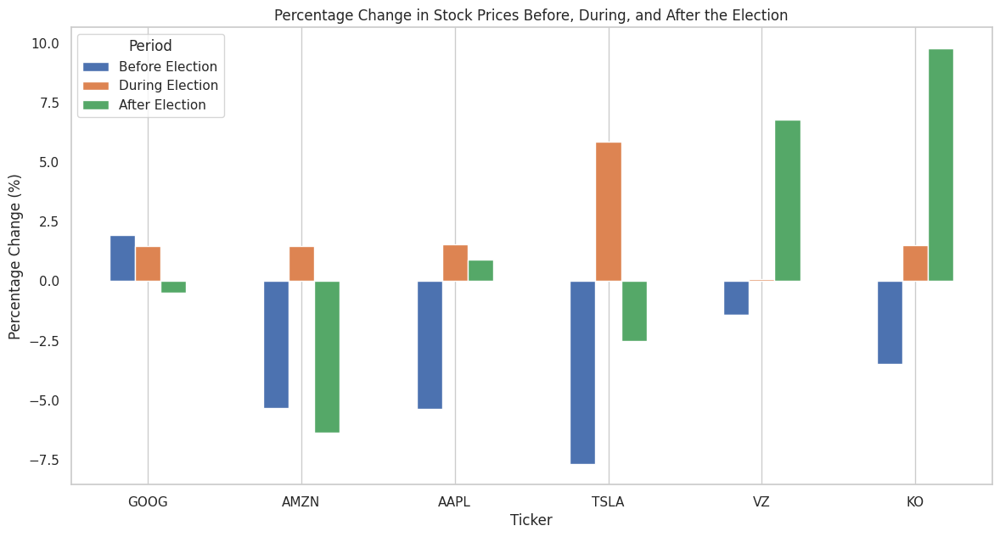

In [ ]:
# Load tweet data and preprocess
joe_tweets = pd.read_csv('joe_stock.csv')
donald_tweets = pd.read_csv('donald_stock.csv')

joe_tweets['created_at'] = pd.to_datetime(joe_tweets['created_at'])
donald_tweets['created_at'] = pd.to_datetime(donald_tweets['created_at'])
joe_tweets['created_at'] = pd.to_datetime(joe_tweets['created_at'])
donald_tweets['created_at'] = pd.to_datetime(donald_tweets['created_at'])
before_election_start = '2020-10-26'
before_election_end = '2020-11-02'
election_day_start = '2020-11-02'
election_day_end = '2020-11-04'
after_election_start = '2020-11-04'
after_election_end = '2020-11-11'

# Download stock data for the defined periods using Yahoo Finance
tickers = ['GOOG', 'AMZN', 'AAPL', 'TSLA', 'VZ', 'KO']
before_election_stock_data = yf.download(tickers, start=before_election_start, end=before_election_end, interval='1d')
election_stock_data = yf.download(tickers, start=election_day_start, end=election_day_end, interval='1d')
after_election_stock_data = yf.download(tickers, start=after_election_start, end=after_election_end, interval='1d')

# Function to plot stock prices alongside average sentiment
def plot_stock_and_sentiment(stock_data, tweet_data, period_name):
    fig, ax1 = plt.subplots(figsize=(14, 7))
    color = 'tab:blue'
    ax1.set_xlabel('Date')
    ax1.set_ylabel('Stock Price', color=color)
    for ticker in tickers:
        if ticker in stock_data['Close']:
            ax1.plot(stock_data.index, stock_data['Close'][ticker], label=f'{ticker} stock price')
    ax1.tick_params(axis='y', labelcolor=color)
    ax1.legend(loc='upper left')

    # Plotting average sentiment polarity
    ax2 = ax1.twinx()
    color = 'tab:orange'
    ax2.set_ylabel('Average Sentiment Polarity', color=color)
    avg_sentiment = tweet_data.groupby(tweet_data['created_at'].dt.date)['polarity'].mean()
    ax2.plot(avg_sentiment.index, avg_sentiment.values, color=color, linestyle='dotted', label='Average Sentiment')
    ax2.tick_params(axis='y', labelcolor=color)
    ax2.legend(loc='upper right')

    plt.title(f'Influence of Election Tweets on Stock Prices - {period_name}')
    fig.tight_layout()
    plt.show()

# Calculate sentiment polarity for Joe Biden and Donald Trump tweets
joe_tweets['polarity'] = joe_tweets['tweet'].apply(lambda x: TextBlob(x).sentiment.polarity)
donald_tweets['polarity'] = donald_tweets['tweet'].apply(lambda x: TextBlob(x).sentiment.polarity)

# Filter tweets for each period
before_election_joe_tweets = joe_tweets[(joe_tweets['created_at'] >= before_election_start) & (joe_tweets['created_at'] < before_election_end)]
election_joe_tweets = joe_tweets[(joe_tweets['created_at'] >= election_day_start) & (joe_tweets['created_at'] < election_day_end)]
after_election_joe_tweets = joe_tweets[(joe_tweets['created_at'] >= after_election_start) & (joe_tweets['created_at'] < after_election_end)]
before_election_donald_tweets = donald_tweets[(donald_tweets['created_at'] >= before_election_start) & (donald_tweets['created_at'] < before_election_end)]
election_donald_tweets = donald_tweets[(donald_tweets['created_at'] >= election_day_start) & (donald_tweets['created_at'] < election_day_end)]
after_election_donald_tweets = donald_tweets[(donald_tweets['created_at'] >= after_election_start) & (donald_tweets['created_at'] < after_election_end)]
plot_stock_and_sentiment(before_election_stock_data, before_election_joe_tweets, 'Before Election - Joe Tweets')
plot_stock_and_sentiment(election_stock_data, election_joe_tweets, 'During Election - Joe Tweets')
plot_stock_and_sentiment(after_election_stock_data, after_election_joe_tweets, 'After Election - Joe Tweets')
plot_stock_and_sentiment(before_election_stock_data, before_election_donald_tweets, 'Before Election - Donald Tweets')
plot_stock_and_sentiment(election_stock_data, election_donald_tweets, 'During Election - Donald Tweets')
plot_stock_and_sentiment(after_election_stock_data, after_election_donald_tweets, 'After Election - Donald Tweets')

# Function to calculate percentage change in stock prices
def calculate_percentage_change(stock_data):
    percentage_changes = {}
    for ticker in tickers:
        if ticker in stock_data['Close']:
            start_price = stock_data['Close'][ticker].iloc[0]
            end_price = stock_data['Close'][ticker].iloc[-1]
            percentage_change = ((end_price - start_price) / start_price) * 100
            percentage_changes[ticker] = percentage_change
    return percentage_changes

# Calculates percentage changes for each period
before_election_change = calculate_percentage_change(before_election_stock_data)
election_change = calculate_percentage_change(election_stock_data)
after_election_change = calculate_percentage_change(after_election_stock_data)

# Display percentage changes in a DataFrame
percentage_change_df = pd.DataFrame({
    'Before Election': before_election_change,
    'During Election': election_change,
    'After Election': after_election_change
})

print(percentage_change_df)

percentage_change_df.plot(kind='bar', figsize=(14, 7))
plt.title('Percentage Change in Stock Prices Before, During, and After the Election')
plt.xlabel('Ticker')
plt.ylabel('Percentage Change (%)')
plt.xticks(rotation=0)
plt.legend(title='Period')
plt.grid(axis='y')
plt.show()


Analyzing the Impact of Tweet Emotions on Stock Price Changes

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[*********************100%***********************]  6 of 6 completed
[*********************100%***********************]  6 of 6 completed
[*********************100%***********************]  6 of 6 completed


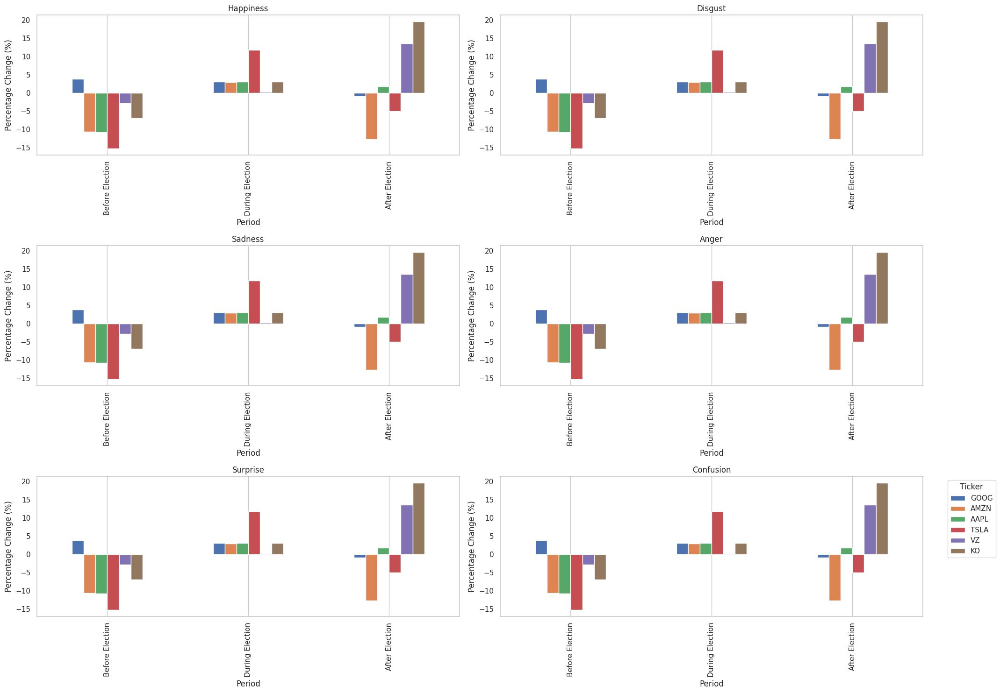

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import yfinance as yf
from textblob import TextBlob
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import nltk

nltk.download('vader_lexicon')

# Define periods
before_election_start = '2020-10-26'
before_election_end = '2020-11-02'
election_day_start = '2020-11-02'
election_day_end = '2020-11-04'
after_election_start = '2020-11-04'
after_election_end = '2020-11-11'

# Download stock data with daily intervals
tickers = ['GOOG', 'AMZN', 'AAPL', 'TSLA', 'VZ', 'KO']
before_election_stock_data = yf.download(tickers, start=before_election_start, end=before_election_end, interval='1d')
election_stock_data = yf.download(tickers, start=election_day_start, end=election_day_end, interval='1d')
after_election_stock_data = yf.download(tickers, start=after_election_start, end=after_election_end, interval='1d')

# Function to detect emotions in tweets
def detect_emotions(tweet):
    emotions = {
         'anger': ['angry', 'sell', 'mad', 'furious', 'hate', 'sell', 'bear', 'bubble', 'bearish', 'overvalued', 'overbought', 'overpriced', 'expensive', 'downward', 'falling', 'sold', 'low', 'miss', 'resistance', 'squeeze', 'cover', 'seller', 'rage', 'hate', 'annoyed', 'crash', '!!!', '😠', '😡', '🤬', '👿', '💢', 'sold', 'fake', 'decline', 'drop', 'crash', 'bear', 'sell', '📉', 'TrumpLiesAmericansDie', 'Covid19', 'FakePresident', 'SuperSpreaderEvent', 'TrumpSupporters', 'VoteHimOut2020', 'TrumpIsALoser', 'TrumpIsALaughingStock', 'TrumpVirus', 'TrumpGenocide', 'TrumpLiesPeopleDie', 'corruption', 'business dealings', 'BidenFamilyCorruption', 'HunterBidenChinaPayoff', 'HunterBiden', 'Burisma', 'TrumpMeltdown', 'TrumpLost', 'TrumpCrimeFamily'],
         'happiness': ['happy', 'buy', 'bull', 'long', 'support', 'undervalued', 'underpriced', 'cheap', 'upward', 'rising', 'trend', 'moon', 'rocket', 'hold', 'breakout', 'call', 'beat', 'buying', 'holding', 'high', 'profit', 'joy', 'glad', 'delighted', 'love', 'great', '😊', '😁', '😃', '😄', '😆', '😂', '🤗', '😍', '😇', '🥰', 'risen', 'better', 'gain', 'profit', 'bull', 'rise', 'buy', '✅', '📈', '❤️', '🚀', '🍎', '💰', 'Trump2020LandslideVictory', 'Winning', 'VoteTrump', 'MAGA', 'KAG', '4MoreYears', 'AmericaFirst', 'PromisesMadePromisesKept', 'FoxNews', 'DonaldTrump', 'BidenHarris2020', 'JoeBidenWins', 'PresidentElectJoe', 'BidenHarris'],
        'sadness': ['sad', 'unhappy', 'short', 'sold', 'miss', 'depressed', 'down', '😢', '😭', '😞', '😔', '😟', '😿', '💔', 'undervalued', 'misunderstood', 'loss', 'fall', 'decrease', 'dip', 'short', 'neutral', 'neutral', 'steady', 'stable', 'even', 'calm', 'balanced', 'level', 'flat', '😐', 'Covid19', 'TrumpLiesAmericansDie', 'SuperSpreaderEvent', 'VoteHimOut2020', 'TrumpVirus', 'TrumpLiesPeopleDie', 'COVID19', 'TrumpLiesAmericansDie', 'TrumpAttacksBlackWomen', 'TrumpIsALaughingStock', 'economy', 'market', 'JoeBiden', 'Biden', 'GeorgeBush', 'Obama', 'pandemic', 'election'],
         'surprise': ['surprised', 'shocked', 'breakout', 'moon', 'rocket', 'beat', 'amazed', 'astonished', '!', '😲', '😯', '😮', '😱', '🙀', '😳', 'unveiled', 'earnings', 'surge', 'spike', 'unexpected', 'shock', '🎯', '➡️', 'TrumpLiesAmericansDie', 'Trump', 'Covid19', 'FakePresident', 'SuperSpreaderEvent', 'TrumpSupporters', 'VoteHimOut2020', 'TrumpIsALoser', 'TrumpIsALaughingStock', 'TrumpVirus', 'TrumpLiesPeopleDie', 'economic policies', 'improved economy', 'JoeBiden', 'Biden', 'HunterBiden', 'Election2020'],
        'confusion': ['confused', 'lost', 'squeeze', 'cover', 'bear', 'bubble', 'bearish', 'overvalued', 'overbought', 'overpriced', 'expensive', 'downward', 'falling', 'low', 'miss', 'resistance', 'uncertain', '?', '??', 'what...?', '😕', '😵', '🤔', '😐', '🤯', 'trendless', 'volatile', 'uncertain', 'swing', 'fluctuate', 'confuse', '🛒', 'TrumpLiesAmericansDie', 'Trump', 'Covid19', 'FakePresident', 'SuperSpreaderEvent', 'TrumpSupporters', 'VoteHimOut2020', 'TrumpIsALoser', 'TrumpIsALaughingStock', 'TrumpVirus', 'TrumpLiesPeopleDie', 'trading', 'PPE contracts', 'Biden', 'JoeBiden', 'Burisma', 'voterfraud', 'Election2020'],
        'disgust': ['disgust', 'TrumpIsUnfitForOffice', 'TrumpLiesAmericansDie', 'FakePresident', 'SuperSpreaderEvent', 'TrumpSupporters', 'VoteHimOut2020', 'TrumpAttacksBlackWomen', 'TrumpIsALoser', 'TrumpIsALaughingStock', 'TrumpVirus', 'TrumpGenocide', 'corruption', 'business dealings', 'BidenFamilyCorruption', 'HunterBidenChinaPayoff', 'HunterBiden', 'Burisma', 'TrumpMeltdown', 'TrumpLost', 'TrumpCrimeFamily']
    }
    detected_emotions = []
    for emotion, keywords in emotions.items():
        if any(keyword in tweet for keyword in keywords):
            detected_emotions.append(emotion)
    return detected_emotions

# Apply emotion detection to tweets
joe_tweets['Emotions'] = joe_tweets['tweet'].apply(detect_emotions)
donald_tweets['Emotions'] = donald_tweets['tweet'].apply(detect_emotions)

# Function to calculate percentage change in stock prices
def calculate_percentage_change(stock_data):
    percentage_changes = {}
    for ticker in tickers:
        if ticker in stock_data['Close']:
            start_price = stock_data['Close'][ticker].iloc[0]
            end_price = stock_data['Close'][ticker].iloc[-1]
            percentage_change = ((end_price - start_price) / start_price) * 100
            percentage_changes[ticker] = percentage_change
    return percentage_changes

# Calculate percentage changes for each period
before_election_change = calculate_percentage_change(before_election_stock_data)
election_change = calculate_percentage_change(election_stock_data)
after_election_change = calculate_percentage_change(after_election_stock_data)

# Function to filter tweets by emotion and calculate the relevant stock price changes
def get_stock_changes_for_emotion(tweets, emotion, stock_data):
    filtered_tweets = tweets[tweets['Emotions'].apply(lambda x: emotion in x)]
    if len(filtered_tweets) > 0:
        return calculate_percentage_change(stock_data)
    else:
        return {ticker: 0 for ticker in tickers}

# Function to plot percentage changes for each emotion in subplots
def plot_emotion_percentage_changes_all(emotions, joe_tweets, donald_tweets, before_stock_data, during_stock_data, after_stock_data):
    fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(20, 15))
    axes = axes.flatten()

    for idx, emotion in enumerate(emotions):
        before_change_joe = get_stock_changes_for_emotion(joe_tweets, emotion, before_stock_data)
        during_change_joe = get_stock_changes_for_emotion(joe_tweets, emotion, during_stock_data)
        after_change_joe = get_stock_changes_for_emotion(joe_tweets, emotion, after_stock_data)

        before_change_donald = get_stock_changes_for_emotion(donald_tweets, emotion, before_stock_data)
        during_change_donald = get_stock_changes_for_emotion(donald_tweets, emotion, during_stock_data)
        after_change_donald = get_stock_changes_for_emotion(donald_tweets, emotion, after_stock_data)

        data = {
            'GOOG': [before_change_joe['GOOG'] + before_change_donald['GOOG'],
                     during_change_joe['GOOG'] + during_change_donald['GOOG'],
                     after_change_joe['GOOG'] + after_change_donald['GOOG']],
            'AMZN': [before_change_joe['AMZN'] + before_change_donald['AMZN'],
                     during_change_joe['AMZN'] + during_change_donald['AMZN'],
                     after_change_joe['AMZN'] + after_change_donald['AMZN']],
            'AAPL': [before_change_joe['AAPL'] + before_change_donald['AAPL'],
                     during_change_joe['AAPL'] + during_change_donald['AAPL'],
                     after_change_joe['AAPL'] + after_change_donald['AAPL']],
            'TSLA': [before_change_joe['TSLA'] + before_change_donald['TSLA'],
                     during_change_joe['TSLA'] + during_change_donald['TSLA'],
                     after_change_joe['TSLA'] + after_change_donald['TSLA']],
            'VZ': [before_change_joe['VZ'] + before_change_donald['VZ'],
                   during_change_joe['VZ'] + during_change_donald['VZ'],
                   after_change_joe['VZ'] + after_change_donald['VZ']],
            'KO': [before_change_joe['KO'] + before_change_donald['KO'],
                   during_change_joe['KO'] + during_change_donald['KO'],
                   after_change_joe['KO'] + after_change_donald['KO']]
        }

        df = pd.DataFrame(data, index=['Before Election', 'During Election', 'After Election'])

        df.plot(kind='bar', ax=axes[idx], legend=False)
        axes[idx].set_title(f'{emotion.capitalize()}')
        axes[idx].set_xlabel('Period')
        axes[idx].set_ylabel('Percentage Change (%)')
        axes[idx].grid(axis='y')

    plt.tight_layout()
    plt.legend(title='Ticker', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()

# List of emotions
emotions = ['happiness', 'disgust', 'sadness', 'anger', 'surprise', 'confusion']

# Plot all emotions in one figure
plot_emotion_percentage_changes_all(emotions, joe_tweets, donald_tweets, before_election_stock_data, election_stock_data, after_election_stock_data)


Sentiment Analysis and Emotion Correlation with Stock Prices During Election Period

<ipython-input-137-51724eceb9ed>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  company_tweets['polarity'] = company_tweets['tweet'].apply(lambda x: TextBlob(x).sentiment.polarity)
<ipython-input-137-51724eceb9ed>:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=labels, y=values, palette=colors)


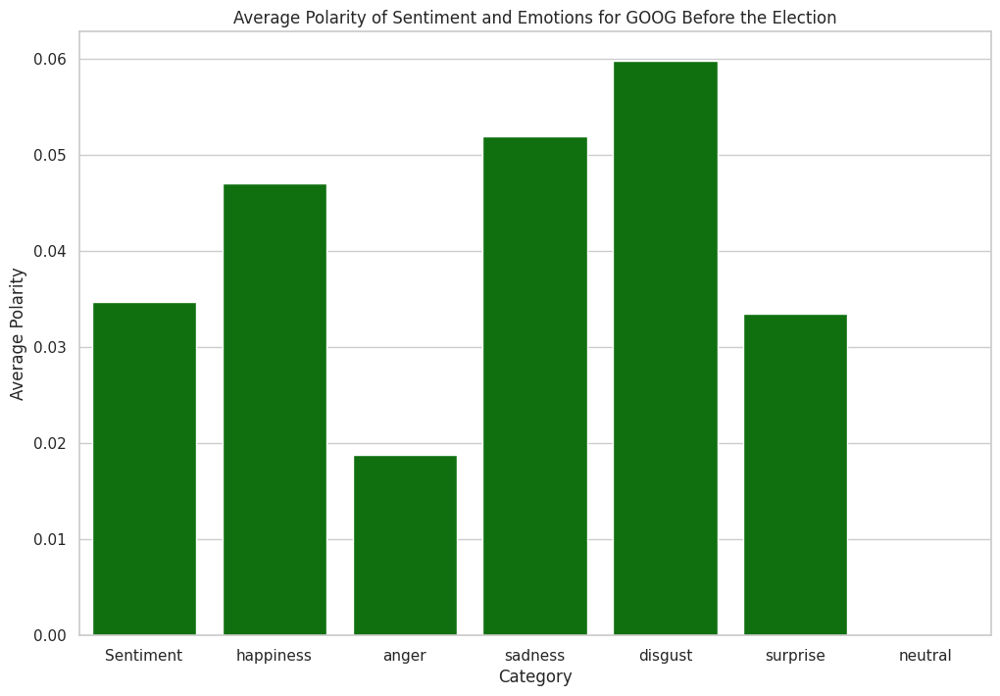

<ipython-input-137-51724eceb9ed>:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=labels, y=values, palette=colors)


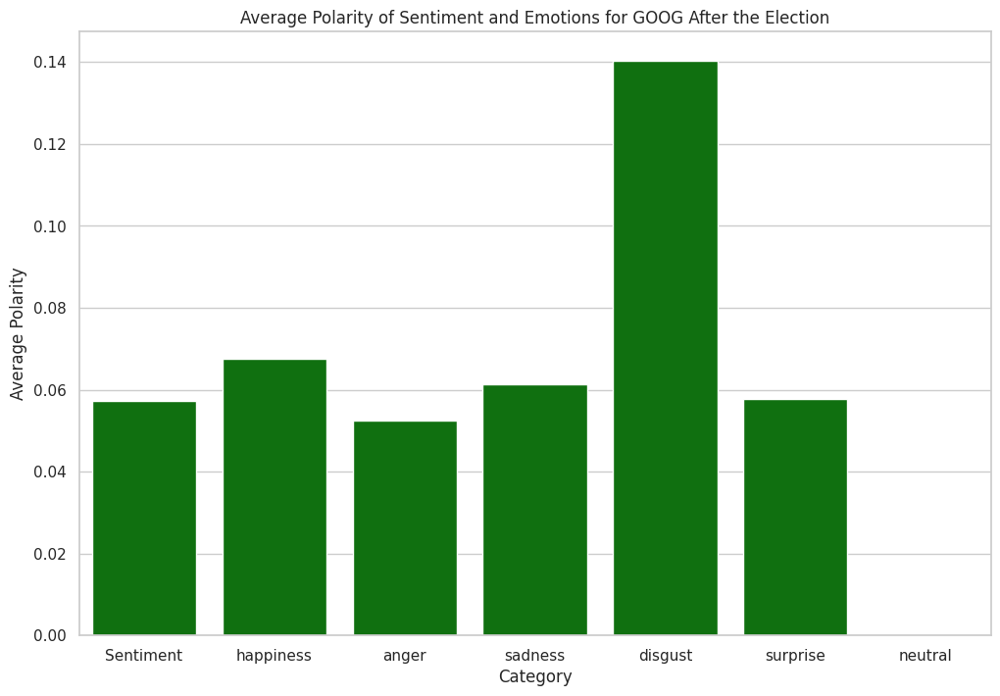

<ipython-input-137-51724eceb9ed>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  company_tweets['polarity'] = company_tweets['tweet'].apply(lambda x: TextBlob(x).sentiment.polarity)
<ipython-input-137-51724eceb9ed>:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=labels, y=values, palette=colors)


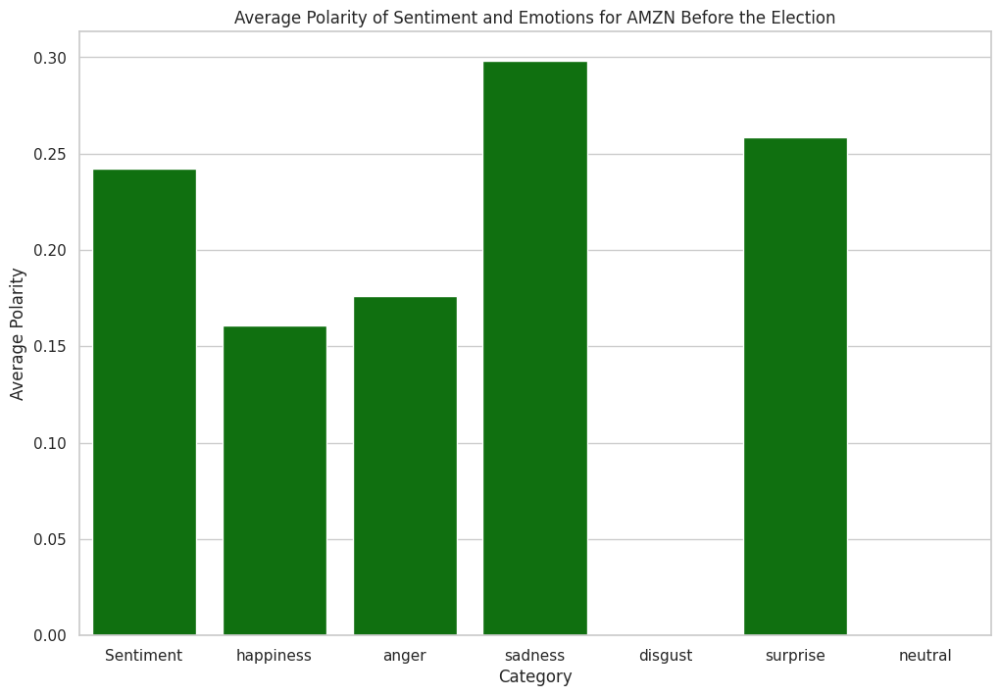

<ipython-input-137-51724eceb9ed>:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=labels, y=values, palette=colors)


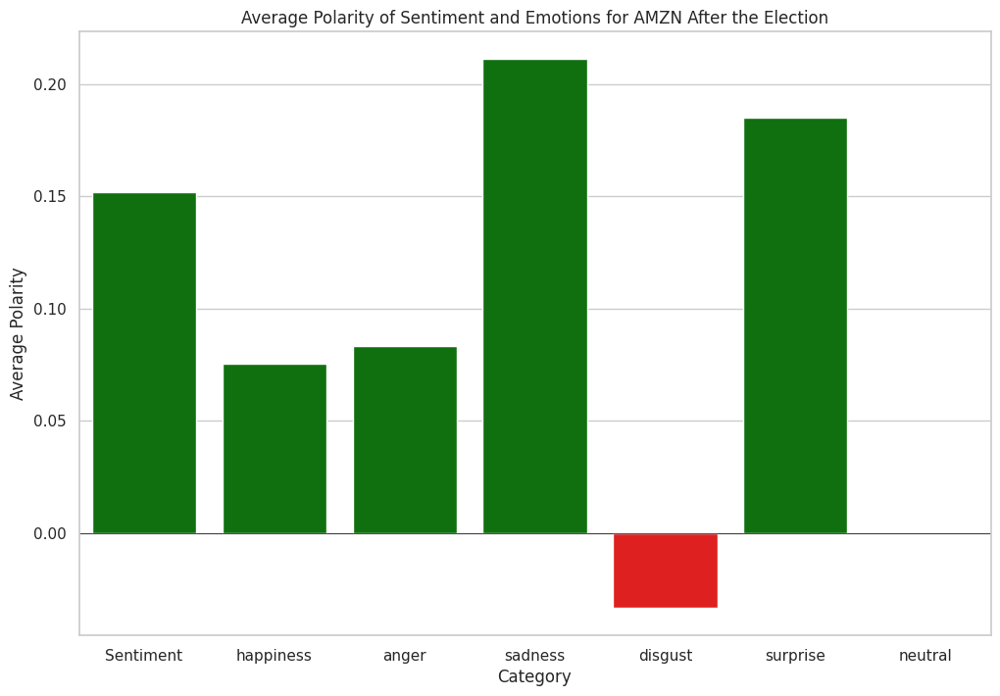

<ipython-input-137-51724eceb9ed>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  company_tweets['polarity'] = company_tweets['tweet'].apply(lambda x: TextBlob(x).sentiment.polarity)
<ipython-input-137-51724eceb9ed>:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=labels, y=values, palette=colors)


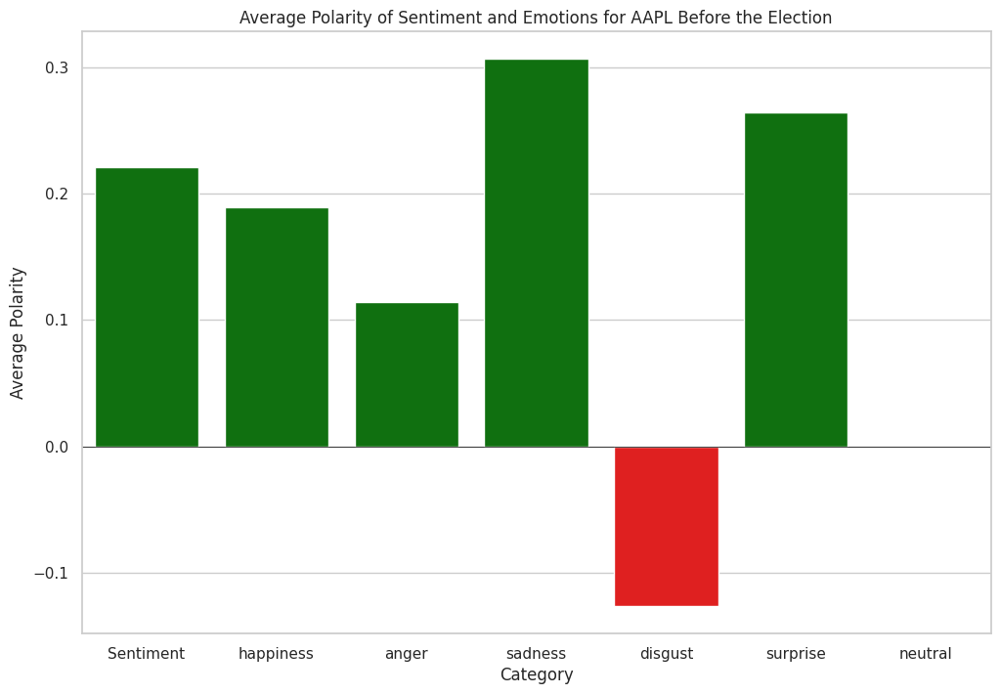

<ipython-input-137-51724eceb9ed>:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=labels, y=values, palette=colors)


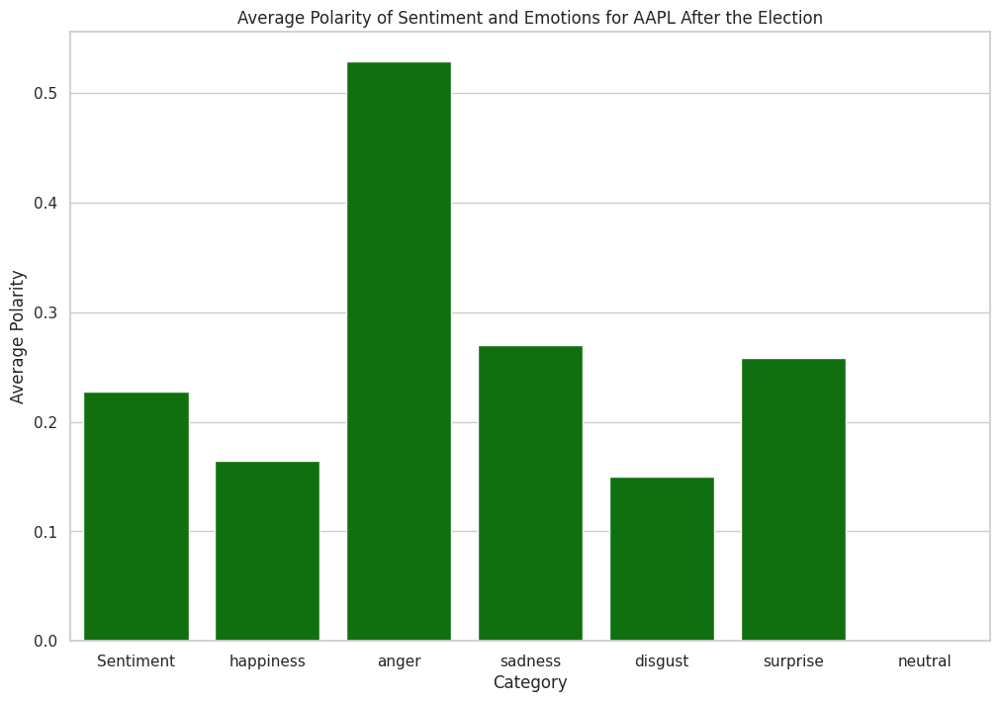

<ipython-input-137-51724eceb9ed>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  company_tweets['polarity'] = company_tweets['tweet'].apply(lambda x: TextBlob(x).sentiment.polarity)
<ipython-input-137-51724eceb9ed>:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=labels, y=values, palette=colors)


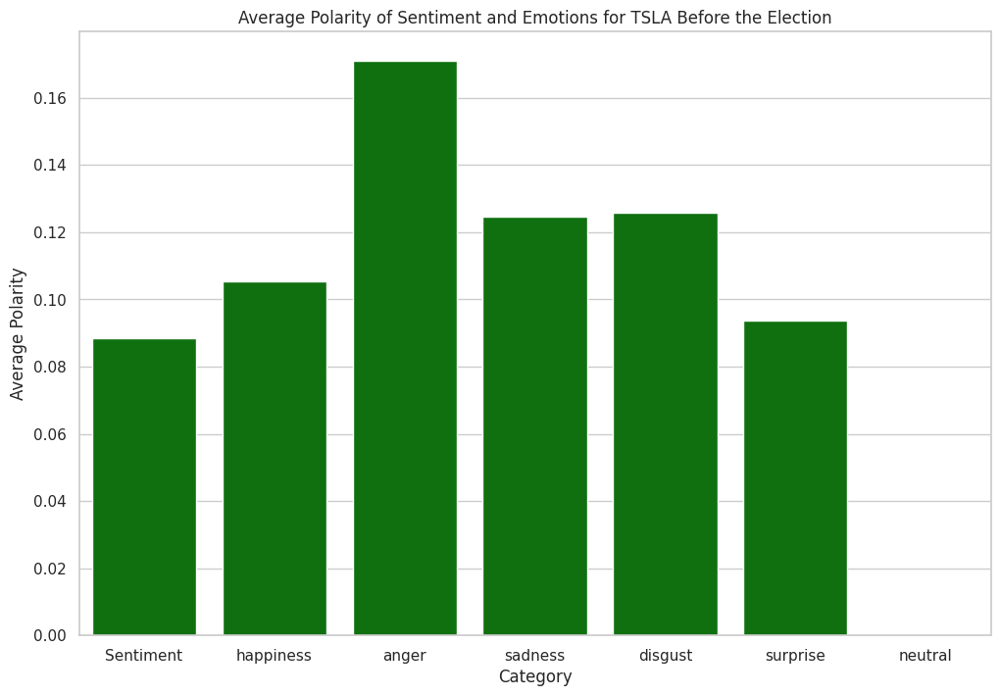

<ipython-input-137-51724eceb9ed>:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=labels, y=values, palette=colors)


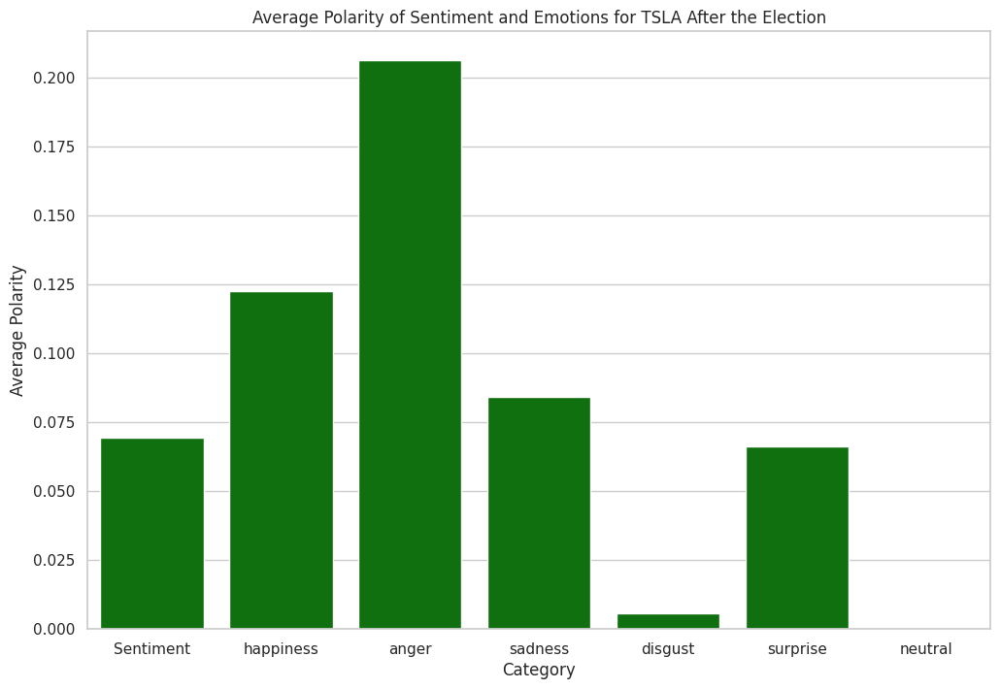

<ipython-input-137-51724eceb9ed>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  company_tweets['polarity'] = company_tweets['tweet'].apply(lambda x: TextBlob(x).sentiment.polarity)
<ipython-input-137-51724eceb9ed>:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=labels, y=values, palette=colors)


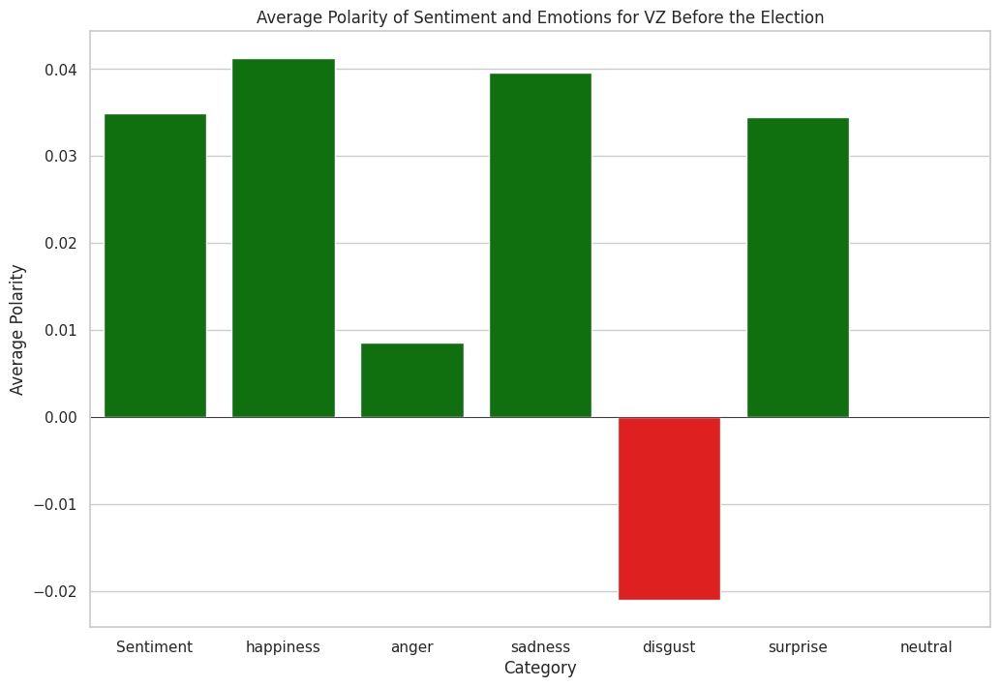

<ipython-input-137-51724eceb9ed>:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=labels, y=values, palette=colors)


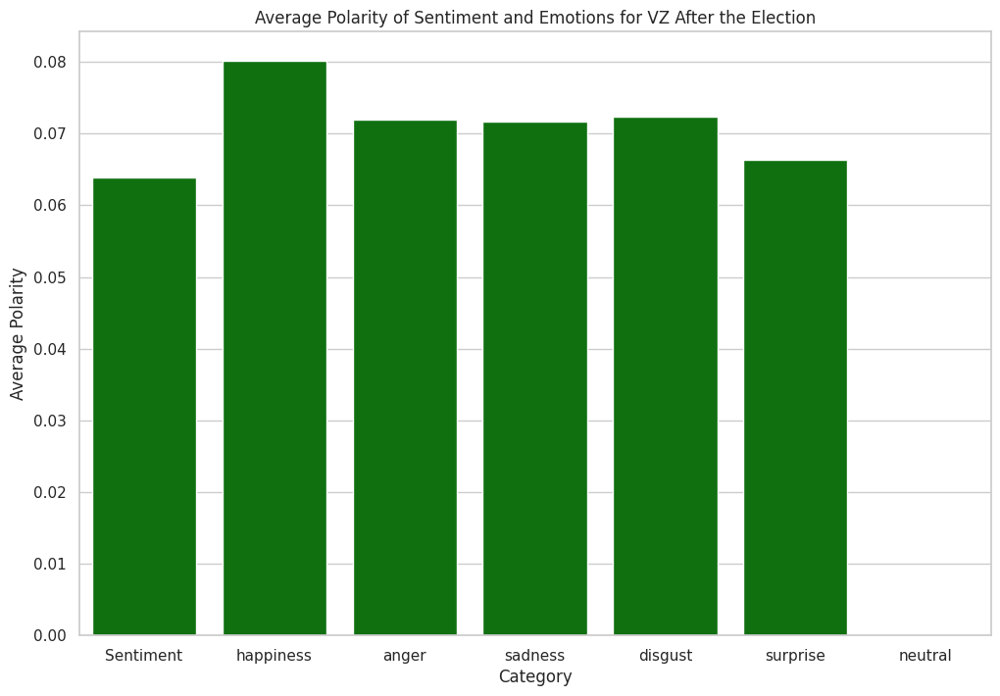

<ipython-input-137-51724eceb9ed>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  company_tweets['polarity'] = company_tweets['tweet'].apply(lambda x: TextBlob(x).sentiment.polarity)
<ipython-input-137-51724eceb9ed>:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=labels, y=values, palette=colors)


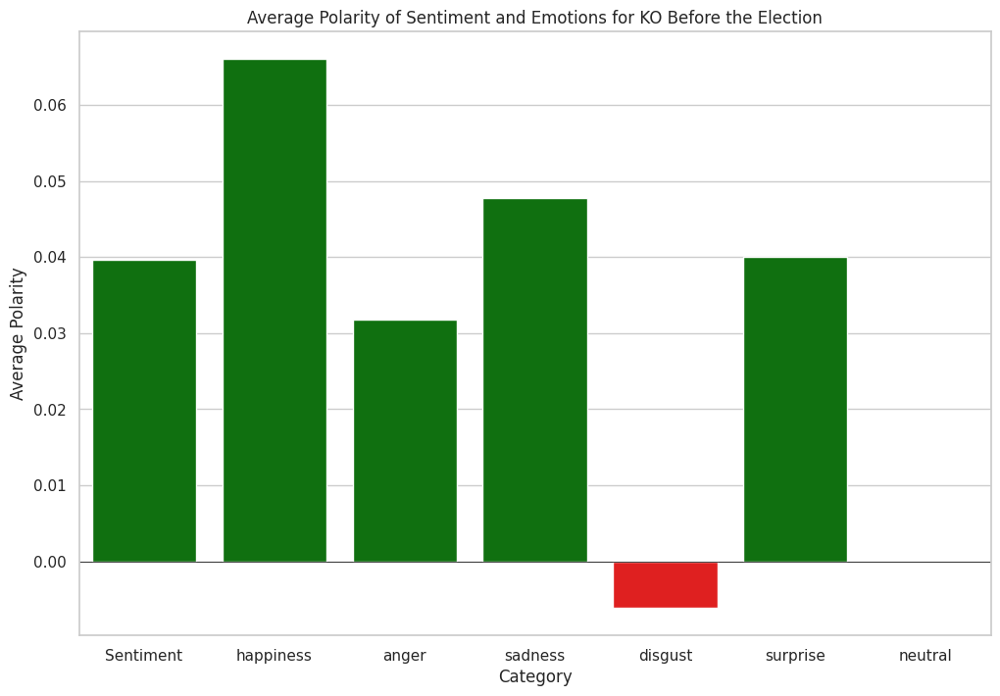

<ipython-input-137-51724eceb9ed>:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=labels, y=values, palette=colors)


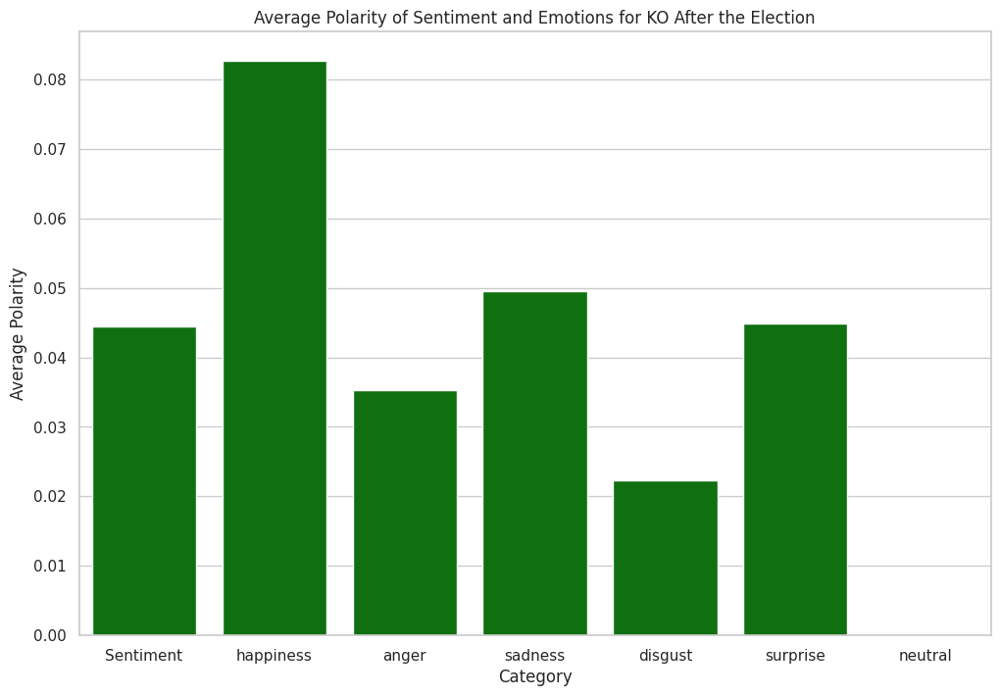

   Company   Category  Average Polarity Before Result Before  \
0     GOOG  Sentiment                 0.034710        Profit   
1     GOOG  happiness                 0.047028        Profit   
2     GOOG      anger                 0.018828        Profit   
3     GOOG    sadness                 0.051949        Profit   
4     GOOG    disgust                 0.059857        Profit   
5     GOOG   surprise                 0.033470        Profit   
6     GOOG    neutral                      NaN          Loss   
7     AMZN  Sentiment                 0.242061        Profit   
8     AMZN  happiness                 0.161089        Profit   
9     AMZN      anger                 0.176153        Profit   
10    AMZN    sadness                 0.298400        Profit   
11    AMZN    disgust                 0.000000          Loss   
12    AMZN   surprise                 0.258374        Profit   
13    AMZN    neutral                      NaN          Loss   
14    AAPL  Sentiment                 0.

In [ ]:
tweet_data = pd.concat([joe_tweets, donald_tweets], ignore_index=True)
tickers = ['GOOG', 'AMZN', 'AAPL', 'TSLA', 'VZ', 'KO']
emotions = ['happiness', 'anger', 'sadness', 'disgust', 'surprise', 'neutral']

# Function to calculate average sentiment and emotion scores
def calculate_average_polarity(tweets, emotions):
    avg_polarity = tweets['polarity'].mean()
    avg_emotions = {emotion: tweets[tweets['Emotions'].apply(lambda x: emotion in x)]['polarity'].mean() for emotion in emotions}
    return avg_polarity, avg_emotions
def prepare_plot_data(avg_polarity, avg_emotions):
    labels = ['Sentiment'] + list(avg_emotions.keys())
    values = [avg_polarity] + list(avg_emotions.values())
    return labels, values
def determine_profit_or_loss(avg_polarity):
    return "Profit" if avg_polarity > 0 else "Loss"

# Function to plot average polarity
def plot_avg_polarity(labels, values, period, company):
    colors = ['green' if v > 0 else 'red' for v in values]
    plt.figure(figsize=(12, 8))
    sns.barplot(x=labels, y=values, palette=colors)
    plt.axhline(0, color='black', linewidth=0.5)
    plt.xlabel('Category')
    plt.ylabel('Average Polarity')
    plt.title(f'Average Polarity of Sentiment and Emotions for {company} {period} the Election')
    plt.show()

# Process each company's tweets and plot results
results = []

for ticker in tickers:
    # Filter tweets related to the company
    company_tweets = tweet_data[tweet_data['tweet'].str.contains(ticker, case=False, na=False)]
    company_tweets['polarity'] = company_tweets['tweet'].apply(lambda x: TextBlob(x).sentiment.polarity)
    before_election_tweets = company_tweets[(company_tweets['created_at'] >= before_election_start) & (company_tweets['created_at'] < before_election_end)]
    after_election_tweets = company_tweets[(company_tweets['created_at'] >= after_election_start) & (company_tweets['created_at'] < after_election_end)]
    avg_polarity_before, avg_emotions_before = calculate_average_polarity(before_election_tweets, emotions)
    avg_polarity_after, avg_emotions_after = calculate_average_polarity(after_election_tweets, emotions)
    labels_before, values_before = prepare_plot_data(avg_polarity_before, avg_emotions_before)
    labels_after, values_after = prepare_plot_data(avg_polarity_after, avg_emotions_after)
    plot_avg_polarity(labels_before, values_before, 'Before', ticker)
    plot_avg_polarity(labels_after, values_after, 'After', ticker)

    # Collect results
    results.append({
        'Company': ticker,
        'Category': ['Sentiment'] + list(avg_emotions_before.keys()),
        'Average Polarity Before': [avg_polarity_before] + list(avg_emotions_before.values()),
        'Result Before': [determine_profit_or_loss(avg_polarity_before)] + [determine_profit_or_loss(avg) for avg in avg_emotions_before.values()],
        'Average Polarity After': [avg_polarity_after] + list(avg_emotions_after.values()),
        'Result After': [determine_profit_or_loss(avg_polarity_after)] + [determine_profit_or_loss(avg) for avg in avg_emotions_after.values()],
    })

# Convert results to a DataFrame for easy viewing
final_results = []

for result in results:
    df = pd.DataFrame(result)
    final_results.append(df)

final_results_df = pd.concat(final_results, ignore_index=True)
print(final_results_df)


Sentiment Heatmap Over Time

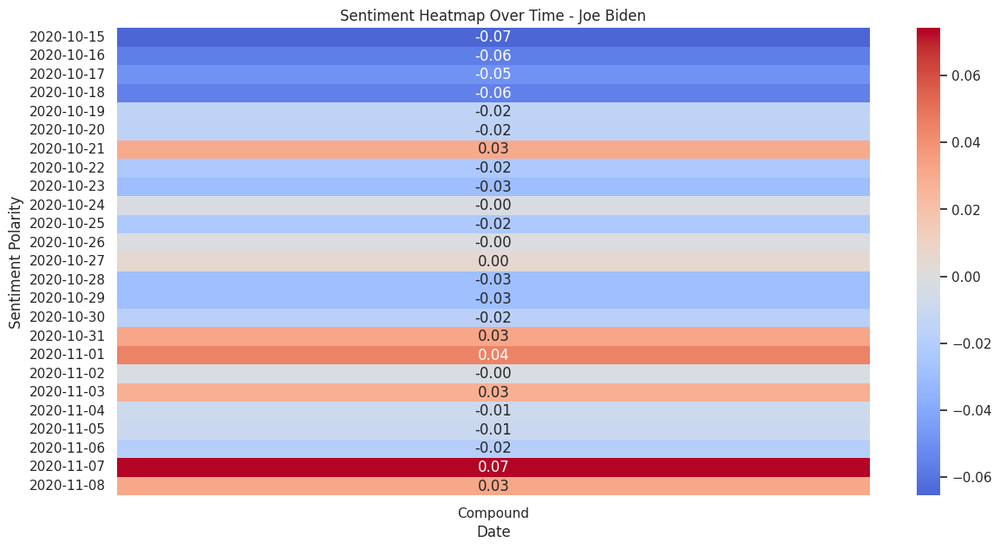

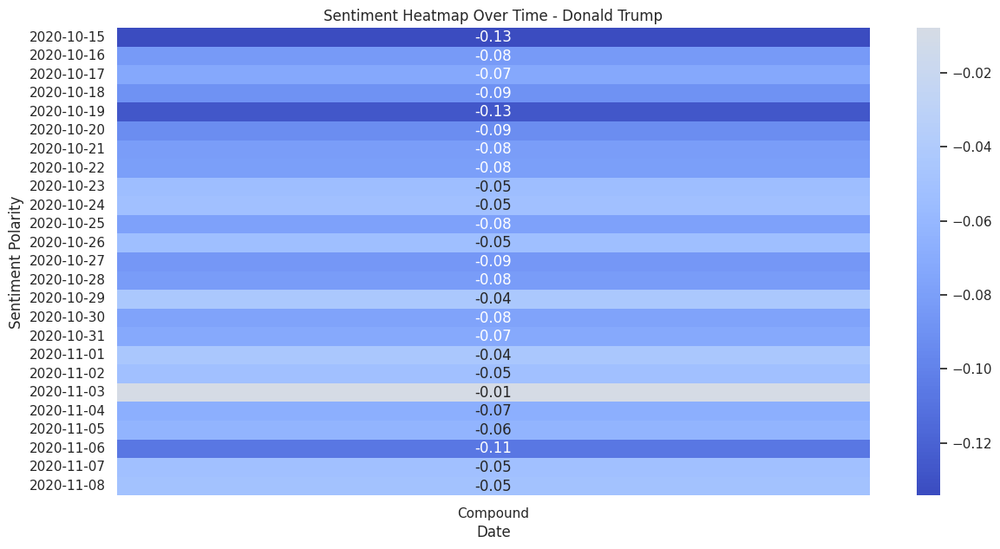

In [ ]:
heatmap_data_joe = joe_stock.pivot_table(index=joe_stock['created_at'].dt.date, values='Compound', aggfunc='mean')
heatmap_data_donald = donald_stock.pivot_table(index=donald_stock['created_at'].dt.date, values='Compound', aggfunc='mean')

# Visualization: Sentiment Heatmap Over Time
plt.figure(figsize=(14, 7))
sns.heatmap(heatmap_data_joe, cmap='coolwarm', center=0, annot=True, fmt=".2f")
plt.title('Sentiment Heatmap Over Time - Joe Biden')
plt.xlabel('Date')
plt.ylabel('Sentiment Polarity')
plt.show()

plt.figure(figsize=(14, 7))
sns.heatmap(heatmap_data_donald, cmap='coolwarm', center=0, annot=True, fmt=".2f")
plt.title('Sentiment Heatmap Over Time - Donald Trump')
plt.xlabel('Date')
plt.ylabel('Sentiment Polarity')
plt.show()


Sentiment Distribution by Candidate

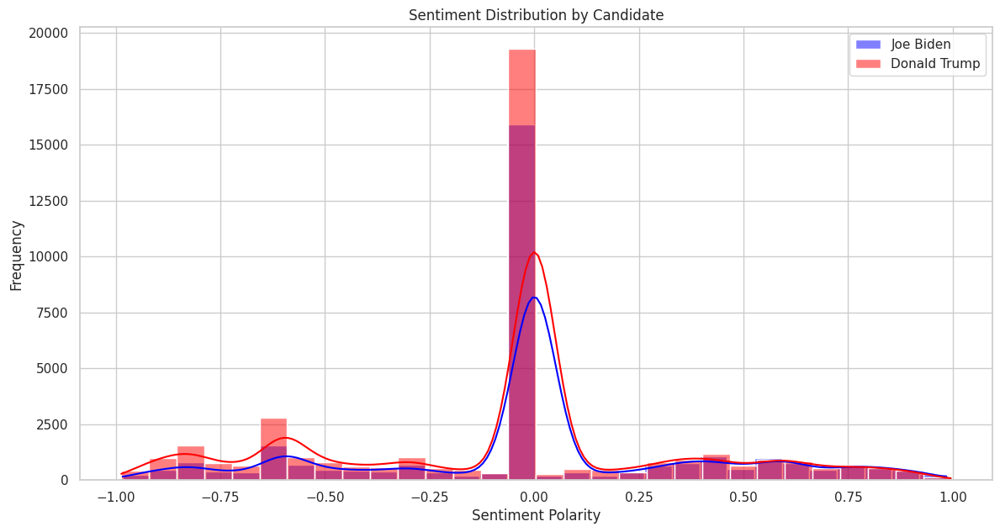

In [ ]:
# Visualization: Sentiment Distribution by Candidate
plt.figure(figsize=(14, 7))
sns.histplot(joe_stock['Compound'], bins=30, kde=True, color='blue', label='Joe Biden')
sns.histplot(donald_stock['Compound'], bins=30, kde=True, color='red', label='Donald Trump')
plt.title('Sentiment Distribution by Candidate')
plt.xlabel('Sentiment Polarity')
plt.ylabel('Frequency')
plt.legend()
plt.show()


Percentage Change in Stock Prices Before, During, and After the Election

      Before Election  During Election  After Election
AAPL        -5.380271         1.535355        0.887346
AMZN        -5.328596         1.462152       -6.360063
TSLA        -7.671081         5.840062       -2.522680
GOOG         1.921469         1.487057       -0.499673
KO          -3.493972         1.501439        9.782391
VZ          -1.418439         0.086654        6.780841


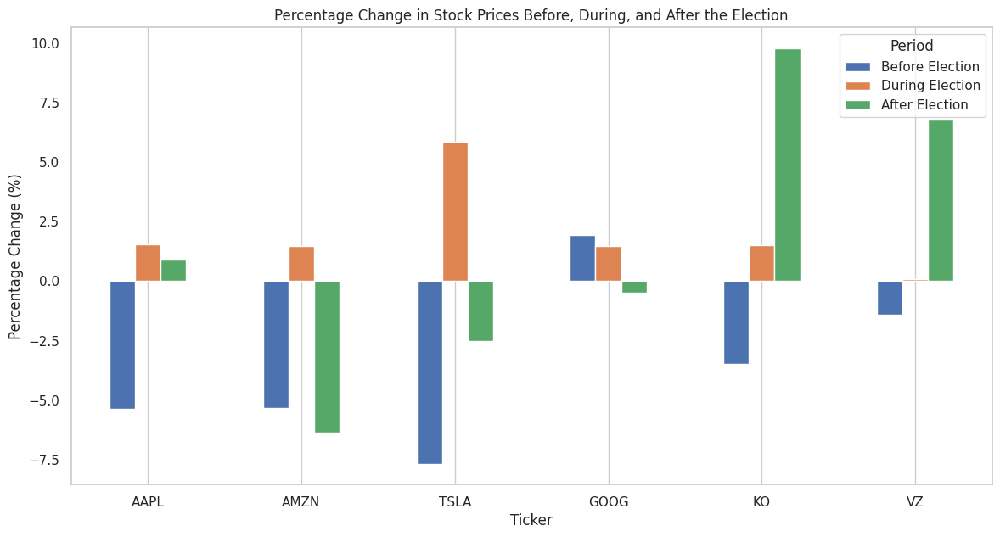

In [ ]:
# Calculate percentage change
def calculate_percentage_change(stock_data):
    percentage_changes = {}
    for ticker in tickers:
        if ticker in stock_data['Close']:
            start_price = stock_data['Close'][ticker].iloc[0]
            end_price = stock_data['Close'][ticker].iloc[-1]
            percentage_change = ((end_price - start_price) / start_price) * 100
            percentage_changes[ticker] = percentage_change
    return percentage_changes

before_election_change = calculate_percentage_change(before_election_stock_data)
election_change = calculate_percentage_change(election_stock_data)
after_election_change = calculate_percentage_change(after_election_stock_data)

# Display percentage changes in a table
percentage_change_df = pd.DataFrame({
    'Before Election': before_election_change,
    'During Election': election_change,
    'After Election': after_election_change
})

print(percentage_change_df)

# Plot the percentage changes
percentage_change_df.plot(kind='bar', figsize=(14, 7))
plt.title('Percentage Change in Stock Prices Before, During, and After the Election')
plt.xlabel('Ticker')
plt.ylabel('Percentage Change (%)')
plt.xticks(rotation=0)
plt.legend(title='Period')
plt.grid(axis='y')
plt.show()


Stock Price Analysis: Impact of Debate on Different Industries

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


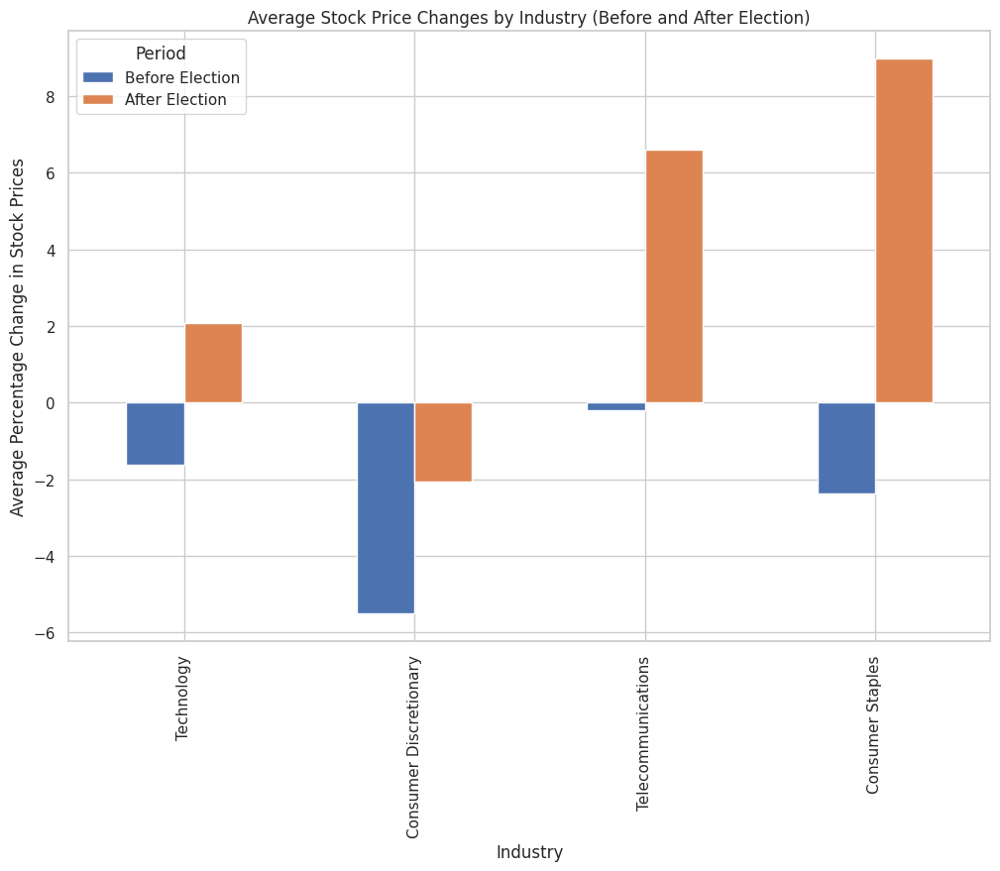

                        Before Election (%)  After Election (%)
Technology                        -1.610700            2.077109
Consumer Discretionary            -5.510062           -2.058077
Telecommunications                -0.190280            6.606080
Consumer Staples                  -2.369479            8.968891


In [ ]:
# Define the stock tickers and their respective industries
stocks_and_industries = {
    'AAPL': 'Technology',
    'GOOG': 'Technology',
    'AMZN': 'Consumer Discretionary',
    'TSLA': 'Consumer Discretionary',
    'VZ': 'Telecommunications',
    'KO': 'Consumer Staples'
}

# Function to get the stock price for the nearest available date
def get_stock_price(stock_data, target_date):
    try:
        price = stock_data.loc[target_date, 'Close']
    except KeyError:
        price = stock_data['Close'].asof(target_date)
        print(f"Date {target_date} not found, using nearest available date.")
    return price

# Function to calculate stock price percentage change
def calculate_percentage_change(stock_data, start_date, end_date):
    start_price = get_stock_price(stock_data, start_date)
    end_price = get_stock_price(stock_data, end_date)
    return ((end_price - start_price) / start_price) * 100

# Initialize a dictionary to store percentage changes by industry
industry_changes = {}
for stock, industry in stocks_and_industries.items():
    stock_data = yf.download(stock, start='2020-10-20', end='2020-11-20')
    pct_change_before = calculate_percentage_change(stock_data, '2020-10-26', '2020-11-02')
    pct_change_after = calculate_percentage_change(stock_data, '2020-11-04', '2020-11-11')
    if industry not in industry_changes:
        industry_changes[industry] = {'Before Election': [], 'After Election': []}
    industry_changes[industry]['Before Election'].append(pct_change_before)
    industry_changes[industry]['After Election'].append(pct_change_after)

# Calculate the average percentage change by industry
industry_avg_changes = {
    industry: {
        'Before Election': np.mean(changes['Before Election']),
        'After Election': np.mean(changes['After Election'])
    }
    for industry, changes in industry_changes.items()
}

# Convert to DataFrame for easier plotting
industry_avg_changes_df = pd.DataFrame(industry_avg_changes).T

# Plotting the results
industry_avg_changes_df.plot(kind='bar', figsize=(12, 8))
plt.title('Average Stock Price Changes by Industry (Before and After Election)')
plt.ylabel('Average Percentage Change in Stock Prices')
plt.xlabel('Industry')
plt.legend(title='Period')
plt.grid(True)
plt.show()

# Calculate the average percentage change by industry
industry_avg_changes = {
    industry: {
        'Before Election (%)': np.mean(changes['Before Election']),
        'After Election (%)': np.mean(changes['After Election'])
    }
    for industry, changes in industry_changes.items()
}

industry_avg_changes_df = pd.DataFrame(industry_avg_changes).T
print(industry_avg_changes_df)

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


                        Before Debate (%)  After Debate (%)
Technology                      -0.257948         -1.072498
Consumer Discretionary          -3.277618         -0.164722
Telecommunications              -2.239447          0.837257
Consumer Staples                -0.079946         -1.736387


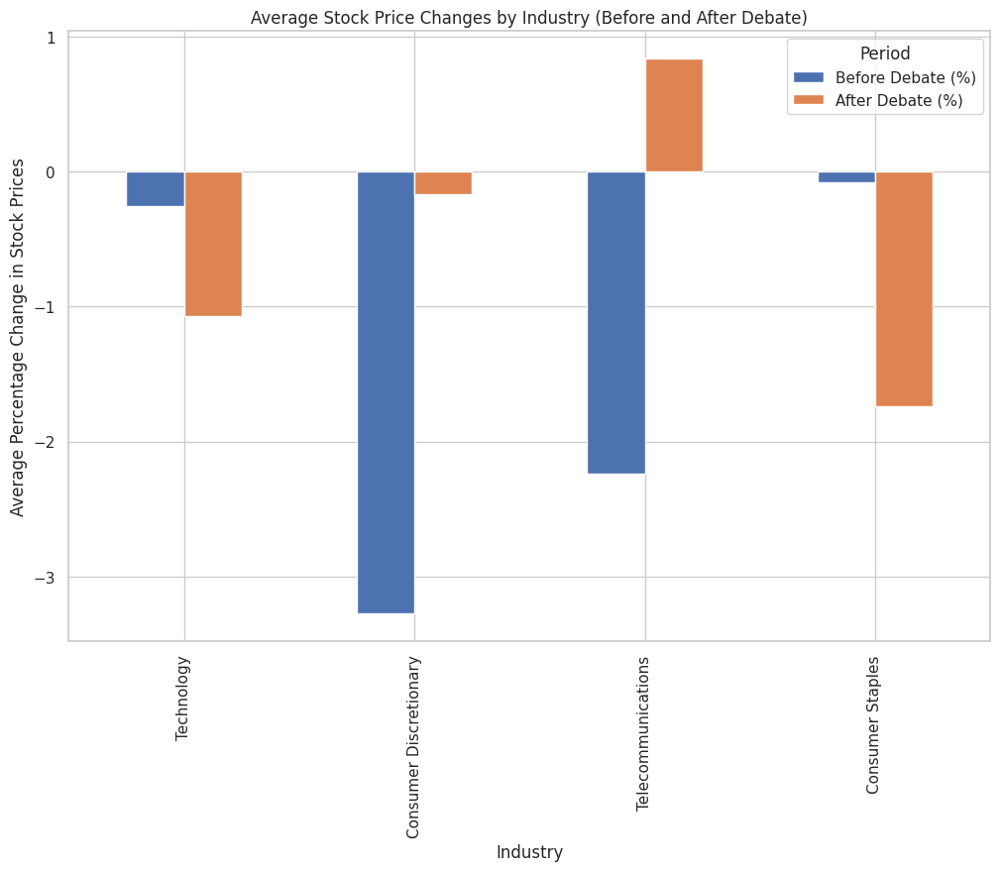

In [ ]:
# Define the stock tickers and their respective industries
stocks_and_industries = {
    'AAPL': 'Technology',
    'GOOG': 'Technology',
    'AMZN': 'Consumer Discretionary',
    'TSLA': 'Consumer Discretionary',
    'VZ': 'Telecommunications',
    'KO': 'Consumer Staples'
}

# Function to get the stock price for the nearest available date
def get_stock_price(stock_data, target_date):
    try:
        price = stock_data.loc[target_date, 'Close']
    except KeyError:
        price = stock_data['Close'].asof(target_date)
        print(f"Date {target_date} not found, using nearest available date.")
    return price

# Function to calculate stock price percentage change
def calculate_percentage_change(stock_data, start_date, end_date):
    start_price = get_stock_price(stock_data, start_date)
    end_price = get_stock_price(stock_data, end_date)
    return ((end_price - start_price) / start_price) * 100
industry_changes = {}
for stock, industry in stocks_and_industries.items():
    stock_data = yf.download(stock, start='2020-10-10', end='2020-10-30')
    pct_change_before = calculate_percentage_change(stock_data, '2020-10-16', '2020-10-21')
    pct_change_after = calculate_percentage_change(stock_data, '2020-10-22', '2020-10-26')

    if industry not in industry_changes:
        industry_changes[industry] = {'Before Debate': [], 'After Debate': []}
    industry_changes[industry]['Before Debate'].append(pct_change_before)
    industry_changes[industry]['After Debate'].append(pct_change_after)
industry_avg_changes = {
    industry: {
        'Before Debate (%)': np.mean(changes['Before Debate']),
        'After Debate (%)': np.mean(changes['After Debate'])
    }
    for industry, changes in industry_changes.items()
}
industry_avg_changes_df = pd.DataFrame(industry_avg_changes).T
print(industry_avg_changes_df)

# Plotting the results
industry_avg_changes_df.plot(kind='bar', figsize=(12, 8))
plt.title('Average Stock Price Changes by Industry (Before and After Debate)')
plt.ylabel('Average Percentage Change in Stock Prices')
plt.xlabel('Industry')
plt.legend(title='Period')
plt.grid(True)
plt.show()


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


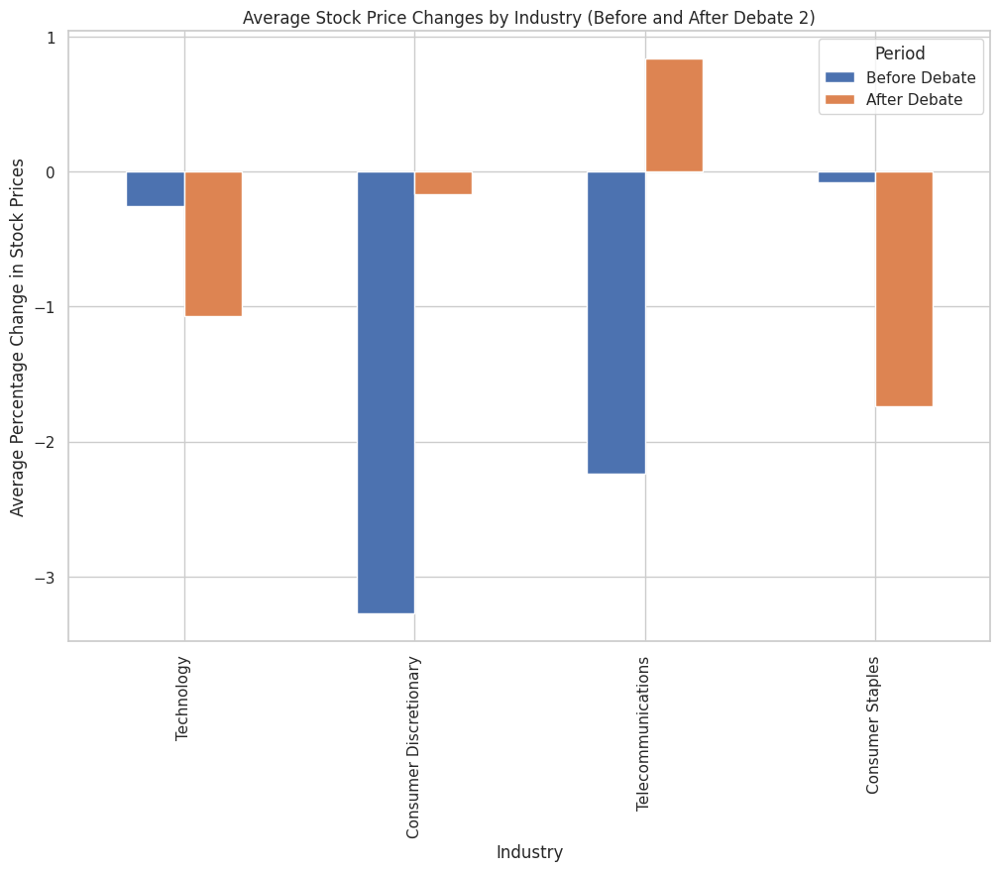

                        Before Debate (%)  After Debate (%)
Technology                      -0.257948         -1.072498
Consumer Discretionary          -3.277618         -0.164722
Telecommunications              -2.239447          0.837257
Consumer Staples                -0.079946         -1.736387


In [ ]:
# Define the stock tickers and their respective industries
stocks_and_industries = {
    'AAPL': 'Technology',
    'GOOG': 'Technology',
    'AMZN': 'Consumer Discretionary',
    'TSLA': 'Consumer Discretionary',
    'VZ': 'Telecommunications',
    'KO': 'Consumer Staples'
}

# Function to get the stock price for the nearest available date
def get_stock_price(stock_data, target_date):
    try:
        # Try to get the price for the exact date
        price = stock_data.loc[target_date, 'Close']
    except KeyError:
        # If the exact date is not available, use the last available date before the target date
        price = stock_data['Close'].asof(target_date)
        print(f"Date {target_date} not found, using nearest available date.")
    return price

# Function to calculate stock price percentage change
def calculate_percentage_change(stock_data, start_date, end_date):
    start_price = get_stock_price(stock_data, start_date)
    end_price = get_stock_price(stock_data, end_date)
    return ((end_price - start_price) / start_price) * 100

# Initialize a dictionary to store percentage changes by industry
industry_changes = {}

# Loop through each stock and calculate percentage changes before and after the debate
for stock, industry in stocks_and_industries.items():
    stock_data = yf.download(stock, start='2020-10-10', end='2020-10-30')

    pct_change_before = calculate_percentage_change(stock_data, '2020-10-16', '2020-10-21')
    pct_change_after = calculate_percentage_change(stock_data, '2020-10-22', '2020-10-26')

    if industry not in industry_changes:
        industry_changes[industry] = {'Before Debate': [], 'After Debate': []}

    industry_changes[industry]['Before Debate'].append(pct_change_before)
    industry_changes[industry]['After Debate'].append(pct_change_after)

# Calculate the average percentage change by industry
industry_avg_changes = {
    industry: {
        'Before Debate': np.mean(changes['Before Debate']),
        'After Debate': np.mean(changes['After Debate'])
    }
    for industry, changes in industry_changes.items()
}

# Convert to DataFrame for easier plotting
industry_avg_changes_df = pd.DataFrame(industry_avg_changes).T

# Plotting the results
industry_avg_changes_df.plot(kind='bar', figsize=(12, 8))
plt.title('Average Stock Price Changes by Industry (Before and After Debate 2)')
plt.ylabel('Average Percentage Change in Stock Prices')
plt.xlabel('Industry')
plt.legend(title='Period')
plt.grid(True)
plt.show()
# Calculate the average percentage change by industry
industry_avg_changes = {
    industry: {
        'Before Debate (%)': np.mean(changes['Before Debate']),
        'After Debate (%)': np.mean(changes['After Debate'])
    }
    for industry, changes in industry_changes.items()
}

# Convert to DataFrame for easier display
industry_avg_changes_df = pd.DataFrame(industry_avg_changes).T

# Display the results as a table
print(industry_avg_changes_df)



Stock Price Analysis Around the 2020 U.S. Election and Debates for Major Companies

[*********************100%***********************]  1 of 1 completed
<ipython-input-125-853155b63979>:48: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  summary_df = pd.concat([summary_df, new_row], ignore_index=True)
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


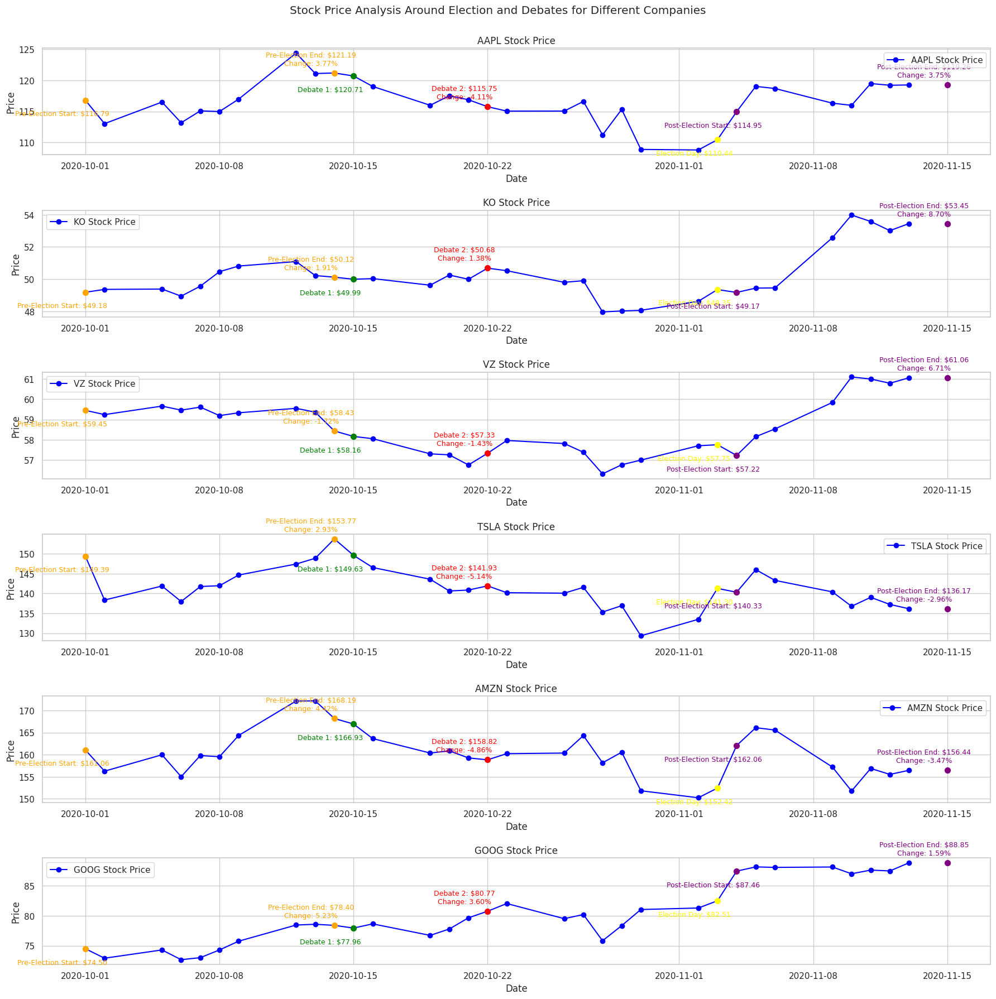

In [ ]:
companies = ['AAPL', 'KO', 'VZ', 'TSLA', 'AMZN', 'GOOG']
pre_election_start_date = '2020-10-01'
pre_election_end_date = '2020-10-14'
debate_1_date = '2020-10-15'
debate_2_date = '2020-10-22'
election_day = '2020-11-03'
post_election_start_date = '2020-11-04'
post_election_end_date = '2020-11-15'

# Function to get the nearest price to a given date
def get_nearest_date(data, date_str):
    date = pd.to_datetime(date_str)
    if date in data.index:
        return data.loc[date, 'Close']
    else:
        closest_date = data.index.get_indexer([date], method='nearest')[0]
        return data.iloc[closest_date]['Close']

# Function to calculate the percentage change from start to end of a period
def calculate_percentage_change(stock_data, start_date, end_date):
    start_price = get_nearest_date(stock_data, start_date)
    end_price = get_nearest_date(stock_data, end_date)
    percentage_change = ((end_price - start_price) / start_price) * 100
    return percentage_change
fig = plt.figure(figsize=(18, 20))
gs = GridSpec(len(companies) + 1, 1, height_ratios=[3] * len(companies) + [1])
summary_df = pd.DataFrame(columns=['Company', 'Pre-Election (%)', 'Debate 1 (%)', 'Debate 2 (%)', 'Election Day (%)', 'Post-Election (%)'])
for i, company in enumerate(companies):
    stock_data = yf.download(company, start=pre_election_start_date, end=post_election_end_date)

    percentage_change_pre = calculate_percentage_change(stock_data, pre_election_start_date, pre_election_end_date)
    percentage_change_during_debate_1 = calculate_percentage_change(stock_data, pre_election_end_date, debate_1_date)
    percentage_change_during_debate_2 = calculate_percentage_change(stock_data, debate_1_date, debate_2_date)
    percentage_change_during_election = calculate_percentage_change(stock_data, debate_2_date, election_day)
    percentage_change_post = calculate_percentage_change(stock_data, post_election_start_date, post_election_end_date)

    # Create a DataFrame row with the new data
    new_row = pd.DataFrame({
        'Company': [company],
        'Pre-Election (%)': [percentage_change_pre],
        'Debate 1 (%)': [percentage_change_during_debate_1],
        'Debate 2 (%)': [percentage_change_during_debate_2],
        'Election Day (%)': [percentage_change_during_election],
        'Post-Election (%)': [percentage_change_post]
    })

    # Append data to the summary DataFrame
    summary_df = pd.concat([summary_df, new_row], ignore_index=True)
    ax = fig.add_subplot(gs[i])
    ax.plot(stock_data.index, stock_data['Close'], marker='o', linestyle='-', color='blue', label=f'{company} Stock Price')
    ax.scatter(pd.to_datetime(pre_election_start_date), get_nearest_date(stock_data, pre_election_start_date), color='orange', s=50, zorder=5)
    ax.scatter(pd.to_datetime(pre_election_end_date), get_nearest_date(stock_data, pre_election_end_date), color='orange', s=50, zorder=5)
    ax.scatter(pd.to_datetime(debate_1_date), get_nearest_date(stock_data, debate_1_date), color='green', s=50, zorder=5)
    ax.scatter(pd.to_datetime(debate_2_date), get_nearest_date(stock_data, debate_2_date), color='red', s=50, zorder=5)
    ax.scatter(pd.to_datetime(election_day), get_nearest_date(stock_data, election_day), color='yellow', s=50, zorder=5)
    ax.scatter(pd.to_datetime(post_election_start_date), get_nearest_date(stock_data, post_election_start_date), color='purple', s=50, zorder=5)
    ax.scatter(pd.to_datetime(post_election_end_date), get_nearest_date(stock_data, post_election_end_date), color='purple', s=50, zorder=5)

    ax.annotate(f"Pre-Election Start: ${get_nearest_date(stock_data, pre_election_start_date):.2f}",
                 (pd.to_datetime(pre_election_start_date), get_nearest_date(stock_data, pre_election_start_date)),
                 textcoords="offset points", xytext=(-30,-20), ha='center', color='orange', fontsize=9)

    ax.annotate(f"Pre-Election End: ${get_nearest_date(stock_data, pre_election_end_date):.2f}\nChange: {percentage_change_pre:.2f}%",
                 (pd.to_datetime(pre_election_end_date), get_nearest_date(stock_data, pre_election_end_date)),
                 textcoords="offset points", xytext=(-30,10), ha='center', color='orange', fontsize=9)

    ax.annotate(f"Debate 1: ${get_nearest_date(stock_data, debate_1_date):.2f}",
                 (pd.to_datetime(debate_1_date), get_nearest_date(stock_data, debate_1_date)),
                 textcoords="offset points", xytext=(-30,-20), ha='center', color='green', fontsize=9)

    ax.annotate(f"Debate 2: ${get_nearest_date(stock_data, debate_2_date):.2f}\nChange: {percentage_change_during_debate_2:.2f}%",
                 (pd.to_datetime(debate_2_date), get_nearest_date(stock_data, debate_2_date)),
                 textcoords="offset points", xytext=(-30,10), ha='center', color='red', fontsize=9)

    ax.annotate(f"Election Day: ${get_nearest_date(stock_data, election_day):.2f}",
                 (pd.to_datetime(election_day), get_nearest_date(stock_data, election_day)),
                 textcoords="offset points", xytext=(-30,-20), ha='center', color='yellow', fontsize=9)

    ax.annotate(f"Post-Election Start: ${get_nearest_date(stock_data, post_election_start_date):.2f}",
                 (pd.to_datetime(post_election_start_date), get_nearest_date(stock_data, post_election_start_date)),
                 textcoords="offset points", xytext=(-30,-20), ha='center', color='purple', fontsize=9)

    ax.annotate(f"Post-Election End: ${get_nearest_date(stock_data, post_election_end_date):.2f}\nChange: {percentage_change_post:.2f}%",
                 (pd.to_datetime(post_election_end_date), get_nearest_date(stock_data, post_election_end_date)),
                 textcoords="offset points", xytext=(-30,10), ha='center', color='purple', fontsize=9)

    ax.set_title(f"{company} Stock Price")
    ax.set_xlabel("Date")
    ax.set_ylabel("Price")
    ax.legend()

plt.suptitle("Stock Price Analysis Around Election and Debates for Different Companies", y=0.95)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()
